In [1]:
from aucmedi import *
import csv
import tensorflow as tf
print(tf.version.VERSION)
import random
import pandas as pd
import numpy as np
import re

2024-06-10 09:55:12.942206: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-10 09:55:12.942278: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-10 09:55:12.970309: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-06-10 09:55:13.171582: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3

2.15.1


In [2]:
import tensorflow as tf
tf.compat.v1.disable_eager_execution() ## required by innvestigate to be able to analyze the network graph
print("Running TensorFlow version: ", tf.version.VERSION)

# limit memory consumption to allocate only what is currently needed (otherwise tf will block all memory available!)
gpus = tf.config.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)

Running TensorFlow version:  2.15.1
1 Physical GPUs, 1 Logical GPUs


2024-06-10 09:55:32.310157: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 09:55:33.045376: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 09:55:33.045595: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

#### AD_MCIvsCN.csv Data Analysis

In [3]:
df = pd.read_csv('/data_dzne_archiv2/Studien/Deep_Learning_Visualization/data/xxx_t1linear_combined_AD_MCIvsCN(ohneAD3EMCI).csv')
df.head(10)

,sid,sample,grp,sex1f,age,education_y,MMSE,MRI_field_strength,eTIV,filename,class_ADMCI_vs_CN
0,51,ADNI2/GO,AD,0.0,72.0,18.0,23,1.5,1624692,ADNI2_AD_0051_N4cor_WarpedSegmentationPosterio...,alz
1,101,ADNI2/GO,AD,0.0,80.0,18.0,25,1.5,1580771,ADNI2_AD_0101_N4cor_WarpedSegmentationPosterio...,alz
2,135,ADNI2/GO,AD,1.0,87.0,18.0,29,1.5,1459111,ADNI2_AD_0135_N4cor_WarpedSegmentationPosterio...,alz
3,160,ADNI2/GO,AD,0.0,80.0,16.0,21,1.5,1660663,ADNI2_AD_0160_N4cor_WarpedSegmentationPosterio...,alz
4,166,ADNI2/GO,AD,1.0,81.0,18.0,18,1.5,1439499,ADNI2_AD_0166_N4cor_WarpedSegmentationPosterio...,alz
5,214,ADNI2/GO,AD,0.0,70.0,18.0,23,1.5,1741334,ADNI2_AD_0214_N4cor_WarpedSegmentationPosterio...,alz
6,227,ADNI2/GO,AD,1.0,85.0,12.0,20,1.5,1472839,ADNI2_AD_0227_N4cor_WarpedSegmentationPosterio...,alz
7,230,ADNI2/GO,AD,0.0,86.0,20.0,22,1.5,1717252,ADNI2_AD_0230_N4cor_WarpedSegmentationPosterio...,alz
8,269,ADNI2/GO,AD,0.0,72.0,16.0,12,1.5,1484183,ADNI2_AD_0269_N4cor_WarpedSegmentationPosterio...,alz
9,292,ADNI2/GO,AD,0.0,82.0,16.0,22,1.5,1612209,ADNI2_AD_0292_N4cor_WarpedSegmentationPosterio...,alz


In [5]:
df.shape

(2795, 11)

In [7]:
df['class_ADMCI_vs_CN'].value_counts()

class_ADMCI_vs_CN
normal    1620
alz       1175
Name: count, dtype: int64

In [9]:
df['filename'].isna().sum()

0

In [11]:
df['grp'].value_counts()

grp
CN     1620
MCI     629
AD      546
Name: count, dtype: int64

In [13]:
meta_grp = pd.get_dummies(df['grp'], prefix="group")

In [14]:
meta_grp.head()

,group_AD,group_CN,group_MCI
0,True,False,False
1,True,False,False
2,True,False,False
3,True,False,False
4,True,False,False


In [16]:
meta_grp = meta_grp.to_numpy()

In [17]:
meta_grp.shape

(2795, 3)

In [19]:
meta_grp[:10,:]  # index info, [:,0]-->AD; [:,1]-->CN; [:,2]-->MCI

array([[ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False],
       [ True, False, False]])

#### Load the image names and labels info from the csv file

In [21]:
from aucmedi.data_processing.io_data import input_interface

nifti_loader = input_interface(
    interface="csv", # Type of annotations
    # image_format=".nii.gz",
    path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
    path_data='/data_dzne_archiv2/Studien/Deep_Learning_Visualization/data/xxx_t1linear_combined_AD_MCIvsCN(ohneAD3EMCI).csv', # Path to labels
    col_sample="filename", # Name of the column that identifies an image
    col_class="class_ADMCI_vs_CN", # Name of the column that classify the image
    training=True, # Is annotation data available?
    ohe=False, # Are labels one-hot-encoded?
)

(nifti_images, labelsbin, n_classes, class_names, image_format) = nifti_loader

In [22]:
nifti_images

['ADNI2_AD_0051_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0101_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0135_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0160_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0166_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0214_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0227_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0230_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0269_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0292_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0331_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0361_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0376_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0378_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0408_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0552_N4cor_WarpedSegmentationPosteriors2.nii.gz',
 'ADNI2_AD_0658_N4cor_Wa

In [24]:
labelsbin

array([[ True, False],
       [ True, False],
       [ True, False],
       ...,
       [ True, False],
       [ True, False],
       [ True, False]])

In [26]:
n_classes

2

In [28]:
class_names

['alz', 'normal']

In [30]:
labelsbin.shape

(2795, 2)

In [32]:
len(nifti_images)

2795

In [34]:
def evalby_class(labels, class_names):
    """
    compute class frequency
    return: restults as a dataframe
    ref: aucmedi/aucmedi/evaluation/dataset.py
    """
    cf_list = []
    for c in range(0, labels.shape[1]):
        n_samples = labels.shape[0]
        class_freq = np.sum(labels[:, c])
        if class_names is None : curr_class = str(c)
        else : curr_class = class_names[c]
        class_percentage = np.round(class_freq / n_samples, 2) * 100
        cf_list.append([curr_class, class_freq, class_percentage])

    # Convert class frequency results to dataframe
    df_cf = pd.DataFrame(np.array(cf_list),
                         columns=["class", "class_freq", "class_perc"])
    df_cf["class_perc"] = pd.to_numeric(df_cf["class_perc"])

    return df_cf

In [35]:
evalby_class(
    labels=labelsbin,
    class_names=class_names
)


,class,class_freq,class_perc
0,alz,1175,42.0
1,normal,1620,58.0


In [37]:
import pandas as pd
import numpy as np
from keras.utils import to_categorical
import matplotlib.pyplot as plt
import os
from sklearn.metrics import roc_curve, auc
import keras
from keras import layers
from keras.layers import Input, Conv3D, BatchNormalization, Dense
from keras.layers import AveragePooling3D, GlobalAveragePooling3D, MaxPooling3D
from keras.models import Model
from keras.layers import ReLU, concatenate
from keras.regularizers import L1L2
import keras.backend as K

from keras import models
from scipy import ndimage

def DenseNet(ip_shape, op_shape, filters = 5):
   '''
   declaring a DenseNet model.
   Paper: https://arxiv.org/pdf/1608.06993.pdf
   Code adapted from https://towardsdatascience.com/creating-densenet-121-with-tensorflow-edbc08a956d8

   ip_shape: expected input shape
   op_shape: expected output shape
   filters: number of filters to be used
   '''

   #batch norm + relu + conv
   def bn_rl_conv(x,filters,kernel=1,strides=1):

       x = BatchNormalization()(x)
       x = ReLU()(x)
       x = Conv3D(filters, kernel, strides=strides,padding = 'same')(x)
       return x

   def dense_block(x, repetition=4):

       for _ in range(repetition):
           y = bn_rl_conv(x, filters=8)
           y = bn_rl_conv(y, filters=8, kernel=3)
           x = concatenate([y,x])
       return x

   def transition_layer(x):

       x = bn_rl_conv(x, K.int_shape(x)[-1] //2 )
       x = AveragePooling3D(2, strides = 2, padding = 'same')(x)
       return x



   input = Input(ip_shape)
   x = Conv3D(10, 7, strides = 2, padding = 'same')(input)
   x = MaxPooling3D(3, strides = 2, padding = 'same')(x)

   brc_in_blocks = [3,3]
   for repetition in brc_in_blocks:                      #[6,12,24,16]:
       d = dense_block(x, repetition)
       x = transition_layer(d)

   x = layers.MaxPooling3D(pool_size=(2, 2, 2))(d)
   #Notice the input to pooling layer. d. this overwrites the last x variable,
   #and nullifies the transition layer computations done on last dense blocks output.
   # i.e last transition layer is not connected to the graph
   #TLDR: No transition layer after last dense block.

   # FC layer
   # added on 3.3.23
   x=layers.Activation('relu')(x)
   x=layers.Dropout(rate = 0.4)(x)

   x = layers.Flatten()(x)
   output = Dense(op_shape, activation = 'softmax', kernel_regularizer = L1L2(l1=1e-5, l2=1e-4))(x)

   model = Model(input, output)
   return model

In [38]:
# define class weights to train a balanced model, taken from https://www.tensorflow.org/tutorials/structured_data/imbalanced_data
# Scaling by total/2 helps keep the loss to a similar magnitude.
# The sum of the weights of all examples stays the same.
numfiles = len(nifti_images)
# neg = np.sum(labelsbin[:, 1])
class_distb = np.sum(labelsbin, axis=0)
neg = class_distb[1]
pos = class_distb[0]
weight_for_0 = (1 / neg)*(numfiles)/2.0
weight_for_1 = (1 / pos)*(numfiles)/2.0
class_weights = {0: weight_for_0, 1: weight_for_1}
print('Examples:    Total: {}  Negative: {} ({:.2f}% of total)  Positive: {} ({:.2f}% of total)'.format(
    numfiles, neg, 100 * neg / numfiles, pos, 100 * pos / numfiles))
print('Weight for class Normal: {:.2f}'.format(weight_for_0))
print('Weight for class Alzheimer: {:.2f}'.format(weight_for_1)) 

Examples:    Total: 2795  Negative: 1620 (57.96% of total)  Positive: 1175 (42.04% of total)
Weight for class Normal: 0.86
Weight for class Alzheimer: 1.19


In [39]:
# define class weights below after set_train has been created

In [40]:
#define nifti datei 

import nibabel as nib

def read_nifti_data(filename, x_range_from, x_range_to, y_range_from, y_range_to, z_range_from, z_range_to, minmaxscaling):
    """
    Reads the nifti file and loads the image data within the given field of view.

    Parameters
    ----------
    filename : string
        The input nifti file name.
    x_range_from : int >= 0
        Input file saggital slice start.
    x_range_to : int >= 0
        Input file saggital slice end.
    y_range_from : int >= 0
        Input file coronal slice start.
    y_range_to : int >= 0,
        Input file coronal slice end.
    z_range_from : int >= 0
        Input file axial slice start.
    z_range_to : int >= 0
        Input file axial slice end.
    minmaxscaling : bool
        Apply scaling to adjust minimum and maximum intensity to the range 0 and 1.

    Returns
    -------
    img : numpy array
        The loaded image data.

    """
    img = nib.load(filename)
    img = img.get_fdata()[x_range_from:x_range_to, y_range_from:y_range_to, z_range_from:z_range_to]
    img = np.transpose(img, (2, 0, 1)) # reorder dimensions to match coronal view z*x*y in MRIcron etc.
    img = np.flip(img) # flip all positions
    img = np.nan_to_num(img) # remove nan or inf values
    if minmaxscaling:
        img = (img - img.min()) / (img.max() - img.min()) # min/max scaling
    return img


Instructions for updating:
Colocations handled automatically by placer.
Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  super().__init__(name, **kwargs)
2024-06-06 14:56:55.424228: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-06 14:56:55.424475: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-06 14:56:55.424629: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node

Epoch 1/50


2024-06-06 14:57:09.799056: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-06 14:57:10.076625: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/dense/bias/m/Assign' id:1977 op device:{requested: '', assigned: ''} def:{{{node training/Adam/dense/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](trainin

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.9979 - accuracy: 0.5586 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
  updates = self.state_updates
2024-06-06 15:12:43.350824: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommen

70/70 [==============================] - 1084s 15s/step - batch: 34.5000 - size: 31.9429 - loss: 0.9979 - accuracy: 0.5586 - val_loss: 0.7325 - val_accuracy: 0.4214
Epoch 2/50
70/70 [==============================] - 918s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7919 - accuracy: 0.6315 - val_loss: 0.8534 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 939s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6768 - accuracy: 0.6825 - val_loss: 0.6989 - val_accuracy: 0.4429
Epoch 4/50
70/70 [==============================] - 1344s 19s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6268 - accuracy: 0.6914 - val_loss: 0.5660 - val_accuracy: 0.7643
Epoch 5/50
70/70 [==============================] - 1420s 21s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6003 - accuracy: 0.7227 - val_loss: 0.8341 - val_accuracy: 0.6250
Epoch 6/50
70/70 [==============================] - 1414s 20s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6489 - accuracy: 0.7115

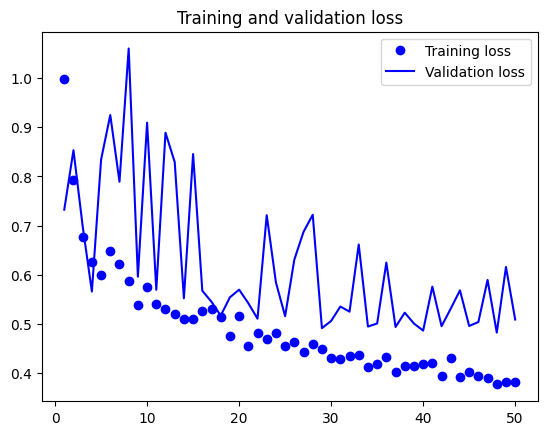

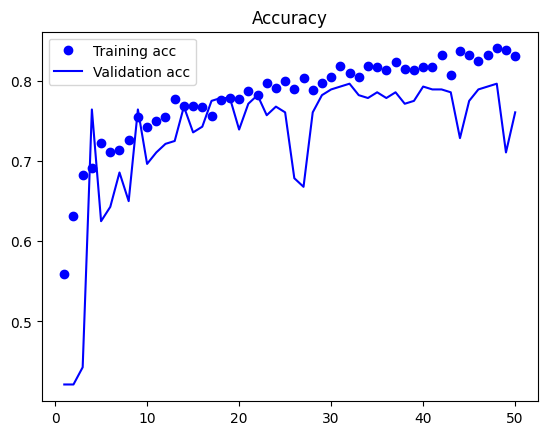

2024-06-07 06:38:41.203263: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:38:41.212346: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:38:41.212568: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.932
Acc for AD vs. CN = 88.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

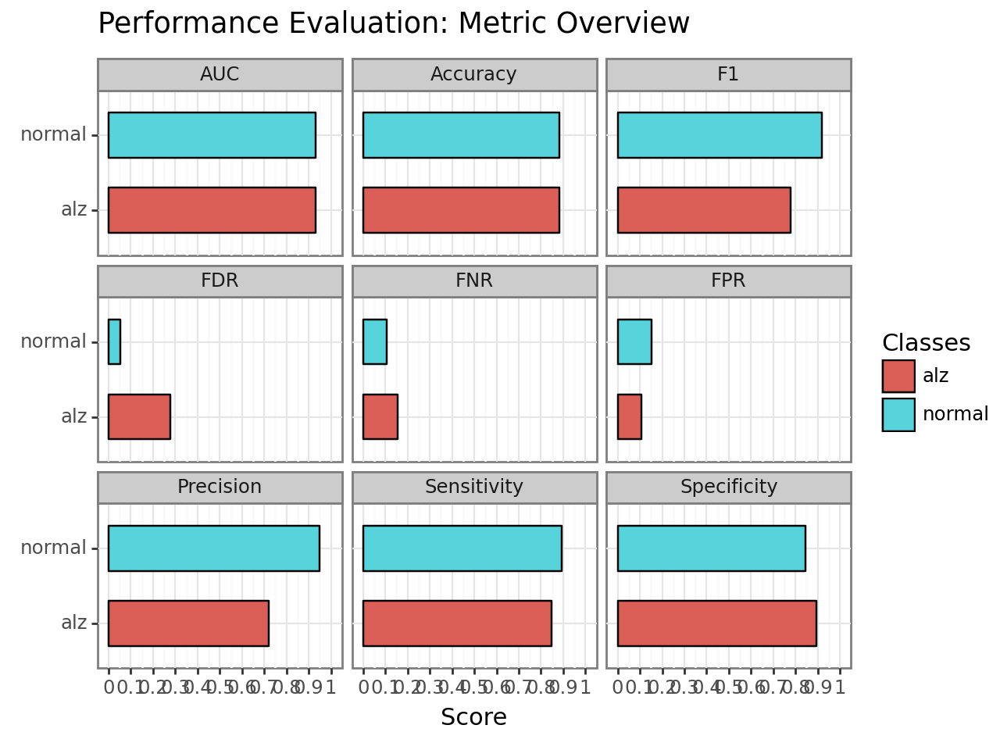

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv01/plot.performance.confusion_matrix.png


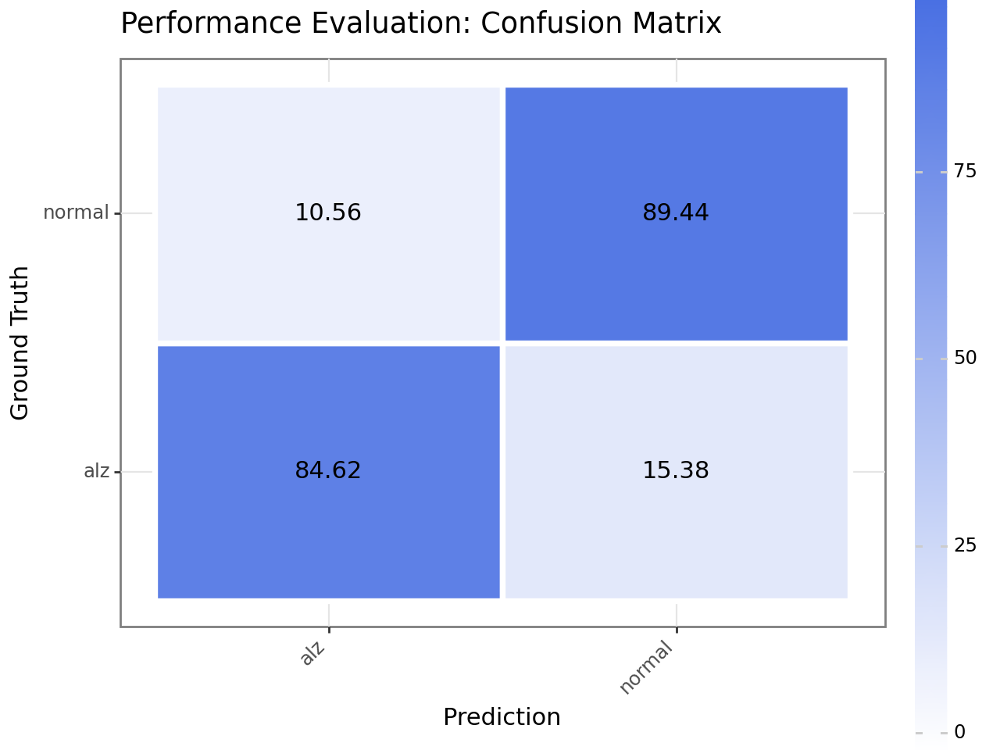

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv01/plot.performance.roc.png


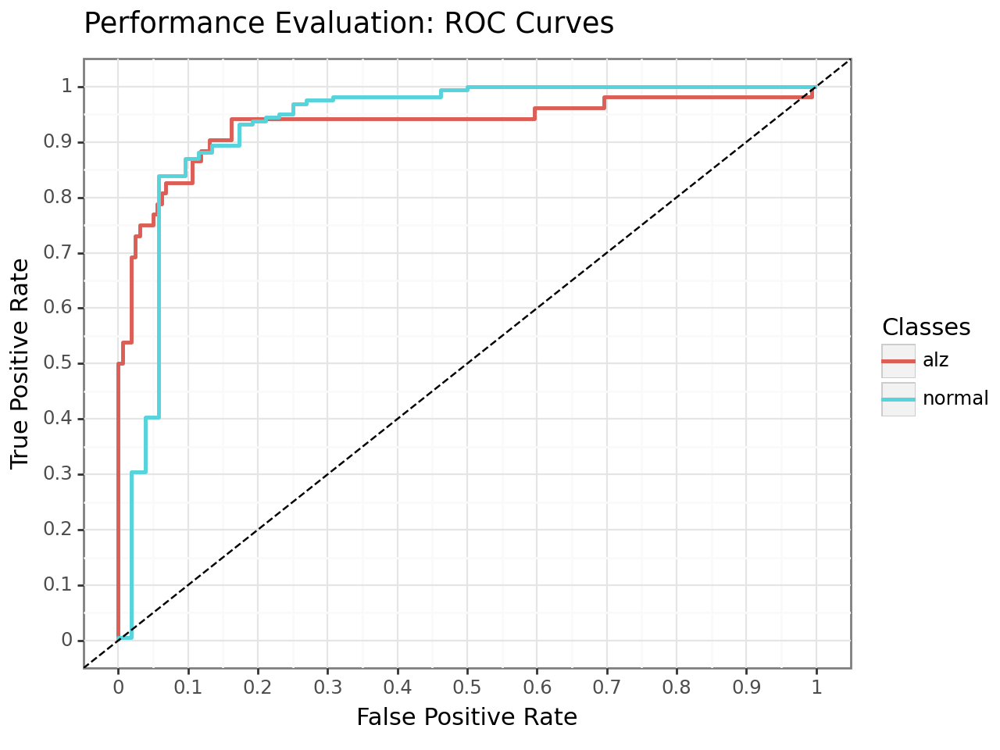


AUC for MCI vs. CN = 0.788
Acc for MCI vs. CN = 76.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

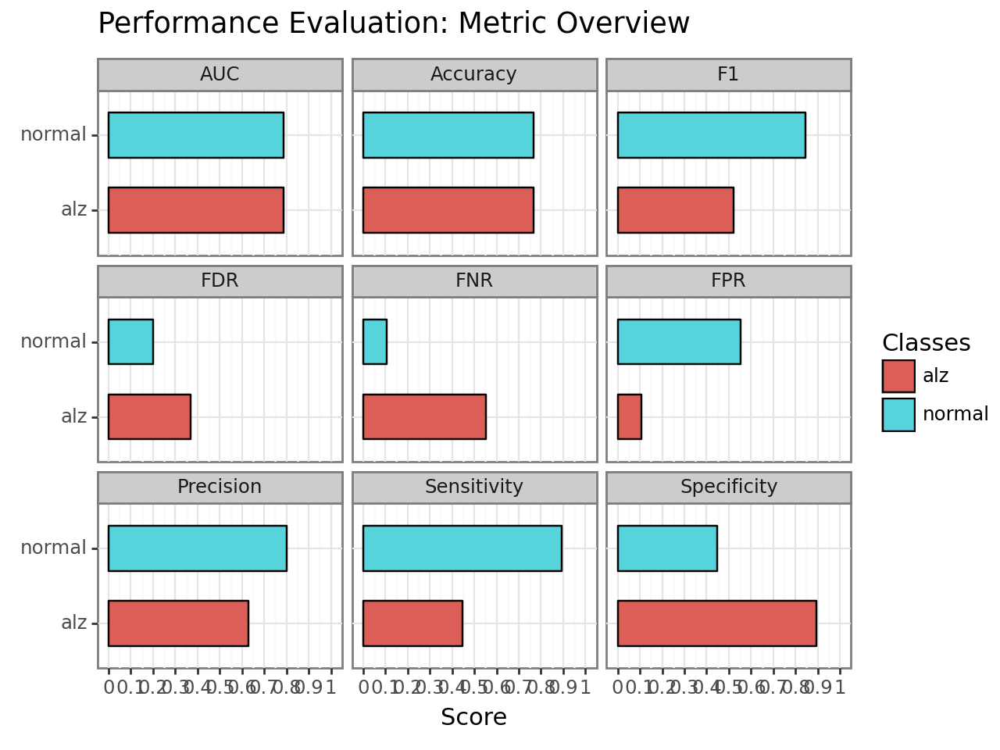

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv01/plot.performance.confusion_matrix.png


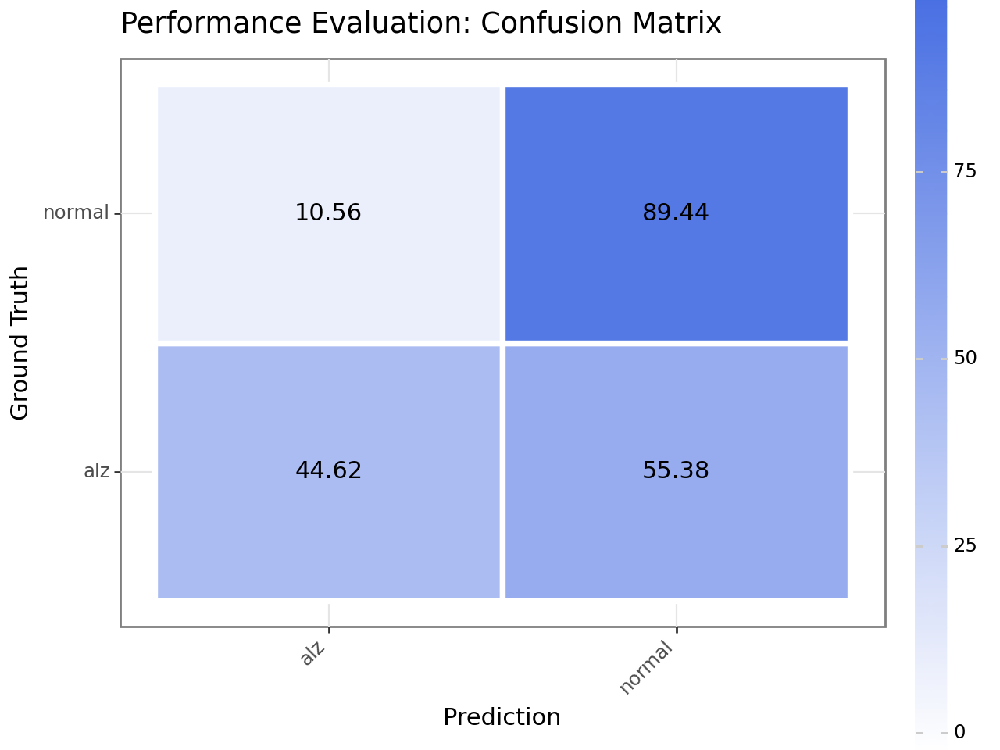

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv01/plot.performance.roc.png


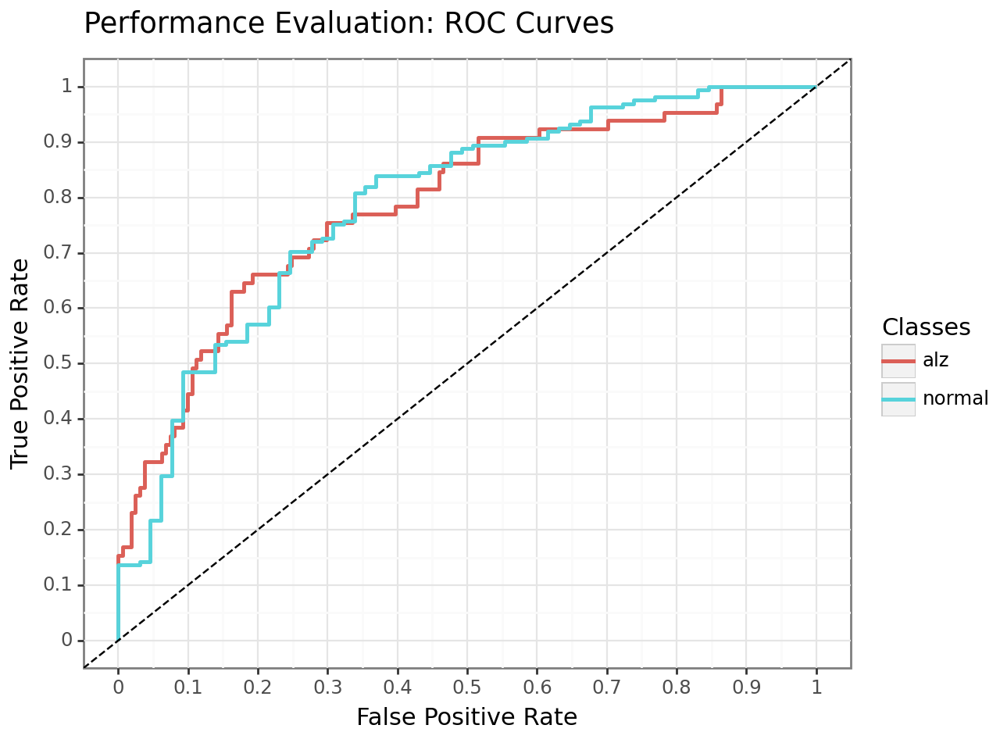

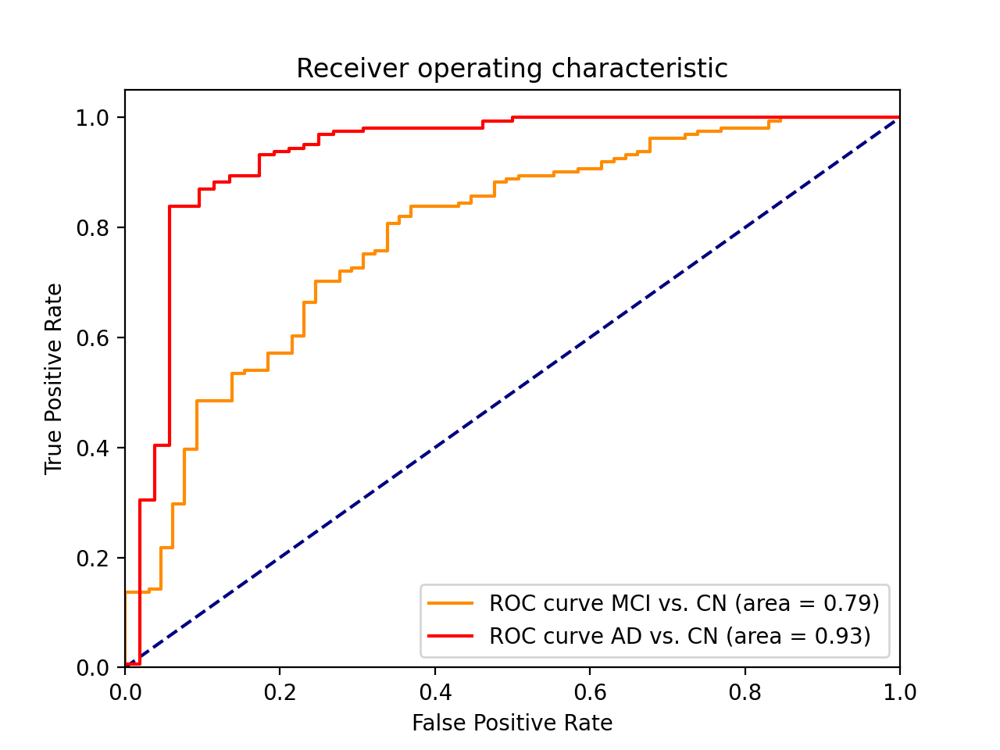

2024-06-07 06:40:17.115911: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:40:17.116174: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:40:17.116280: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

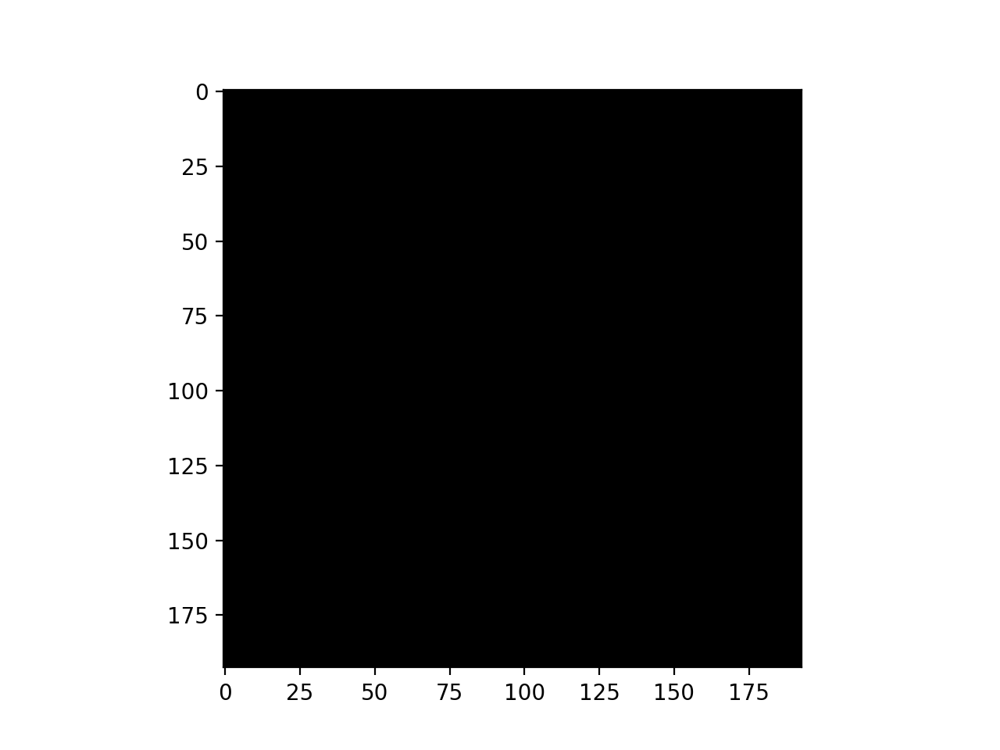

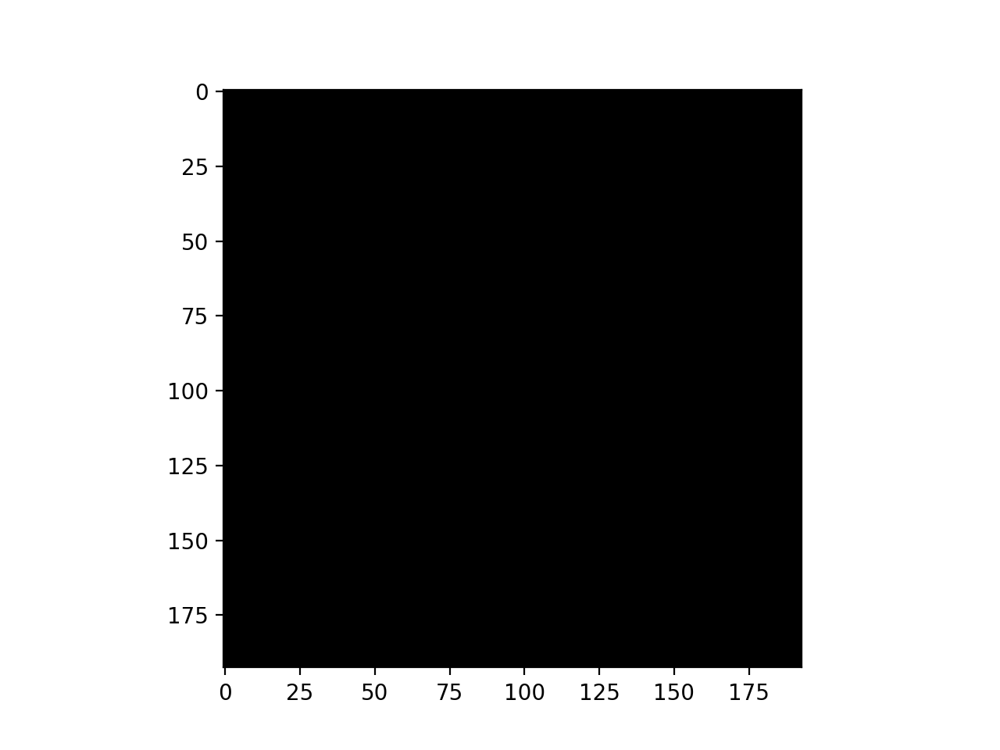

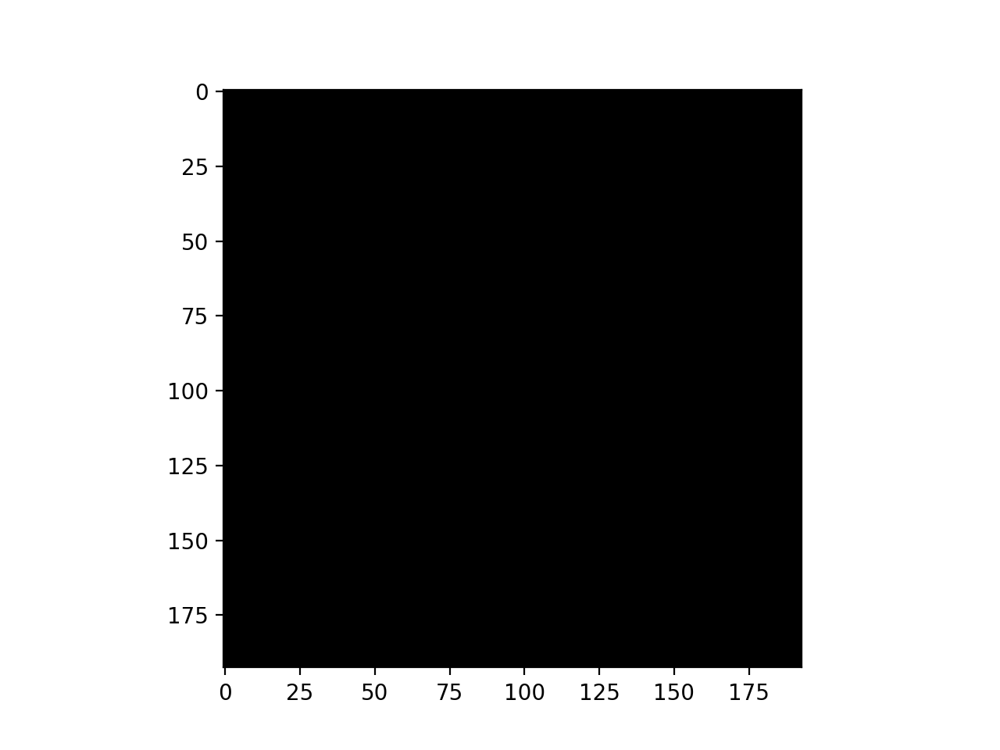

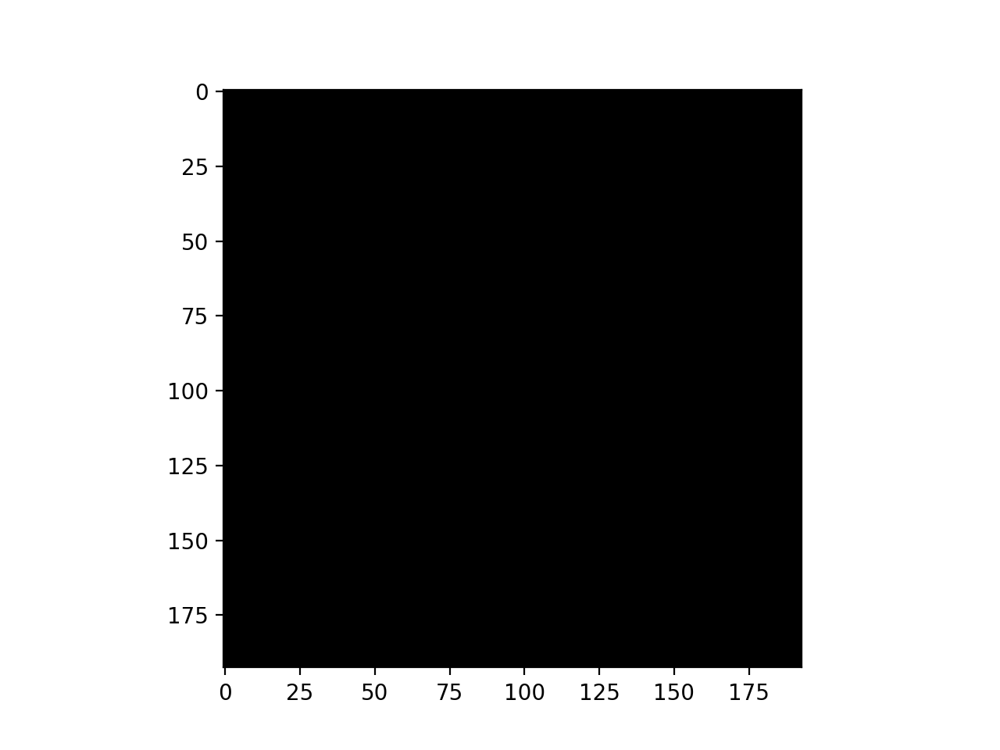

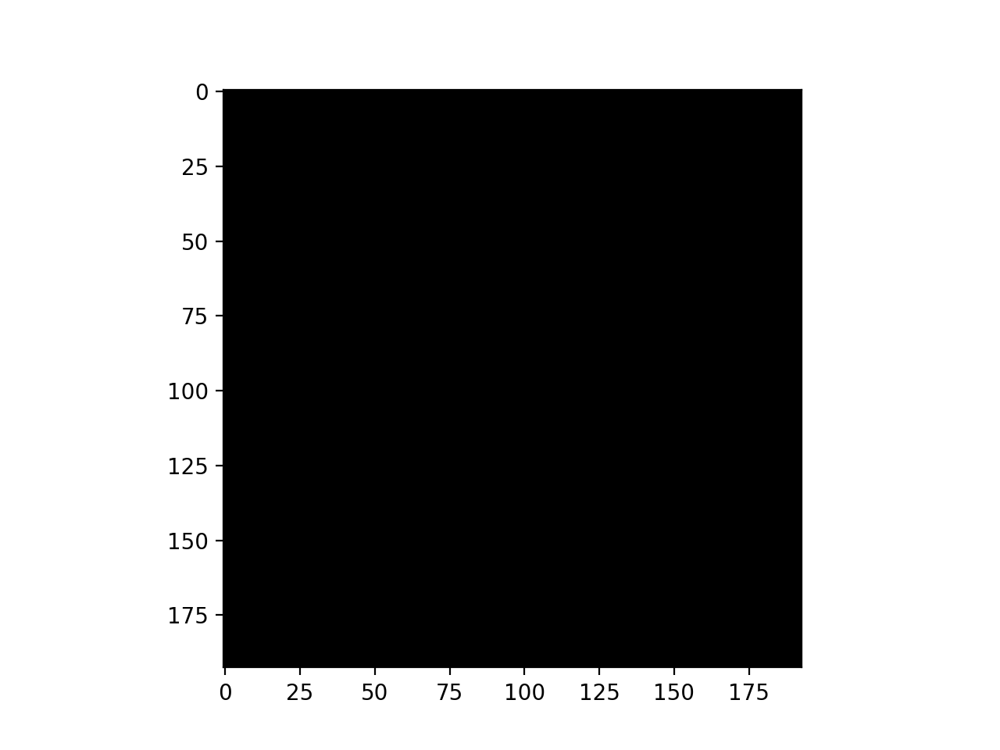

...

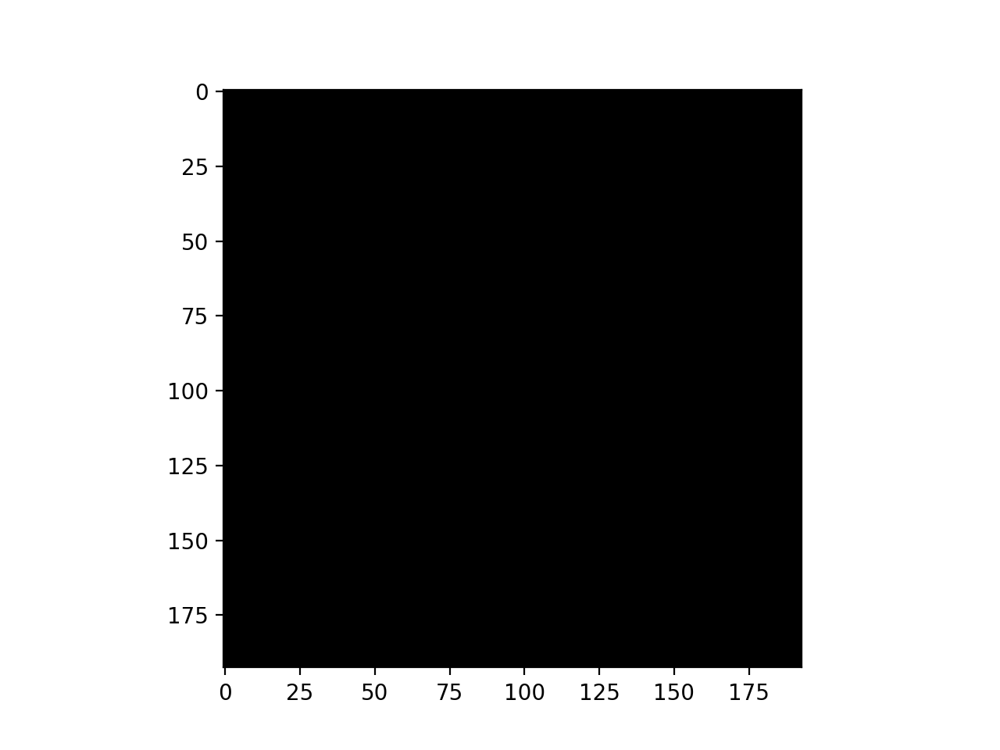

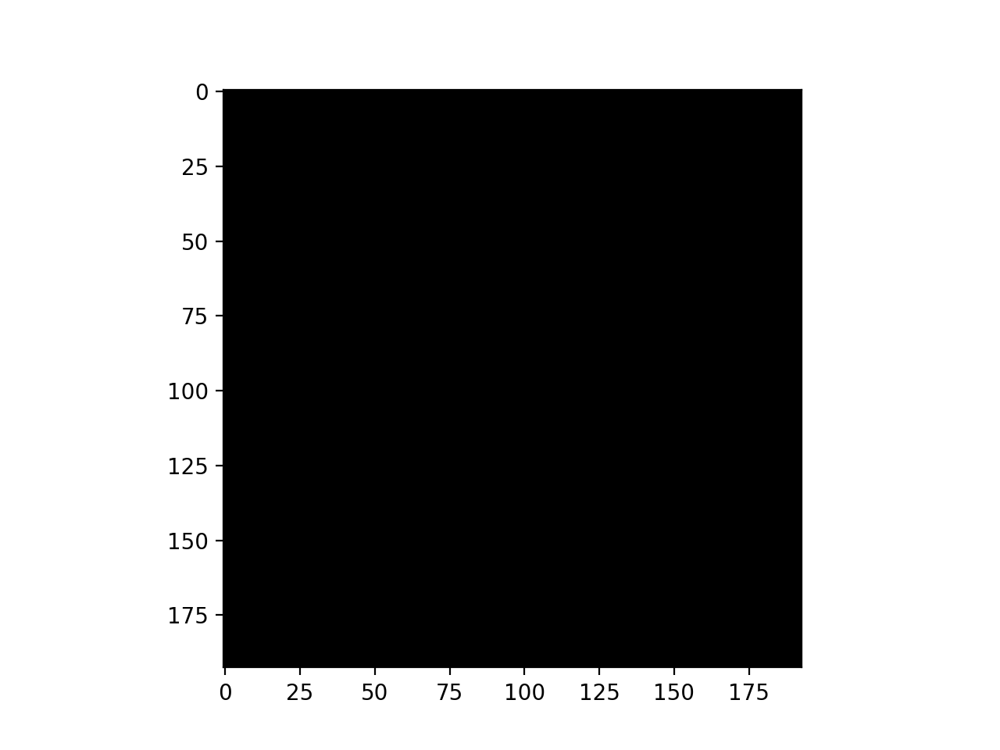

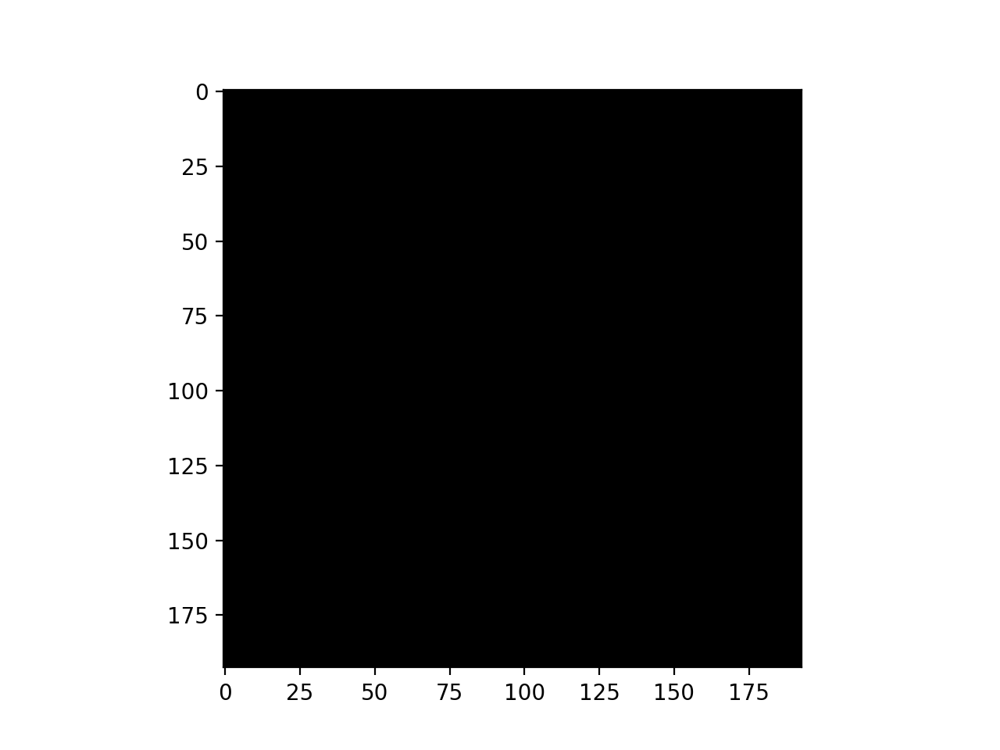

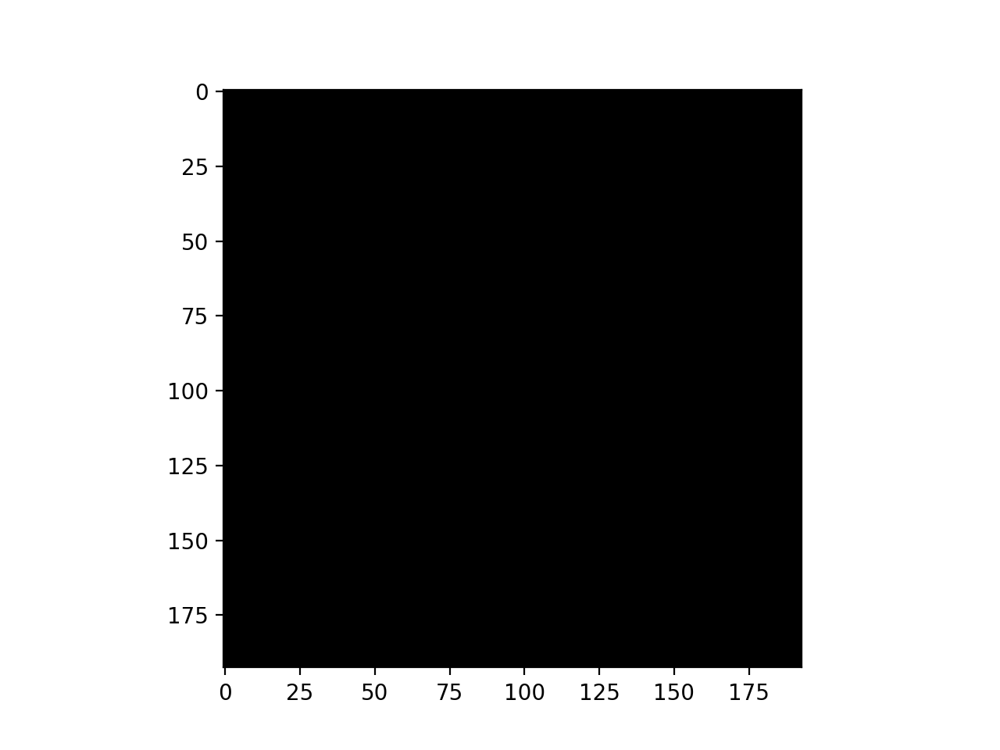

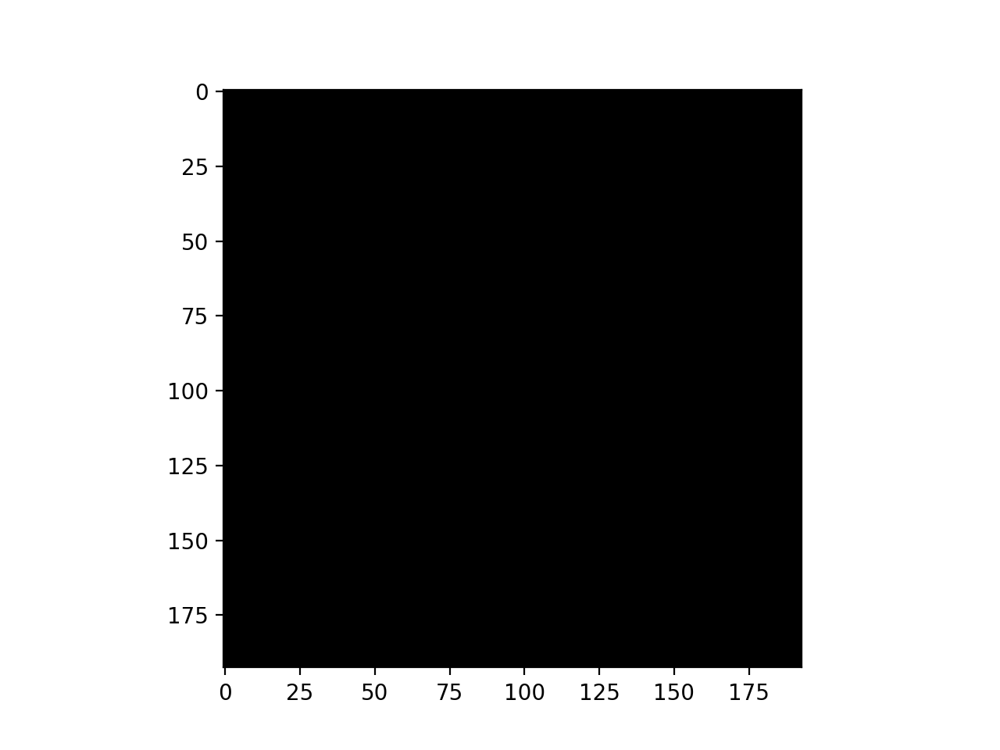

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-07 06:43:06.972846: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:43:06.973102: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 06:43:06.973217: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-07 06:43:19.371747: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-07 06:43:19.688868: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/conv3d_7/kernel/v/Assign' id:2130 op device:{requested: '', assigned: ''} def:{{{node training/Adam/conv3d_7/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=fals

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 1.1043 - accuracy: 0.5246 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-07 06:58:31.683938: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 1042s 15s/step - batch: 34.5000 - size: 31.9429 - loss: 1.1044 - accuracy: 0.5246 - val_loss: 0.6950 - val_accuracy: 0.4964
Epoch 2/50
70/70 [==============================] - 972s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7667 - accuracy: 0.6288 - val_loss: 0.7984 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 954s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7013 - accuracy: 0.6530 - val_loss: 0.6255 - val_accuracy: 0.7214
Epoch 4/50
70/70 [==============================] - 964s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6719 - accuracy: 0.6919 - val_loss: 0.6225 - val_accuracy: 0.6321
Epoch 5/50
70/70 [==============================] - 1009s 15s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6098 - accuracy: 0.7151 - val_loss: 0.6627 - val_accuracy: 0.6357
Epoch 6/50
70/70 [==============================] - 946s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6151 - accuracy: 0.7026 -

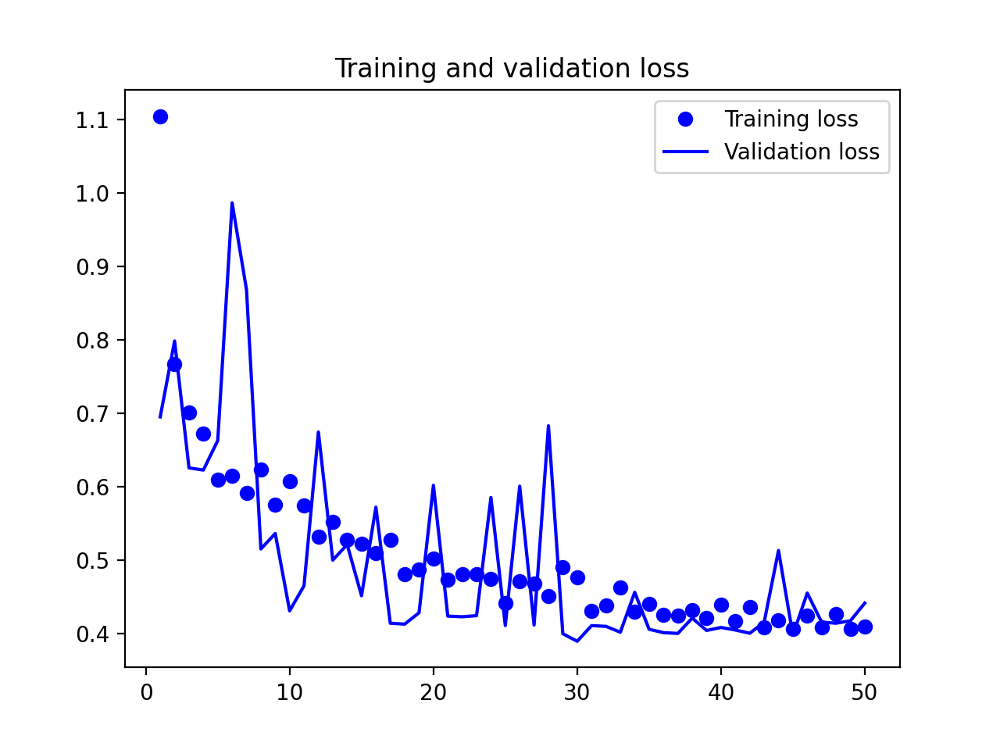

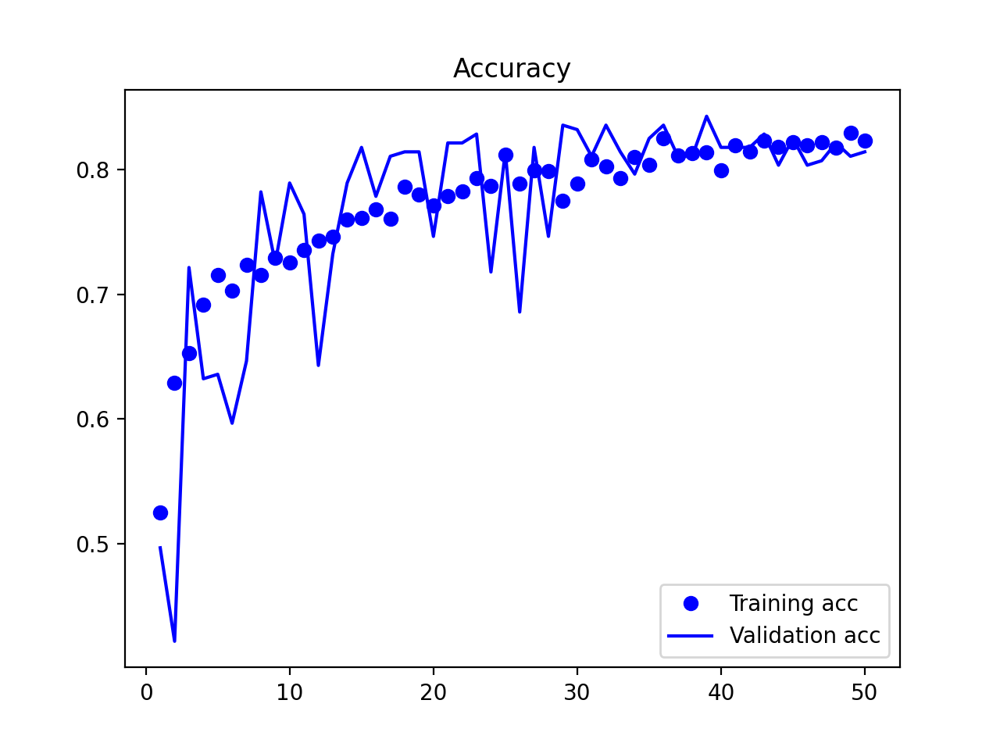

2024-06-07 20:12:00.576583: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:12:00.583565: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:12:00.583743: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.958
Acc for AD vs. CN = 90.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

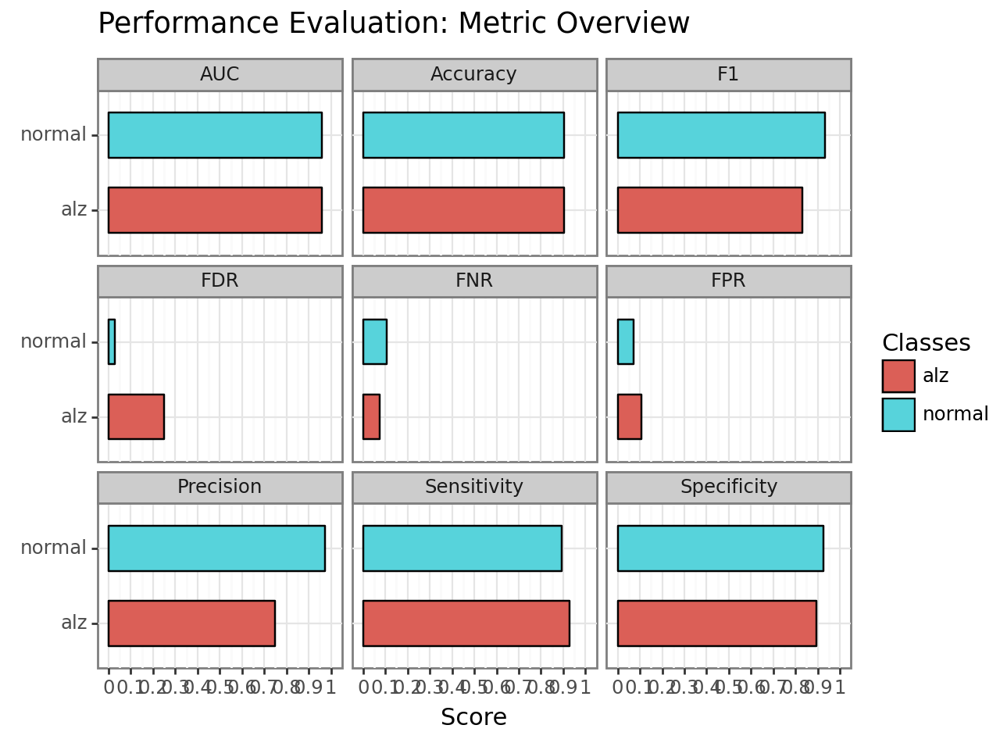

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv02/plot.performance.confusion_matrix.png


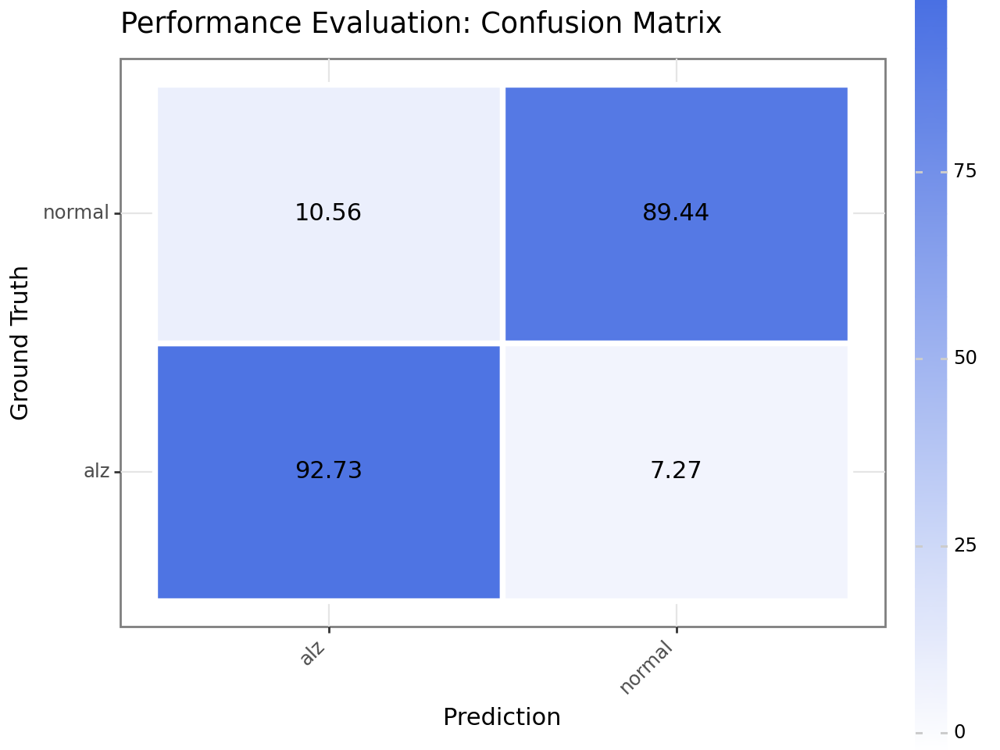

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv02/plot.performance.roc.png


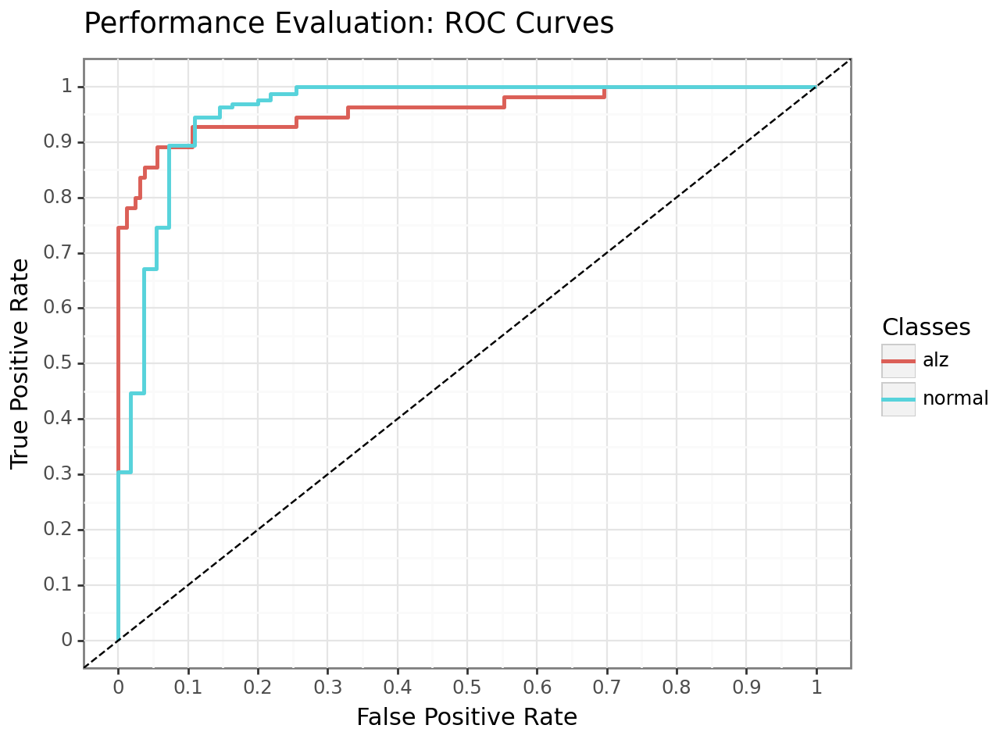


AUC for MCI vs. CN = 0.814
Acc for MCI vs. CN = 82.1


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

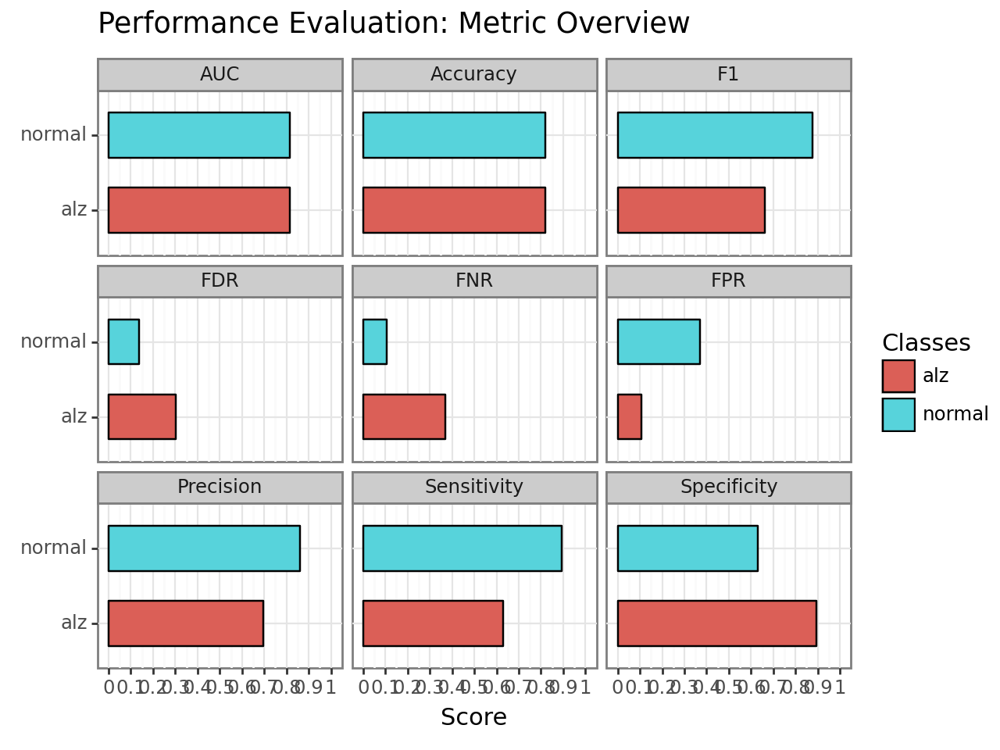

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv02/plot.performance.confusion_matrix.png


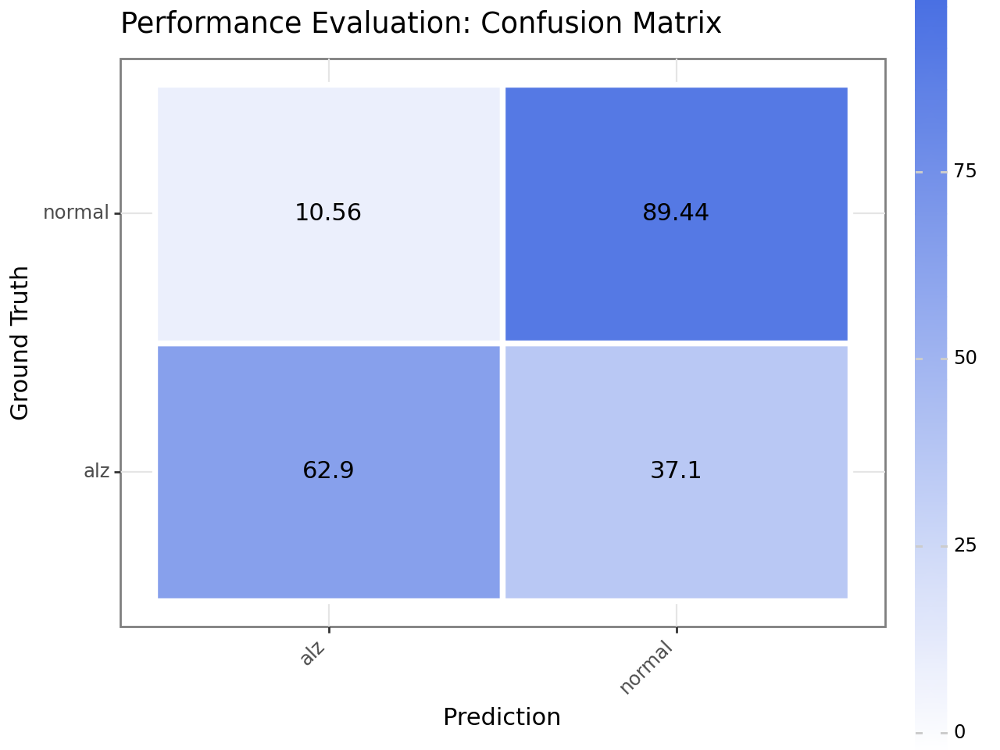

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv02/plot.performance.roc.png


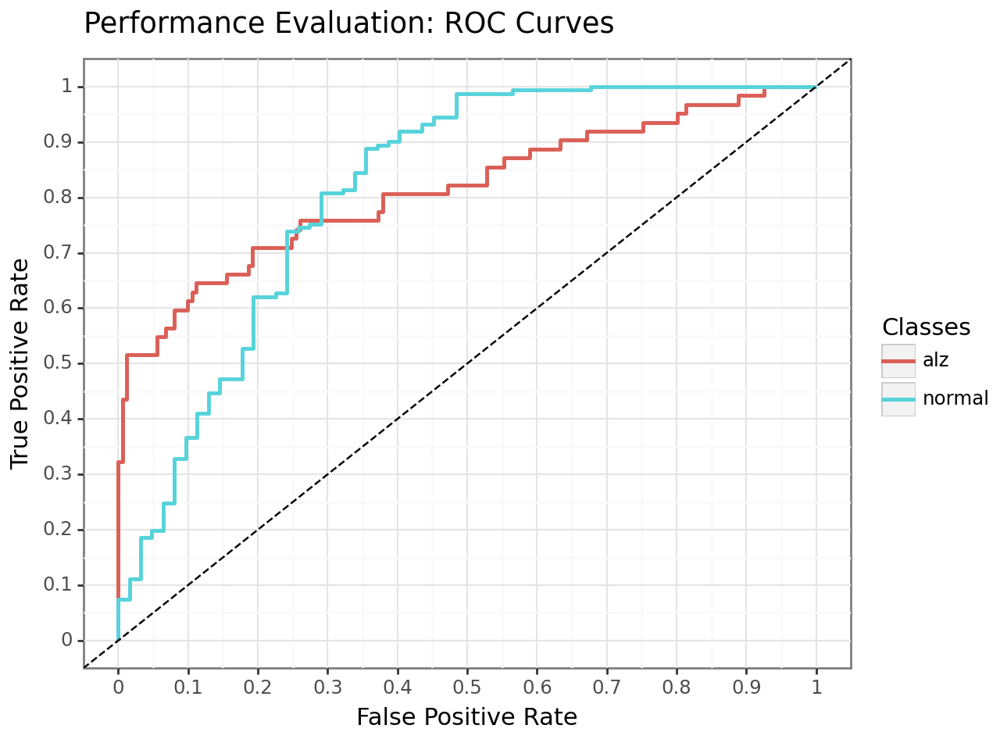

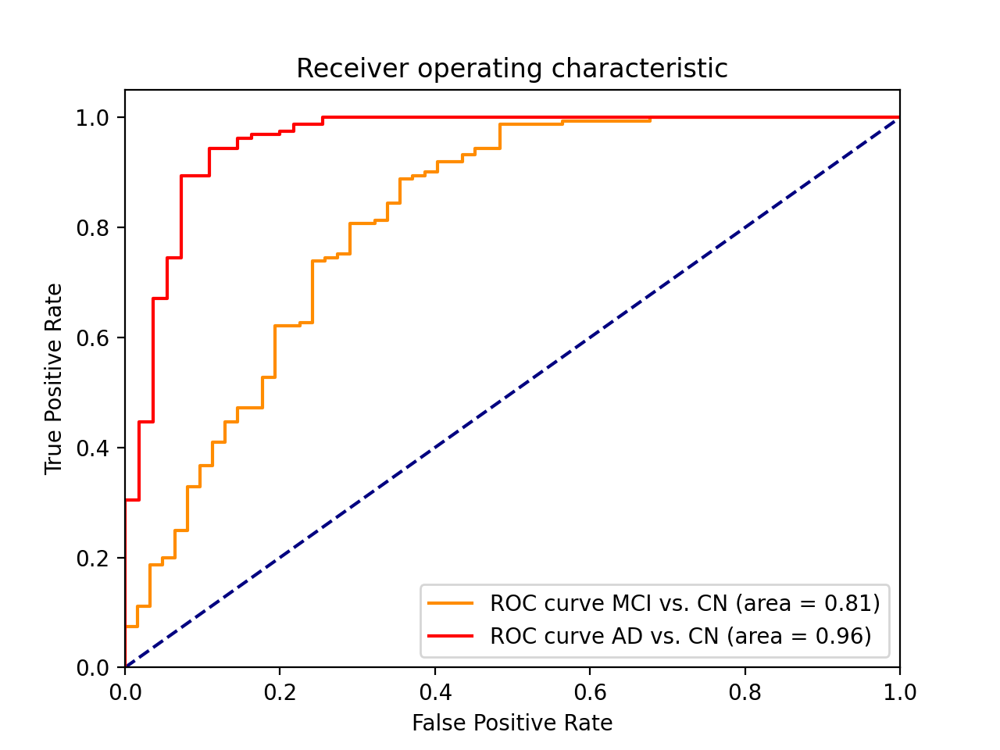

2024-06-07 20:13:45.080606: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:13:45.080863: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:13:45.080978: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

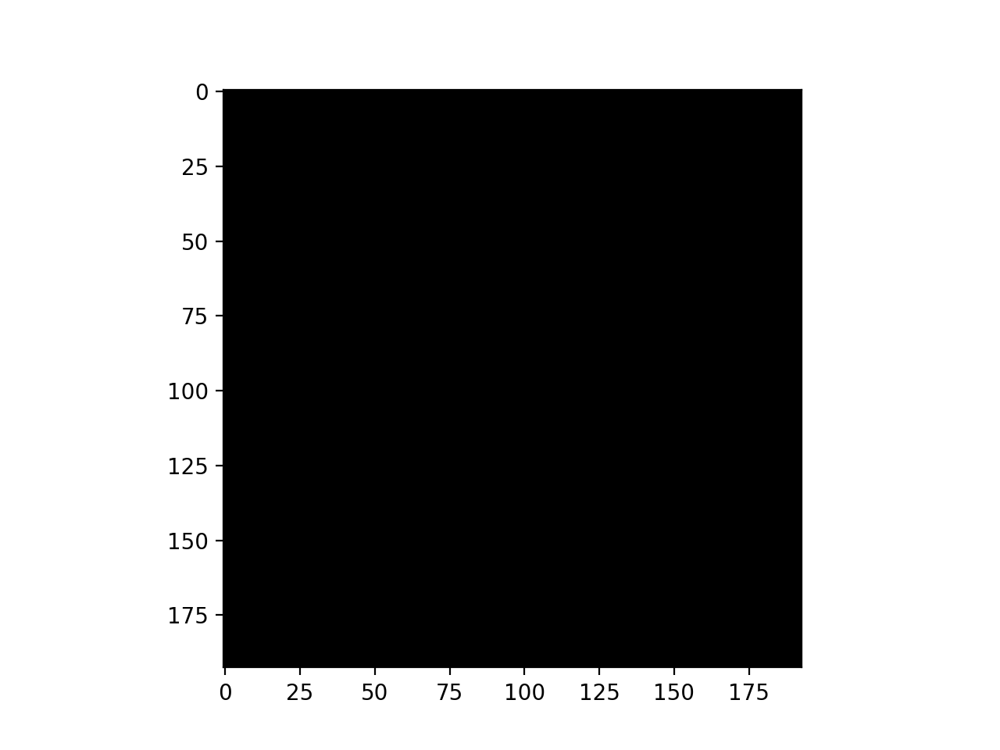

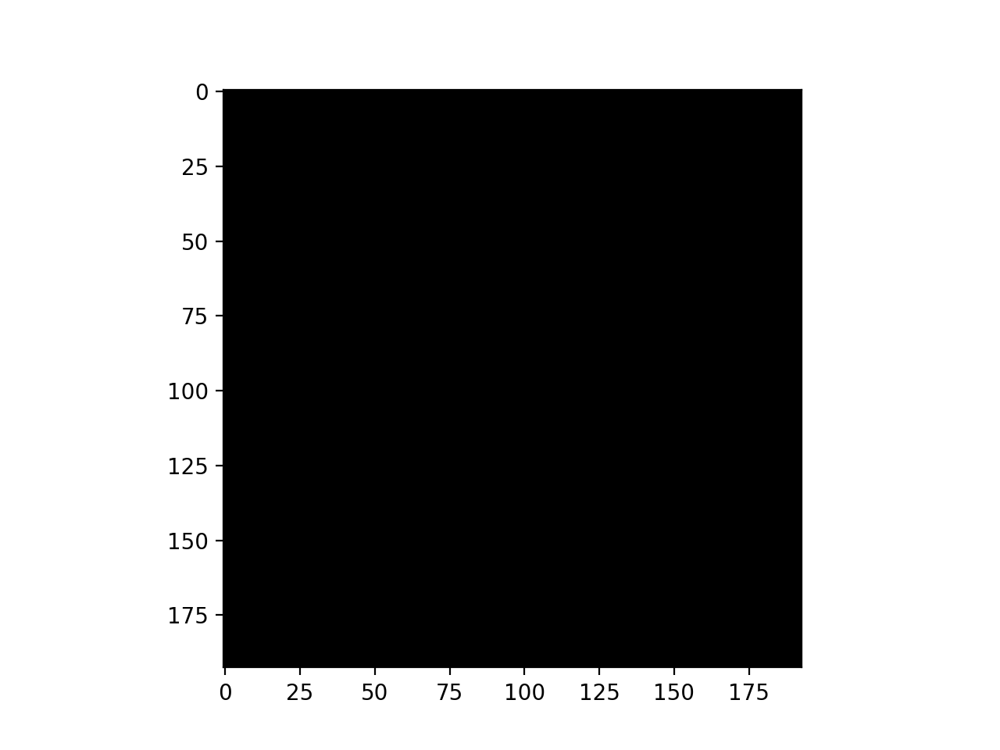

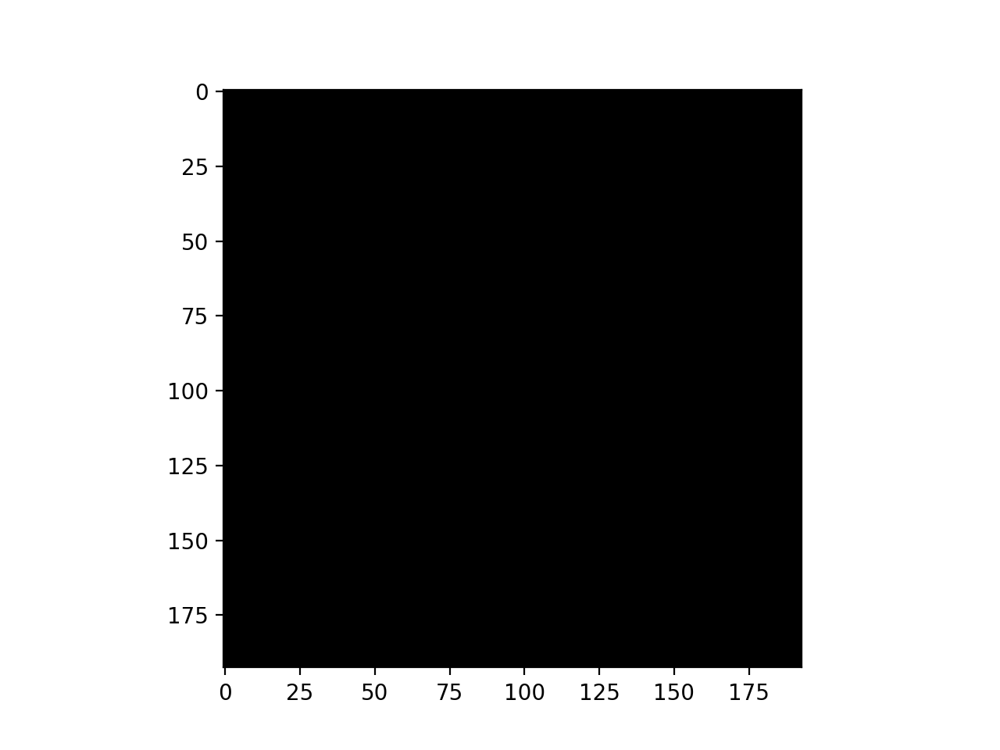

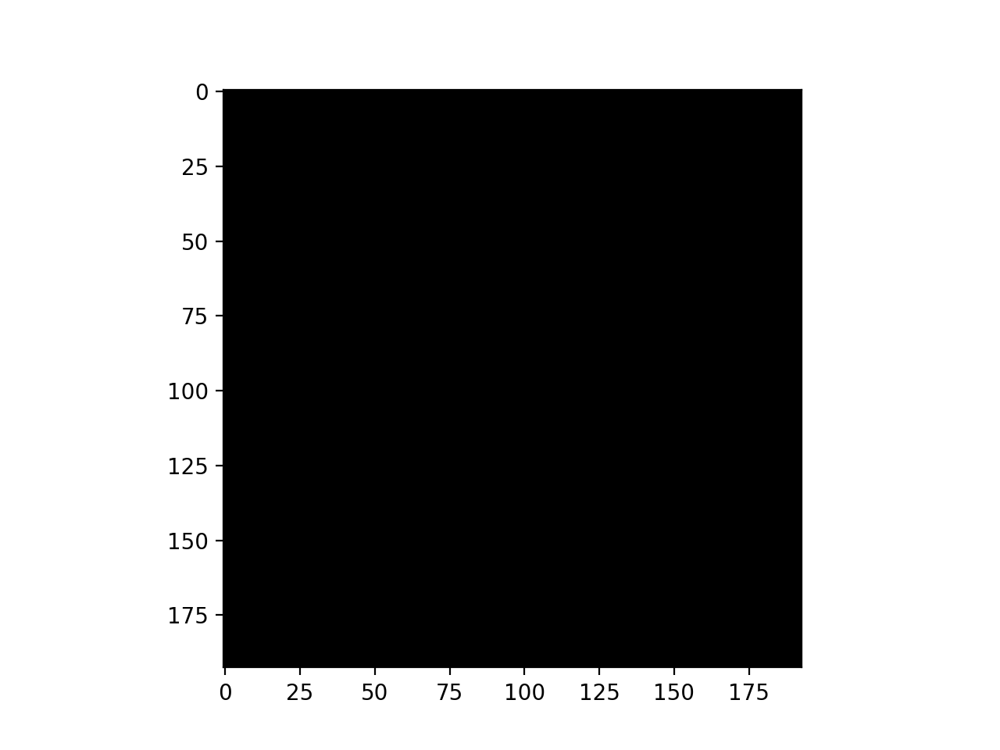

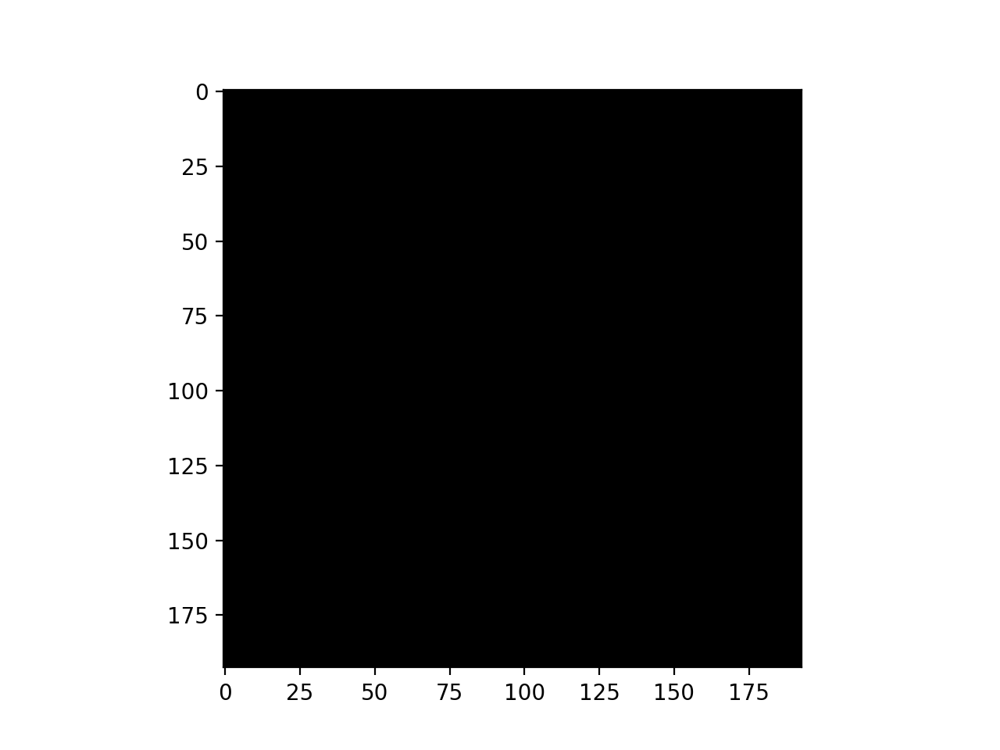

...

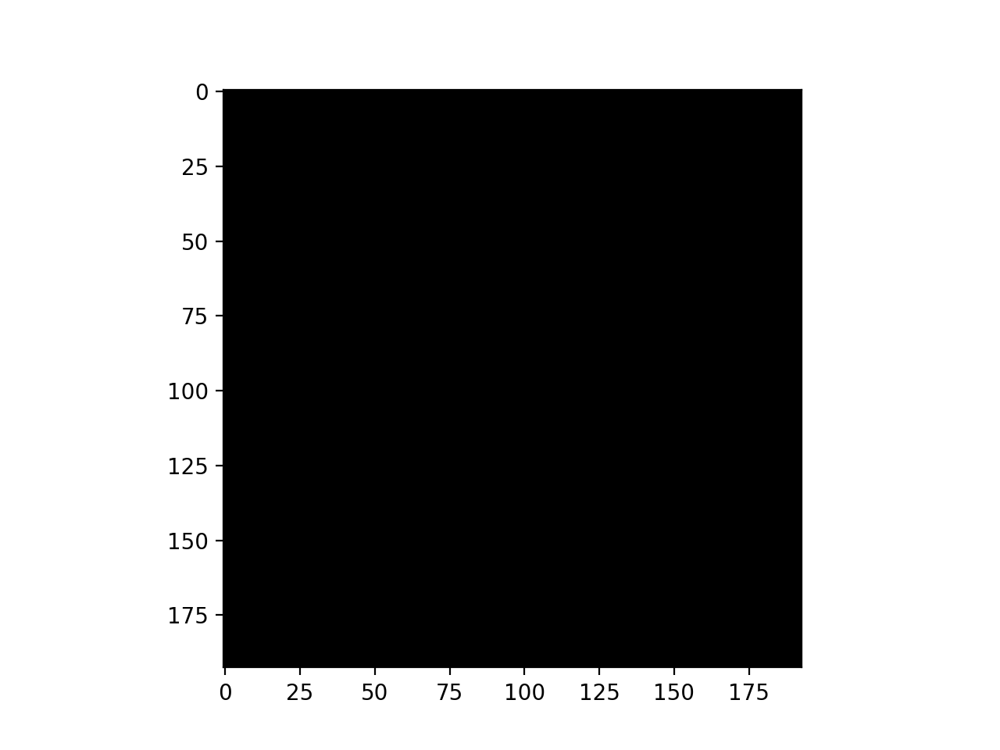

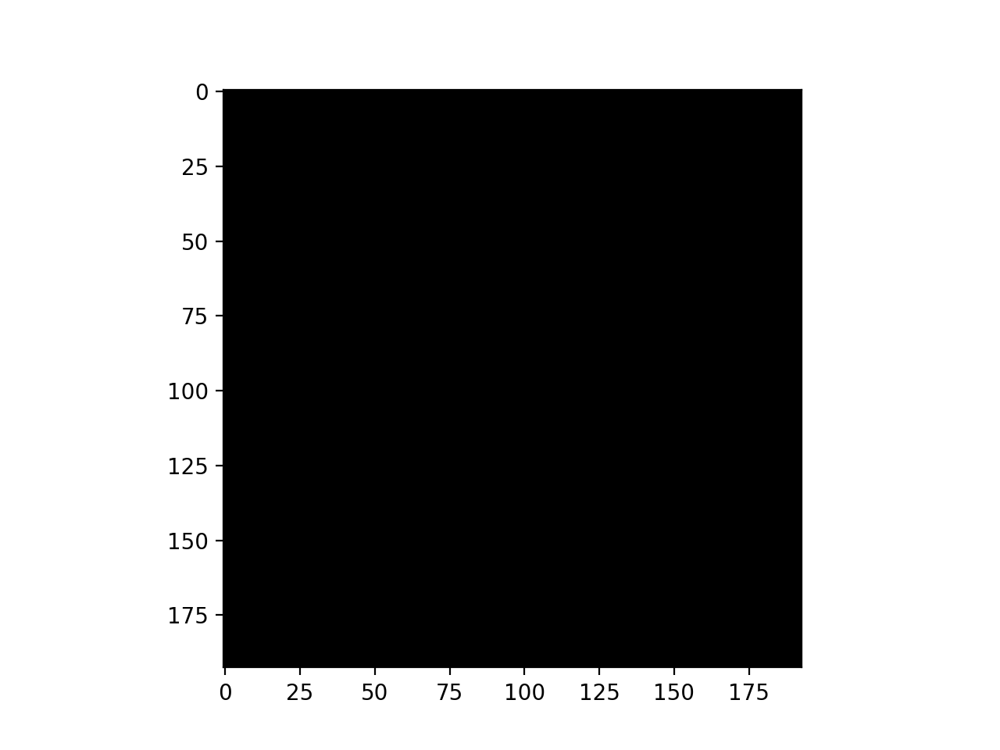

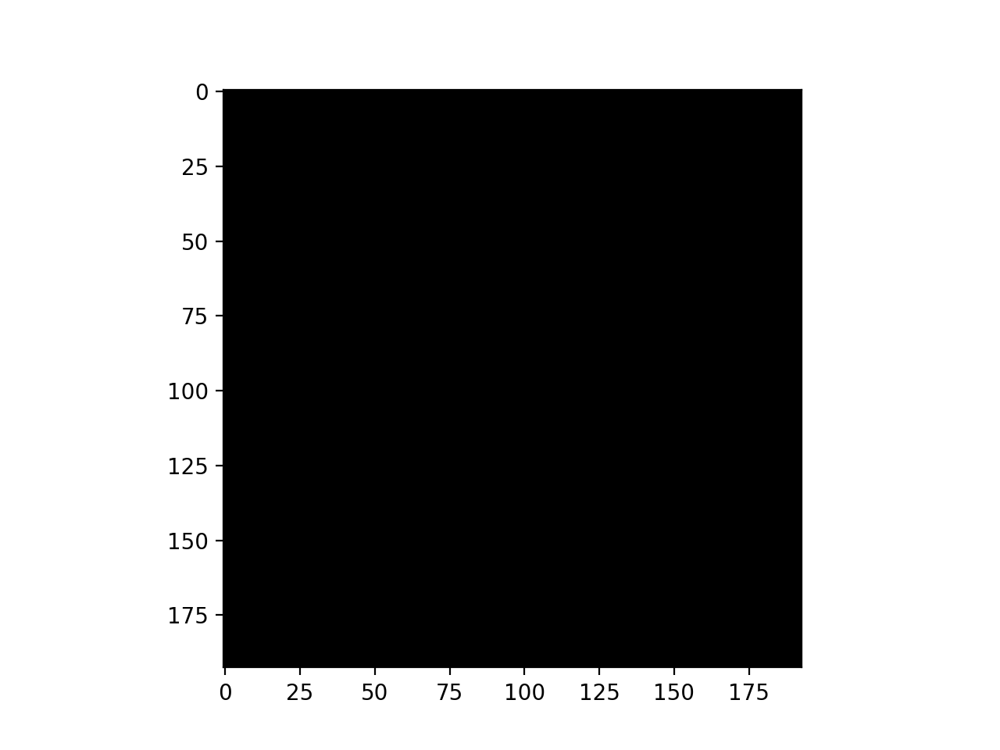

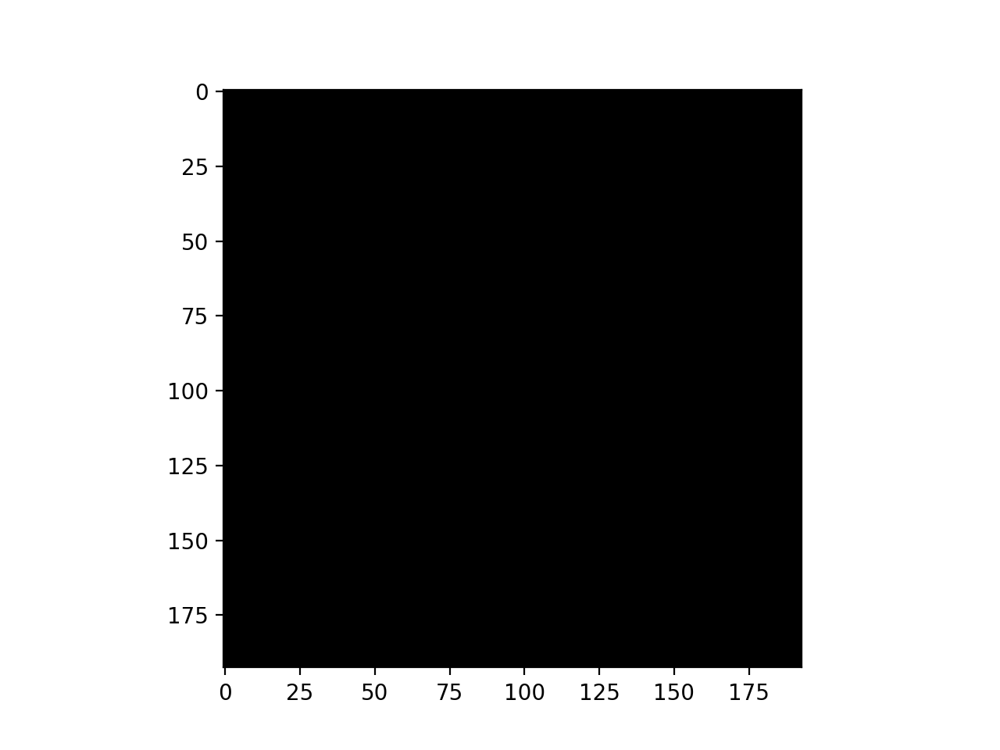

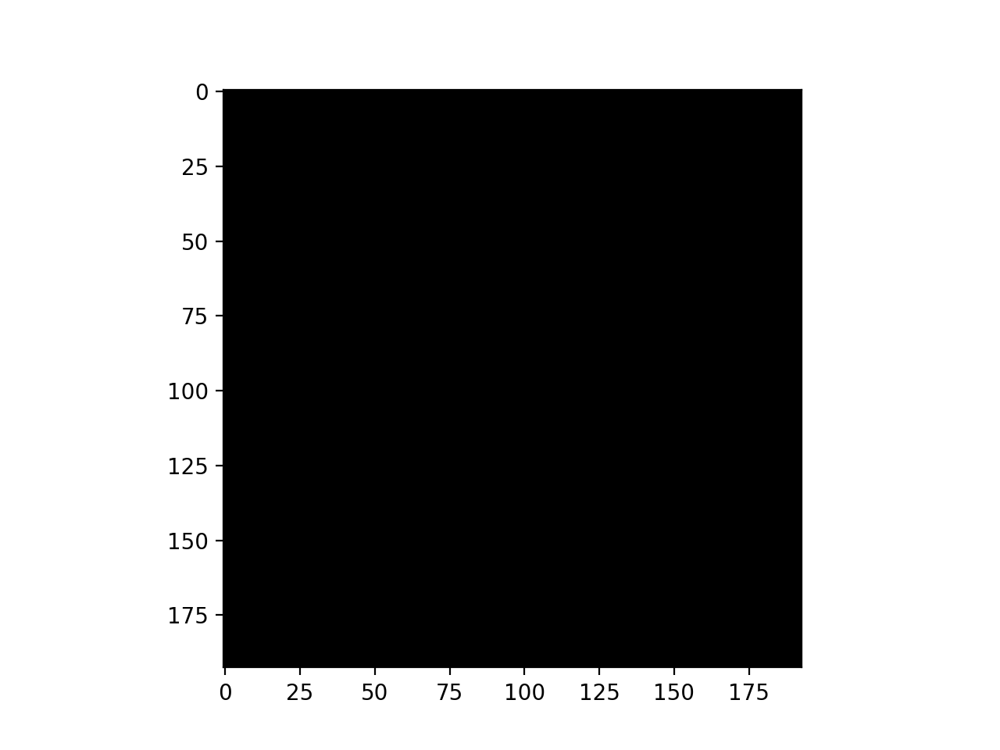

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-07 20:16:32.441926: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:16:32.442175: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-07 20:16:32.442291: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-07 20:16:48.769823: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-07 20:16:49.122510: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/conv3d_3/bias/v/Assign' id:2051 op device:{requested: '', assigned: ''} def:{{{node training/Adam/conv3d_3/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](t

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.9977 - accuracy: 0.5631 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-07 20:31:47.554300: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 994s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.9977 - accuracy: 0.5631 - val_loss: 0.6915 - val_accuracy: 0.5143
Epoch 2/50
70/70 [==============================] - 929s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7101 - accuracy: 0.6422 - val_loss: 0.6445 - val_accuracy: 0.6607
Epoch 3/50
70/70 [==============================] - 912s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6757 - accuracy: 0.6852 - val_loss: 0.5882 - val_accuracy: 0.7250
Epoch 4/50
70/70 [==============================] - 932s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6207 - accuracy: 0.7066 - val_loss: 0.4958 - val_accuracy: 0.7857
Epoch 5/50
70/70 [==============================] - 948s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6158 - accuracy: 0.7089 - val_loss: 0.4710 - val_accuracy: 0.8000
Epoch 6/50
70/70 [==============================] - 929s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.5815 - accuracy: 0.7335 - v

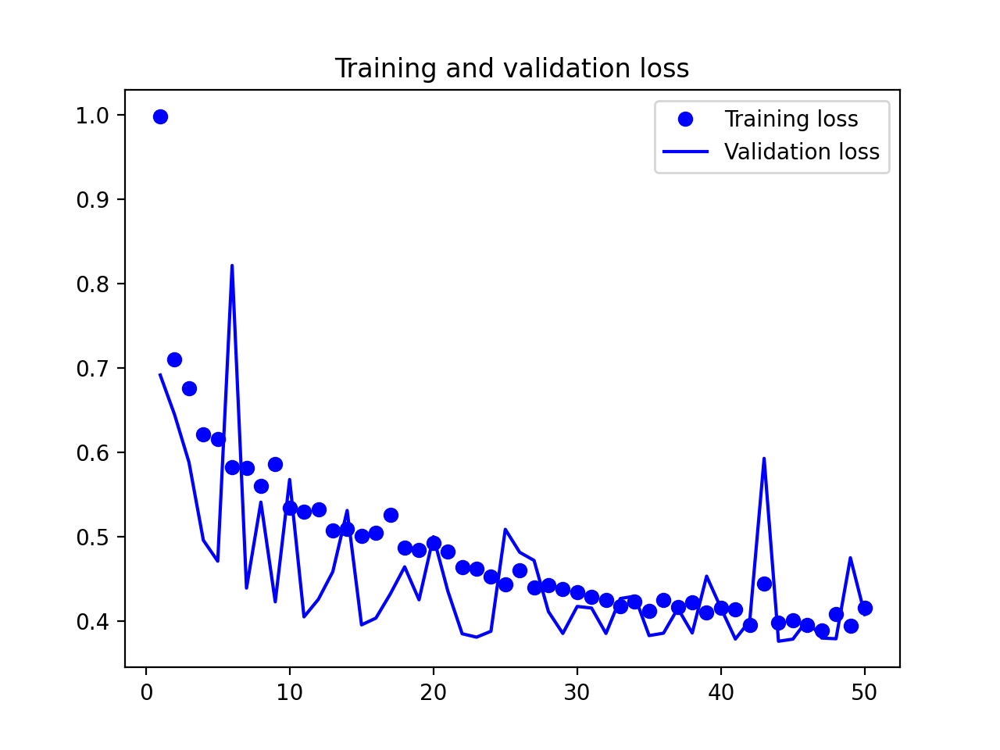

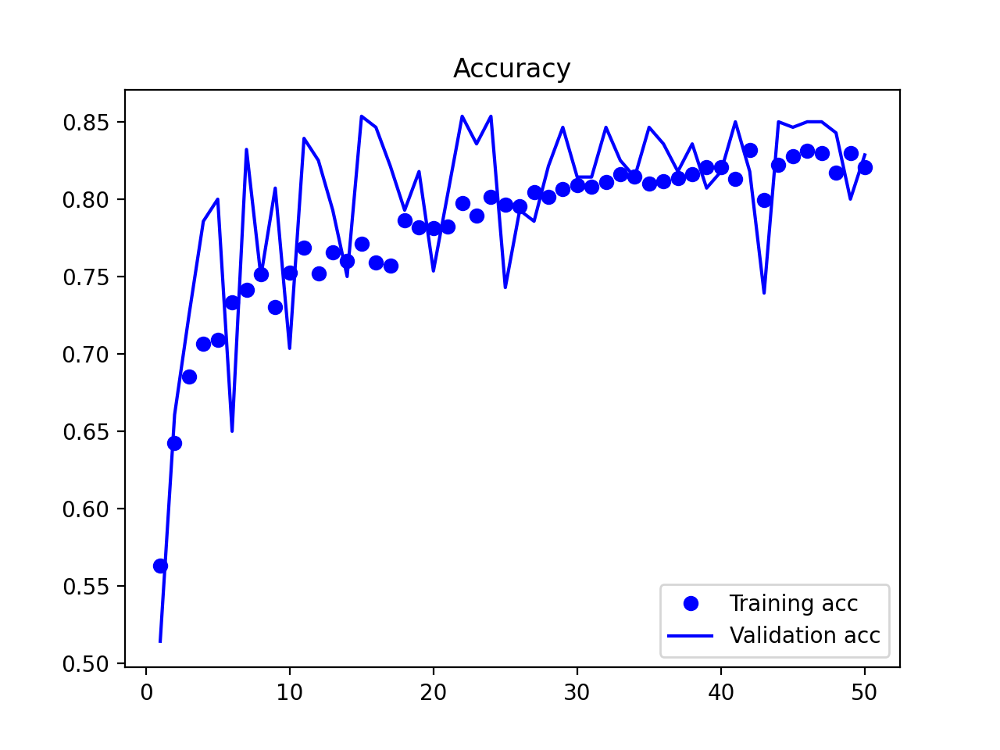

2024-06-08 09:20:05.559012: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:20:05.559569: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:20:05.559737: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.919
Acc for AD vs. CN = 83.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

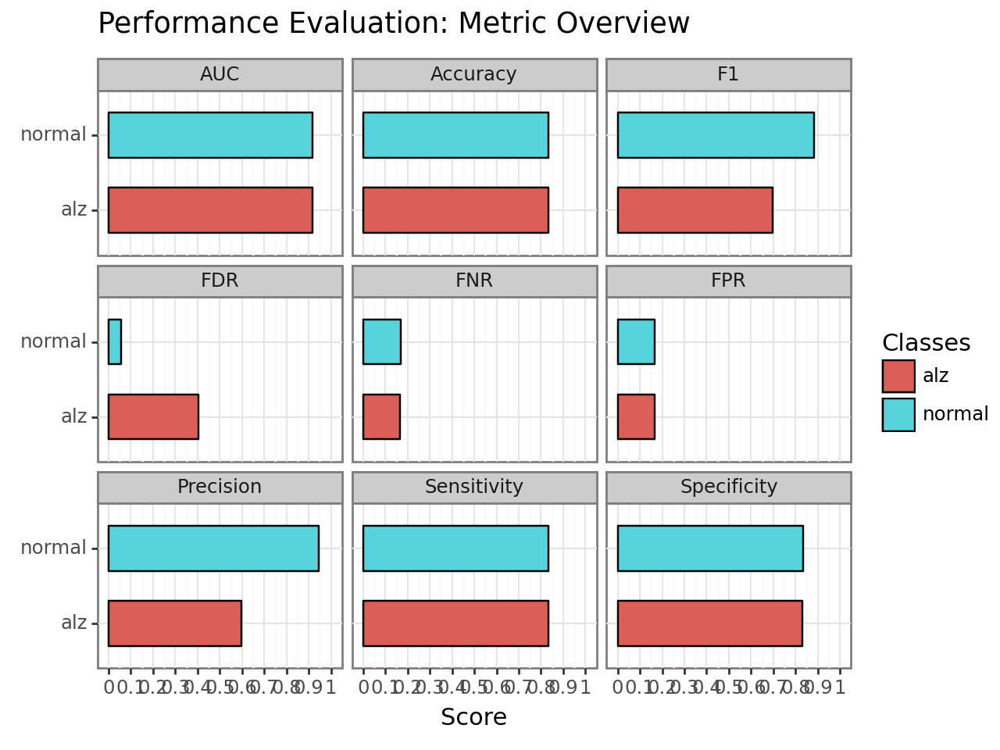

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv03/plot.performance.confusion_matrix.png


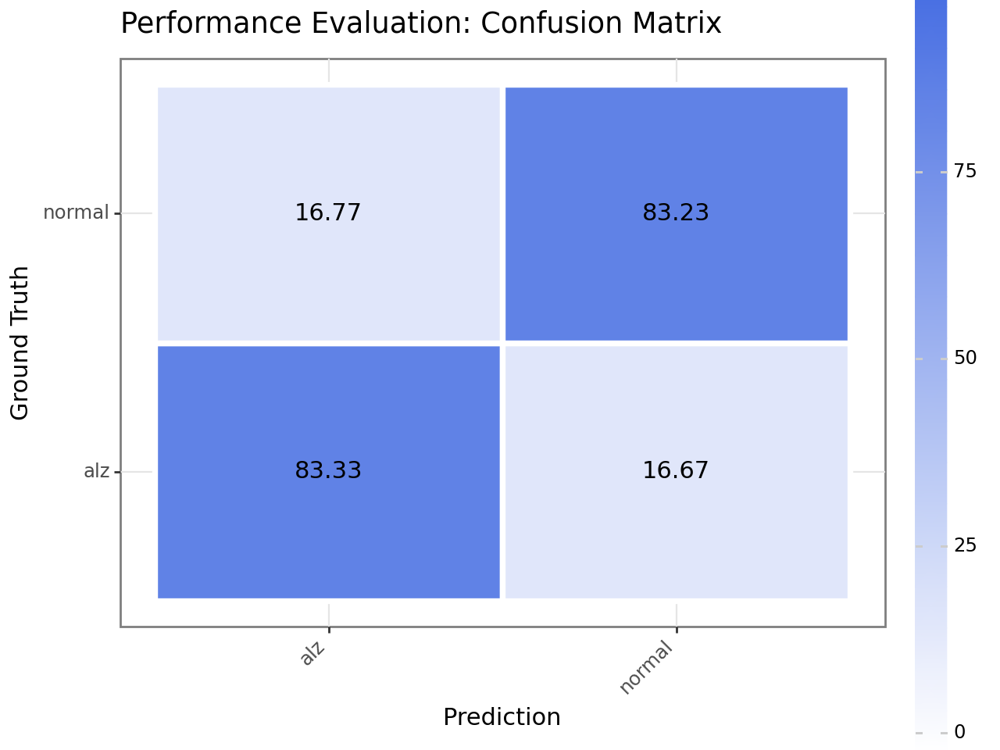

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv03/plot.performance.roc.png


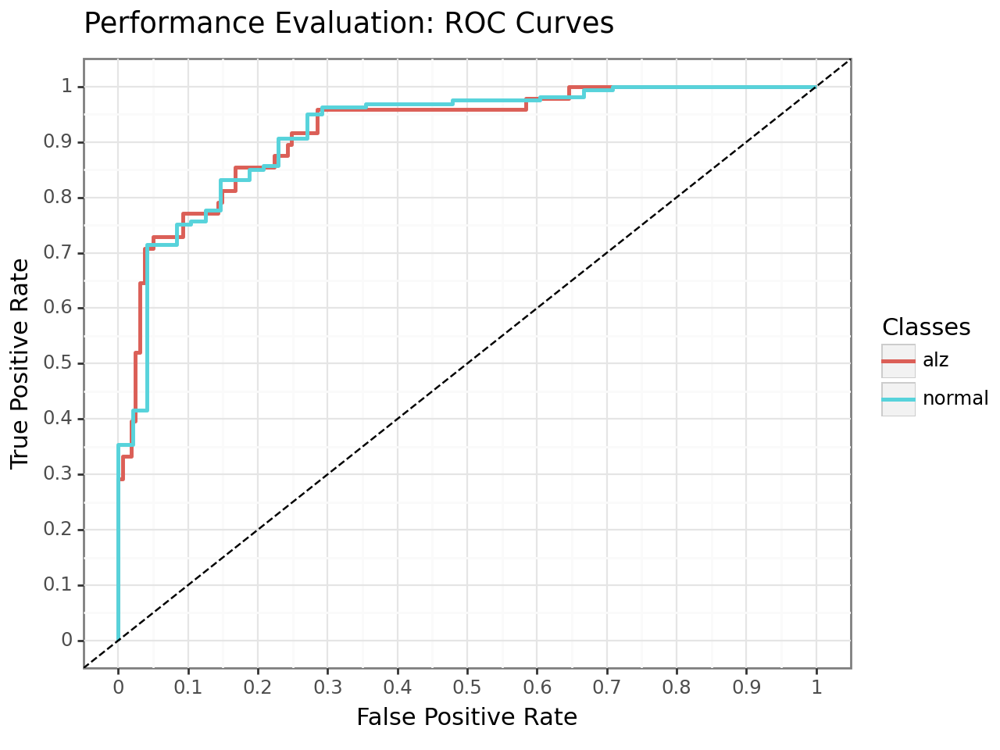


AUC for MCI vs. CN = 0.751
Acc for MCI vs. CN = 74.8


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

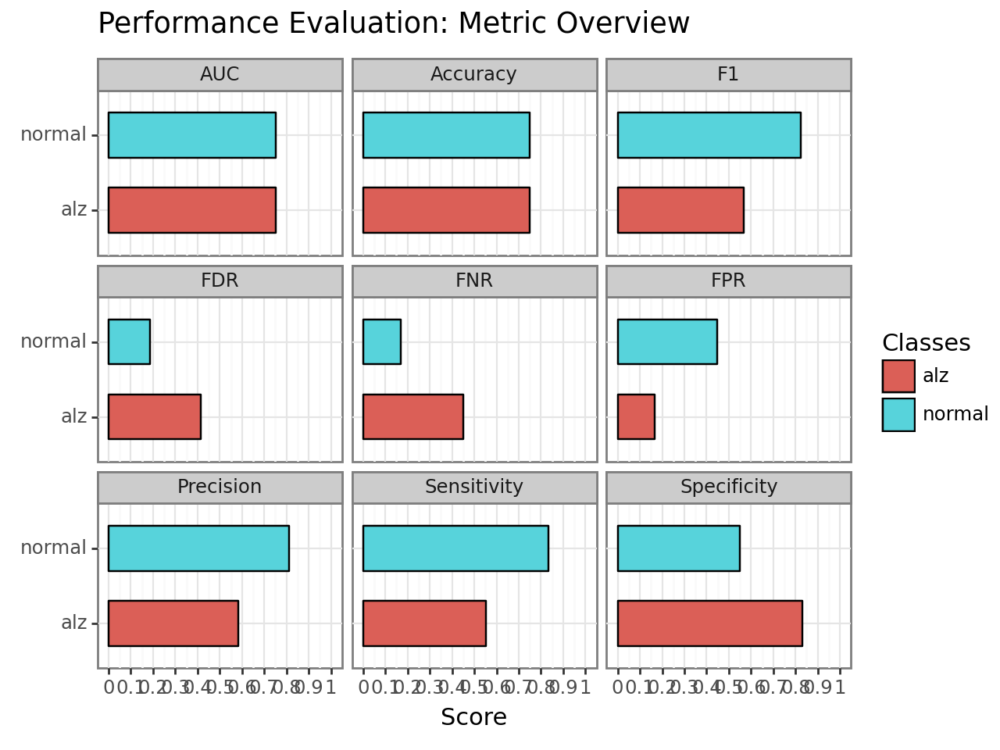

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv03/plot.performance.confusion_matrix.png


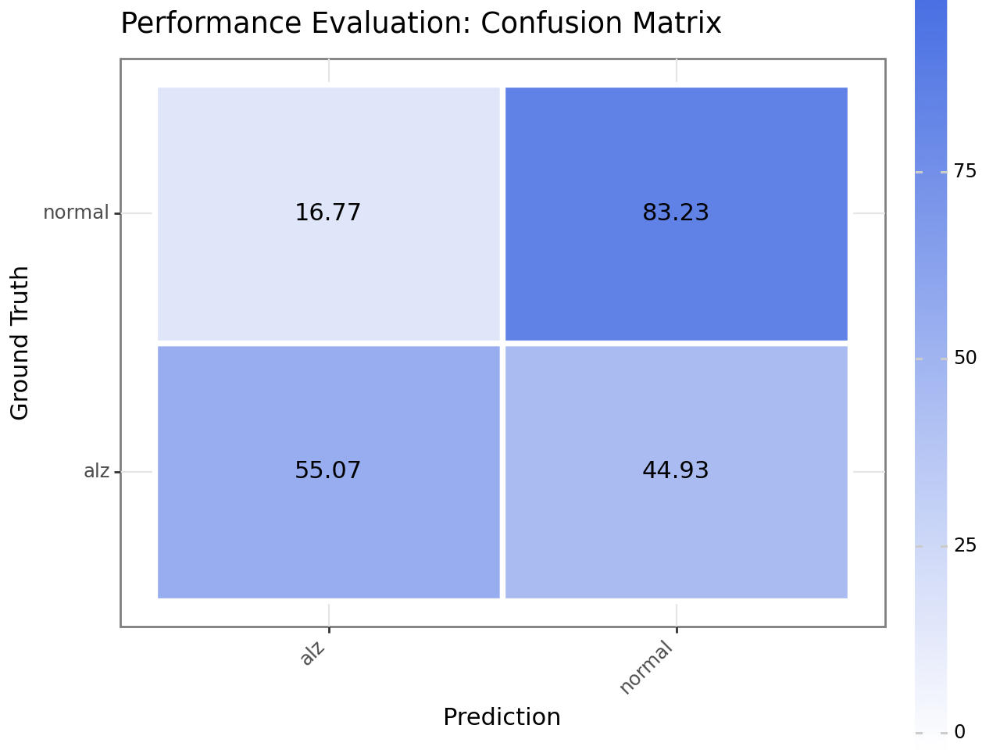

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv03/plot.performance.roc.png


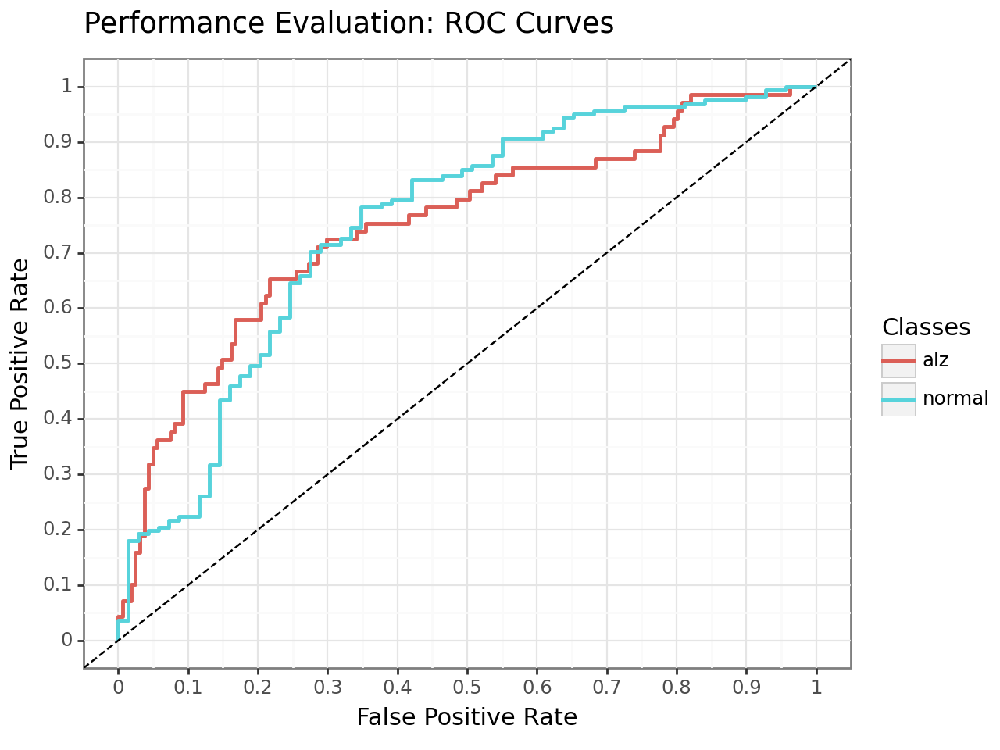

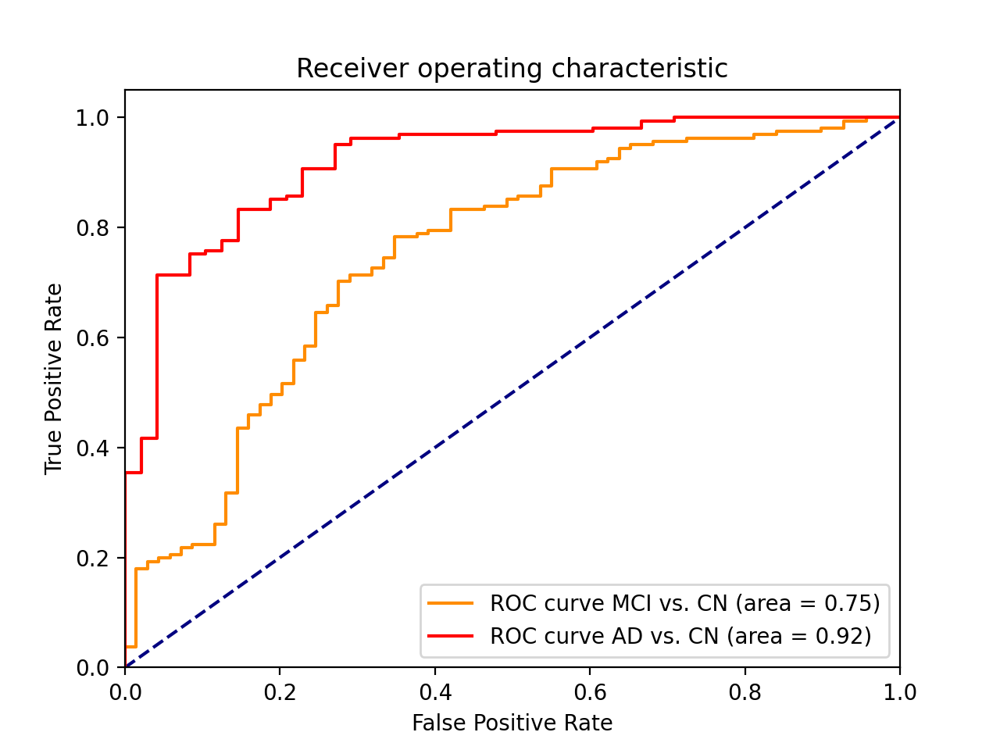

2024-06-08 09:21:35.959823: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:21:35.960064: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:21:35.960180: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

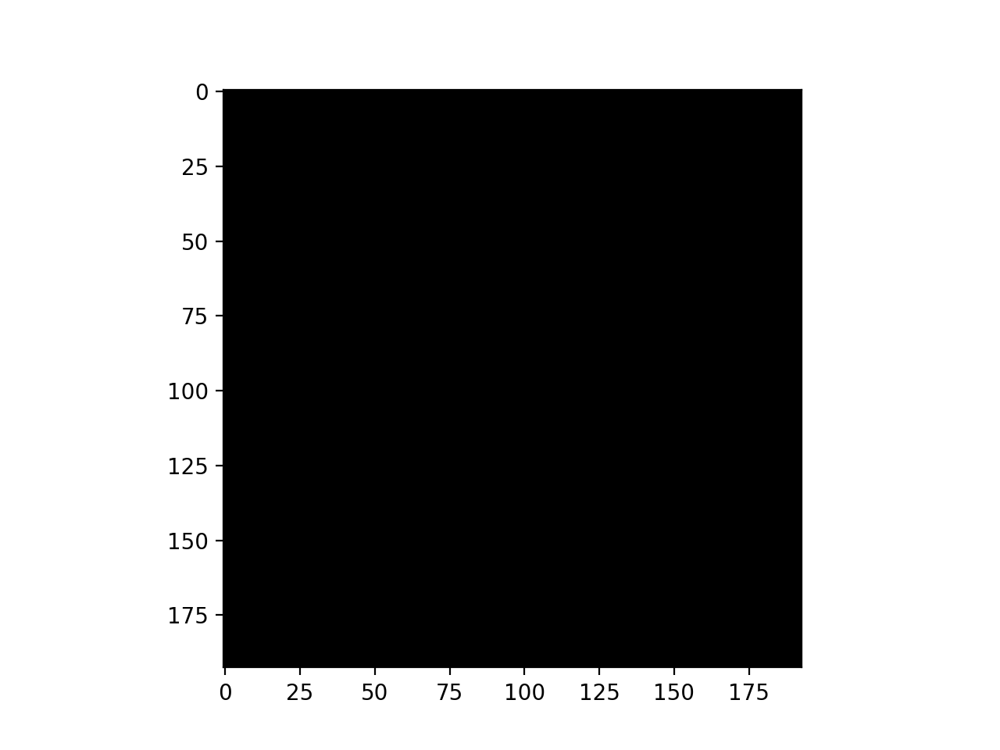

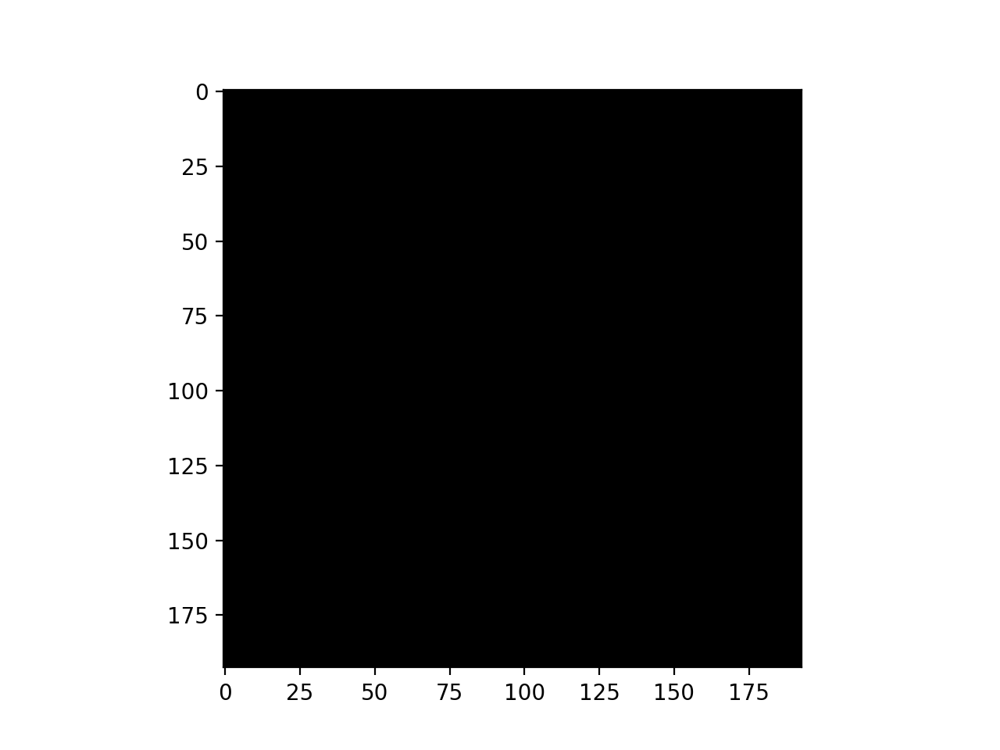

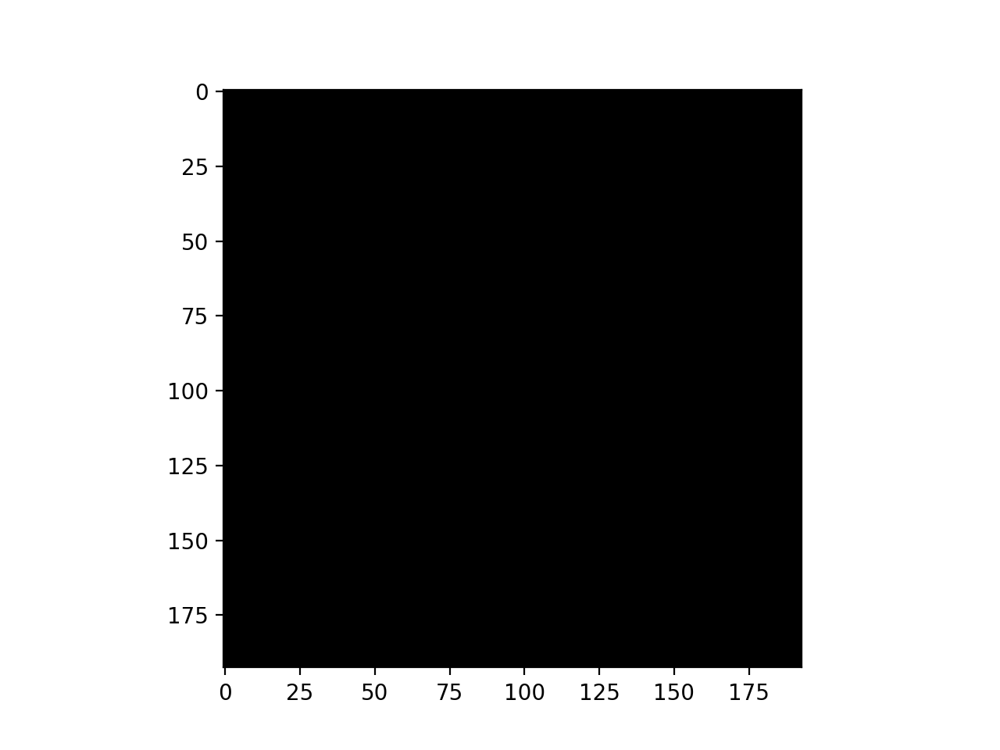

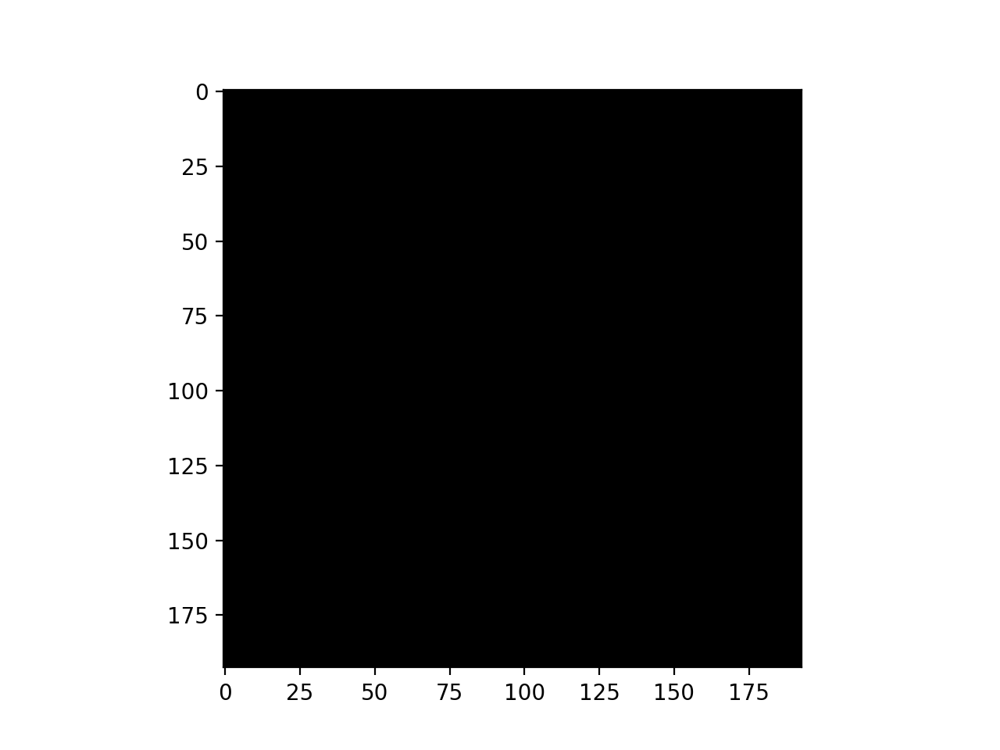

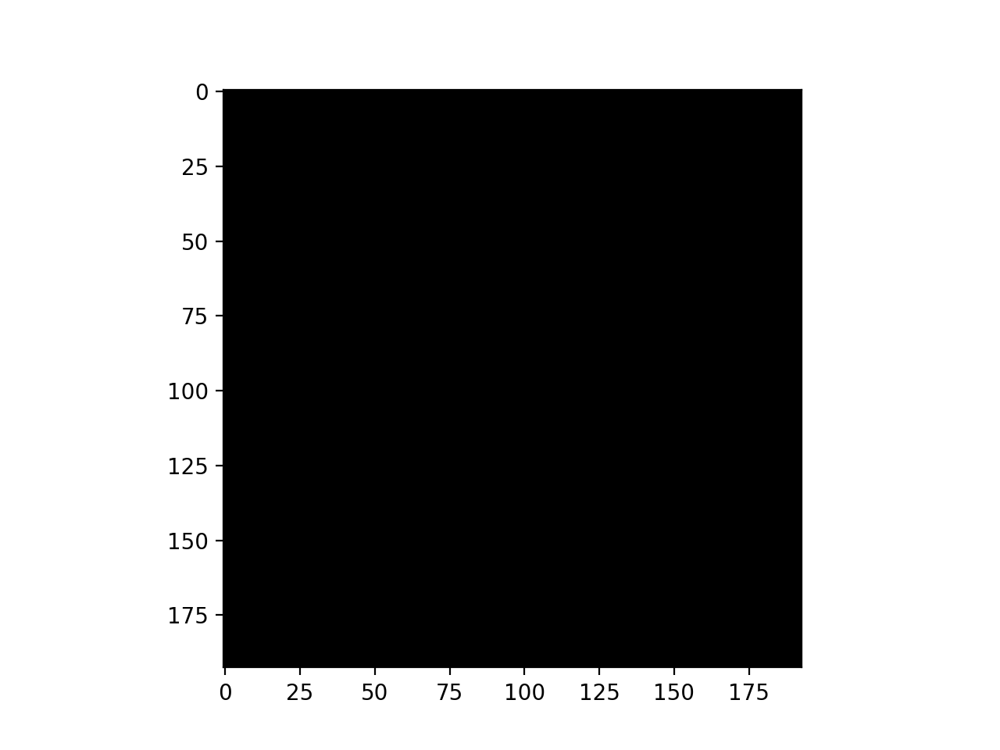

...

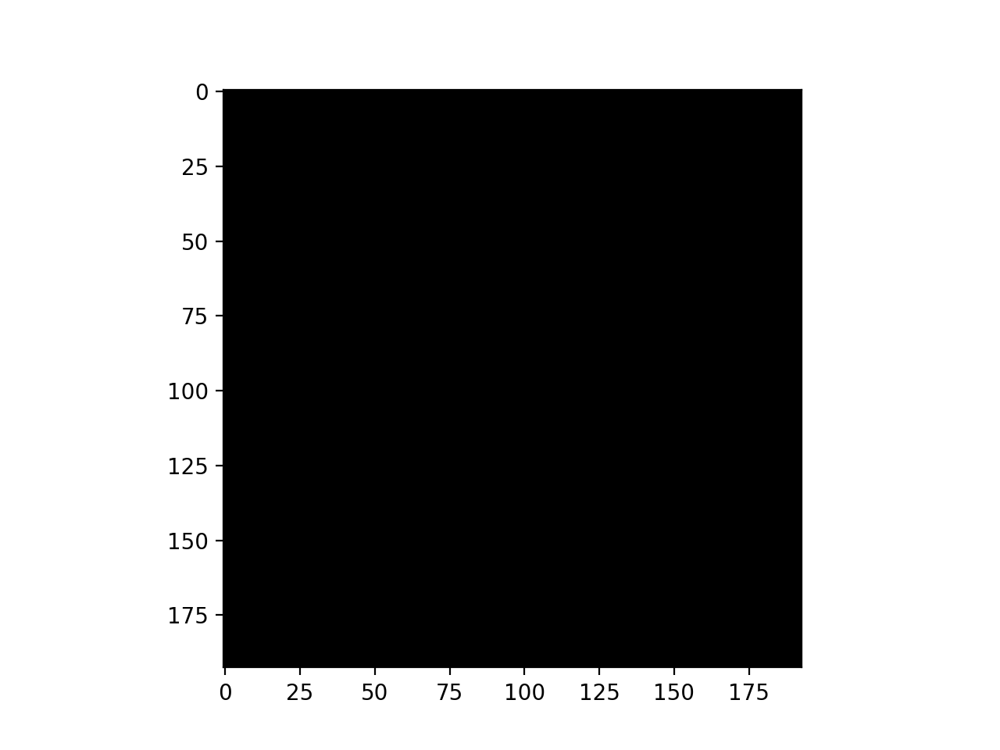

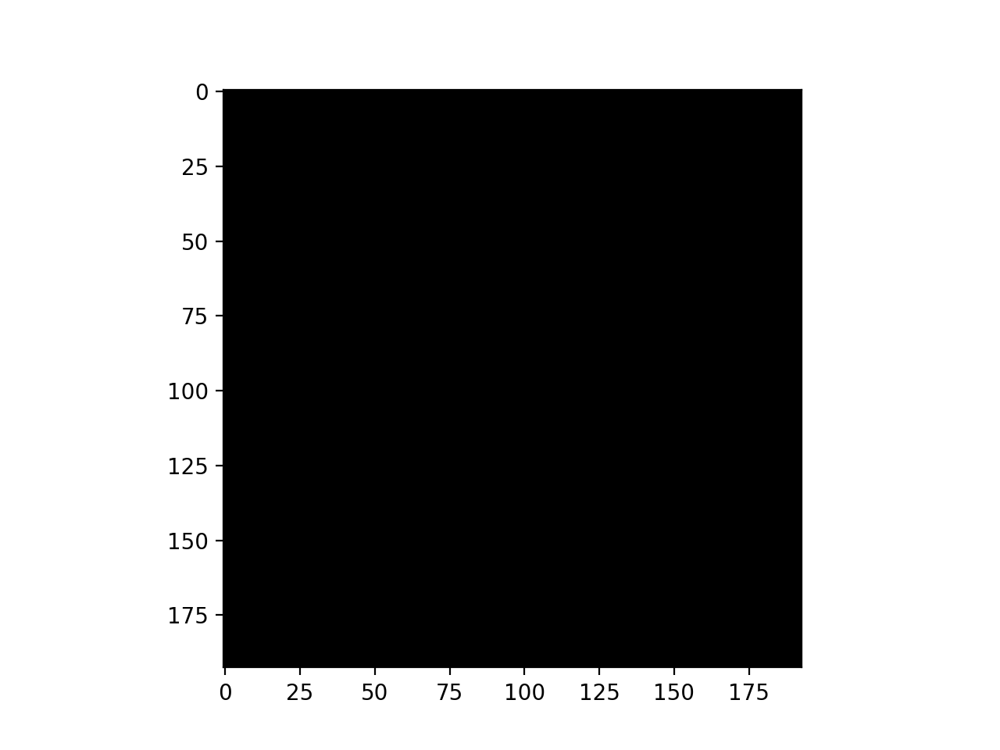

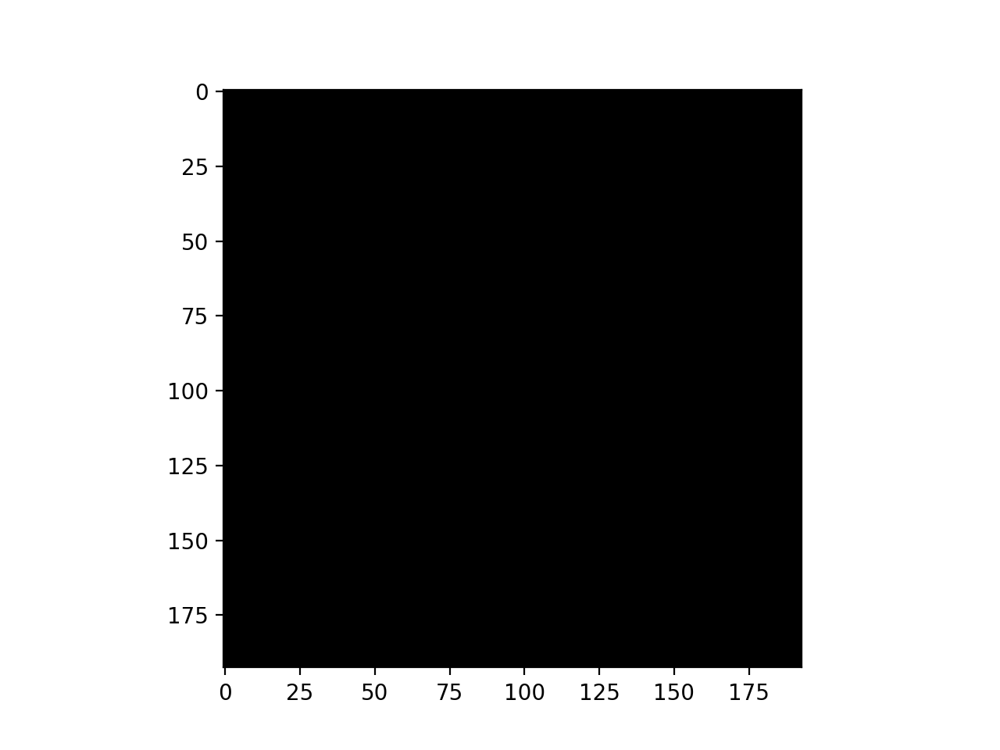

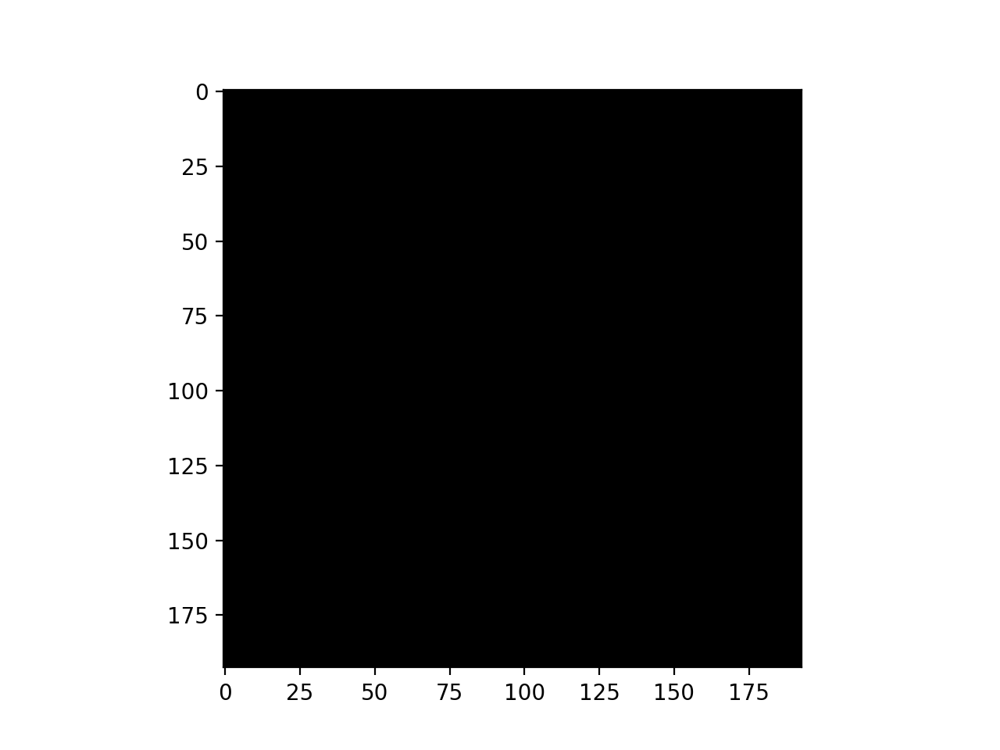

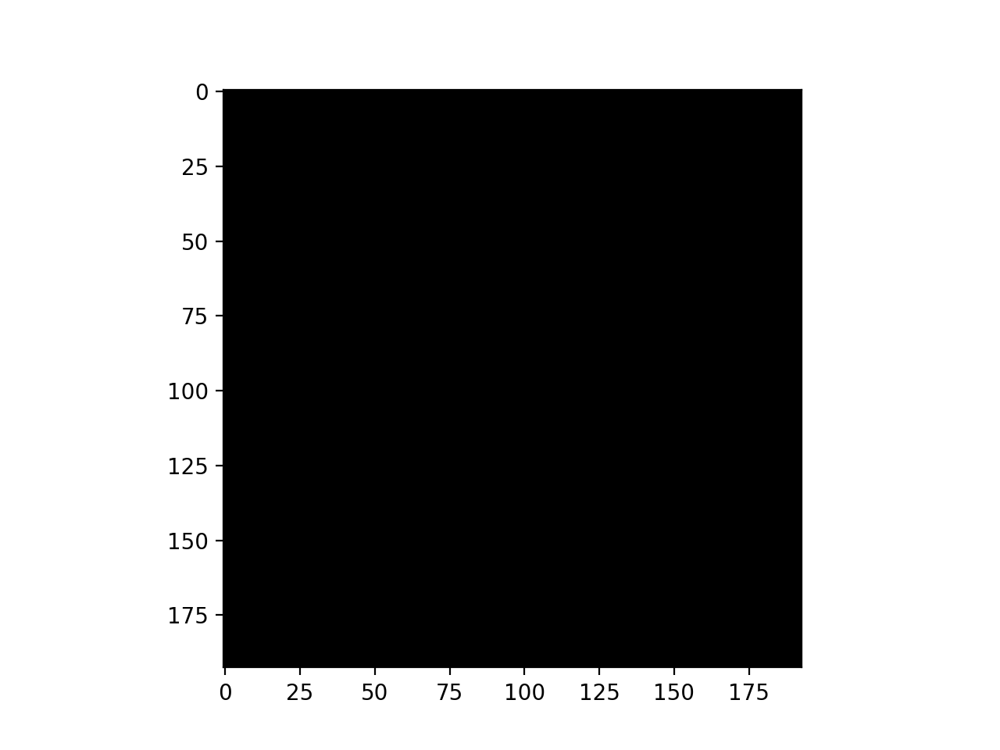

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-08 09:24:24.866973: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:24:24.867332: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-08 09:24:24.867488: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-08 09:24:41.077614: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-08 09:24:41.782729: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/batch_normalization_5/beta/v/Assign' id:2103 op device:{requested: '', assigned: ''} def:{{{node training/Adam/batch_normalization_5/beta/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOA

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 1.0367 - accuracy: 0.5604 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-08 09:39:47.407561: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

Epoch 1/50
70/70 [==============================] - 976s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 1.1401 - accuracy: 0.5501 - val_loss: 0.6854 - val_accuracy: 0.6536
Epoch 2/50
70/70 [==============================] - 888s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7718 - accuracy: 0.6275 - val_loss: 0.7831 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 894s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7901 - accuracy: 0.6503 - val_loss: 0.7317 - val_accuracy: 0.4214
Epoch 4/50
70/70 [==============================] - 896s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7088 - accuracy: 0.6869 - val_loss: 0.7139 - val_accuracy: 0.5071
Epoch 5/50
70/70 [==============================] - 896s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6447 - accuracy: 0.6986 - val_loss: 0.5788 - val_accuracy: 0.7071
Epoch 6/50
70/70 [==============================] - 911s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6446 - accuracy:

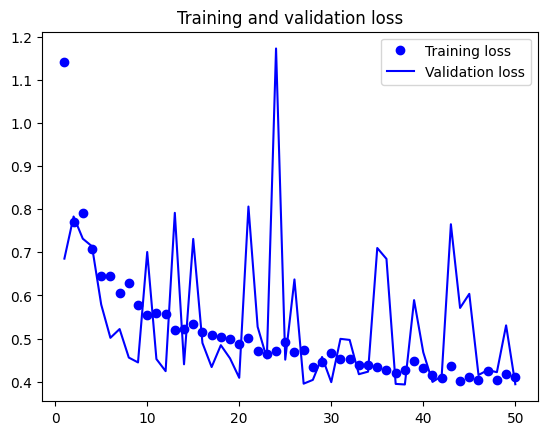

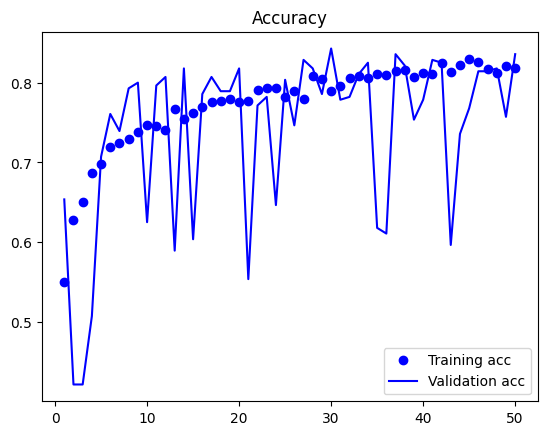

2024-06-10 22:24:41.795014: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:24:41.795277: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:24:41.795382: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.929
Acc for AD vs. CN = 85.0


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

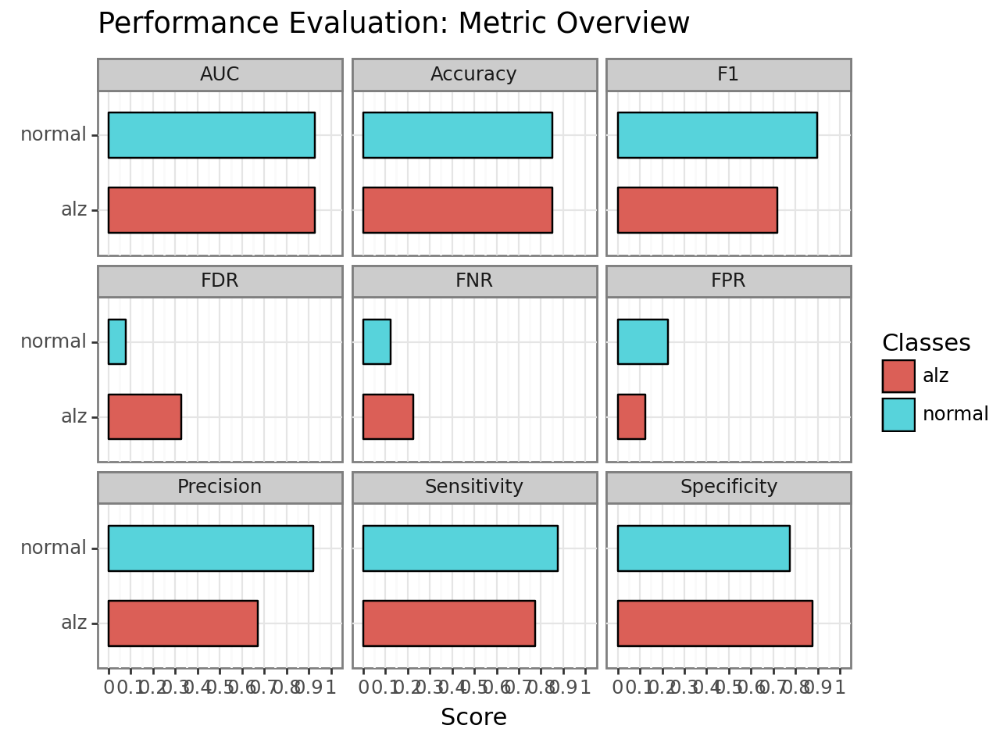

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv04/plot.performance.confusion_matrix.png


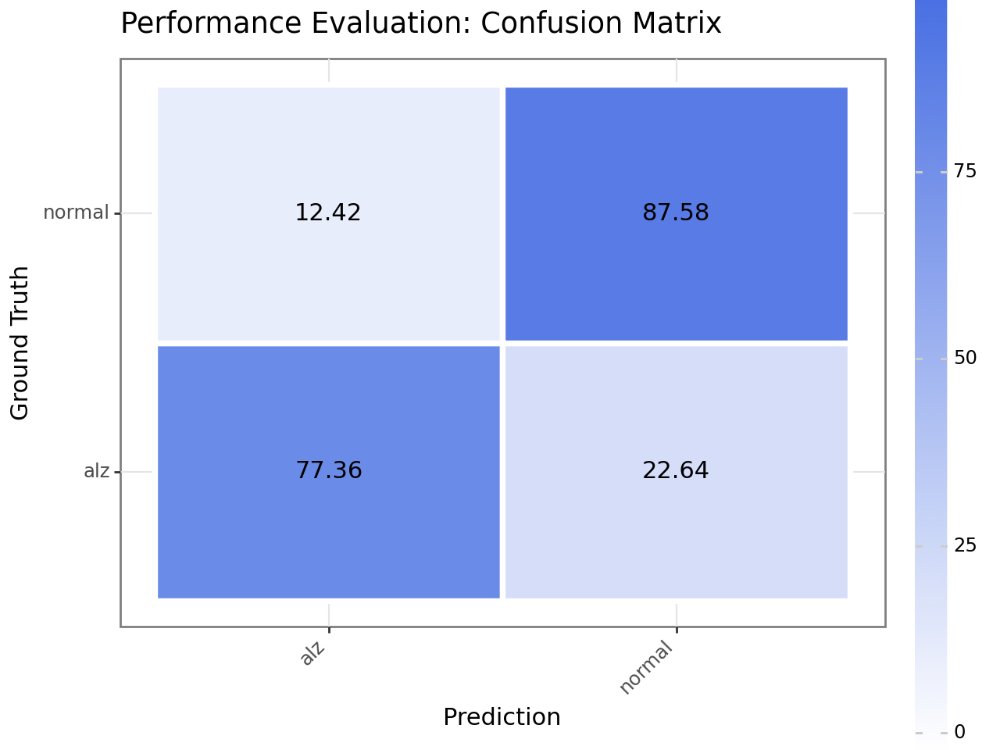

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv04/plot.performance.roc.png


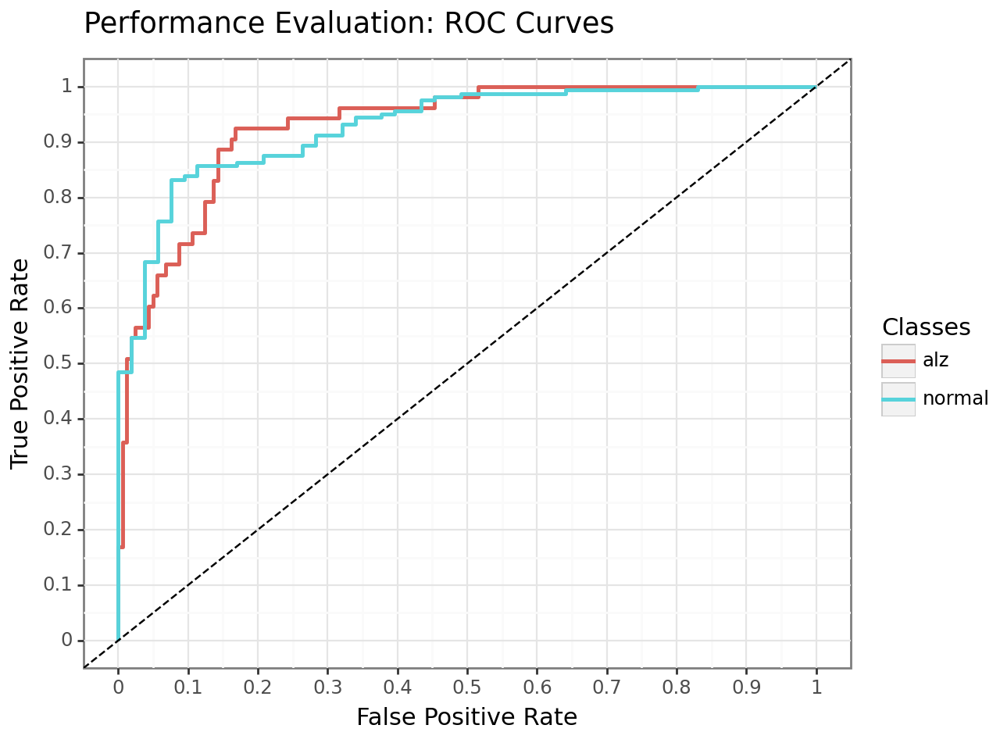


AUC for MCI vs. CN = 0.755
Acc for MCI vs. CN = 76.9


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

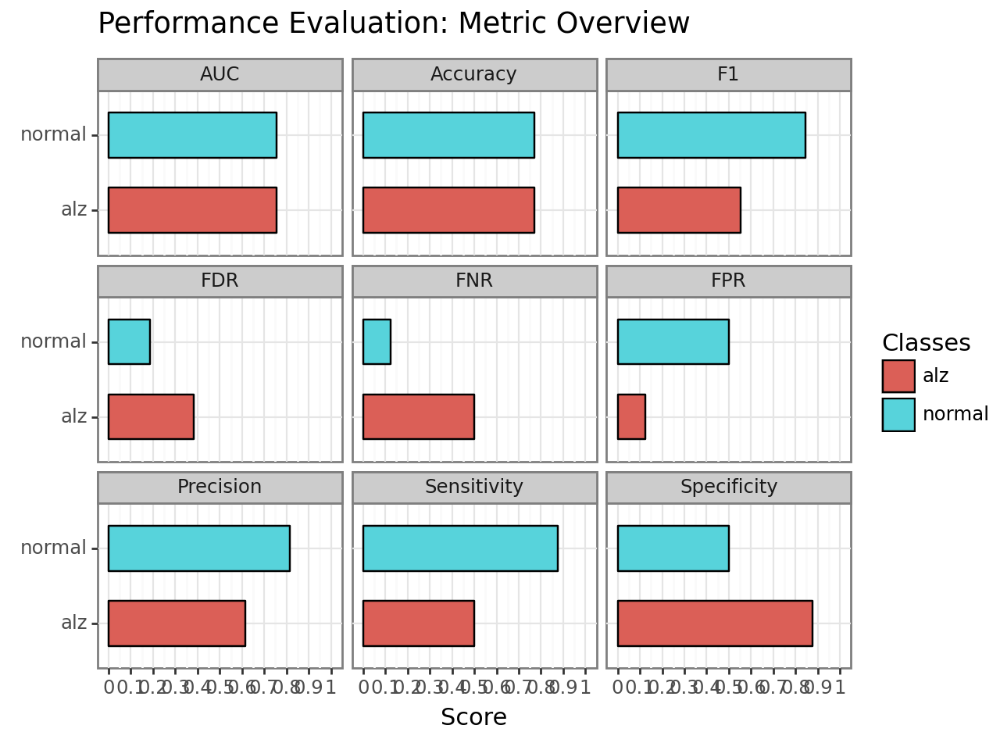

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv04/plot.performance.confusion_matrix.png


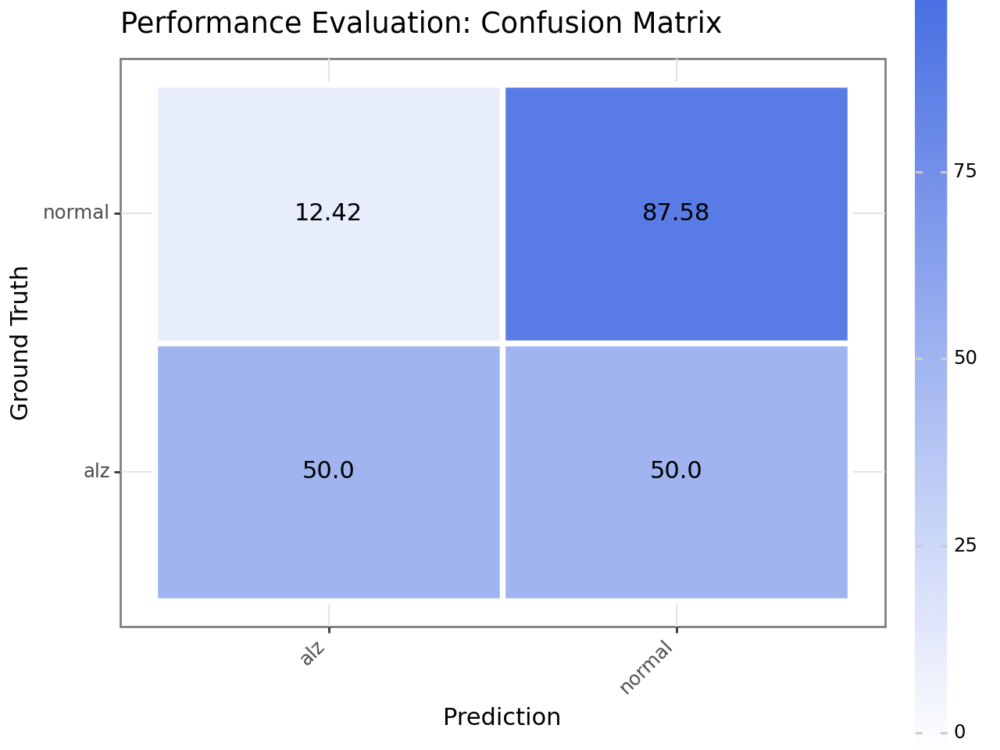

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv04/plot.performance.roc.png


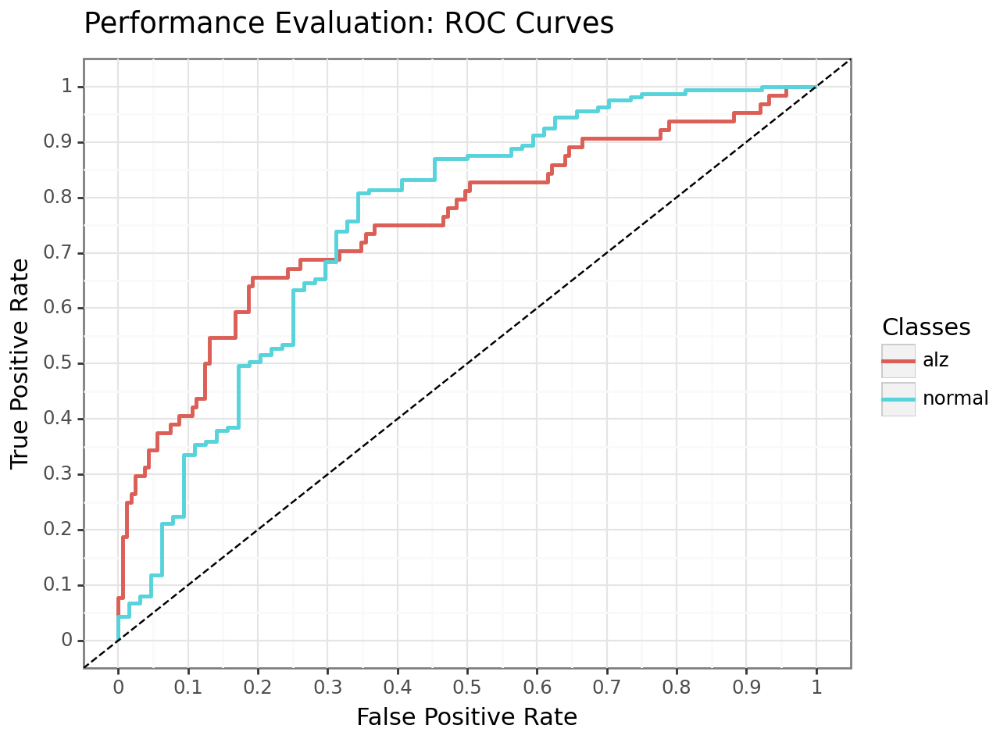

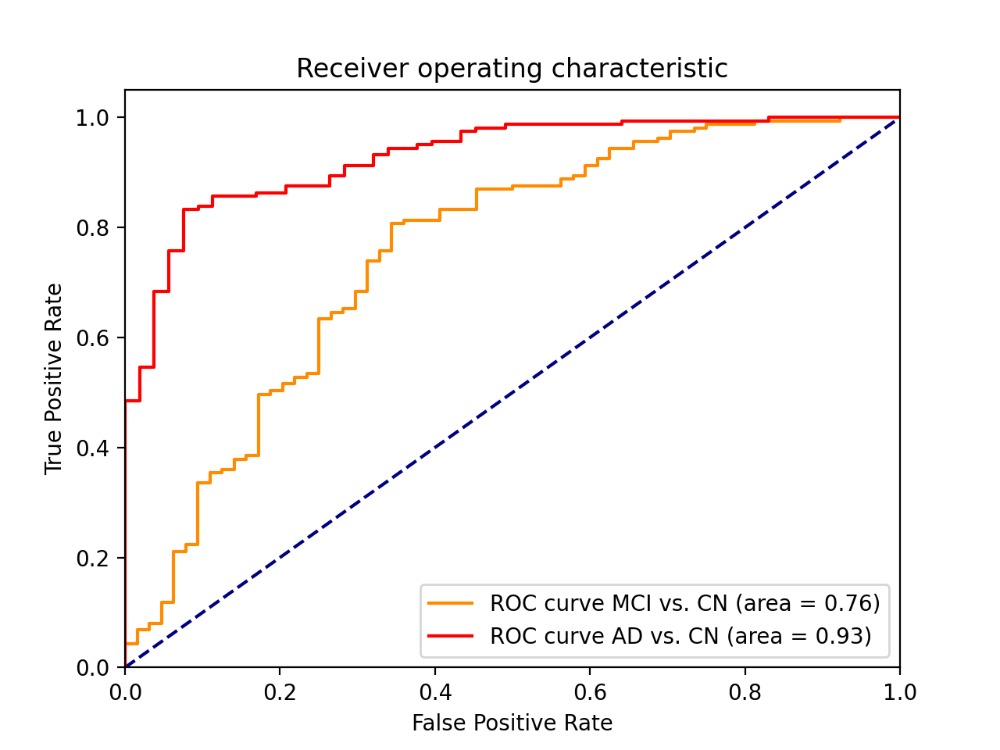

2024-06-10 22:26:10.430980: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:26:10.431215: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:26:10.431318: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

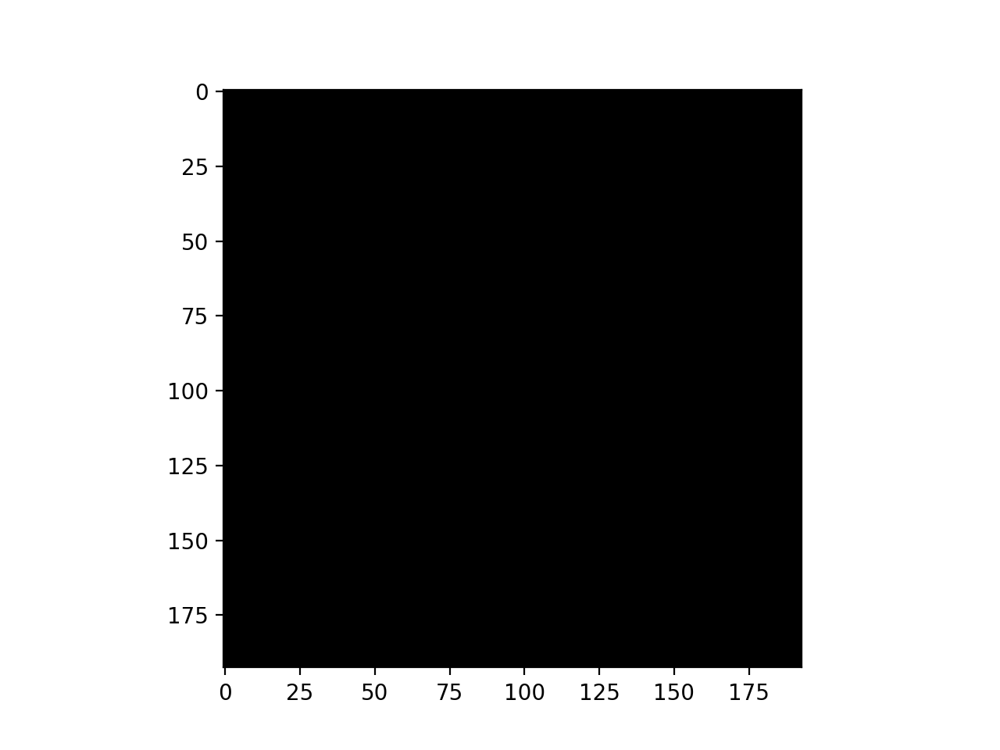

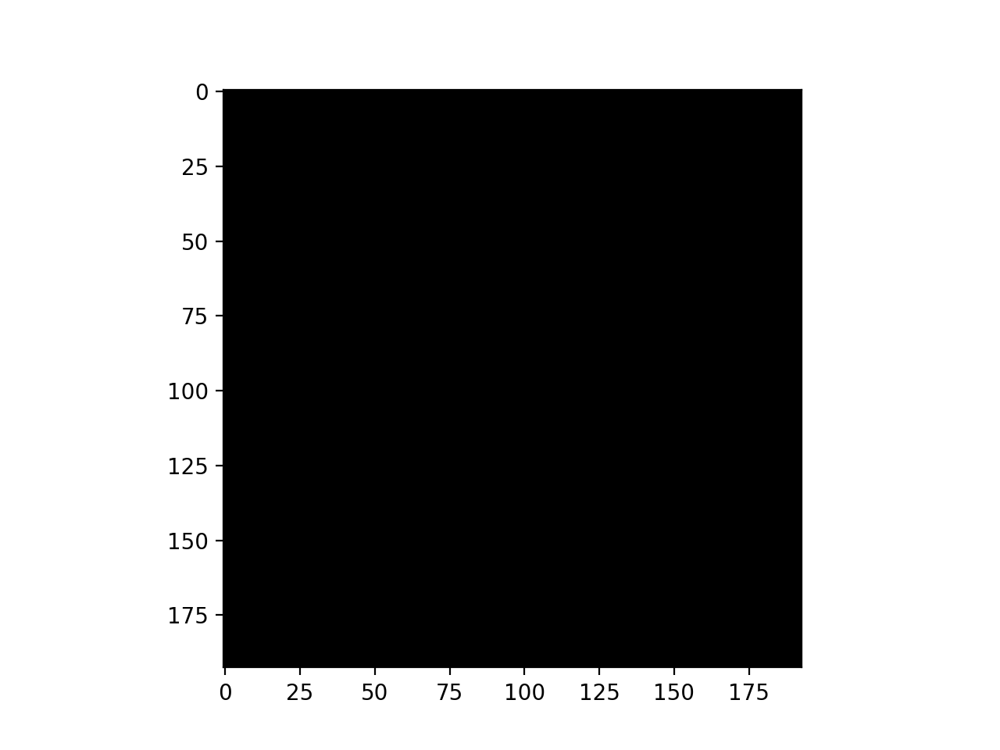

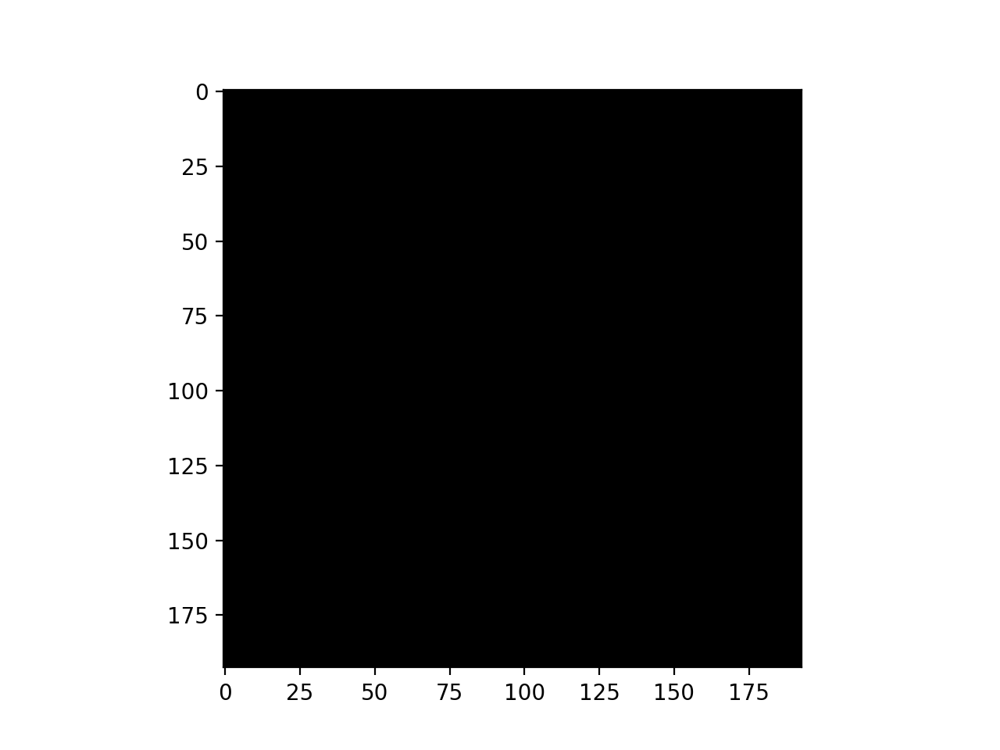

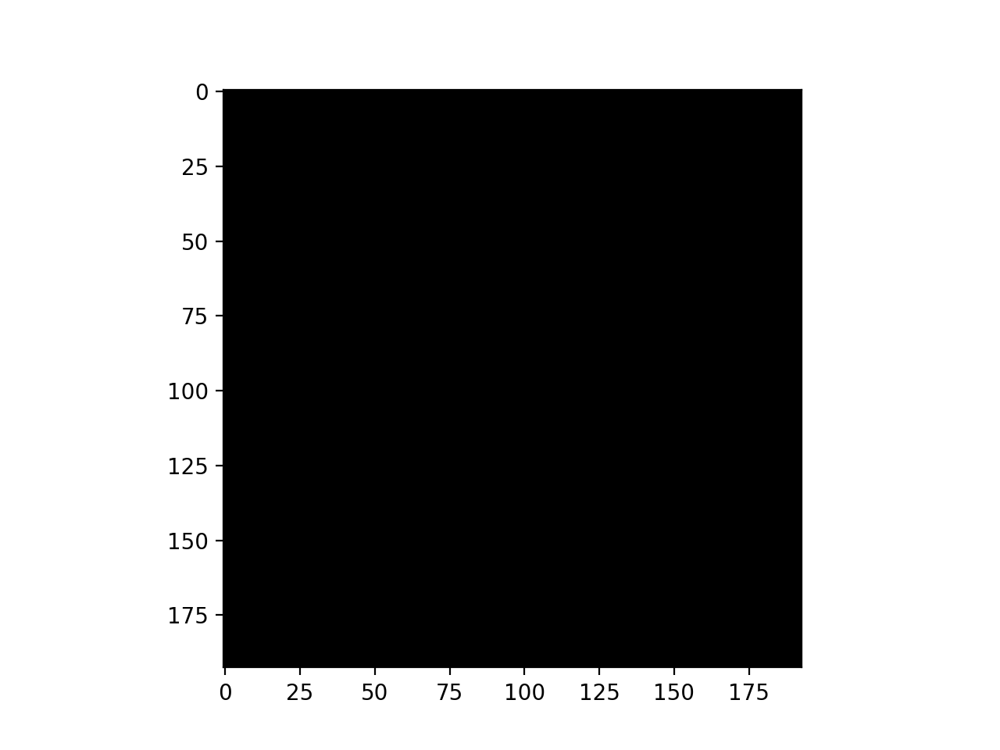

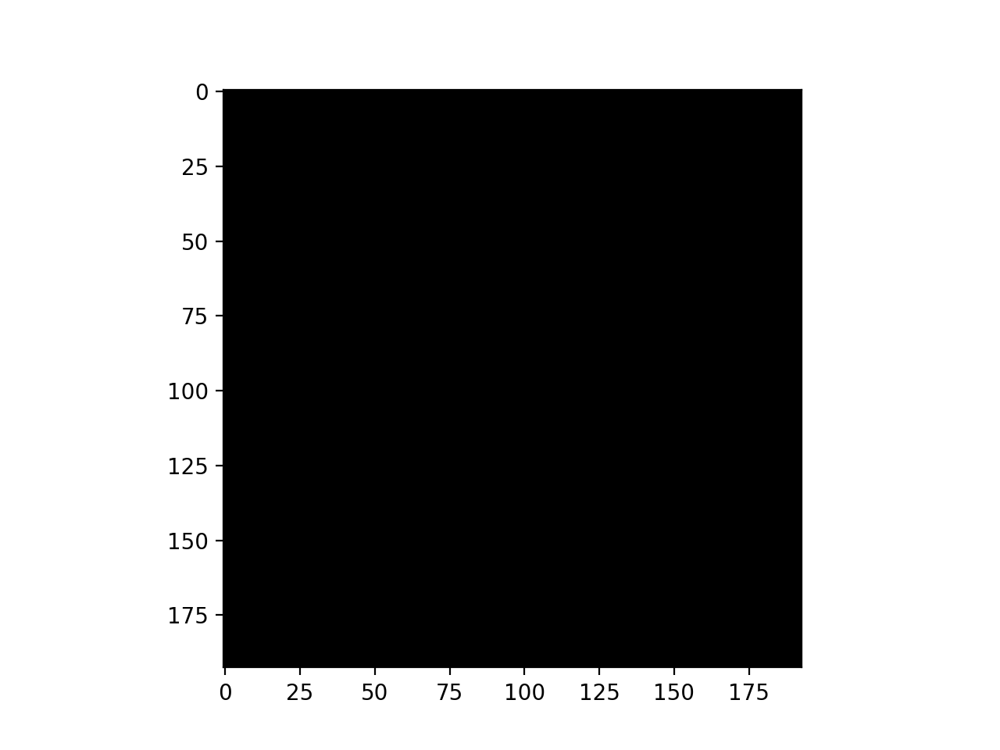

...

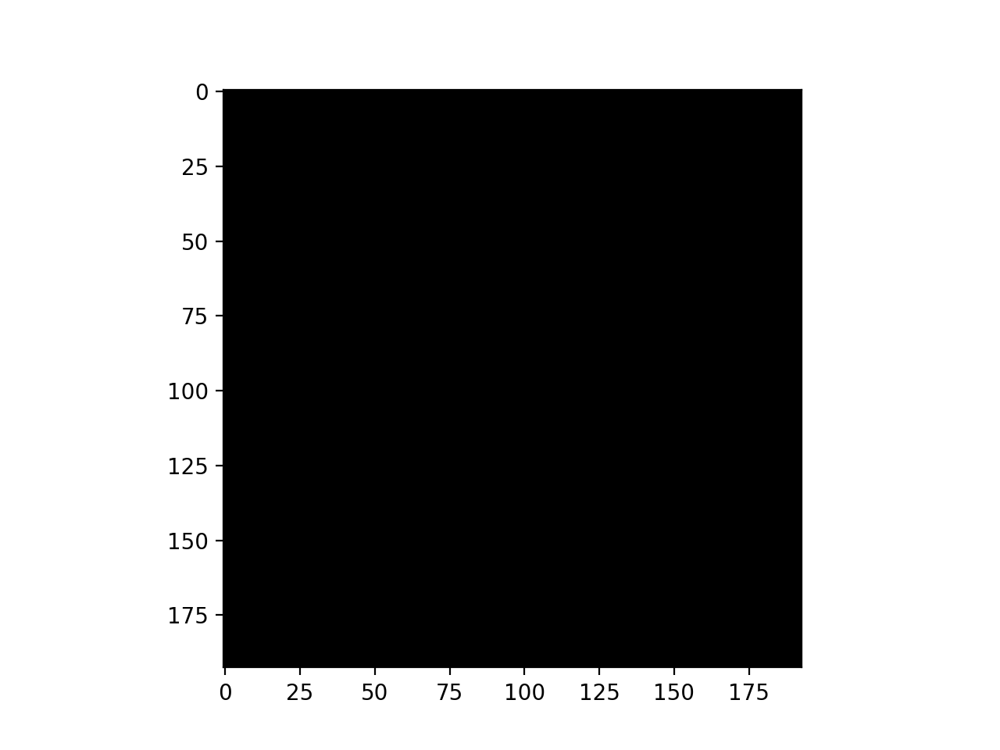

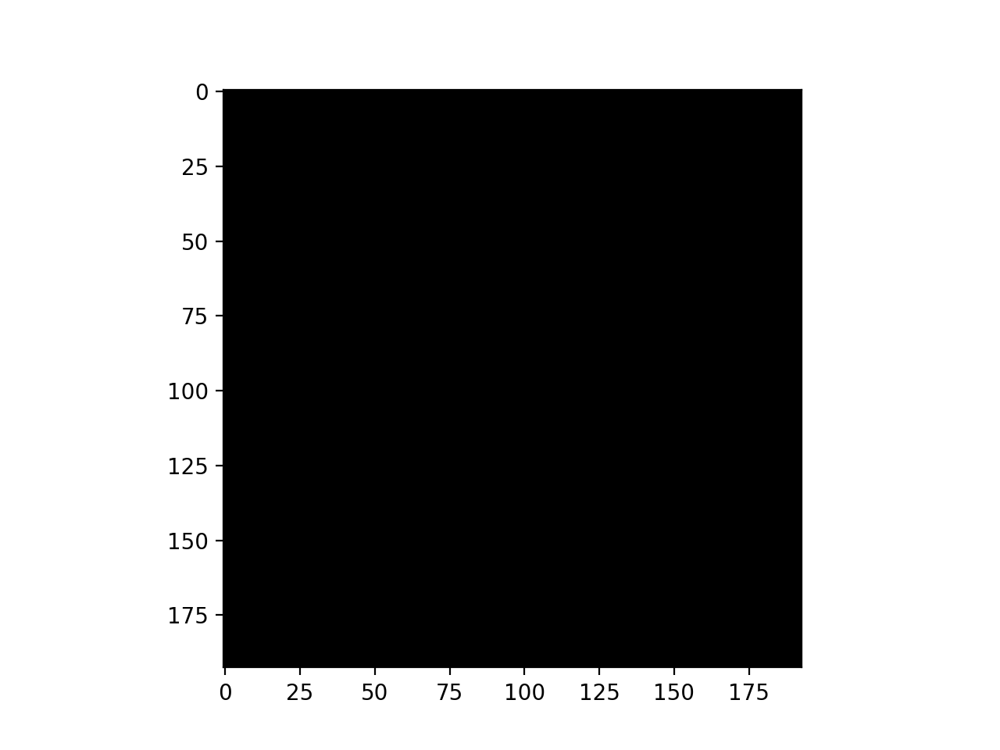

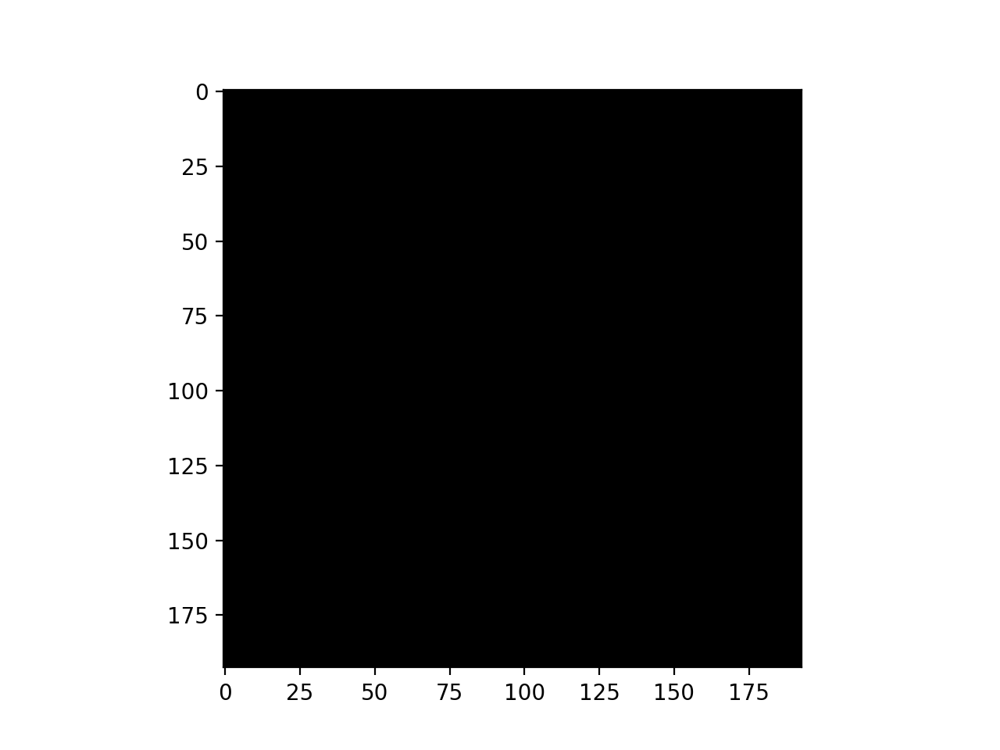

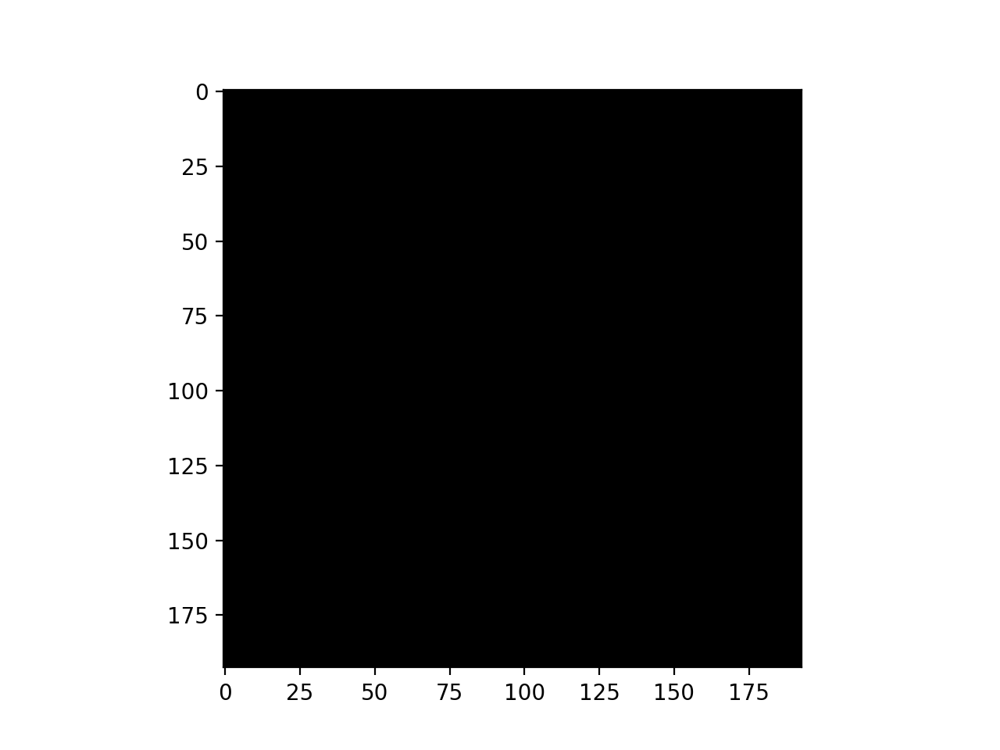

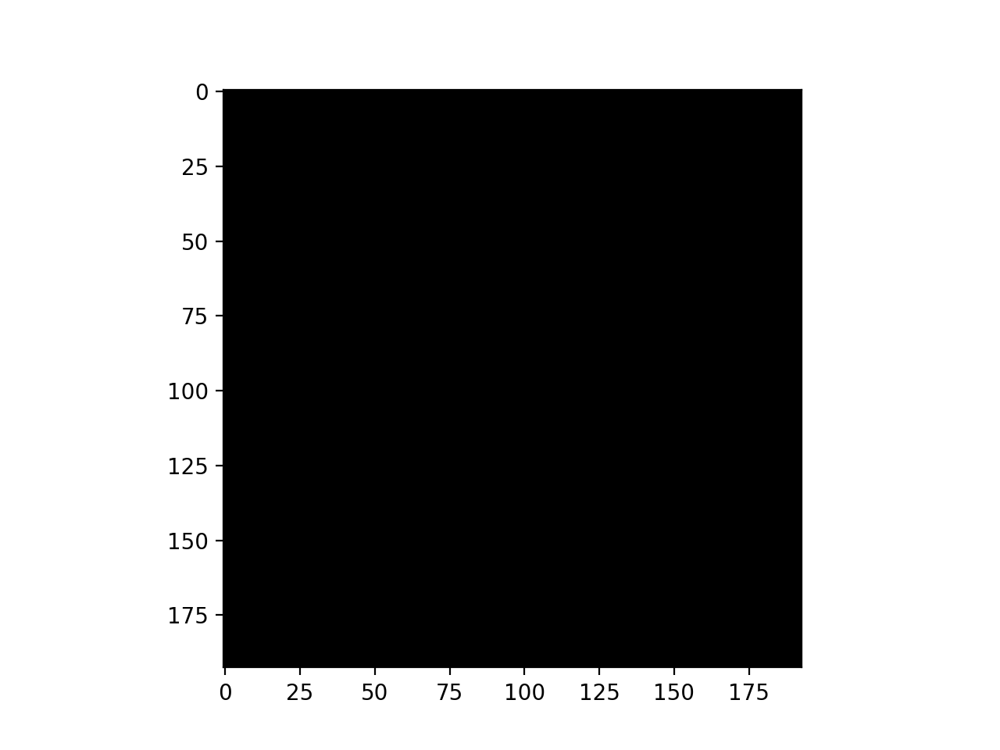

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-10 22:28:56.603135: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:28:56.603403: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-10 22:28:56.603507: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-10 22:29:09.571923: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-10 22:29:09.836451: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/batch_normalization_7/gamma/m/Assign' id:1844 op device:{requested: '', assigned: ''} def:{{{node training/Adam/batch_normalization_7/gamma/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FL

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.9828 - accuracy: 0.5787 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-10 22:43:25.162987: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 948s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.9828 - accuracy: 0.5787 - val_loss: 0.8365 - val_accuracy: 0.4214
Epoch 2/50
70/70 [==============================] - 865s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7514 - accuracy: 0.6386 - val_loss: 1.1755 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 862s 12s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6936 - accuracy: 0.6704 - val_loss: 1.0409 - val_accuracy: 0.4214
Epoch 4/50
70/70 [==============================] - 860s 12s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6770 - accuracy: 0.6901 - val_loss: 0.5874 - val_accuracy: 0.6929
Epoch 5/50
70/70 [==============================] - 867s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6864 - accuracy: 0.6838 - val_loss: 0.7264 - val_accuracy: 0.6357
Epoch 6/50
70/70 [==============================] - 876s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6001 - accuracy: 0.7312 - v

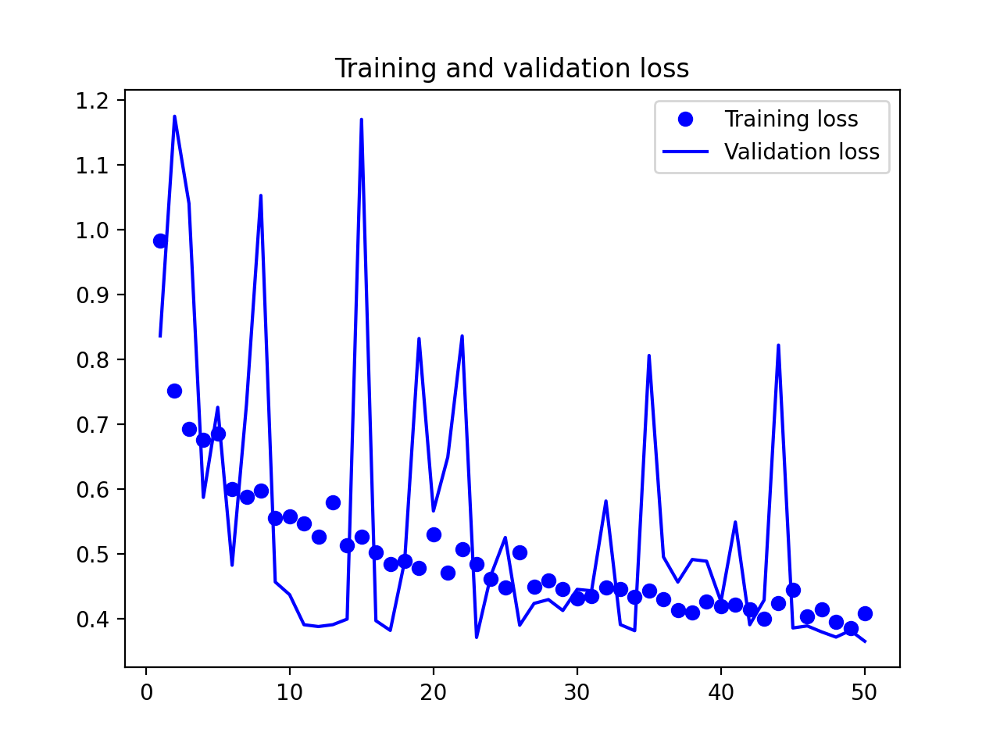

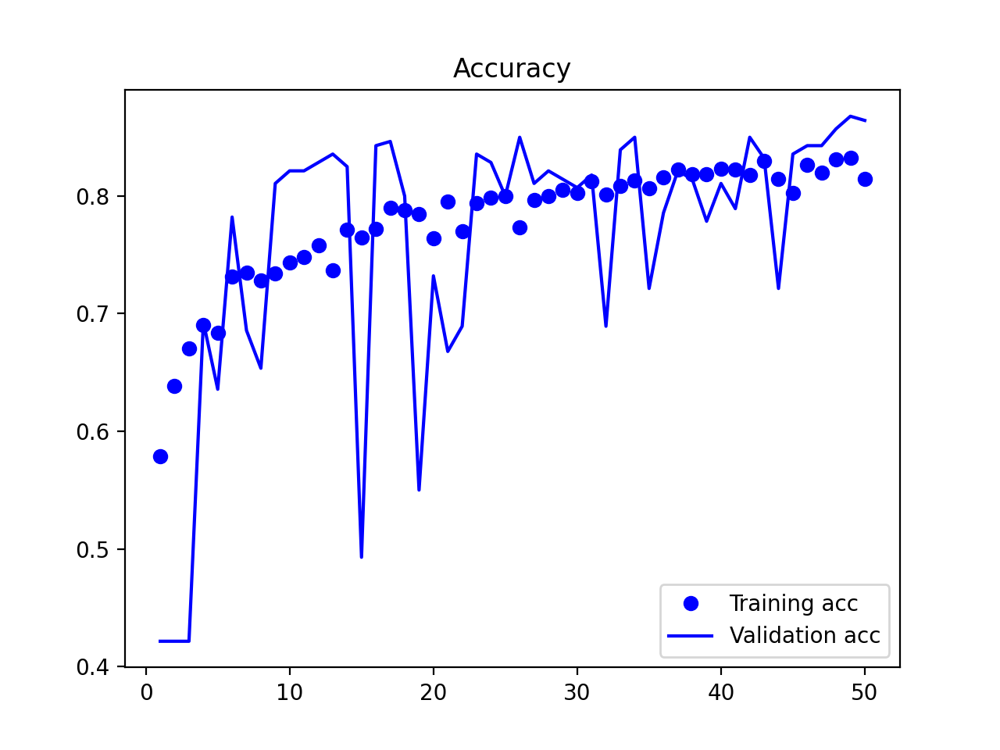

2024-06-11 10:32:19.344890: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:32:19.345874: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:32:19.346195: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.919
Acc for AD vs. CN = 87.6


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

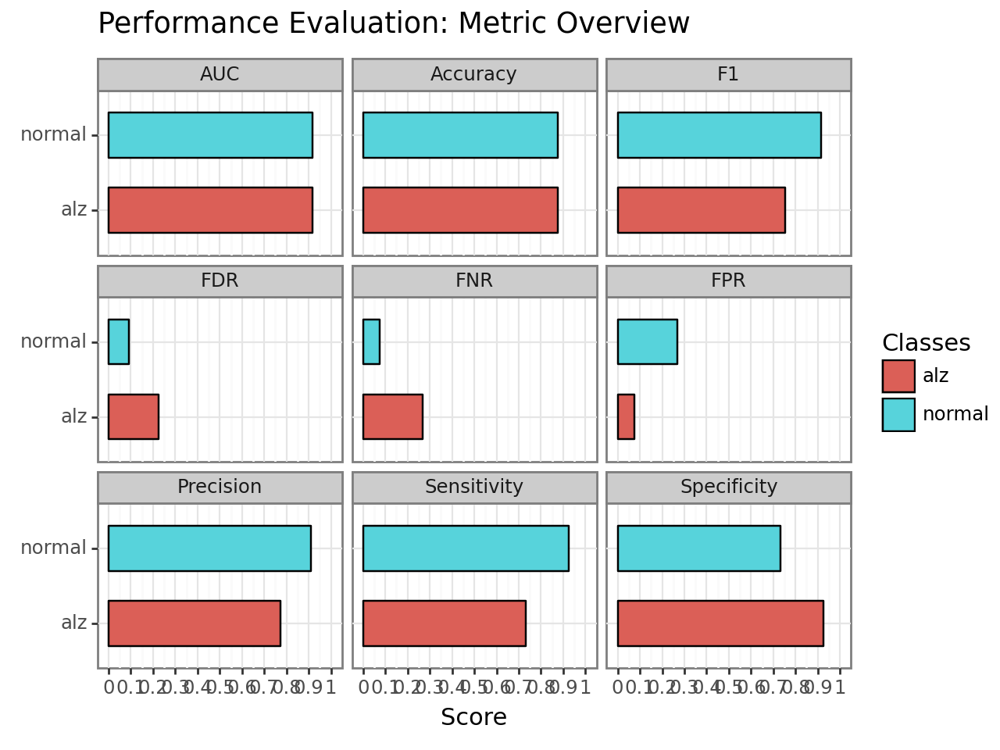

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv05/plot.performance.confusion_matrix.png


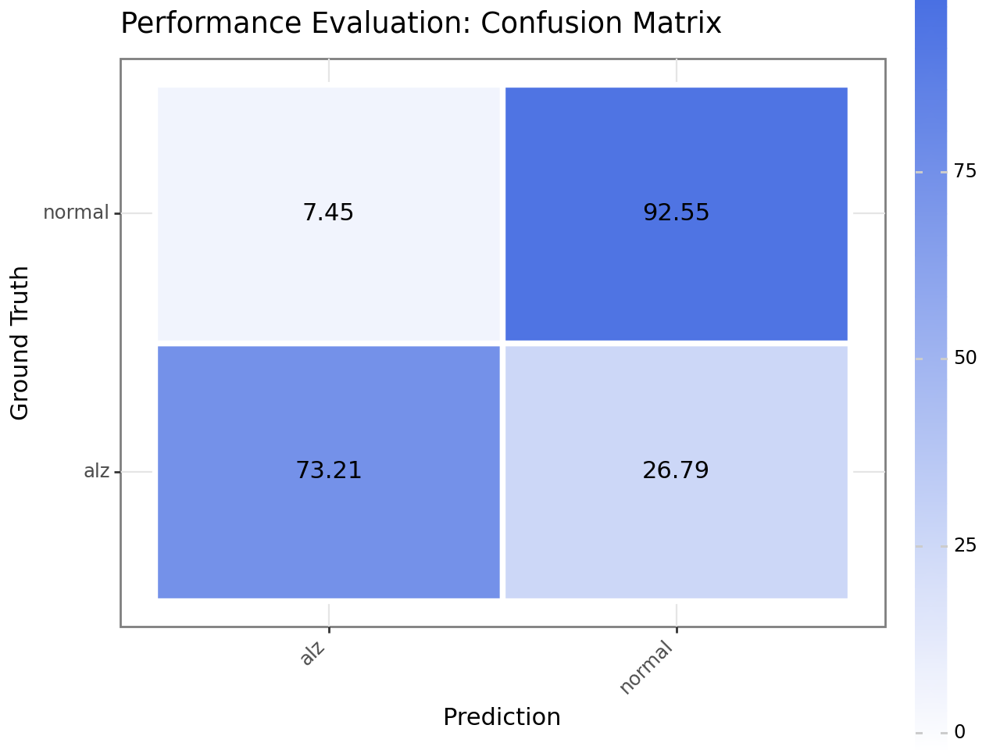

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv05/plot.performance.roc.png


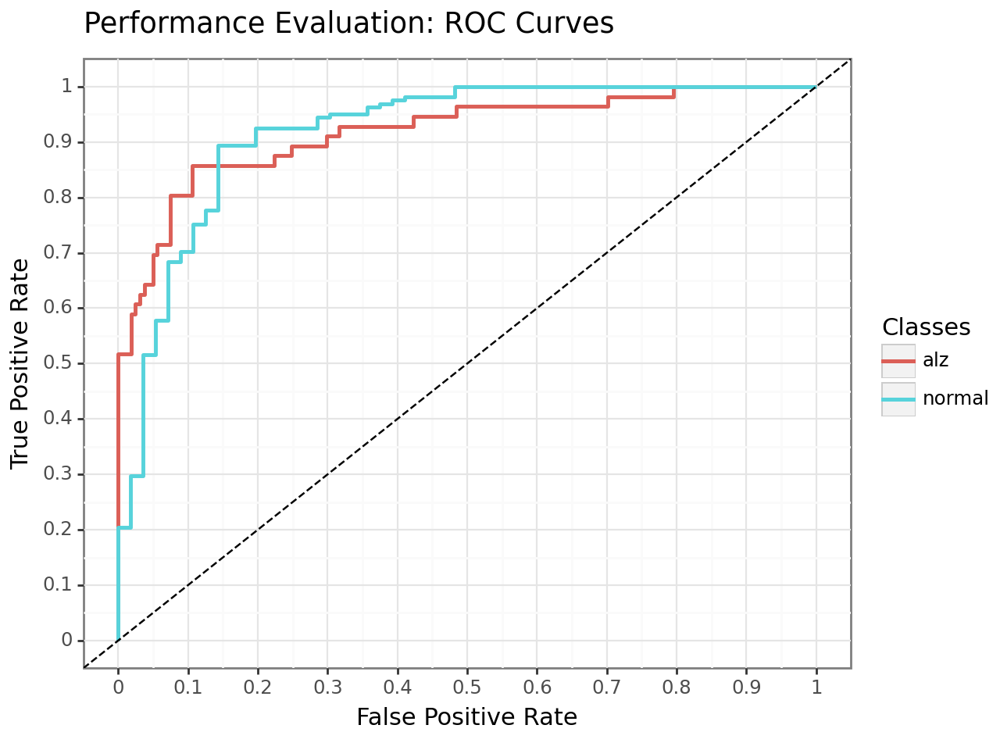


AUC for MCI vs. CN = 0.789
Acc for MCI vs. CN = 79.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

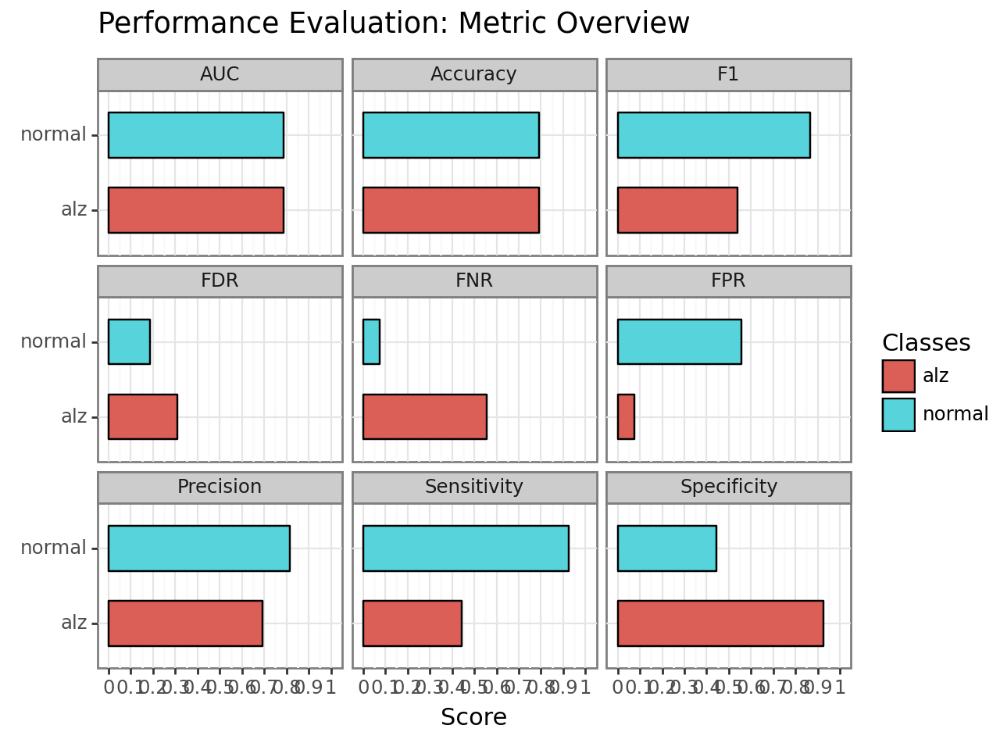

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv05/plot.performance.confusion_matrix.png


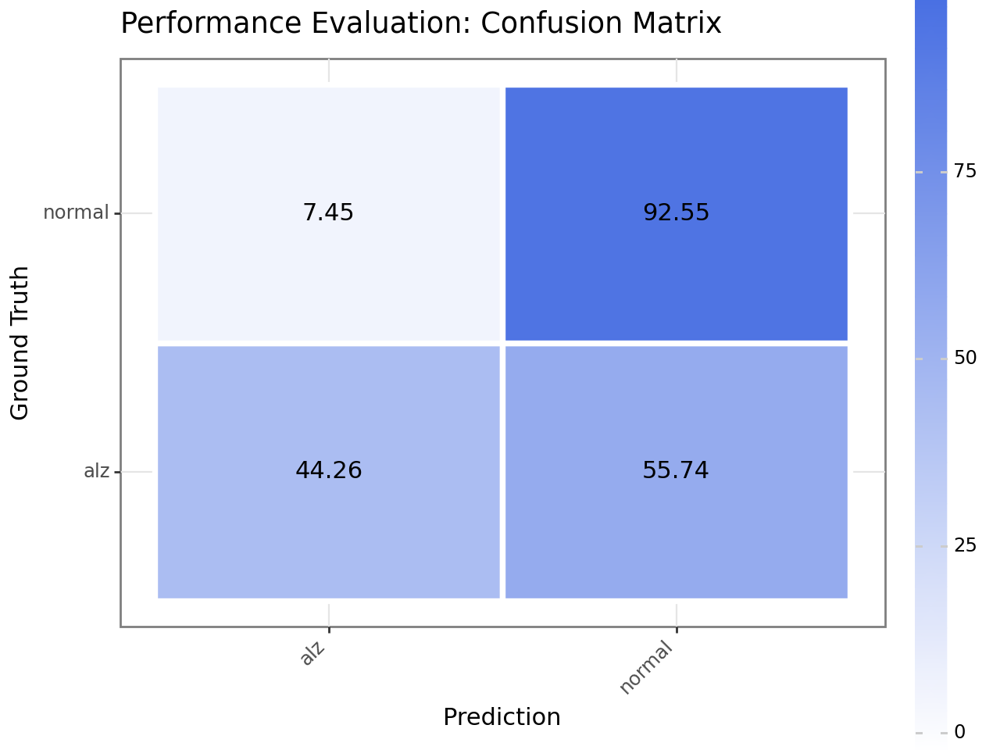

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv05/plot.performance.roc.png


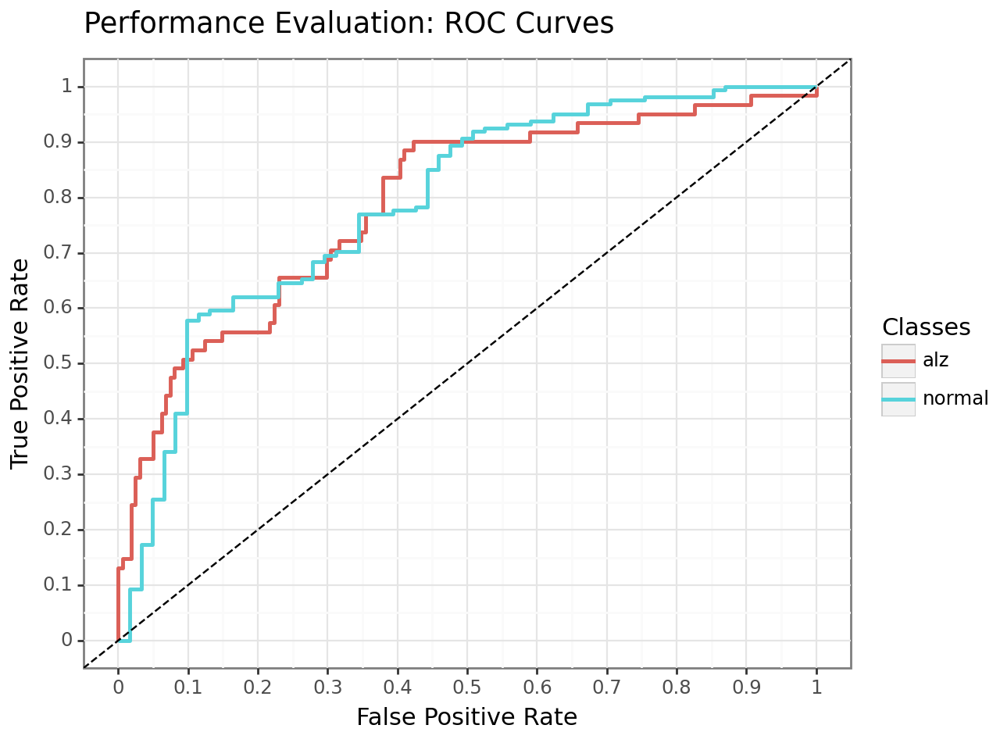

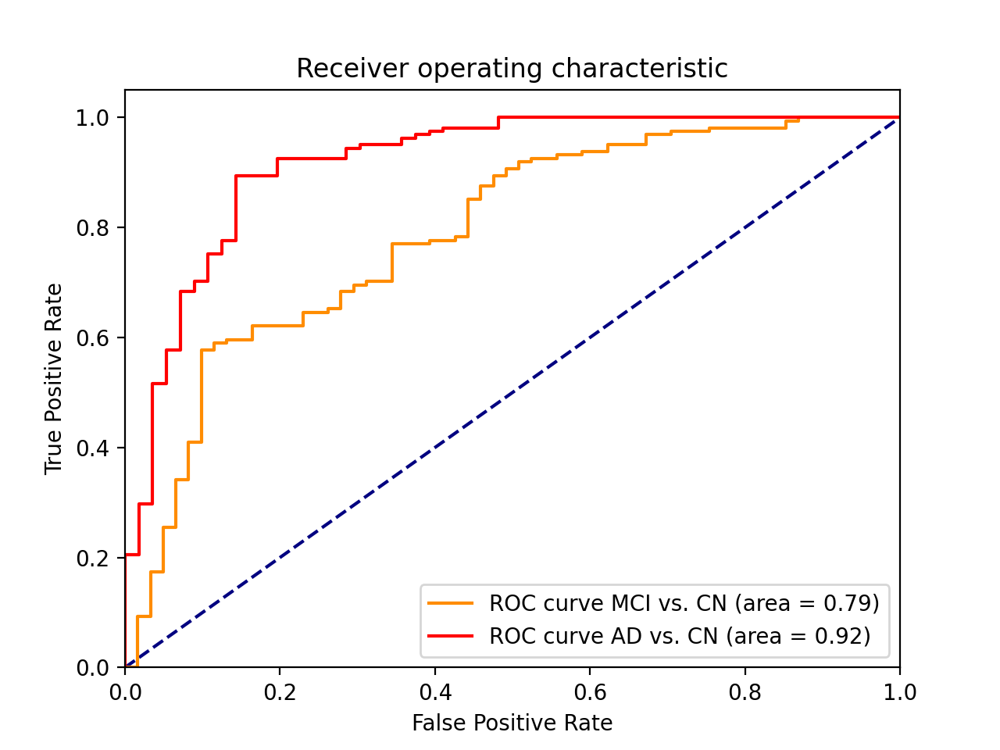

2024-06-11 10:33:47.371306: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:33:47.371565: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:33:47.371683: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

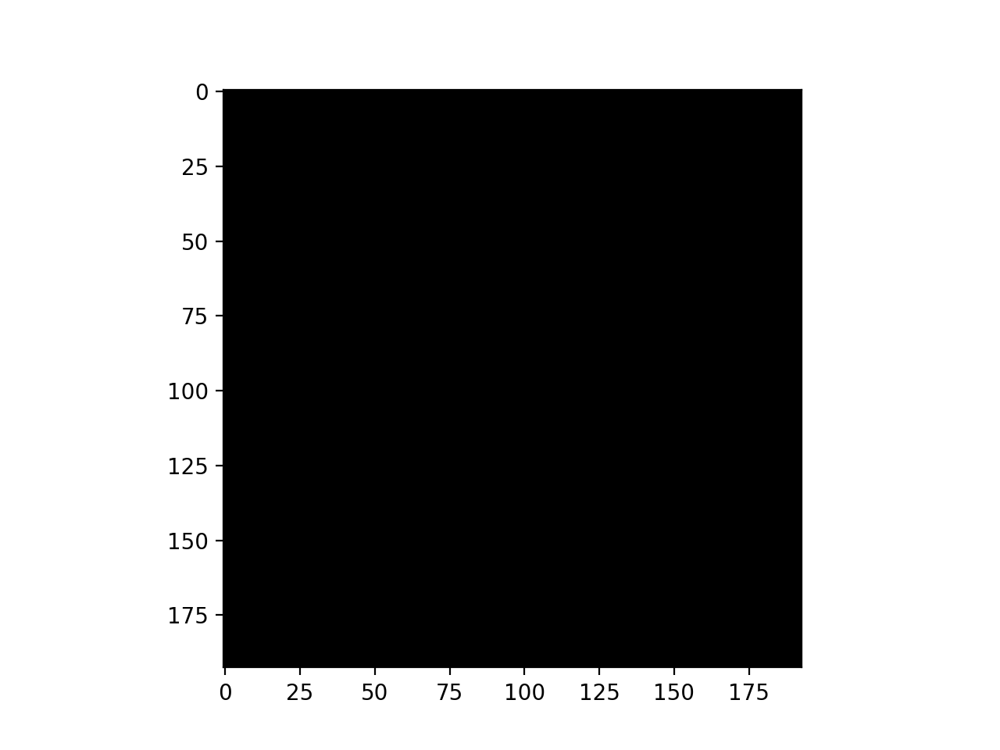

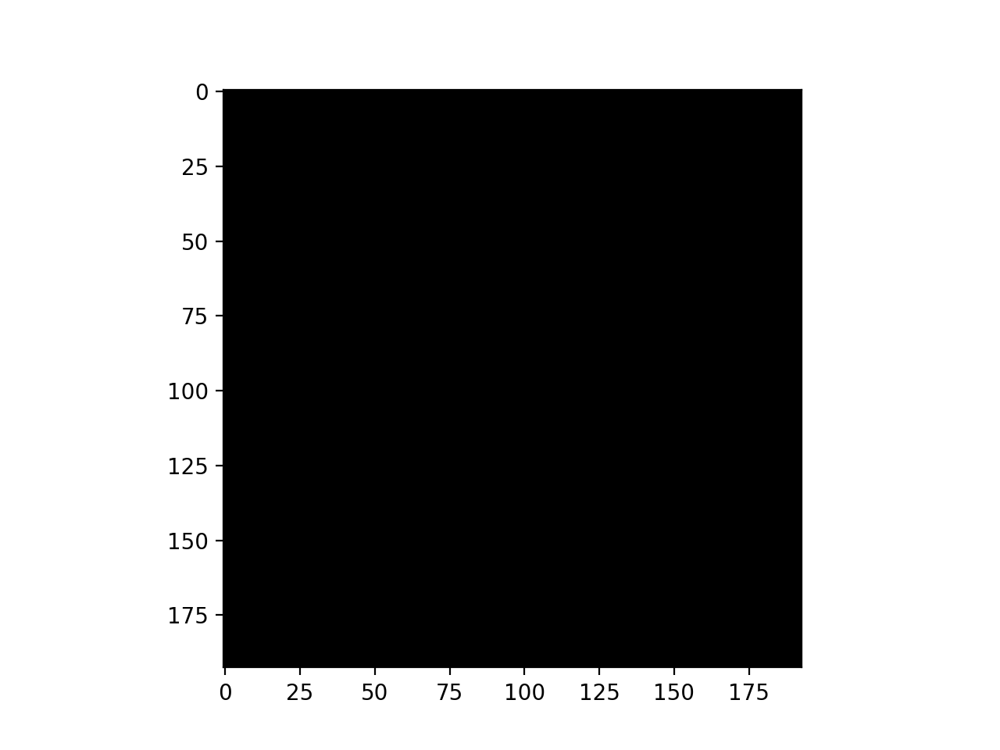

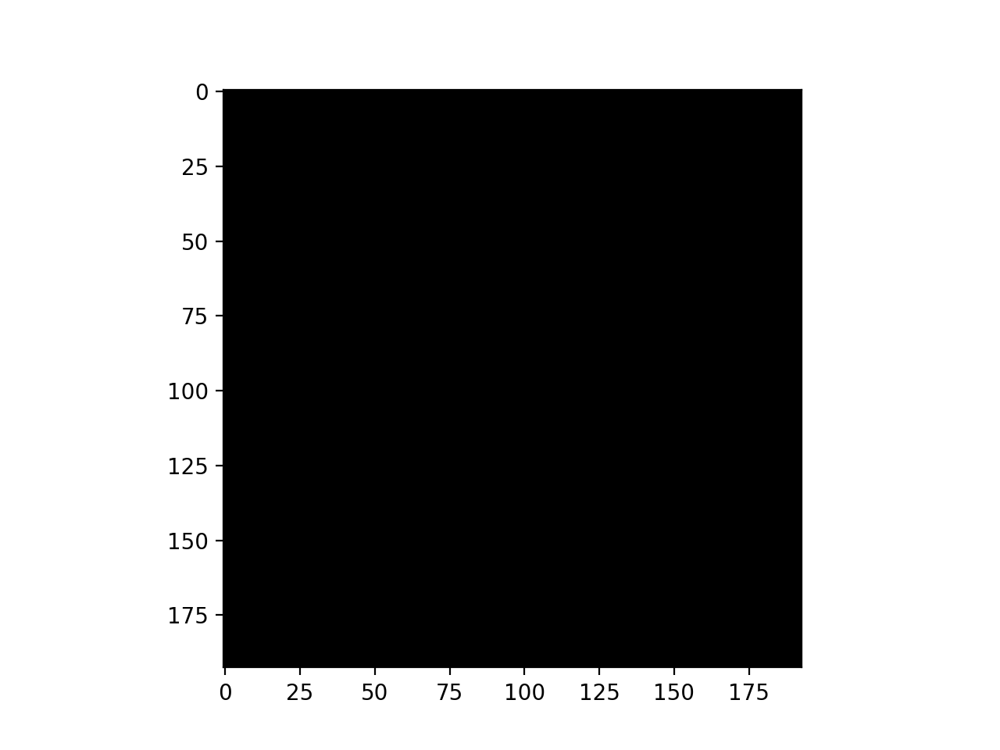

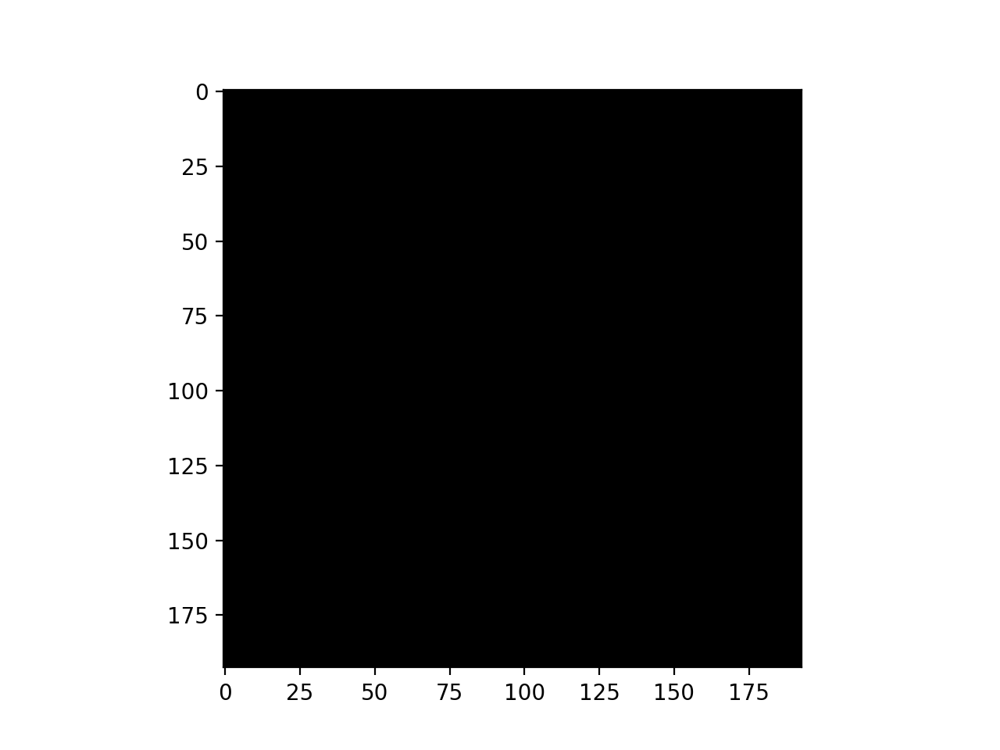

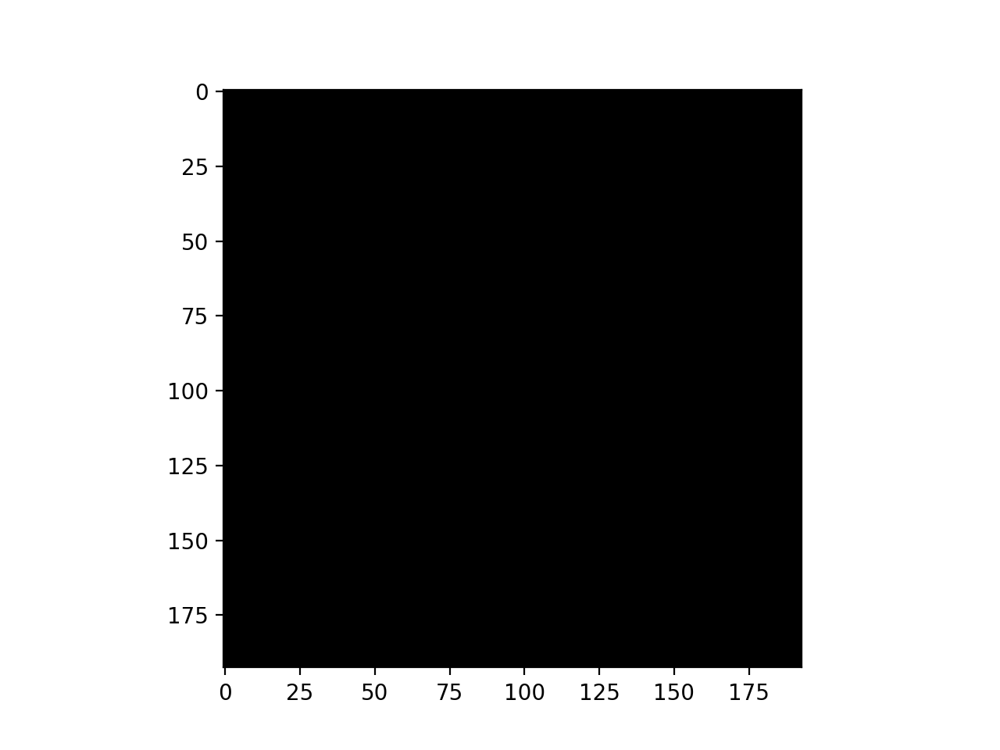

...

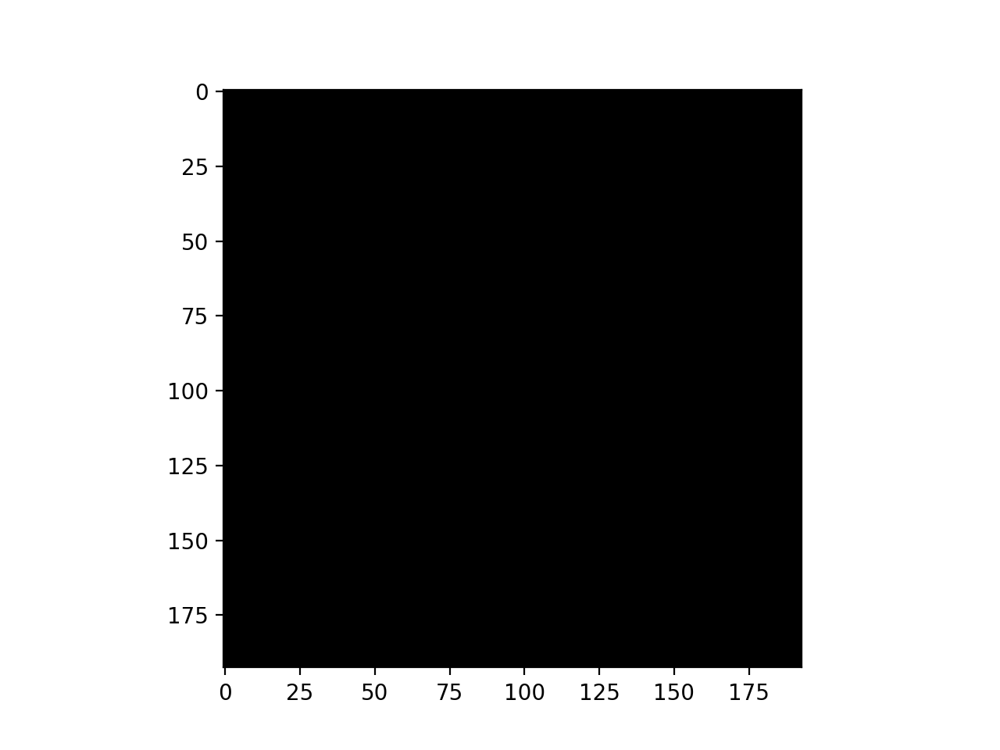

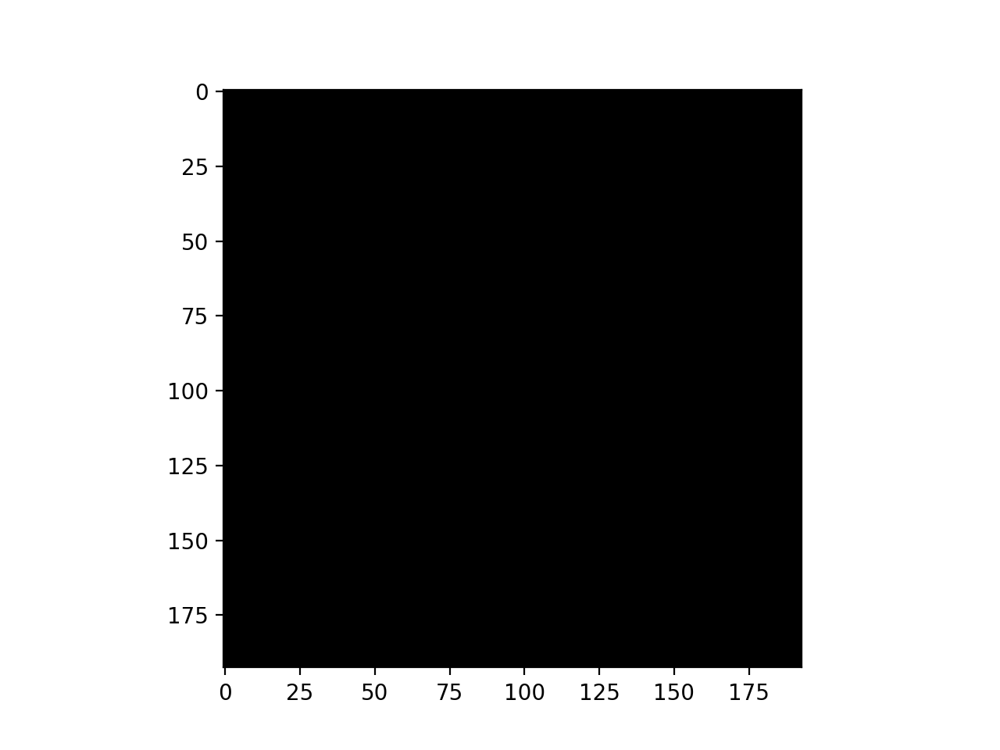

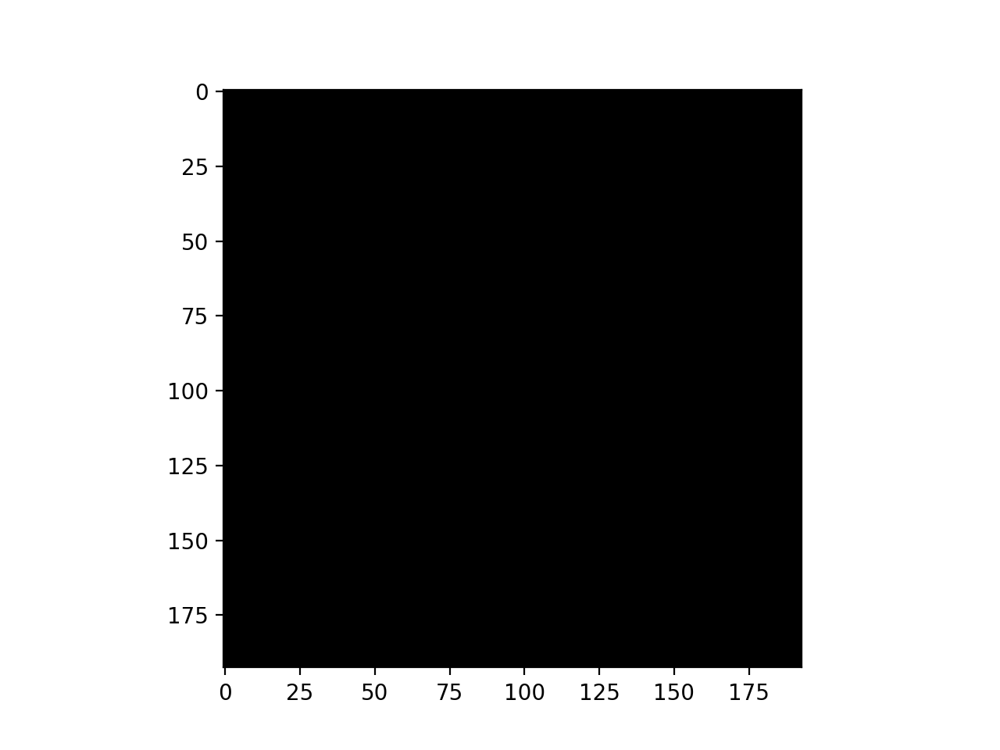

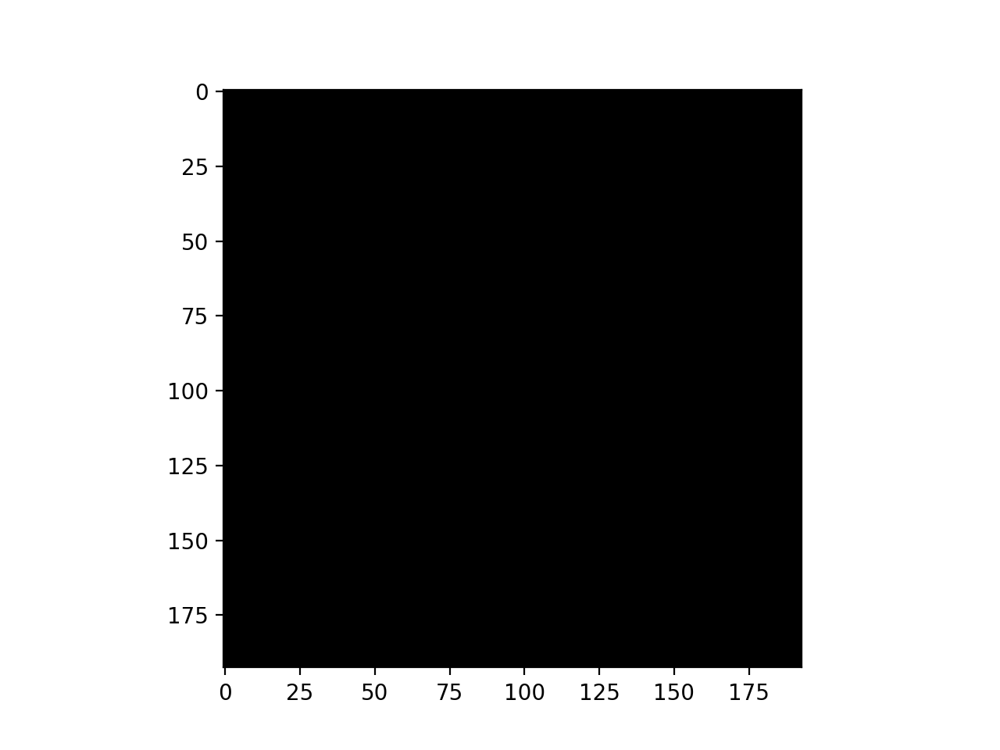

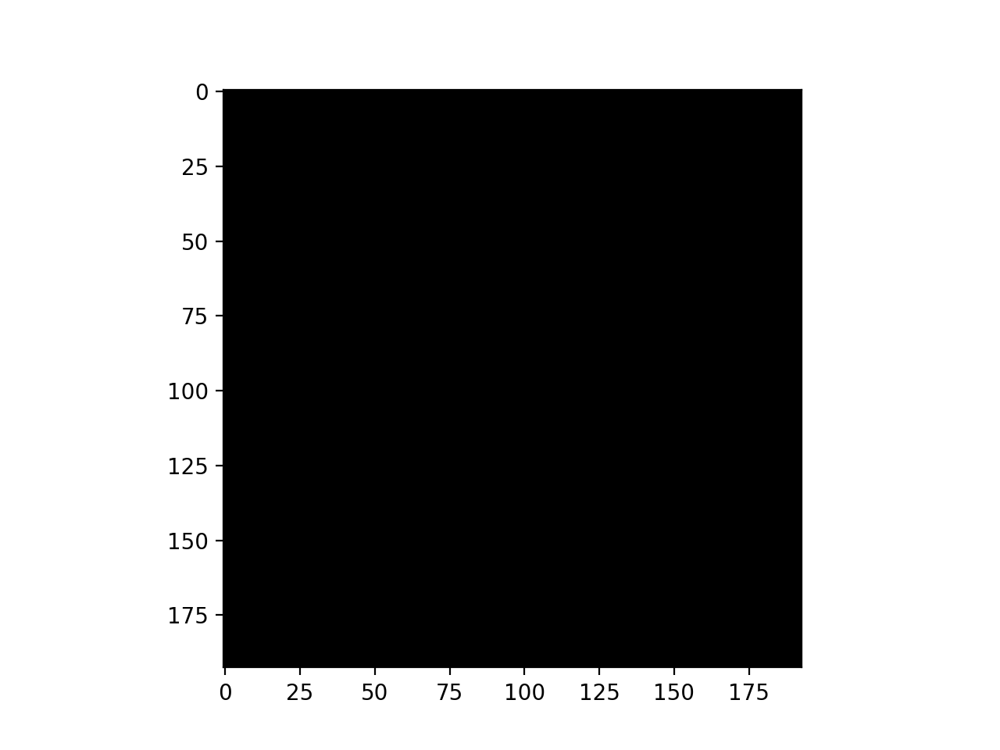

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-11 10:36:32.964847: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:36:32.965109: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 10:36:32.965224: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-11 10:36:46.113018: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-11 10:36:46.413875: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/batch_normalization_6/gamma/v/Assign' id:2120 op device:{requested: '', assigned: ''} def:{{{node training/Adam/batch_normalization_6/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FL

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 1.0958 - accuracy: 0.5380 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-11 10:51:03.614091: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 949s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 1.0958 - accuracy: 0.5380 - val_loss: 0.6776 - val_accuracy: 0.5929
Epoch 2/50
70/70 [==============================] - 872s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7490 - accuracy: 0.6360 - val_loss: 0.7047 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 871s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6933 - accuracy: 0.6659 - val_loss: 0.6394 - val_accuracy: 0.7536
Epoch 4/50
70/70 [==============================] - 868s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6493 - accuracy: 0.6923 - val_loss: 0.6195 - val_accuracy: 0.5964
Epoch 5/50
70/70 [==============================] - 872s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6145 - accuracy: 0.7165 - val_loss: 0.5070 - val_accuracy: 0.7536
Epoch 6/50
70/70 [==============================] - 888s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.5893 - accuracy: 0.7267 - v

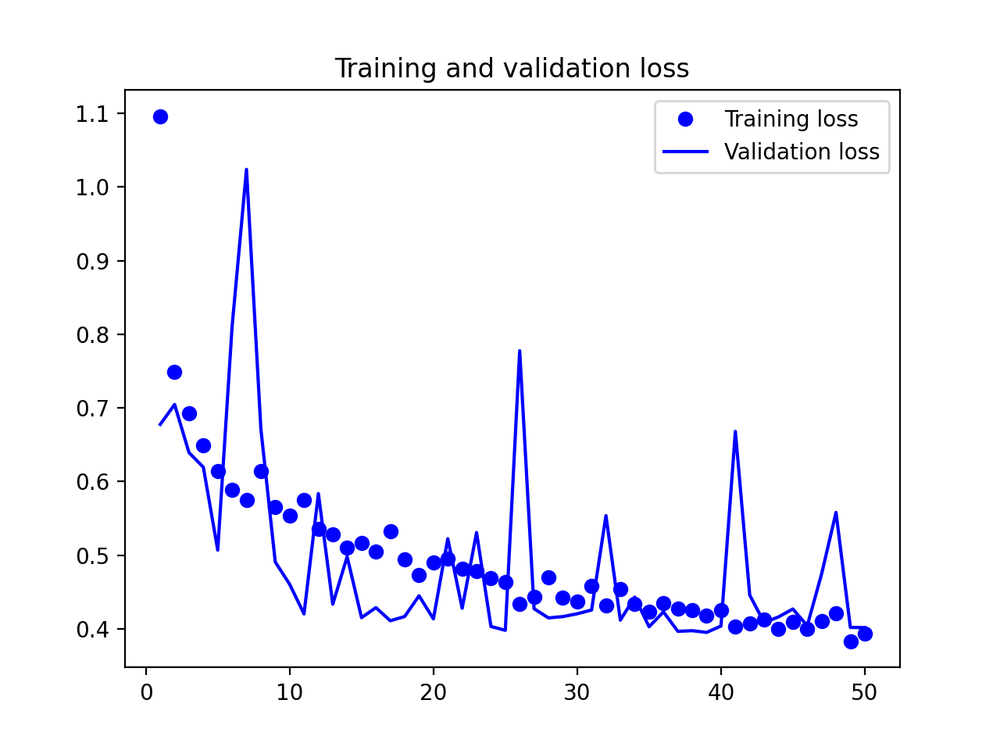

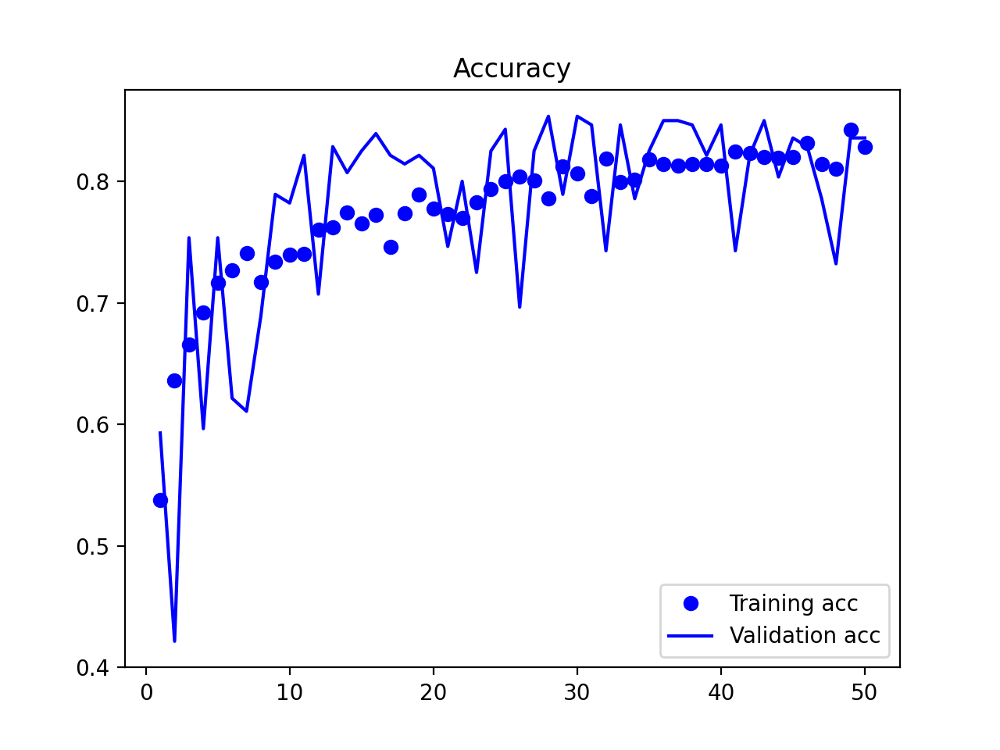

2024-06-11 22:50:39.939985: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:50:39.940257: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:50:39.940378: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.931
Acc for AD vs. CN = 90.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

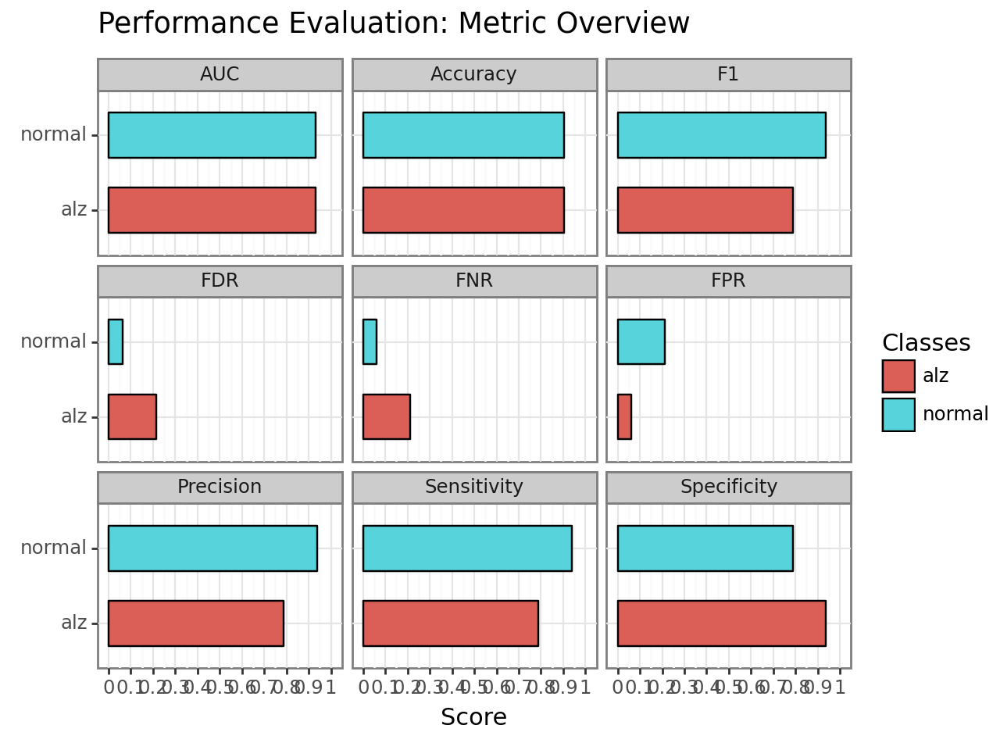

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv06/plot.performance.confusion_matrix.png


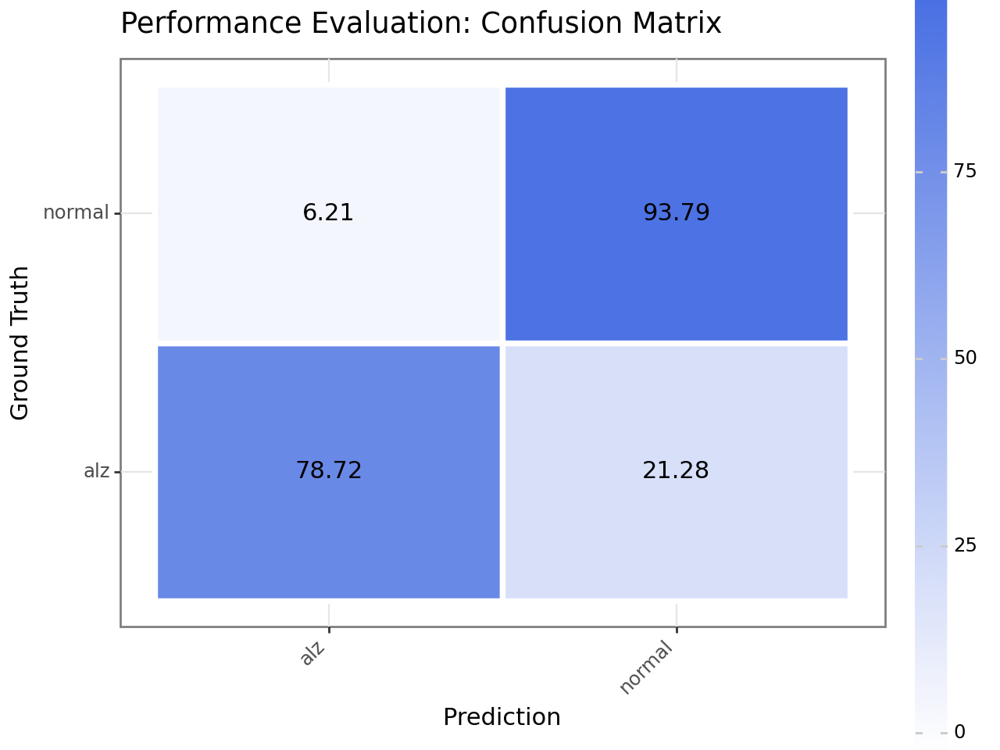

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv06/plot.performance.roc.png


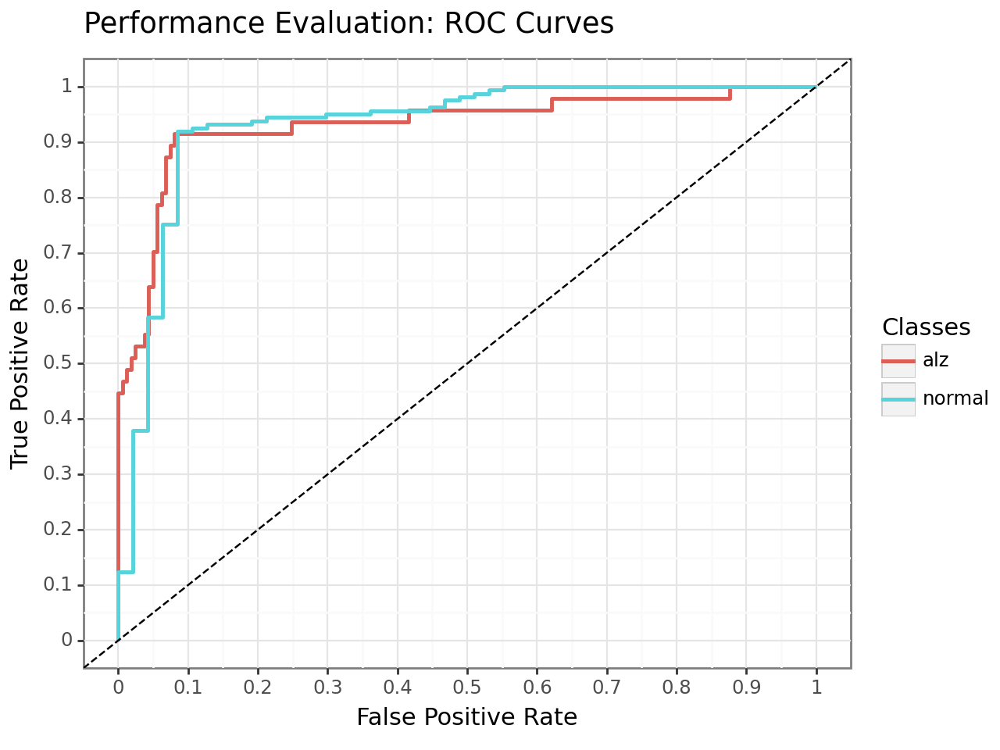


AUC for MCI vs. CN = 0.845
Acc for MCI vs. CN = 80.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

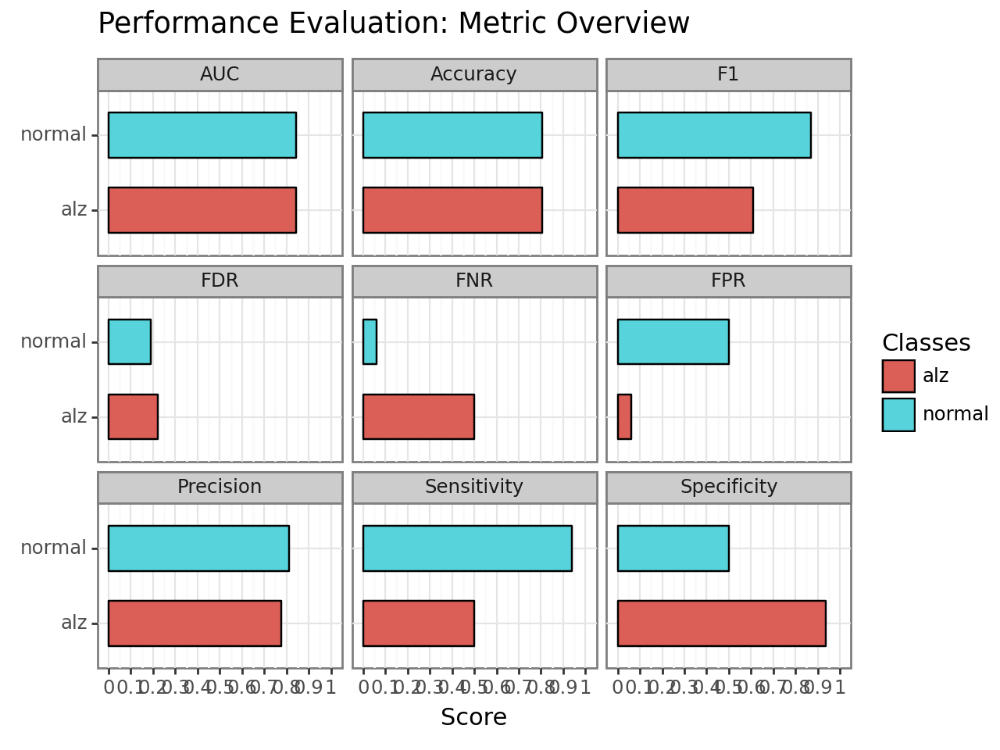

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv06/plot.performance.confusion_matrix.png


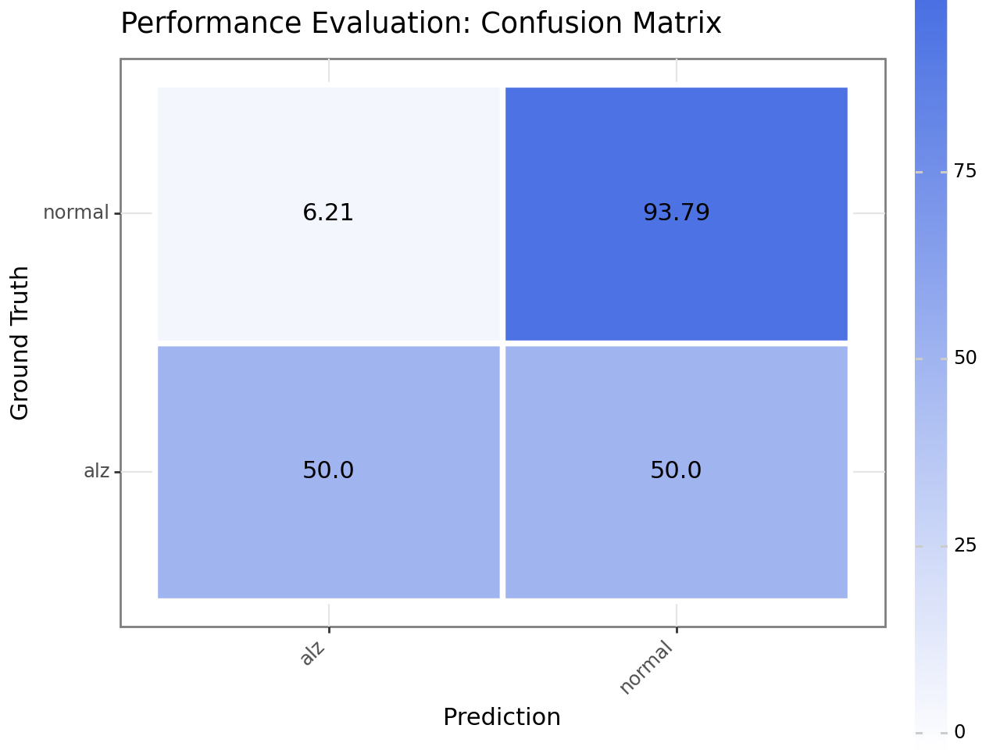

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv06/plot.performance.roc.png


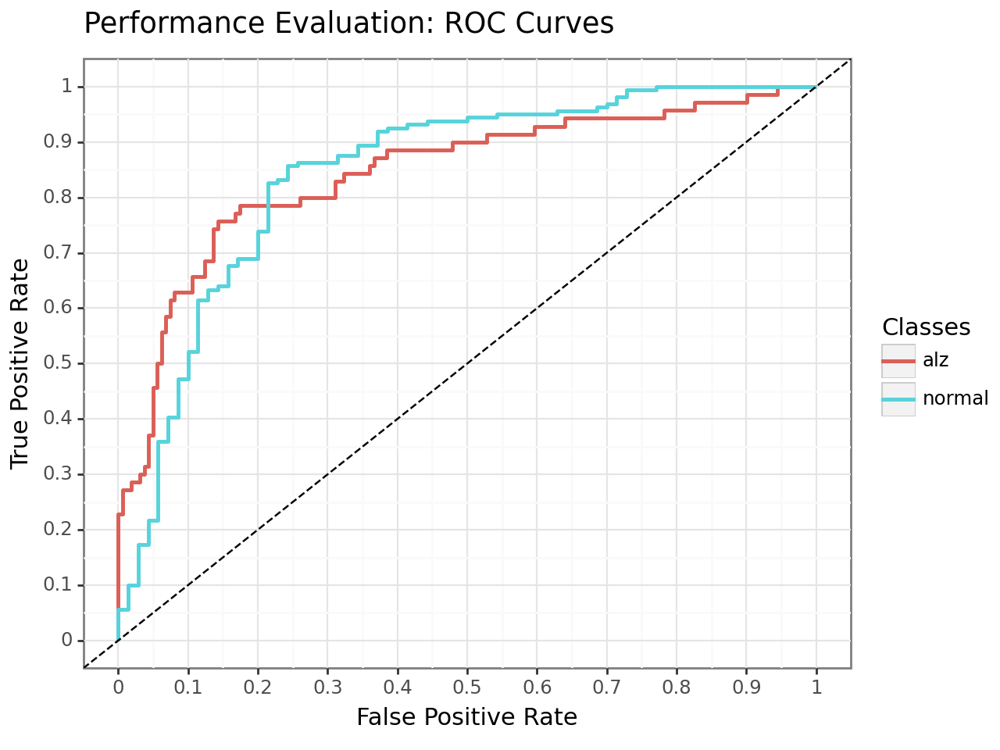

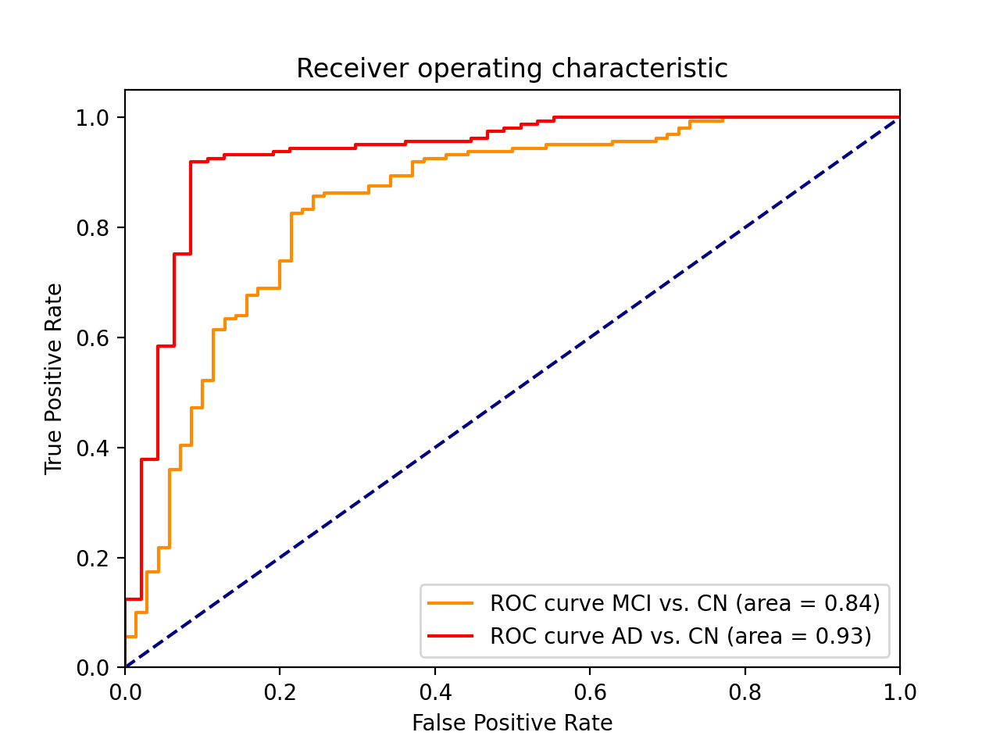

2024-06-11 22:52:07.707738: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:52:07.707991: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:52:07.708097: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

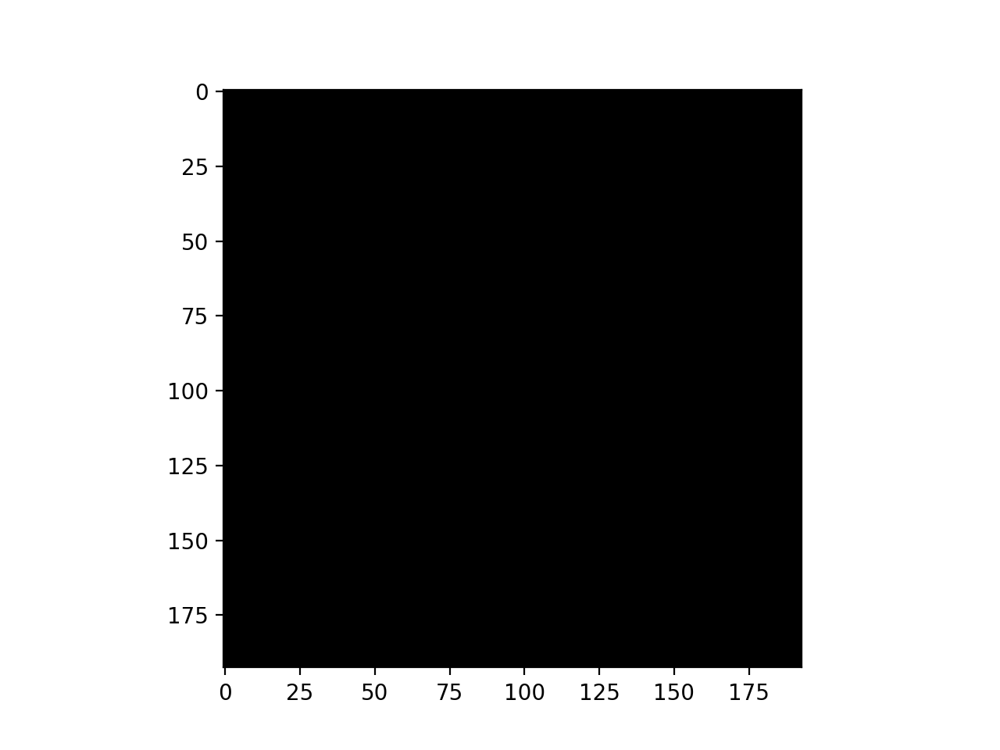

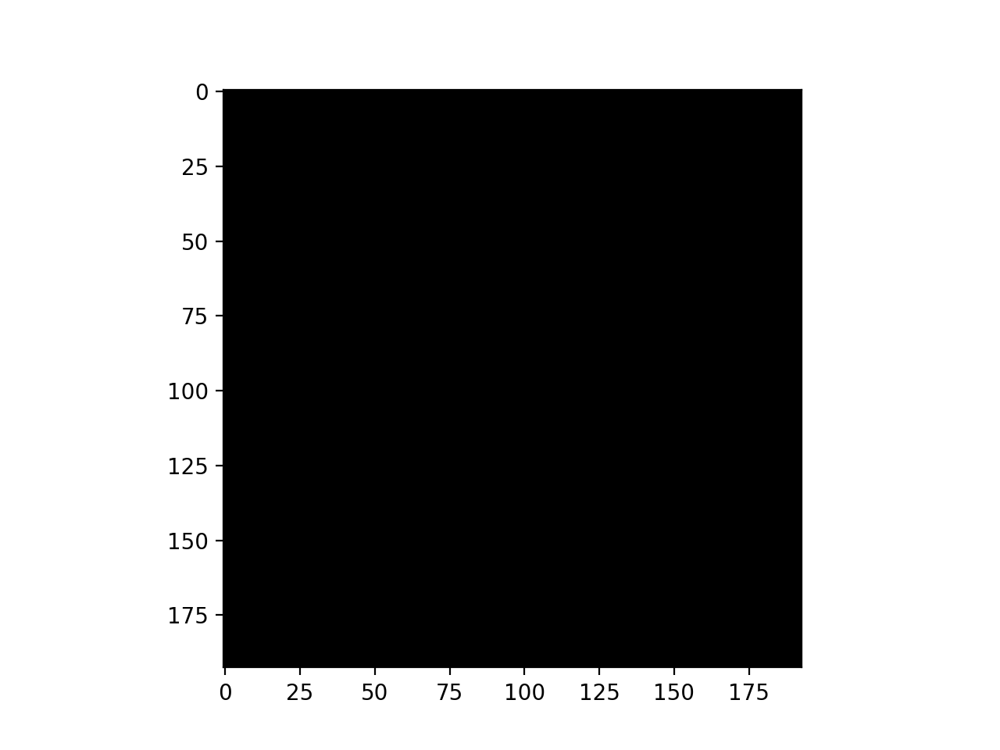

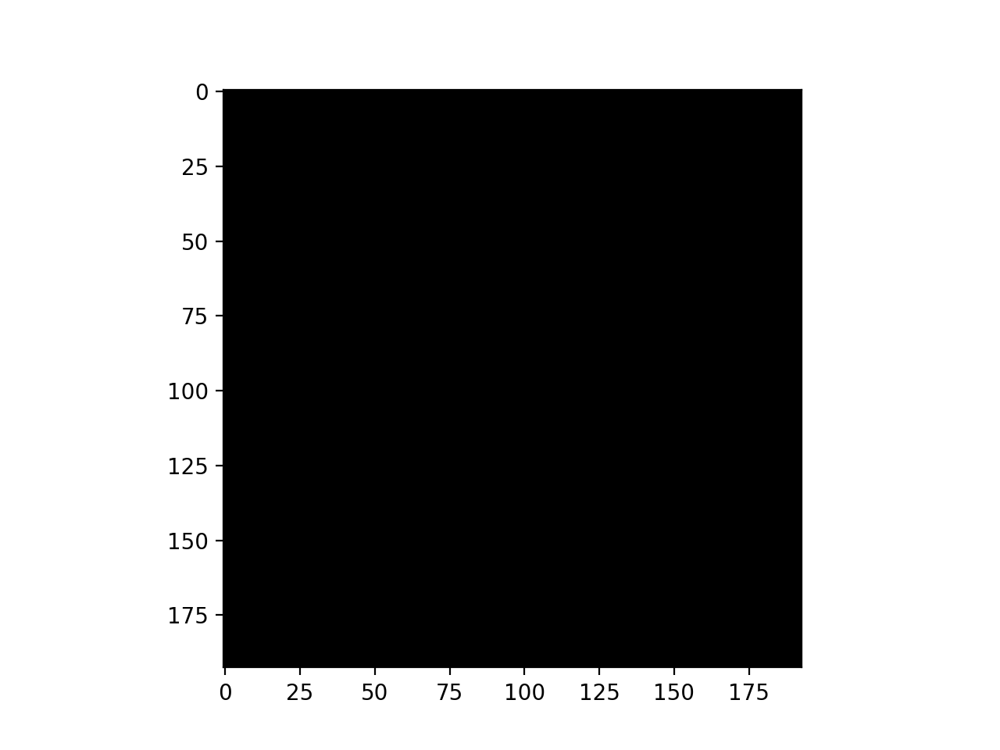

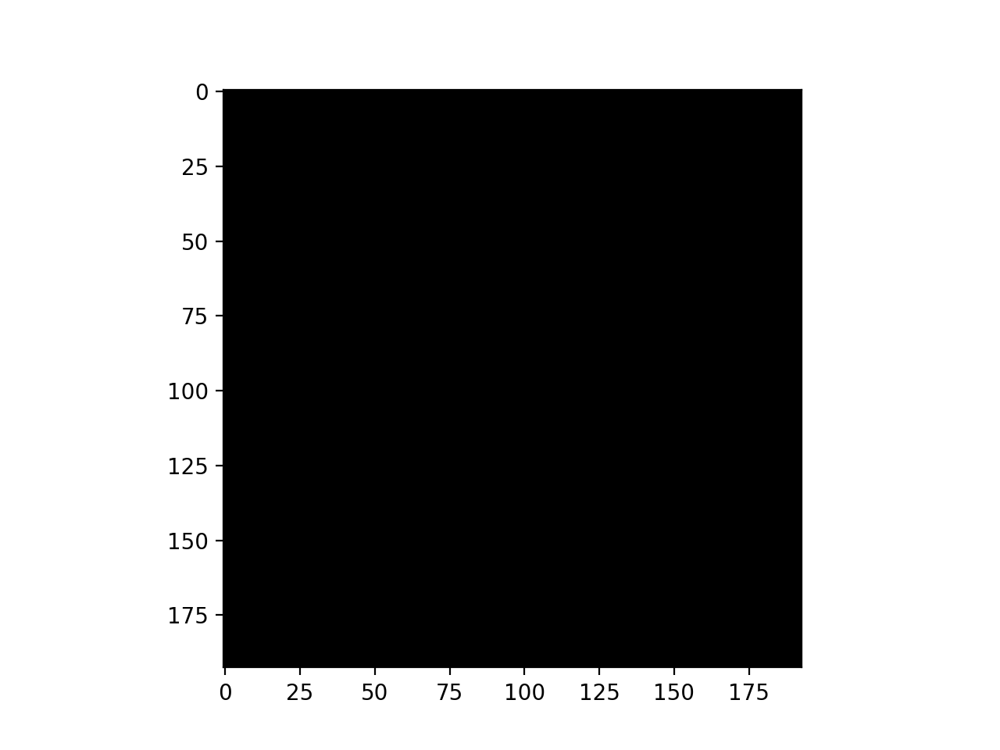

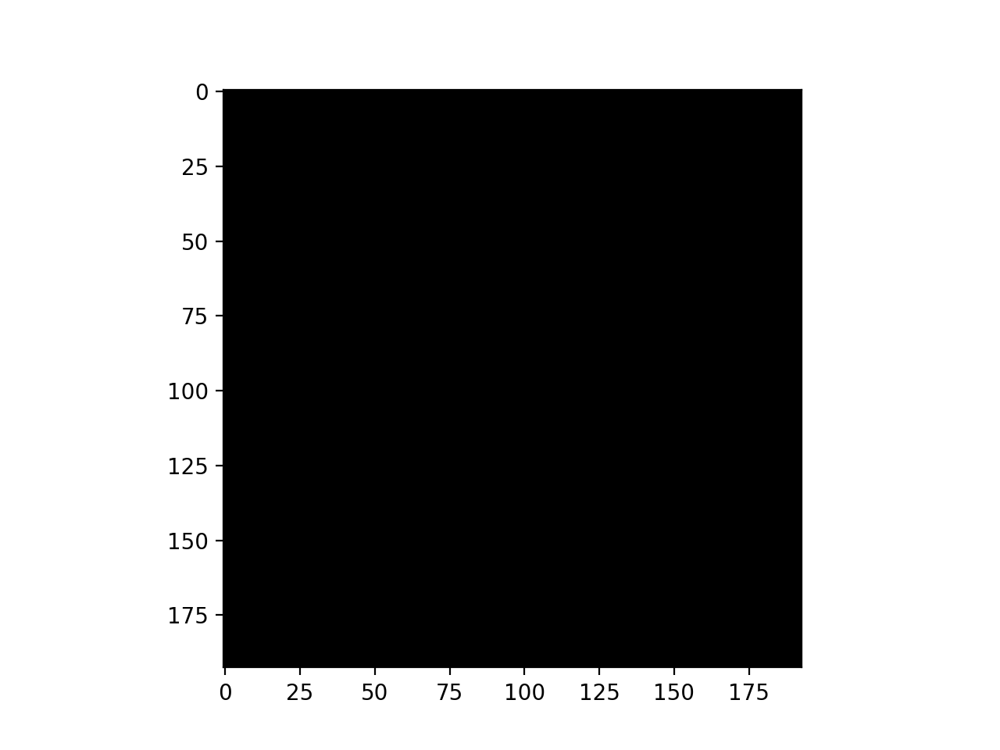

...

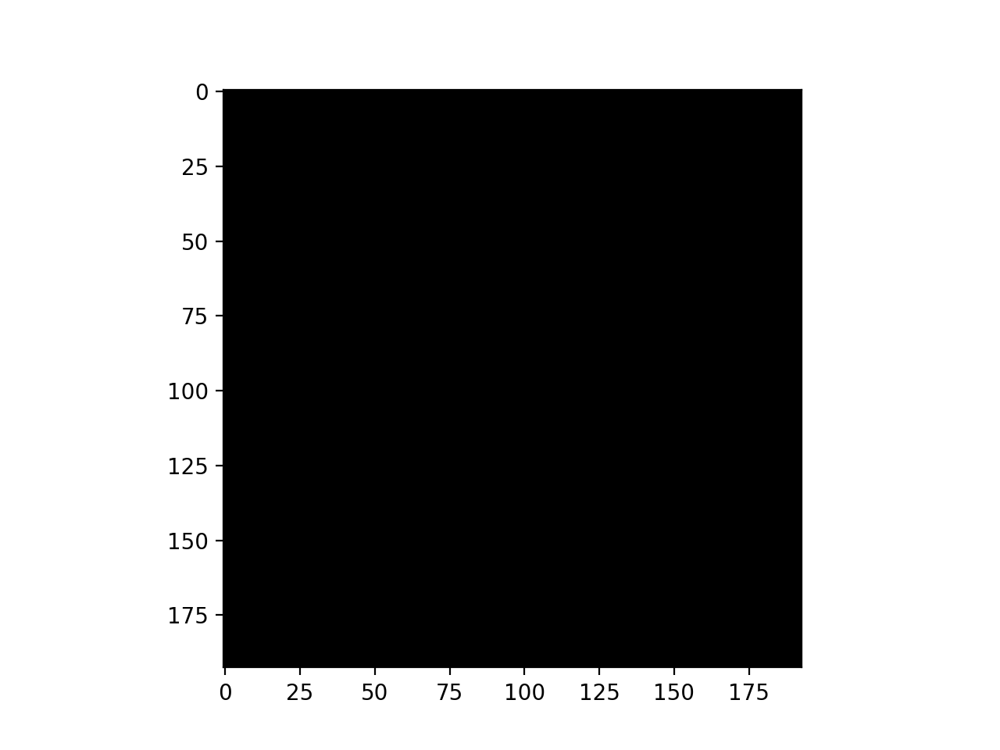

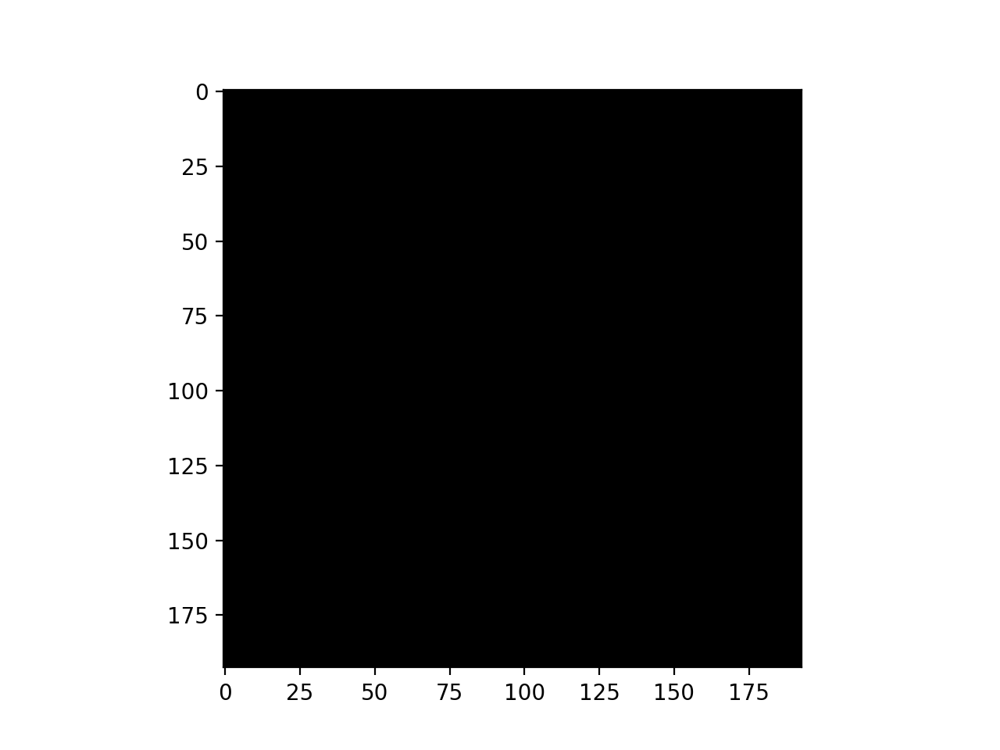

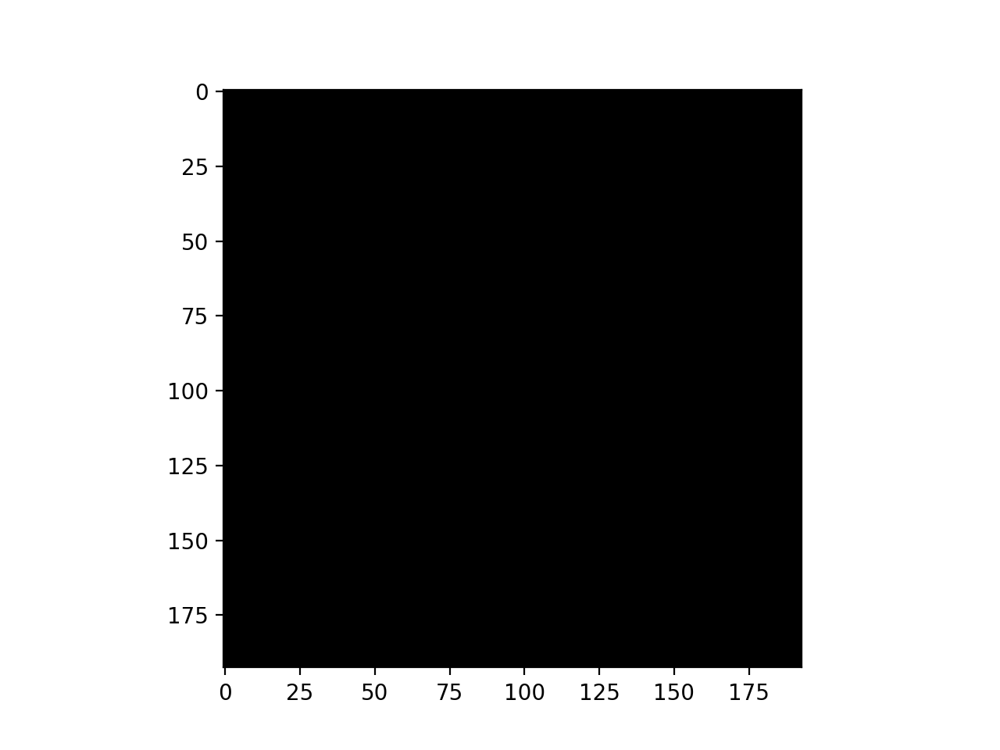

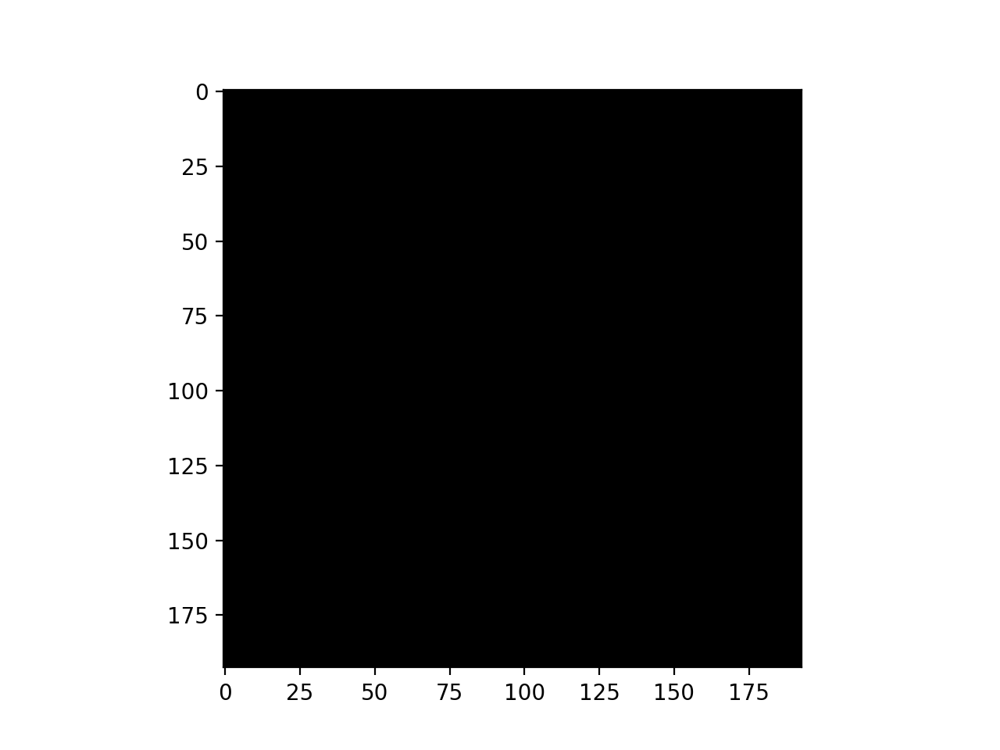

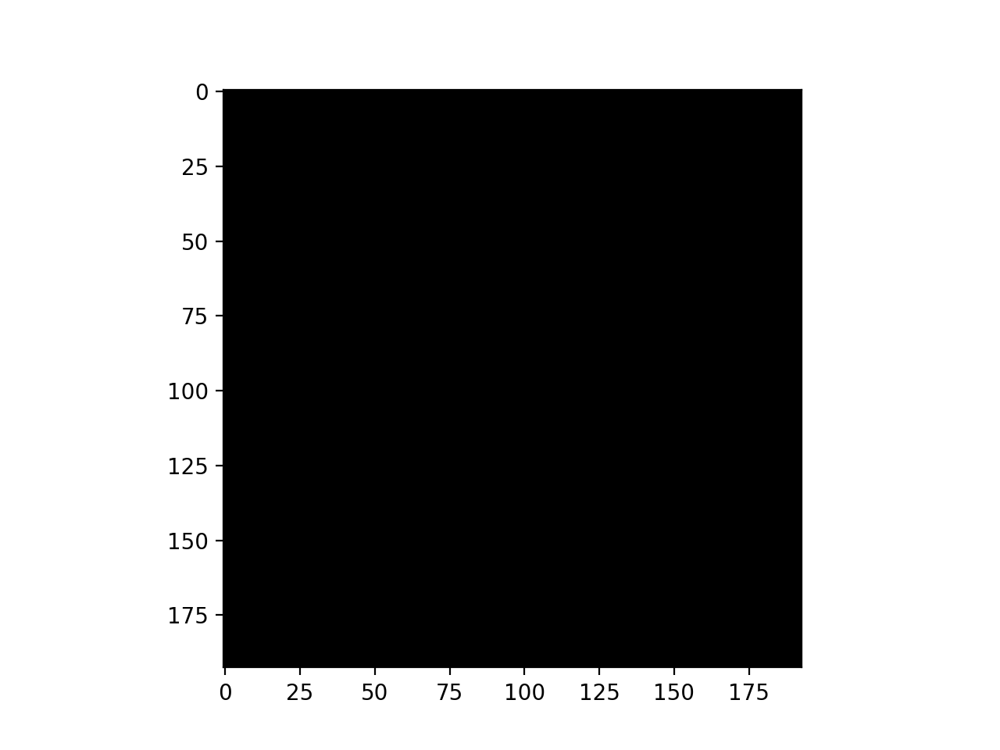

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-11 22:54:58.030341: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:54:58.030604: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-11 22:54:58.030713: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-11 22:55:10.815959: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-11 22:55:11.195617: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/conv3d_11/bias/v/Assign' id:2219 op device:{requested: '', assigned: ''} def:{{{node training/Adam/conv3d_11/bias/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false]

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.8993 - accuracy: 0.5657 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-11 23:09:21.760988: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 941s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.8993 - accuracy: 0.5657 - val_loss: 0.6652 - val_accuracy: 0.7464
Epoch 2/50
70/70 [==============================] - 870s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7352 - accuracy: 0.6547 - val_loss: 0.8808 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 875s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6178 - accuracy: 0.7080 - val_loss: 0.5100 - val_accuracy: 0.7964
Epoch 4/50
70/70 [==============================] - 889s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6035 - accuracy: 0.7209 - val_loss: 0.4527 - val_accuracy: 0.8214
Epoch 5/50
70/70 [==============================] - 882s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.5979 - accuracy: 0.7156 - val_loss: 0.5016 - val_accuracy: 0.7714
Epoch 6/50
70/70 [==============================] - 883s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6054 - accuracy: 0.7182 - v

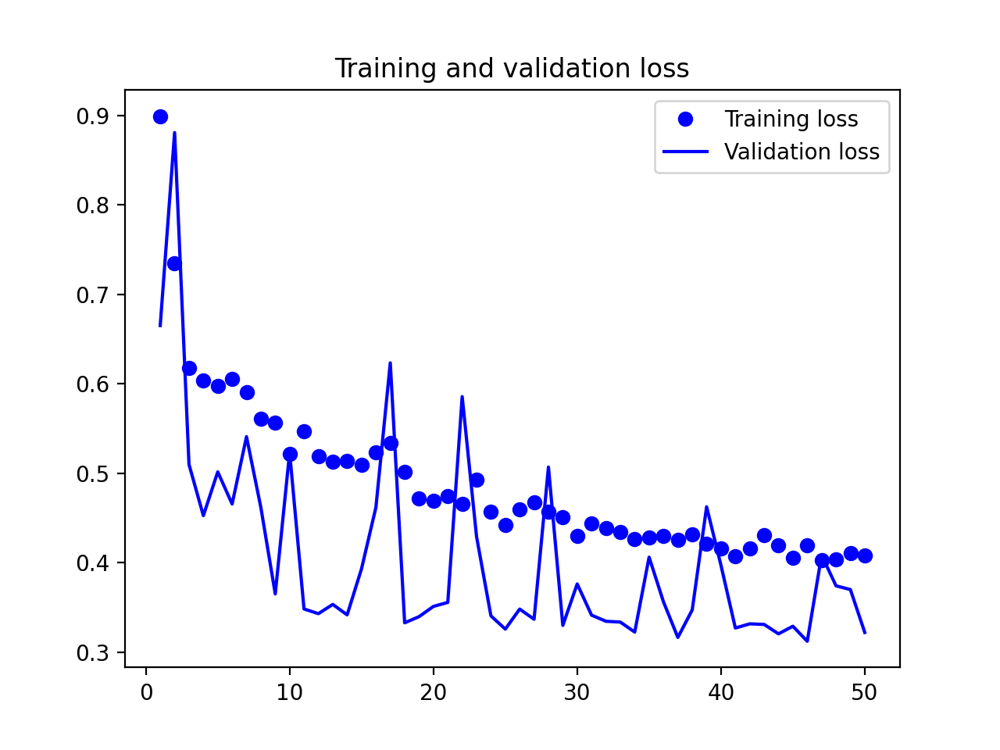

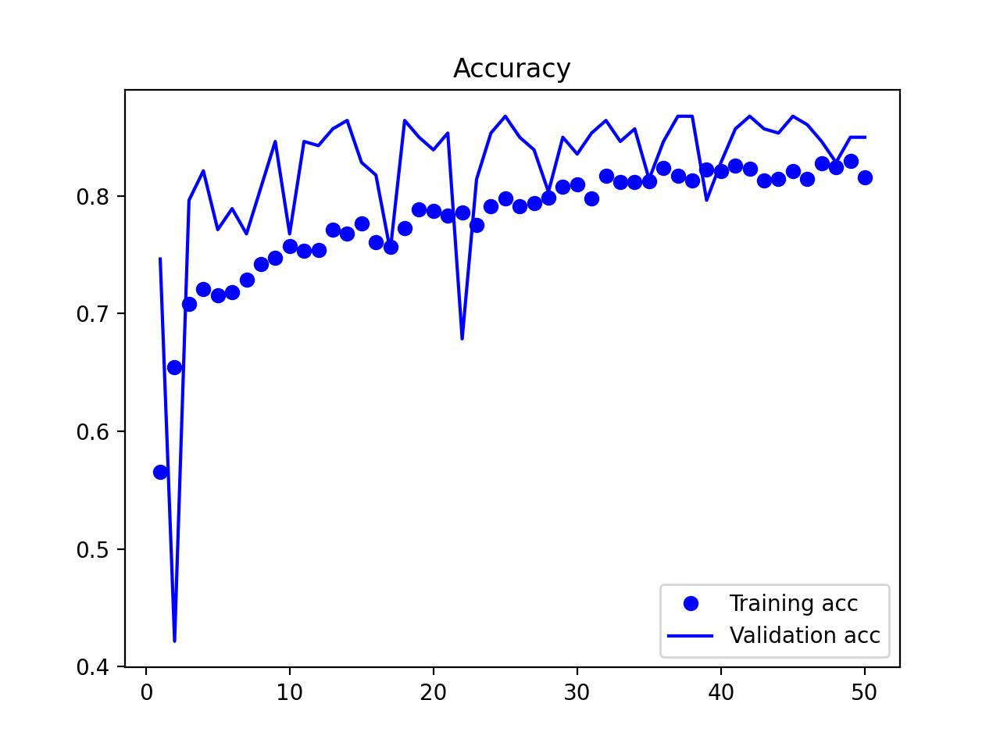

2024-06-12 11:14:33.615043: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:14:33.615403: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:14:33.615520: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.963
Acc for AD vs. CN = 86.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

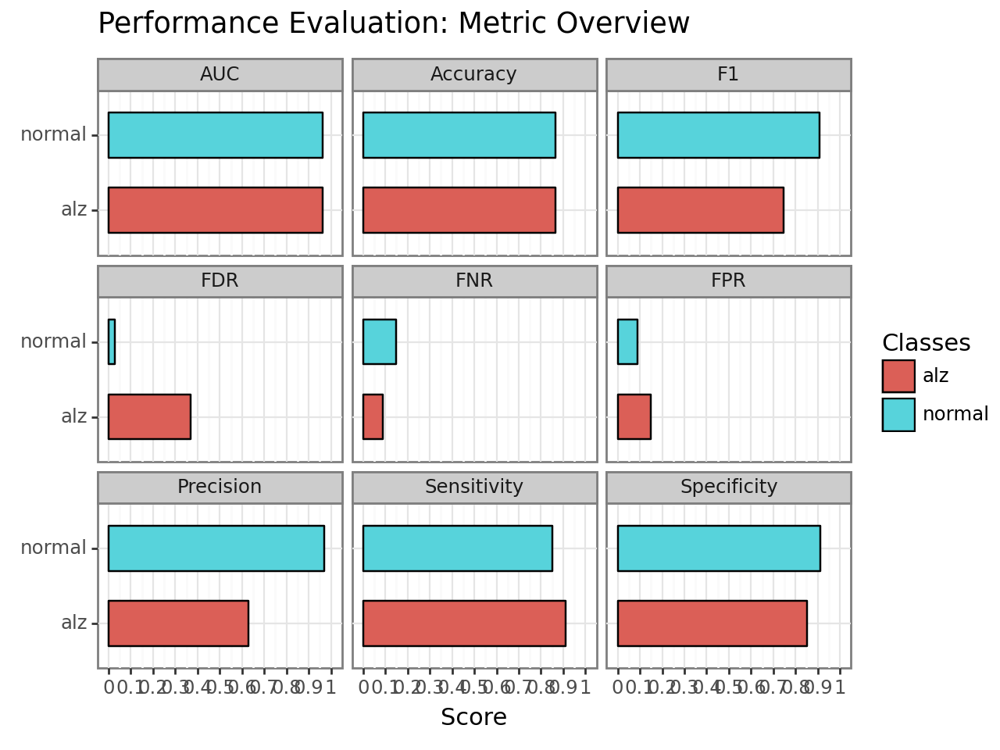

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv07/plot.performance.confusion_matrix.png


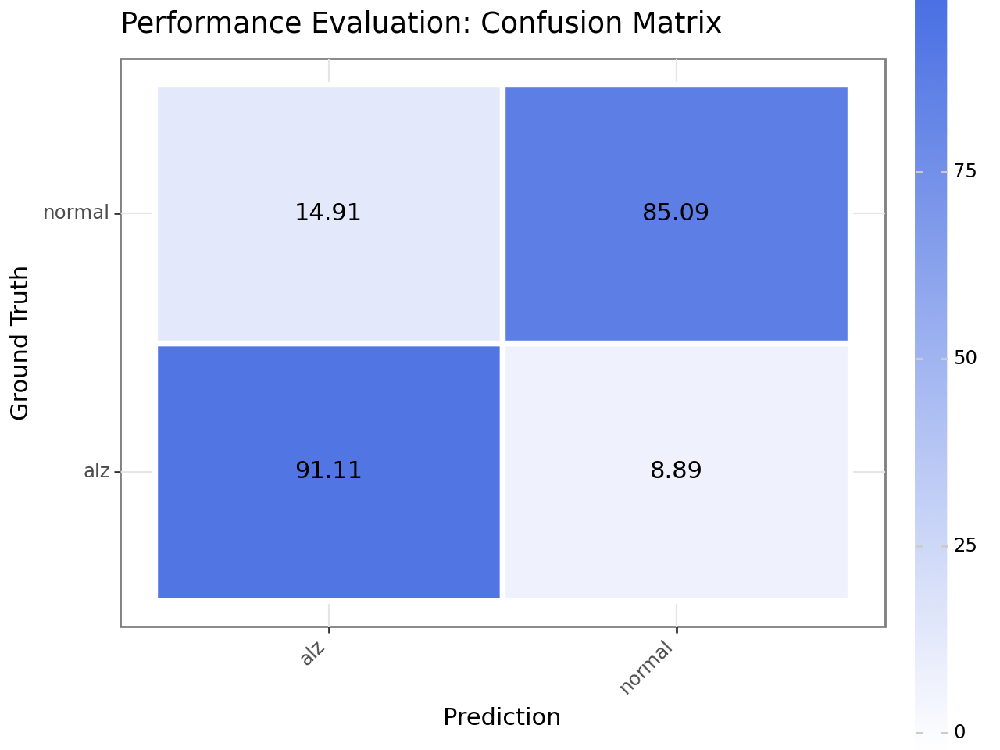

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv07/plot.performance.roc.png


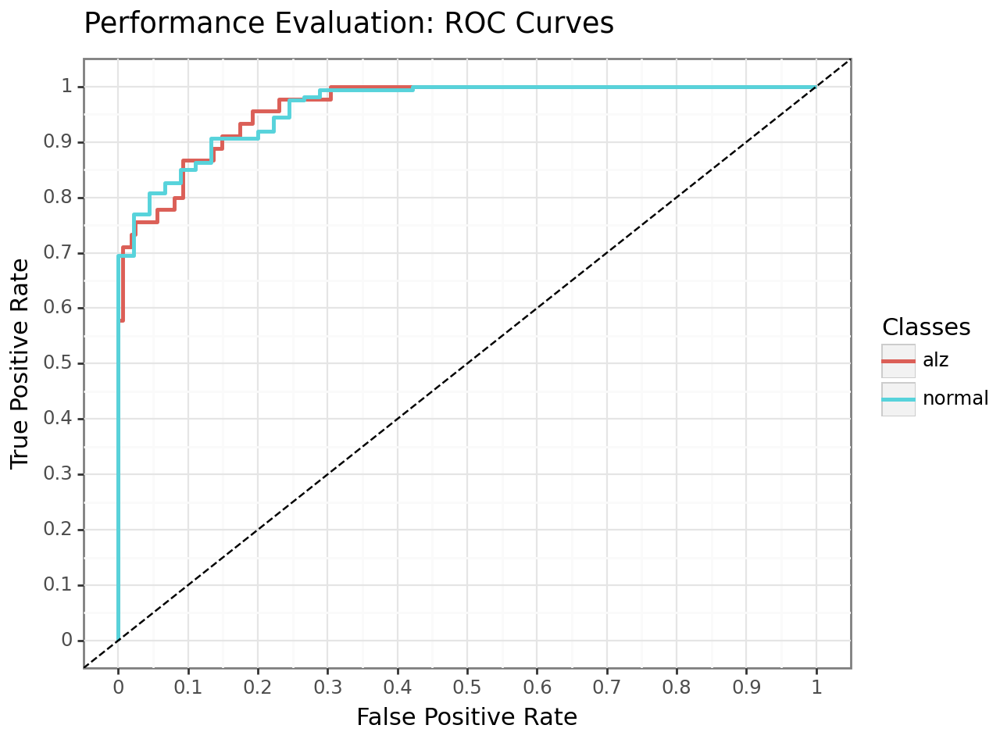


AUC for MCI vs. CN = 0.770
Acc for MCI vs. CN = 78.1


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

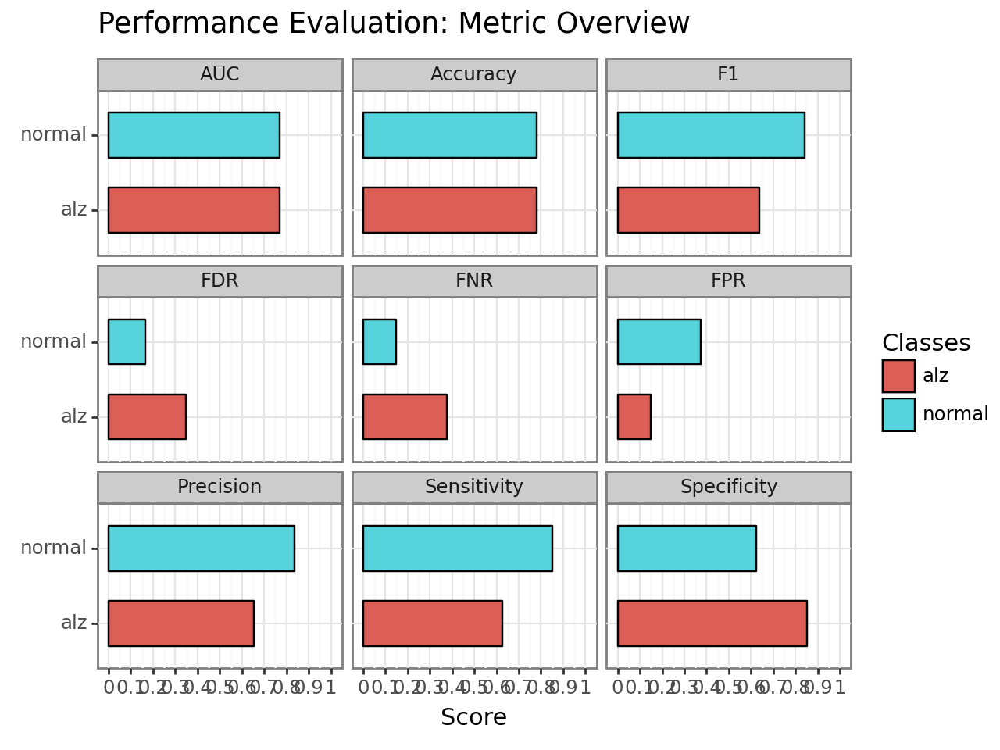

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv07/plot.performance.confusion_matrix.png


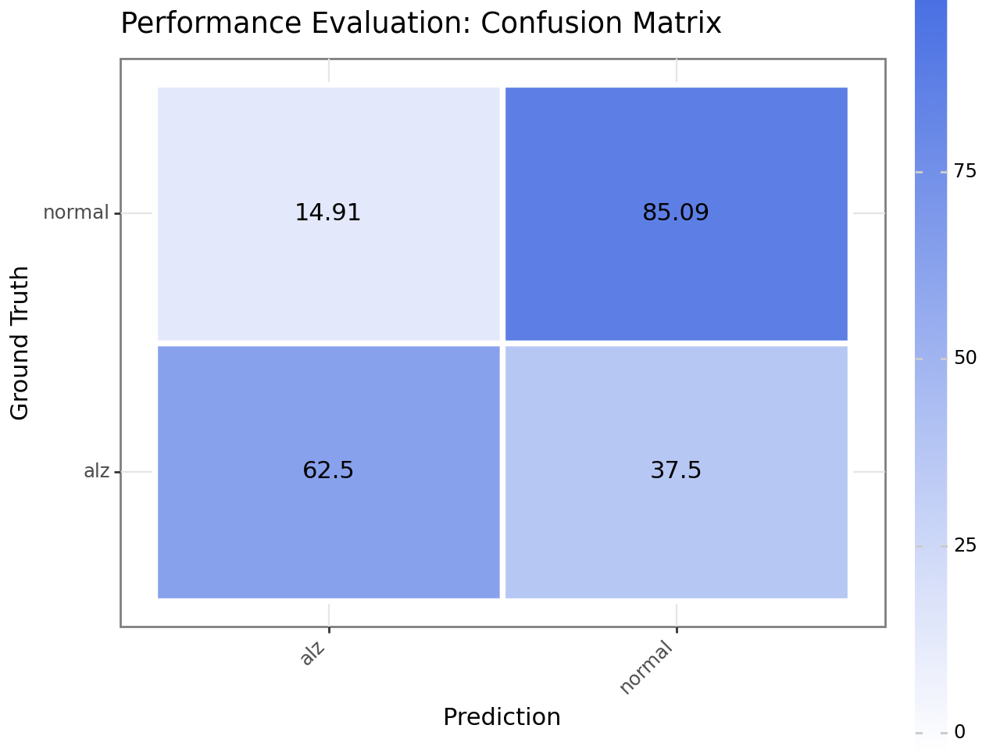

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv07/plot.performance.roc.png


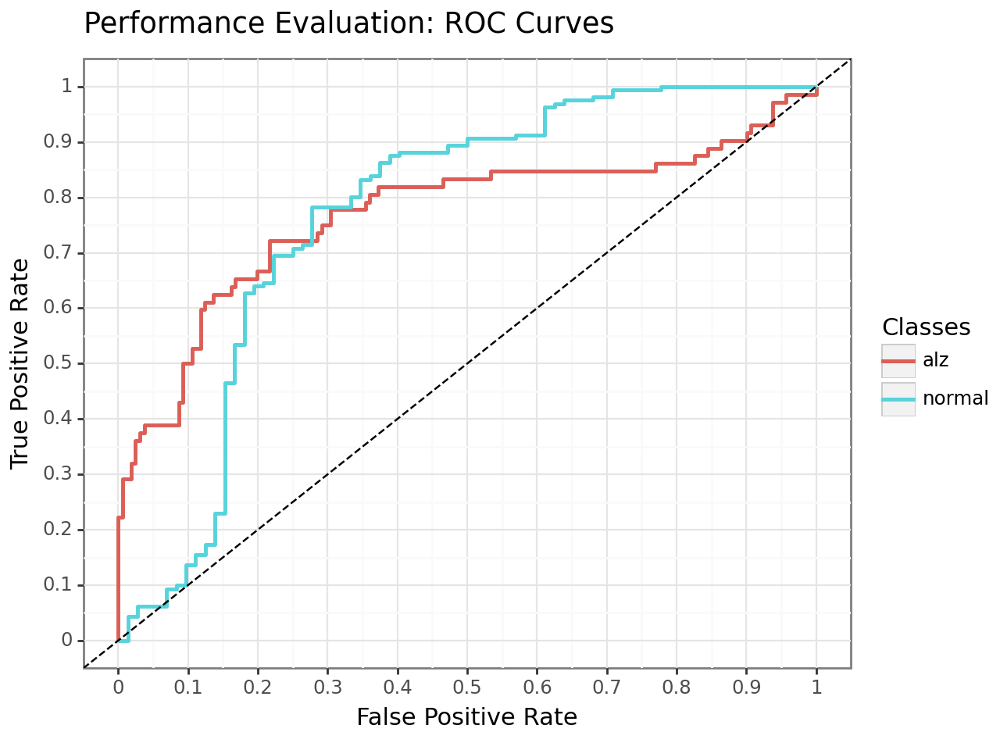

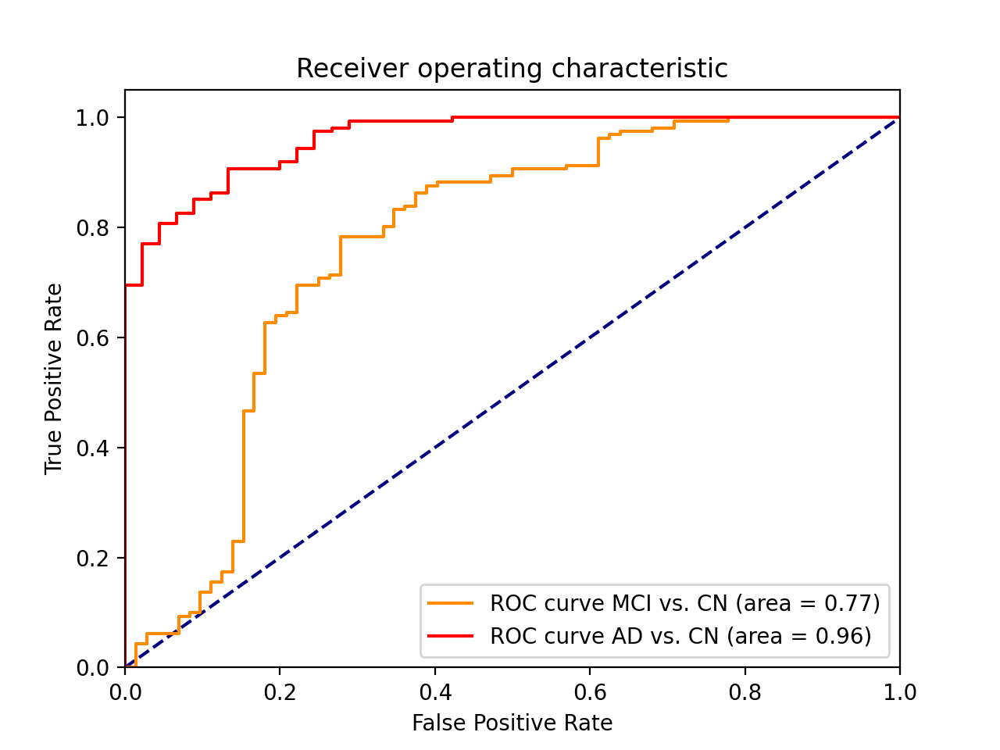

2024-06-12 11:16:00.098488: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:16:00.098898: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:16:00.099023: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

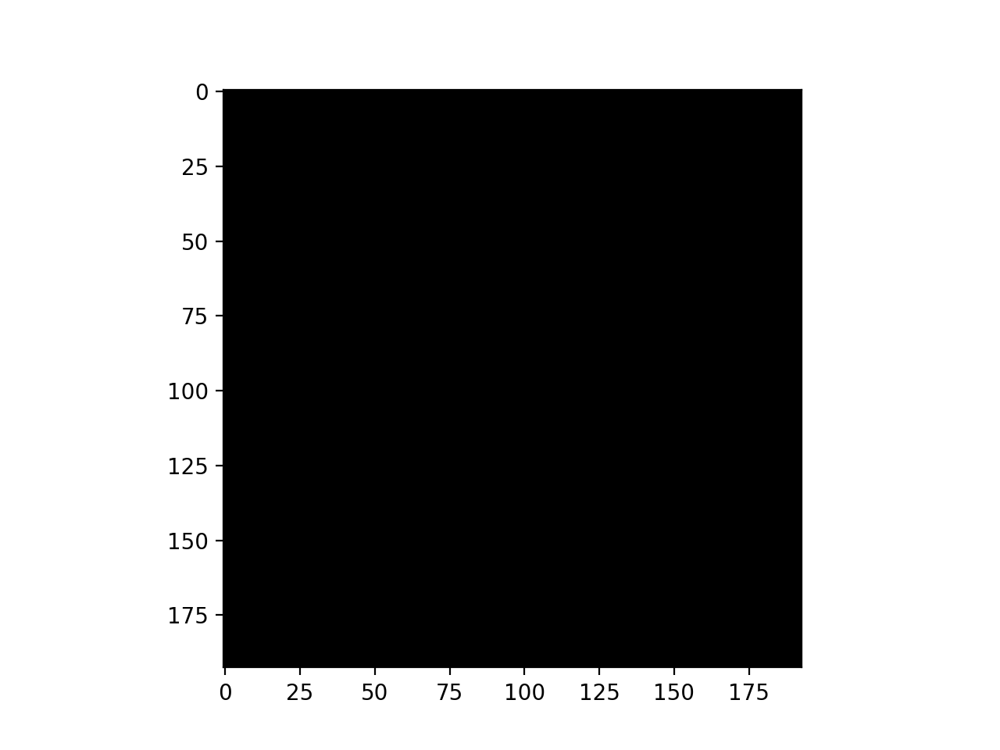

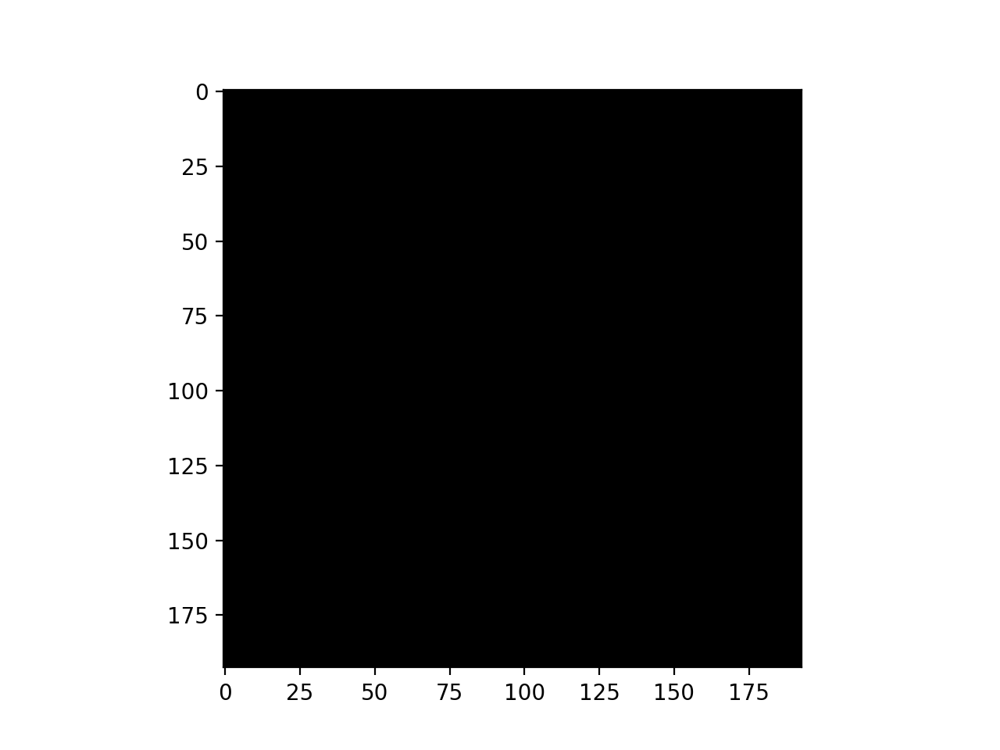

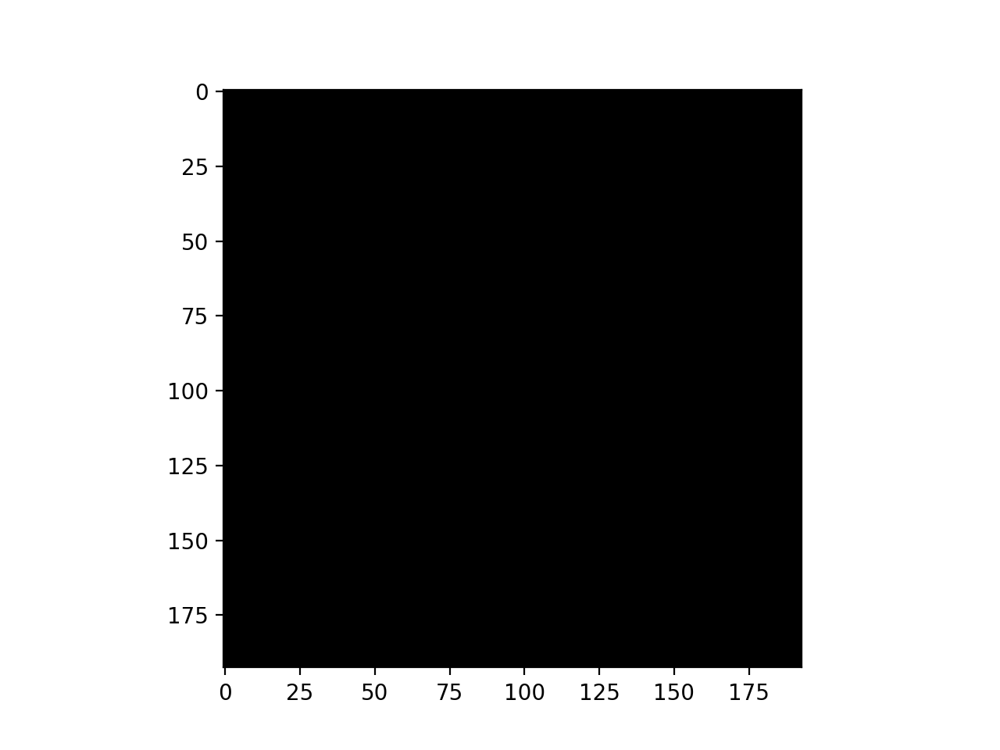

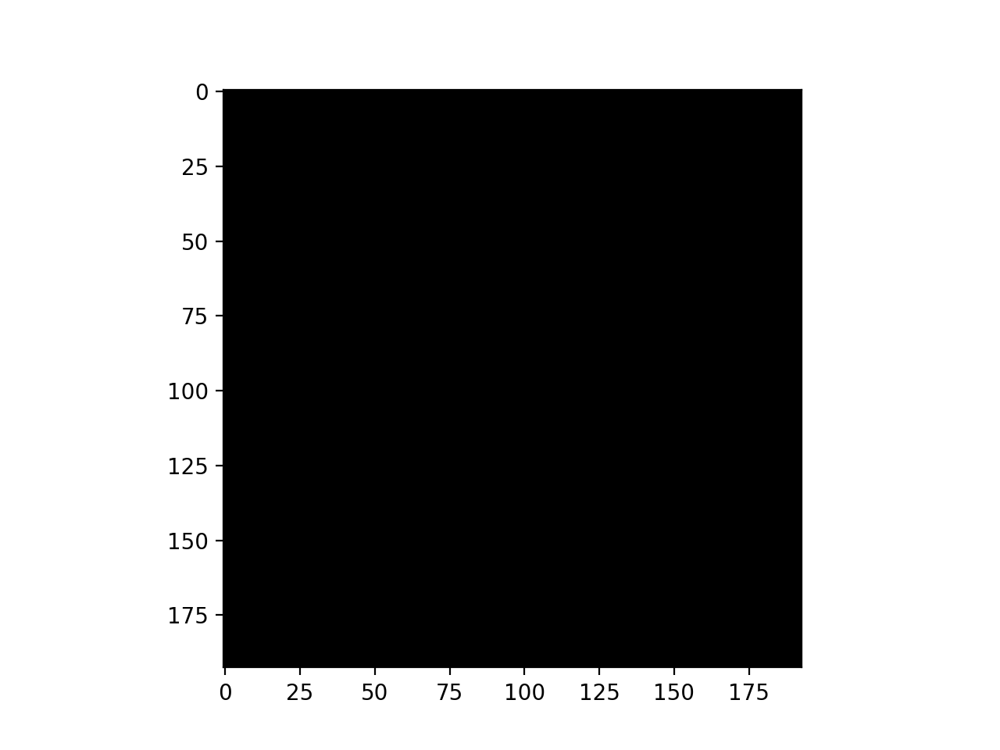

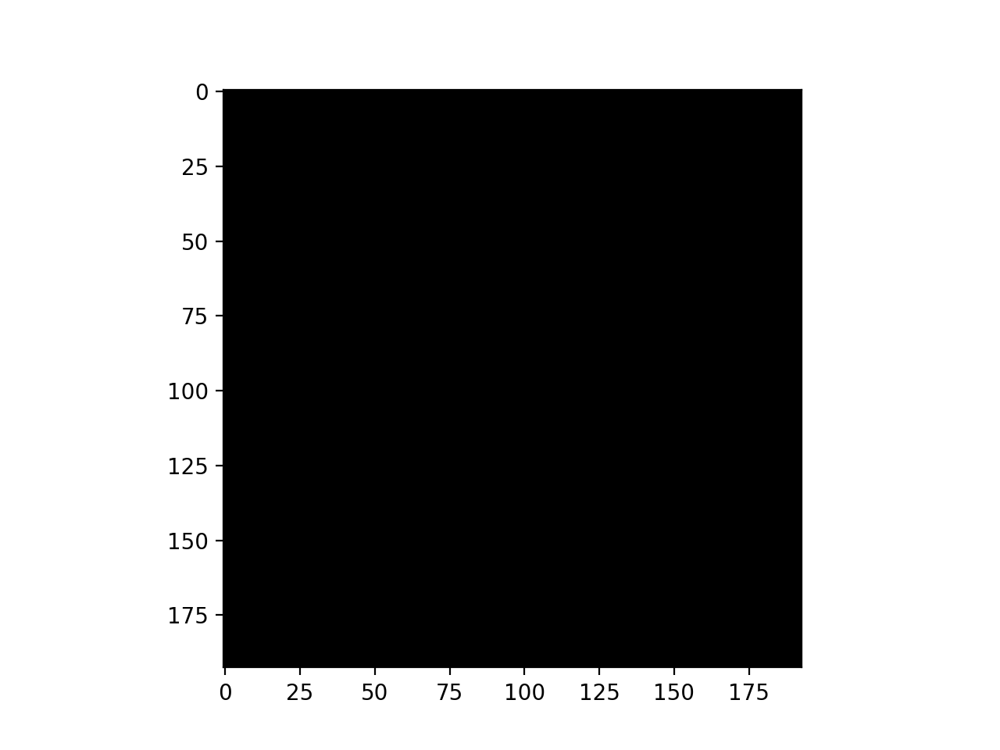

...

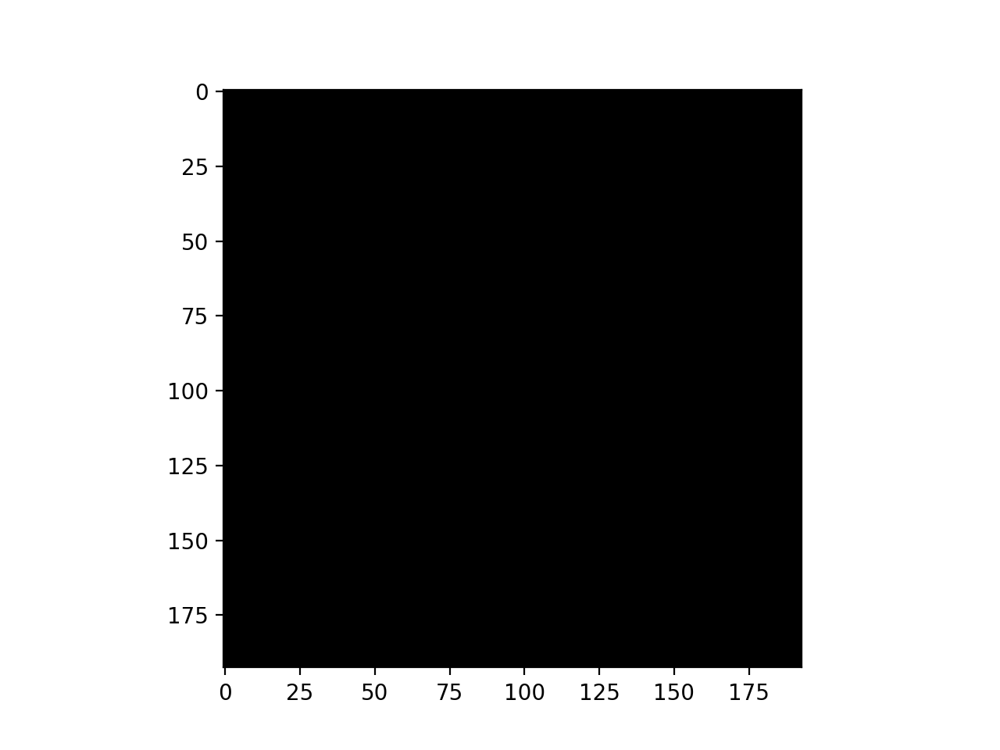

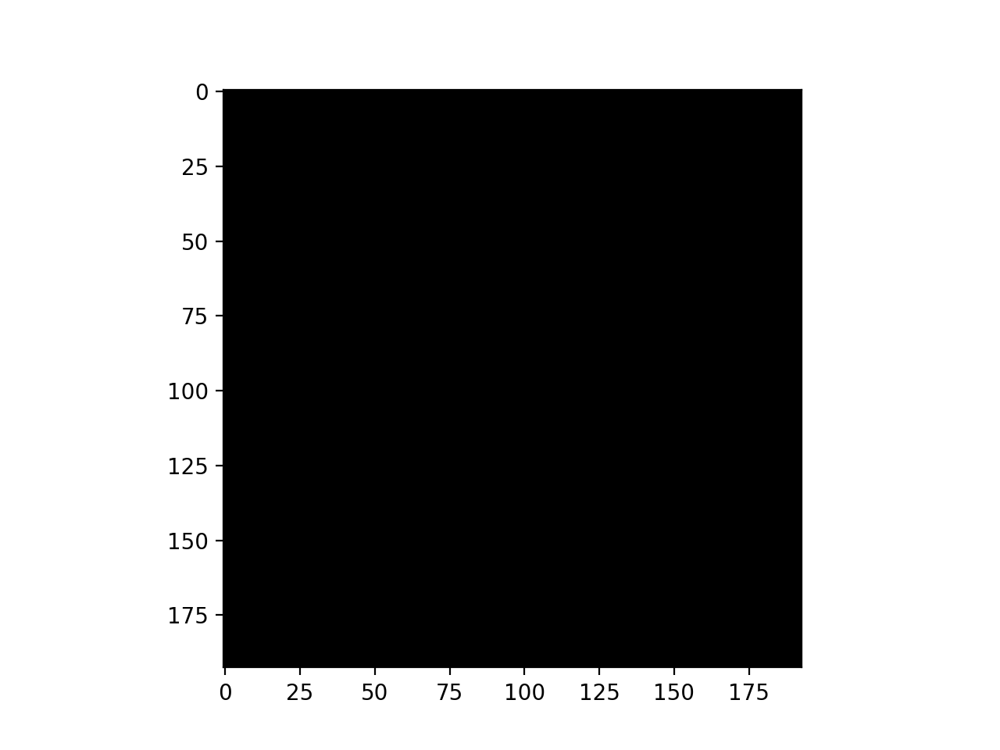

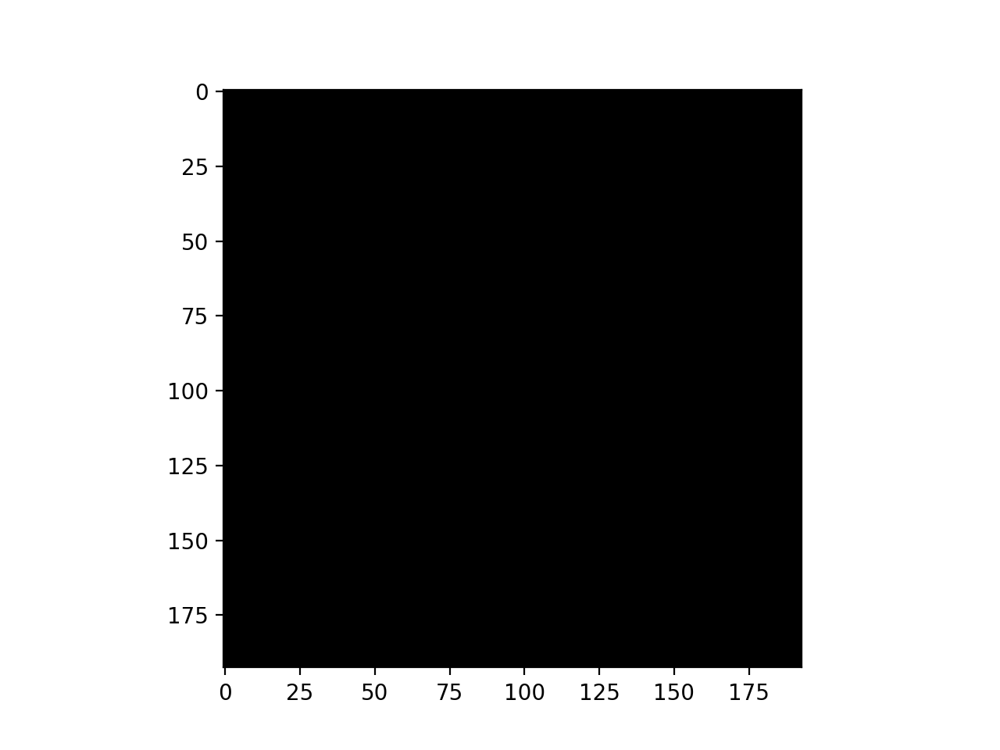

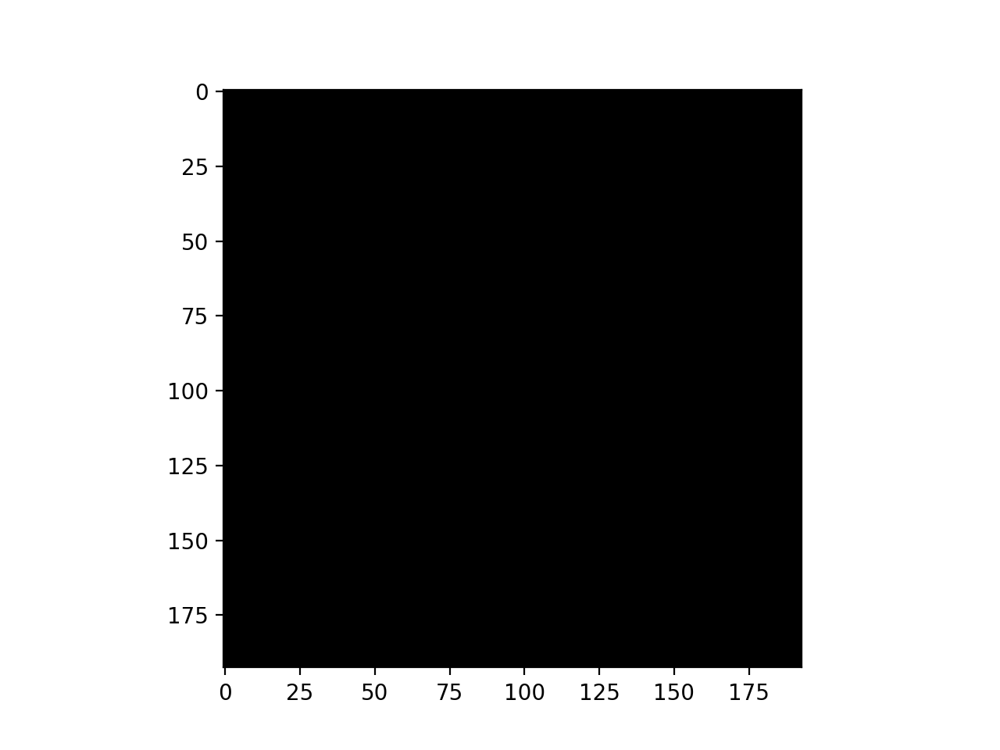

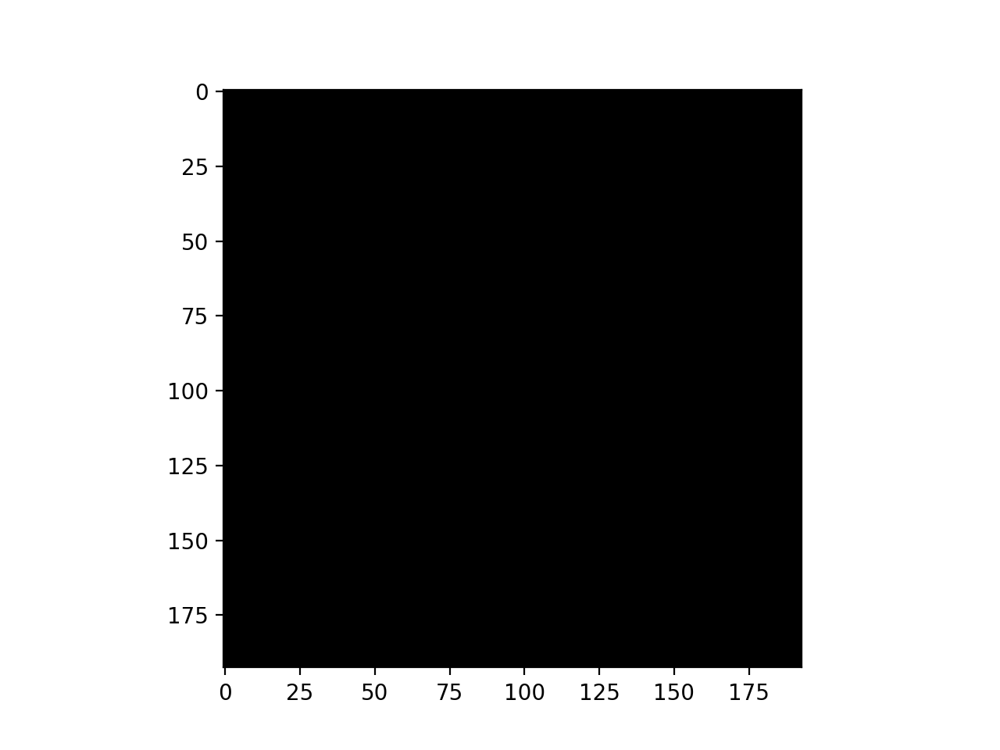

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-12 11:18:52.734801: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:18:52.735072: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-12 11:18:52.735185: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-12 11:19:06.815462: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-12 11:19:07.132153: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/batch_normalization_11/gamma/v/Assign' id:2224 op device:{requested: '', assigned: ''} def:{{{node training/Adam/batch_normalization_11/gamma/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 1.0251 - accuracy: 0.5599 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-12 11:33:42.267296: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 988s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 1.0250 - accuracy: 0.5599 - val_loss: 0.7673 - val_accuracy: 0.4214
Epoch 2/50
70/70 [==============================] - 889s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6989 - accuracy: 0.6409 - val_loss: 0.8867 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 890s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6509 - accuracy: 0.6744 - val_loss: 0.7854 - val_accuracy: 0.4214
Epoch 4/50
70/70 [==============================] - 885s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6352 - accuracy: 0.7129 - val_loss: 0.5815 - val_accuracy: 0.7000
Epoch 5/50
70/70 [==============================] - 1135s 16s/step - batch: 34.5000 - size: 31.9429 - loss: 0.5924 - accuracy: 0.7218 - val_loss: 0.4661 - val_accuracy: 0.8179
Epoch 6/50
70/70 [==============================] - 1015s 15s/step - batch: 34.5000 - size: 31.9429 - loss: 0.5994 - accuracy: 0.7093 -

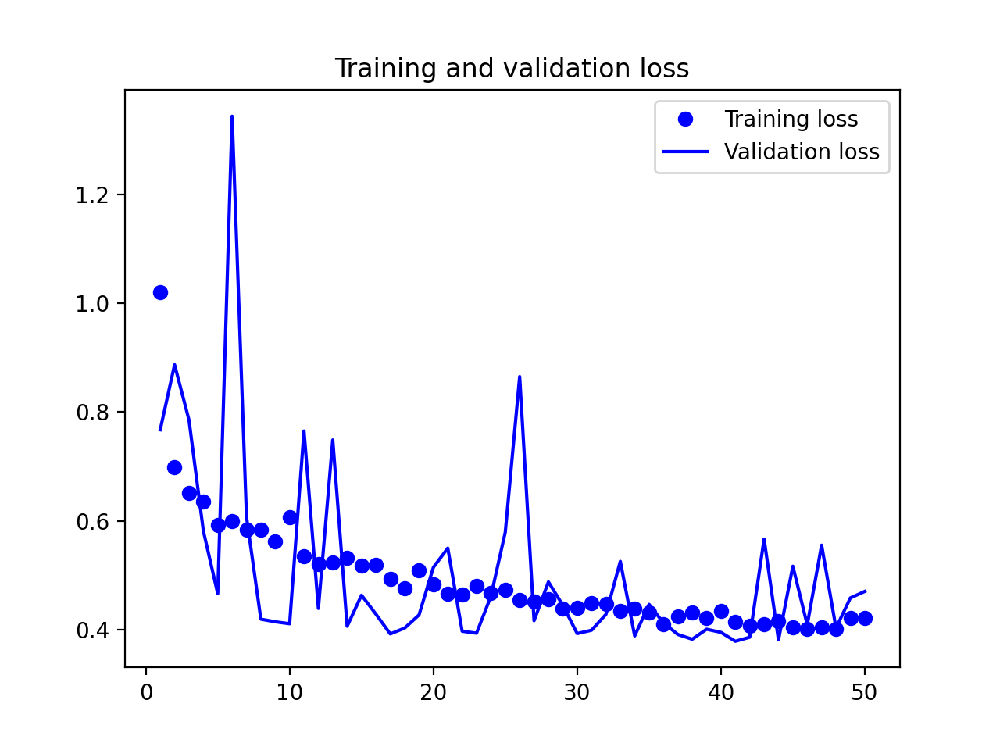

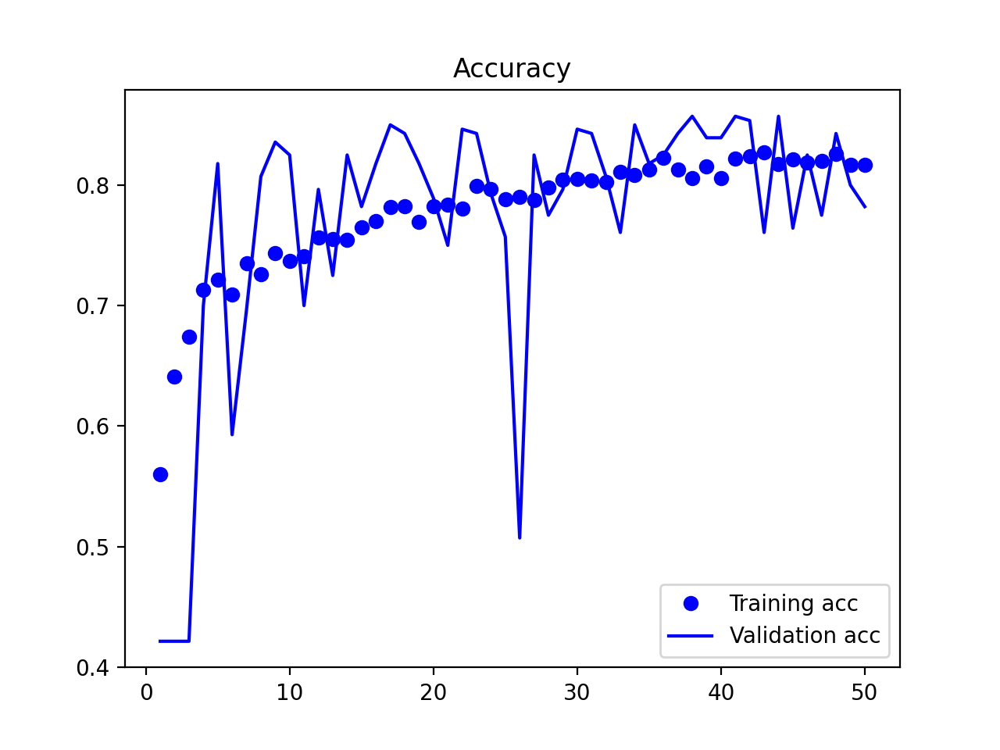

2024-06-13 00:21:56.127569: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:21:56.140734: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:21:56.140926: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.975
Acc for AD vs. CN = 88.0


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

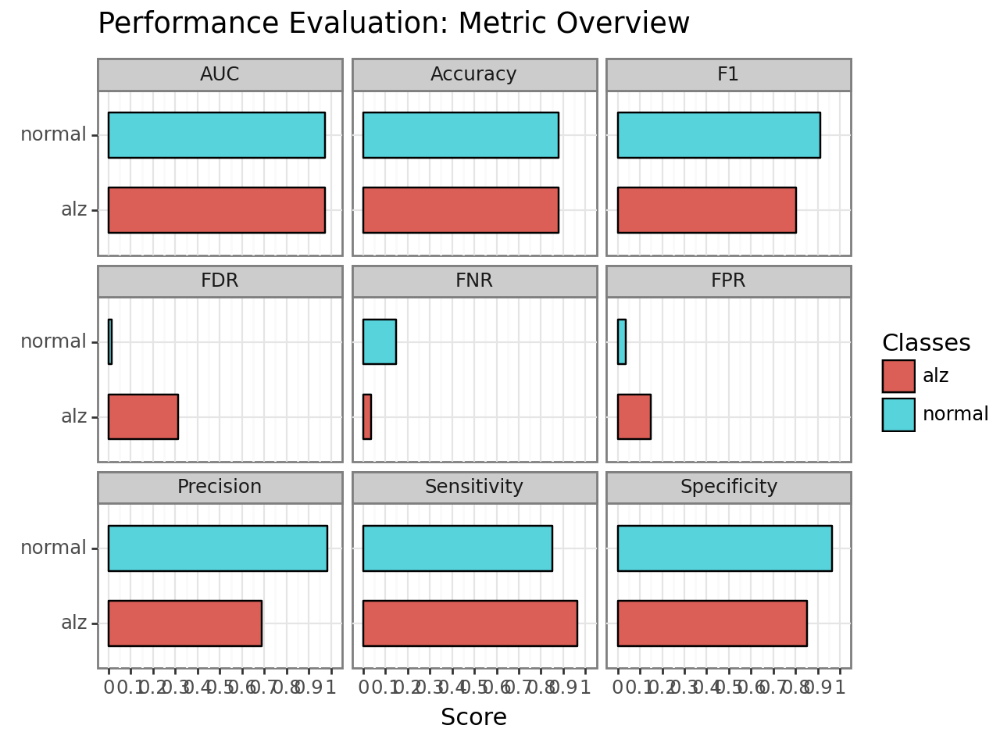

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv08/plot.performance.confusion_matrix.png


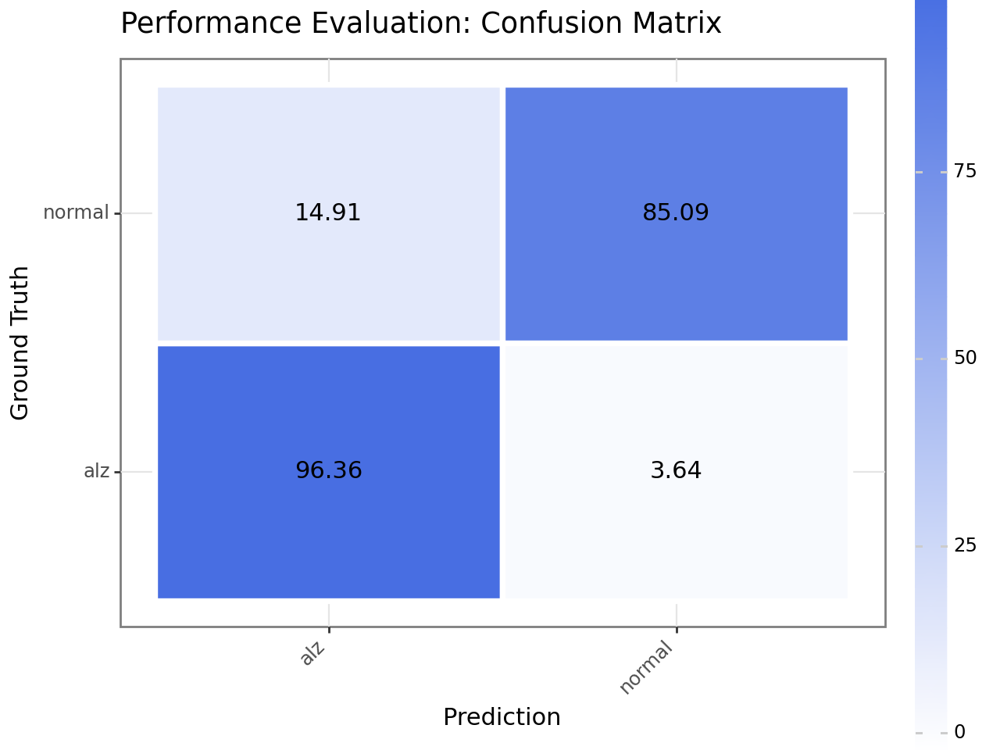

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv08/plot.performance.roc.png


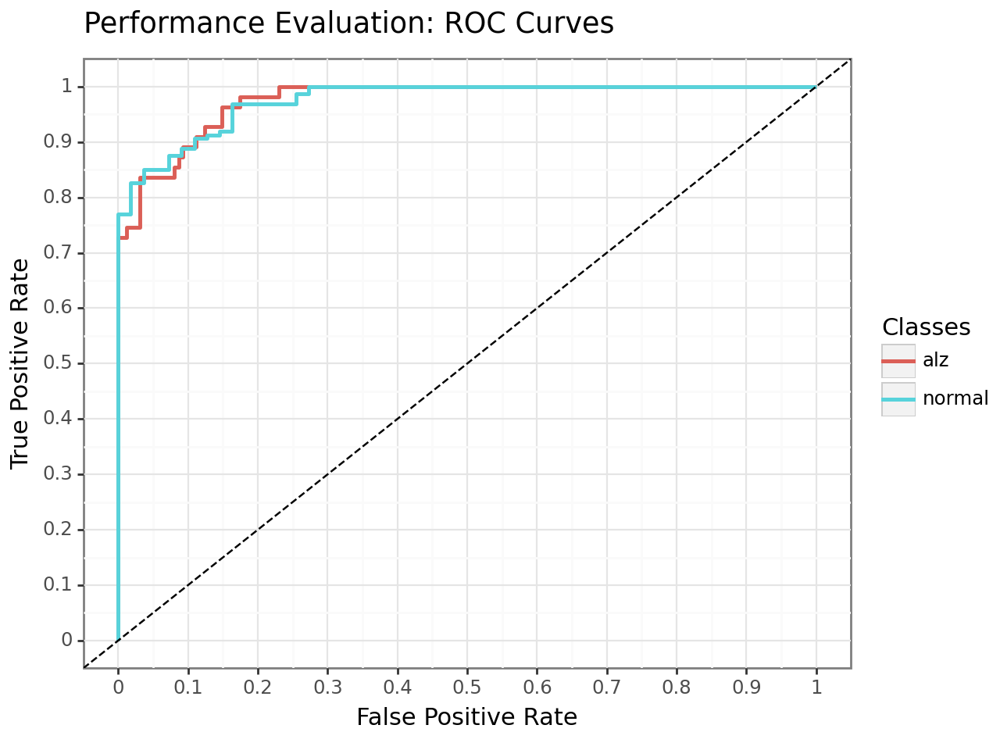


AUC for MCI vs. CN = 0.798
Acc for MCI vs. CN = 79.8


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

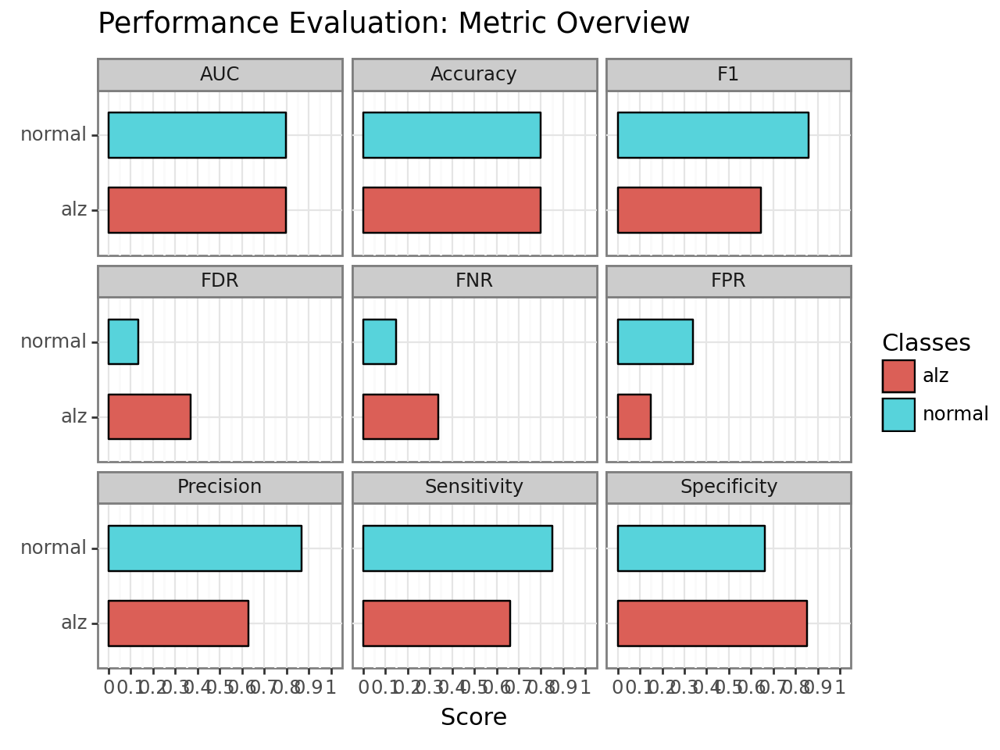

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv08/plot.performance.confusion_matrix.png


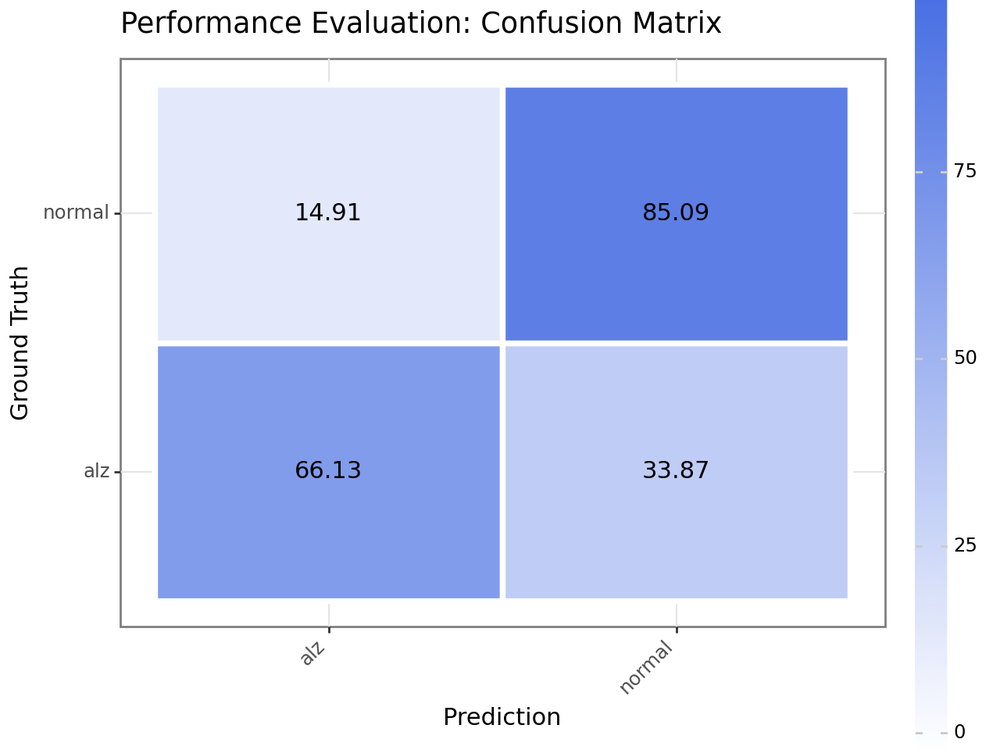

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv08/plot.performance.roc.png


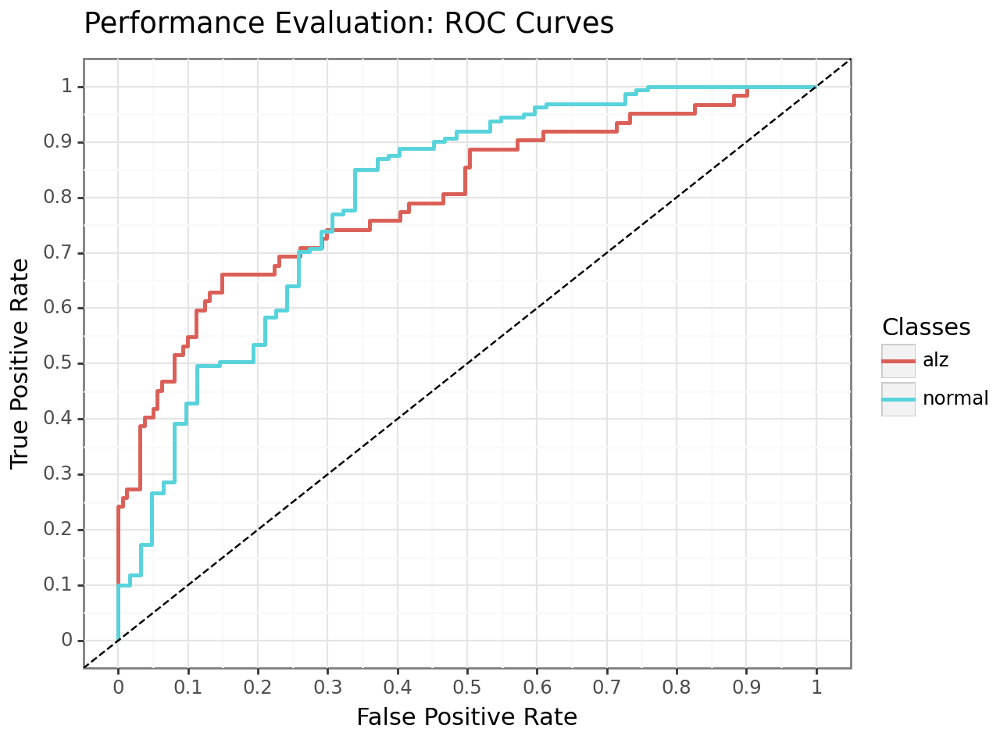

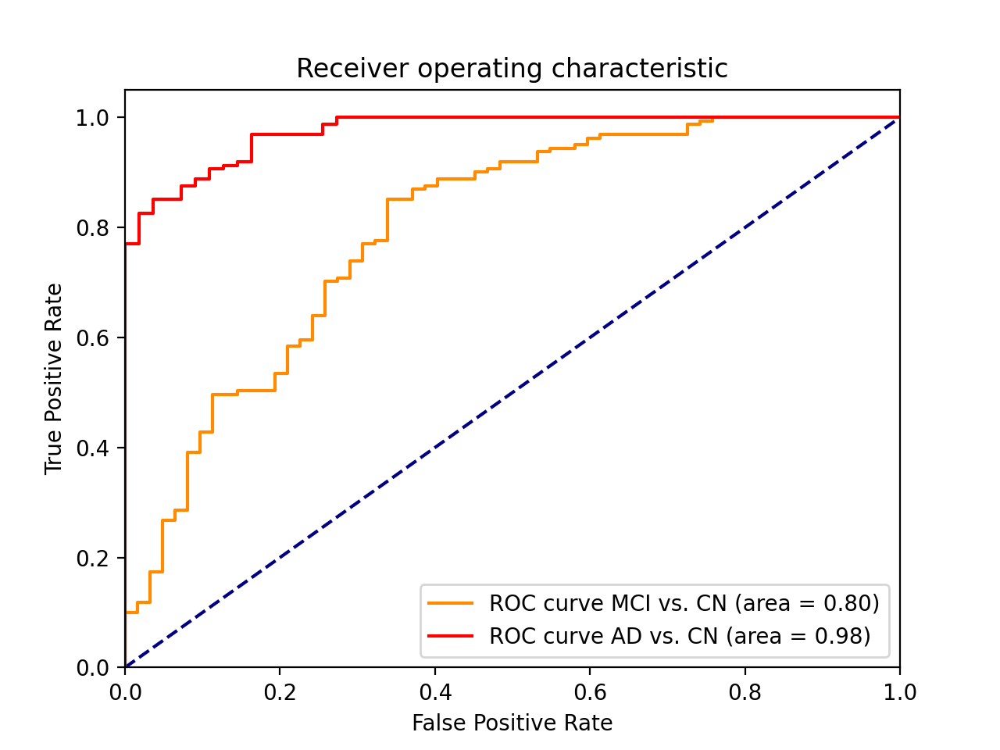

2024-06-13 00:23:25.753058: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:23:25.753476: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:23:25.753640: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

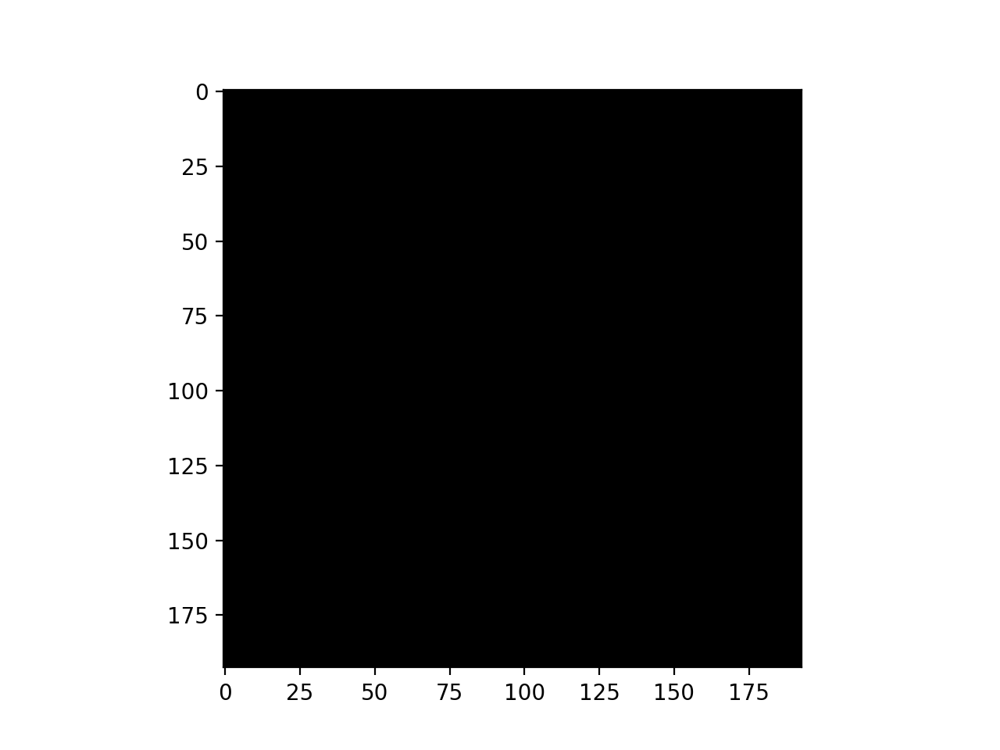

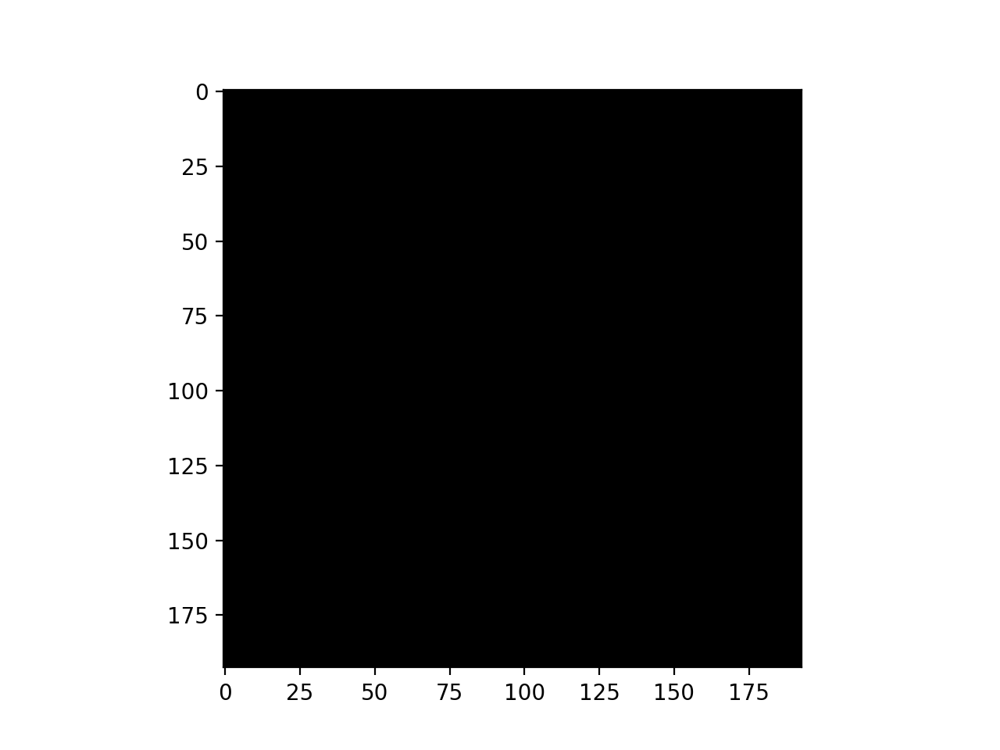

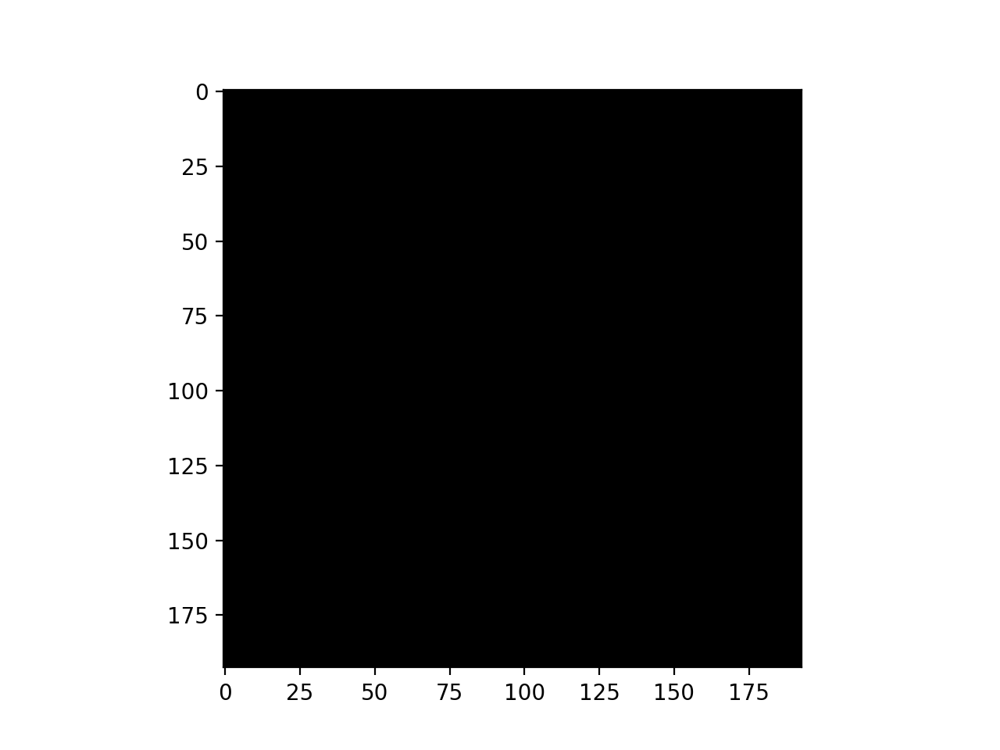

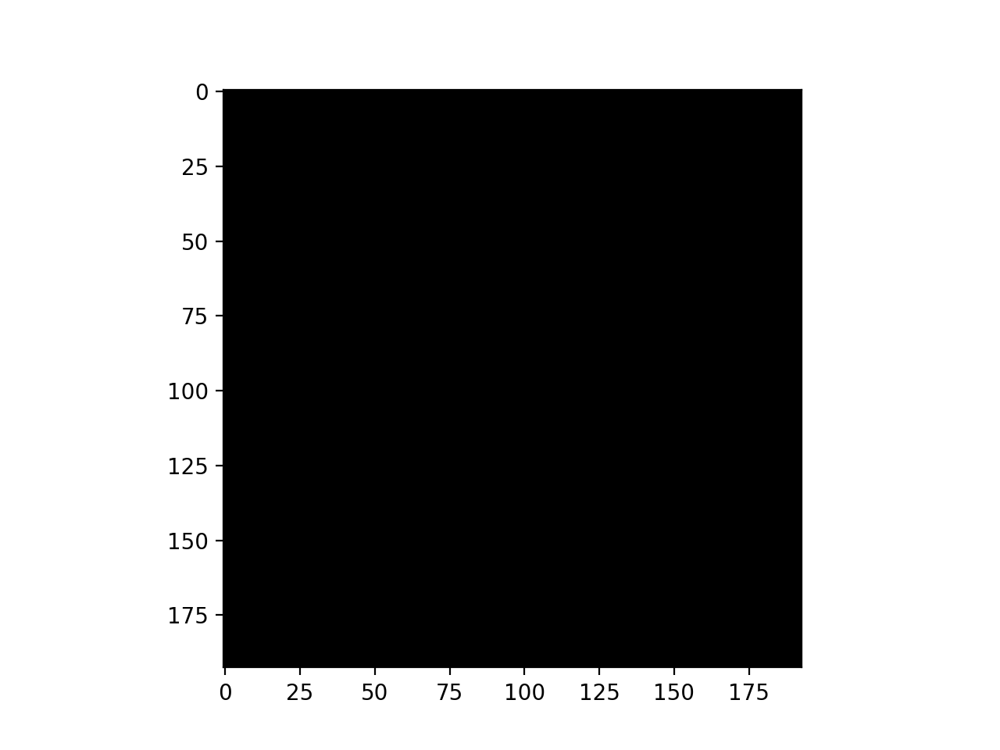

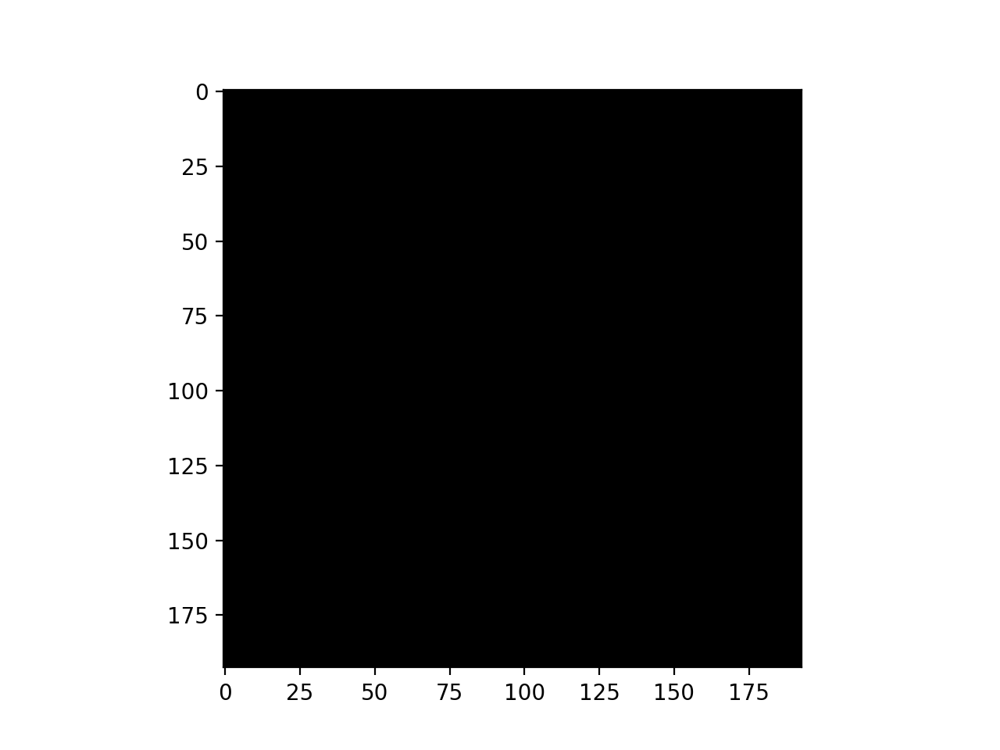

...

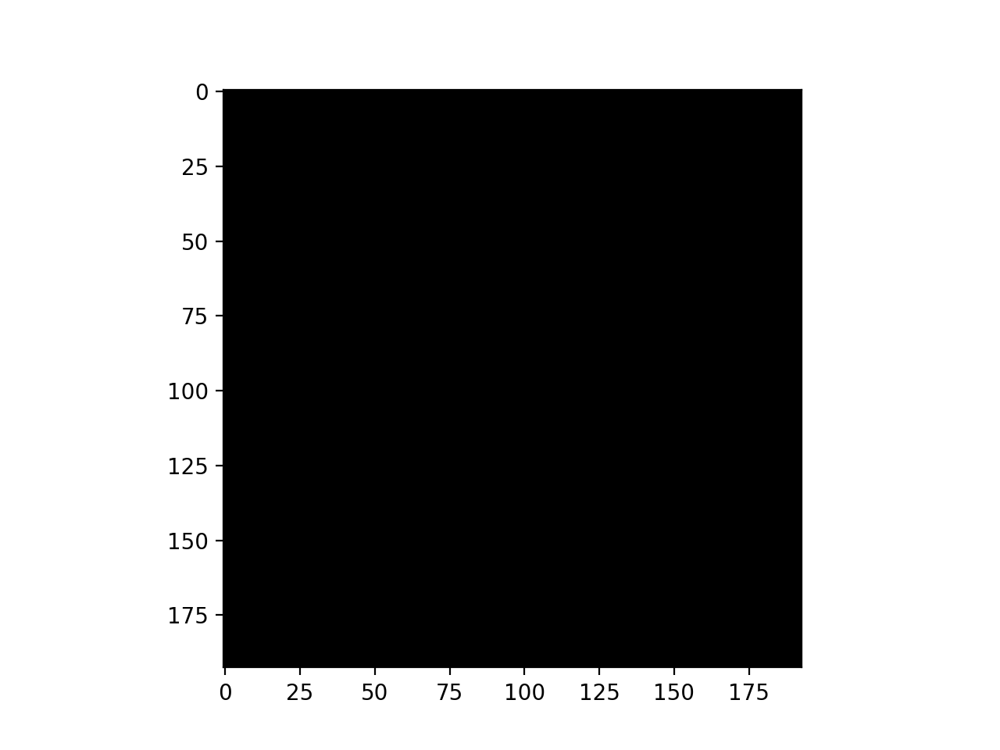

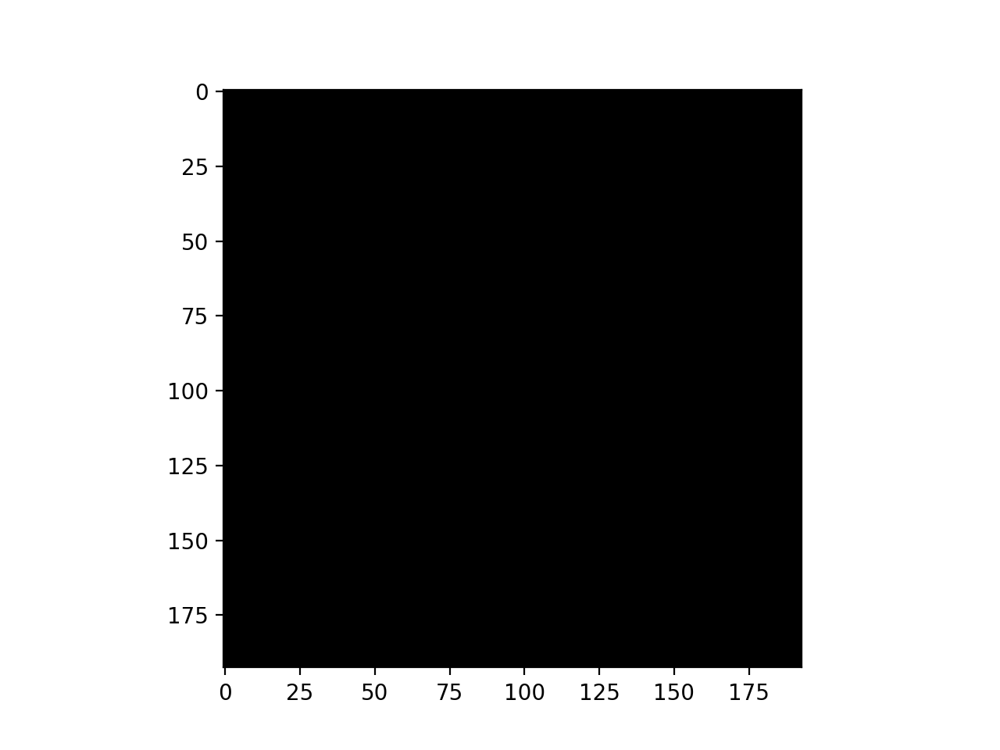

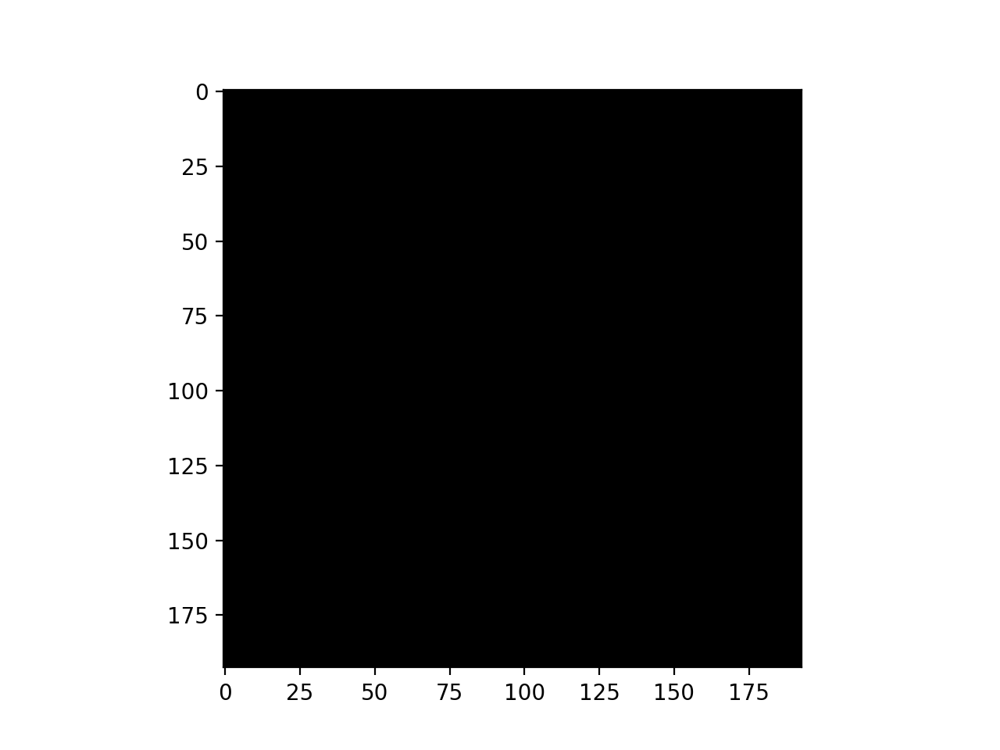

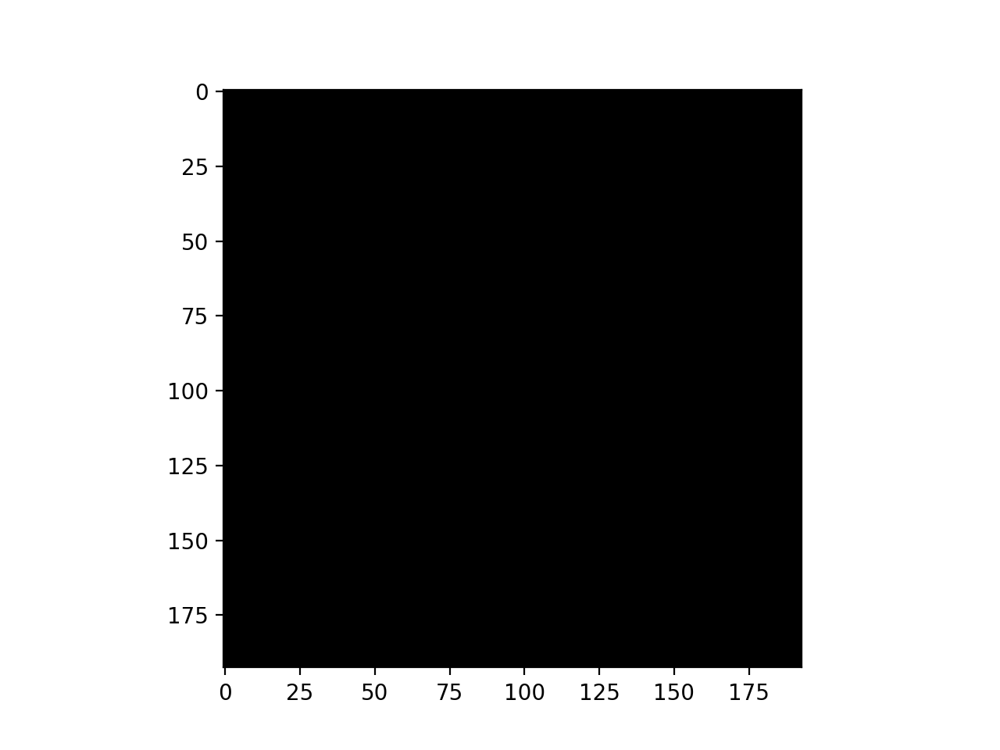

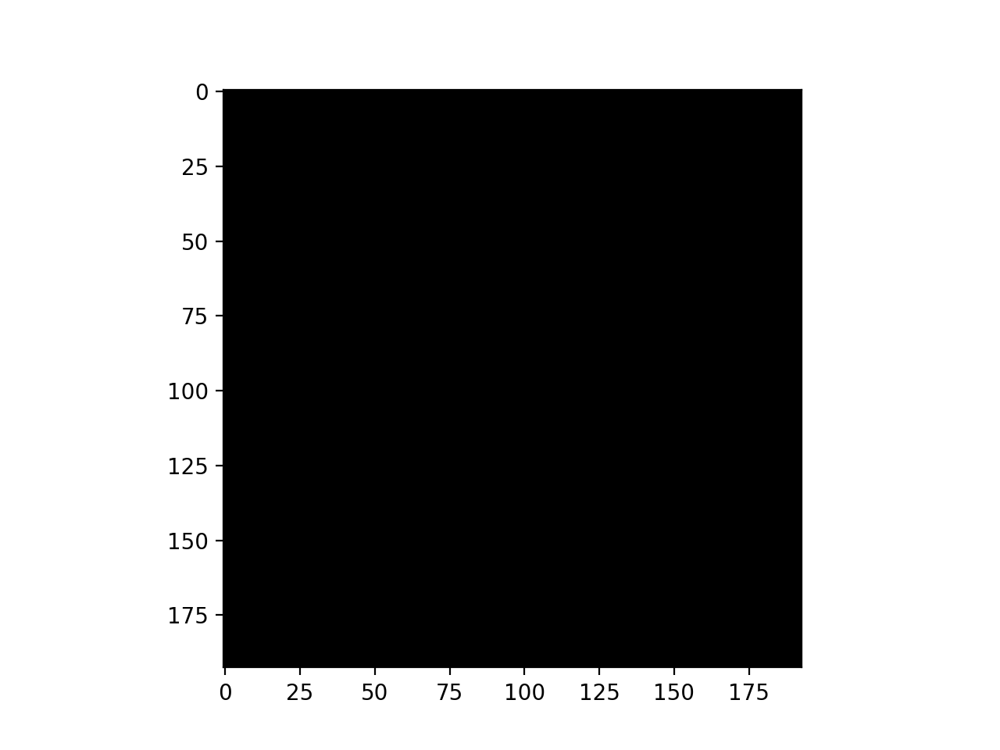

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-13 00:26:16.156404: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:26:16.157131: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 00:26:16.157255: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-13 00:26:28.459187: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-13 00:26:28.792757: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/conv3d_8/bias/m/Assign' id:1859 op device:{requested: '', assigned: ''} def:{{{node training/Adam/conv3d_8/bias/m/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](t

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.9584 - accuracy: 0.5590 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-13 00:41:11.695857: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 1010s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.9584 - accuracy: 0.5590 - val_loss: 0.6718 - val_accuracy: 0.6036
Epoch 2/50
70/70 [==============================] - 966s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.7526 - accuracy: 0.6279 - val_loss: 0.6254 - val_accuracy: 0.7357
Epoch 3/50
70/70 [==============================] - 895s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6833 - accuracy: 0.6847 - val_loss: 0.7178 - val_accuracy: 0.4464
Epoch 4/50
70/70 [==============================] - 909s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6313 - accuracy: 0.7004 - val_loss: 0.5894 - val_accuracy: 0.6750
Epoch 5/50
70/70 [==============================] - 923s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6291 - accuracy: 0.7294 - val_loss: 0.7086 - val_accuracy: 0.6536
Epoch 6/50
70/70 [==============================] - 917s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6236 - accuracy: 0.7209 - 

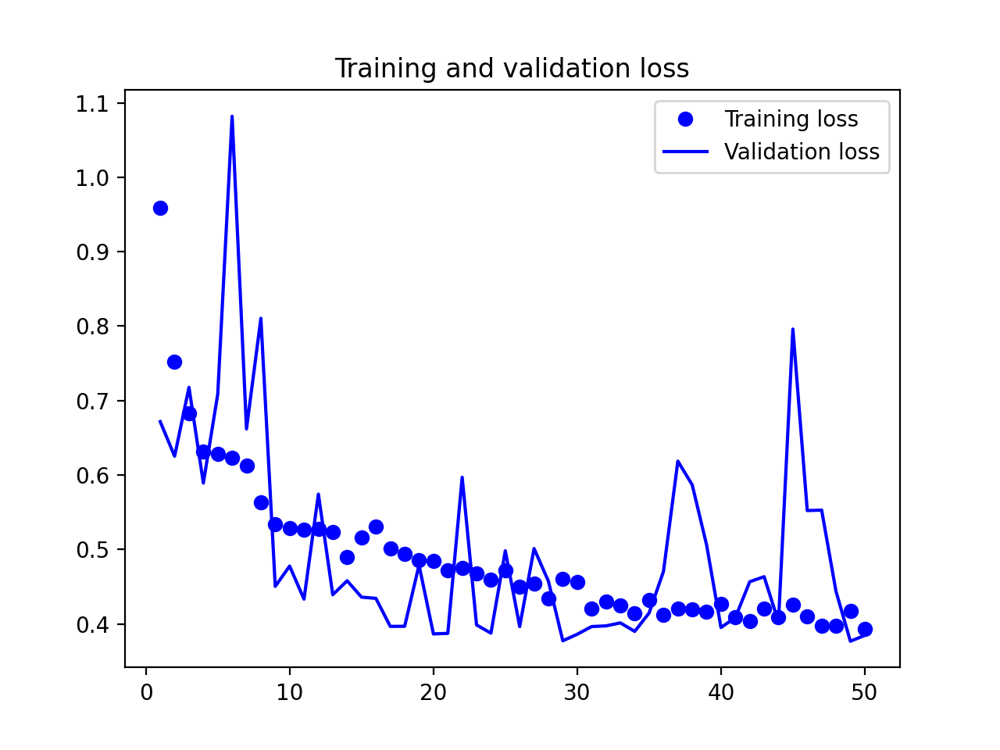

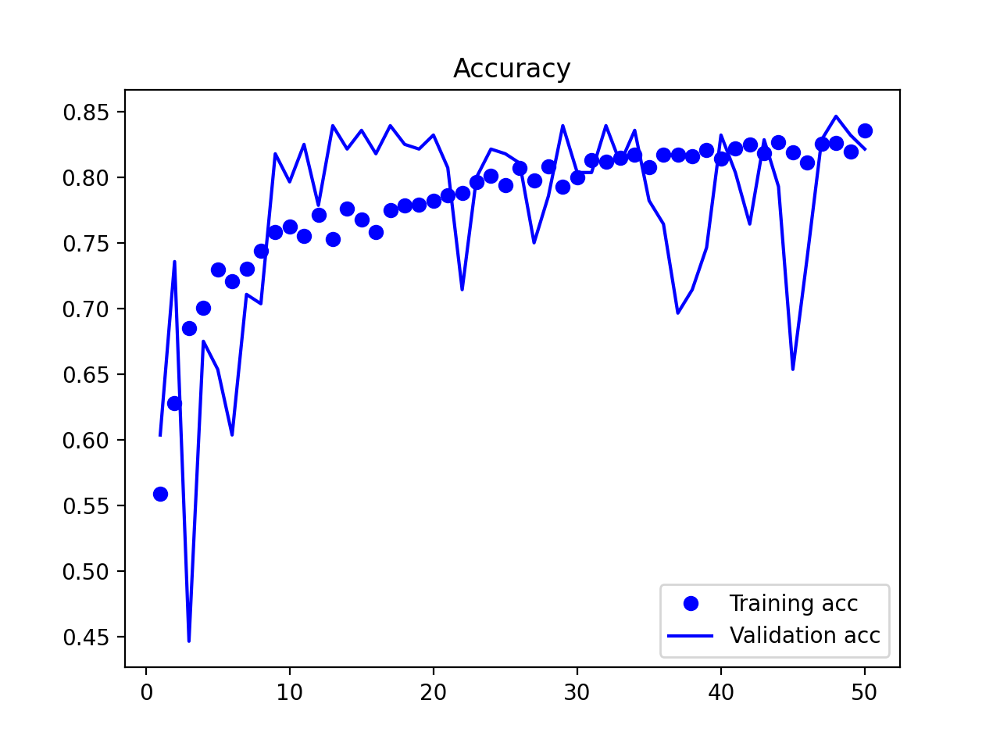

2024-06-13 13:00:04.514226: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:00:04.520313: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:00:04.520531: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.926
Acc for AD vs. CN = 89.9


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

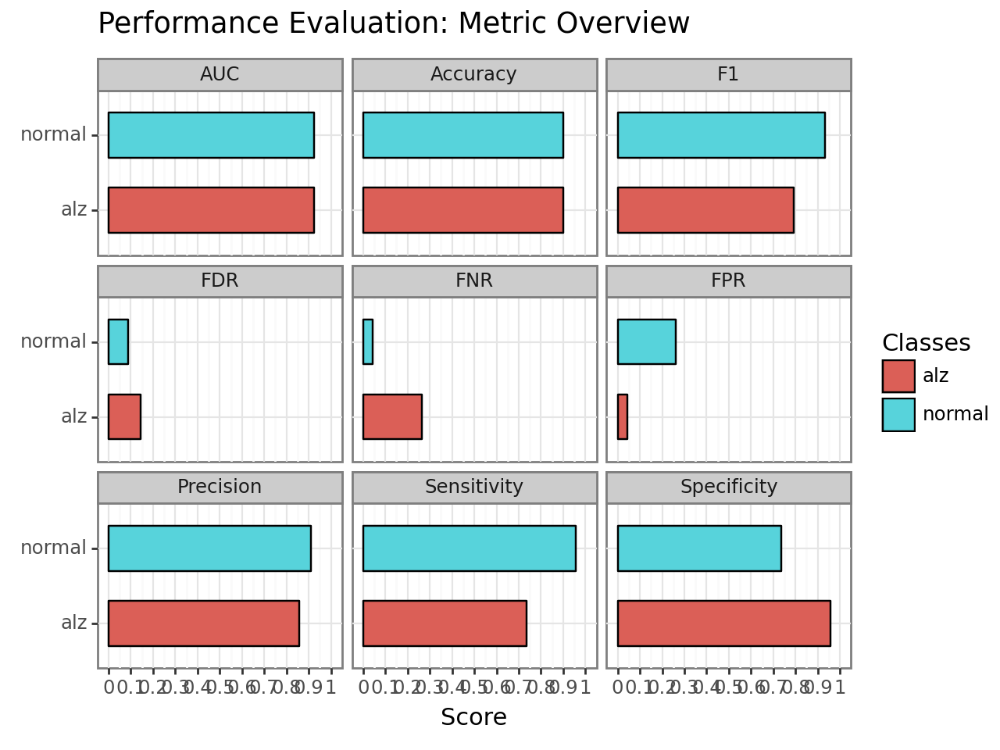

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv09/plot.performance.confusion_matrix.png


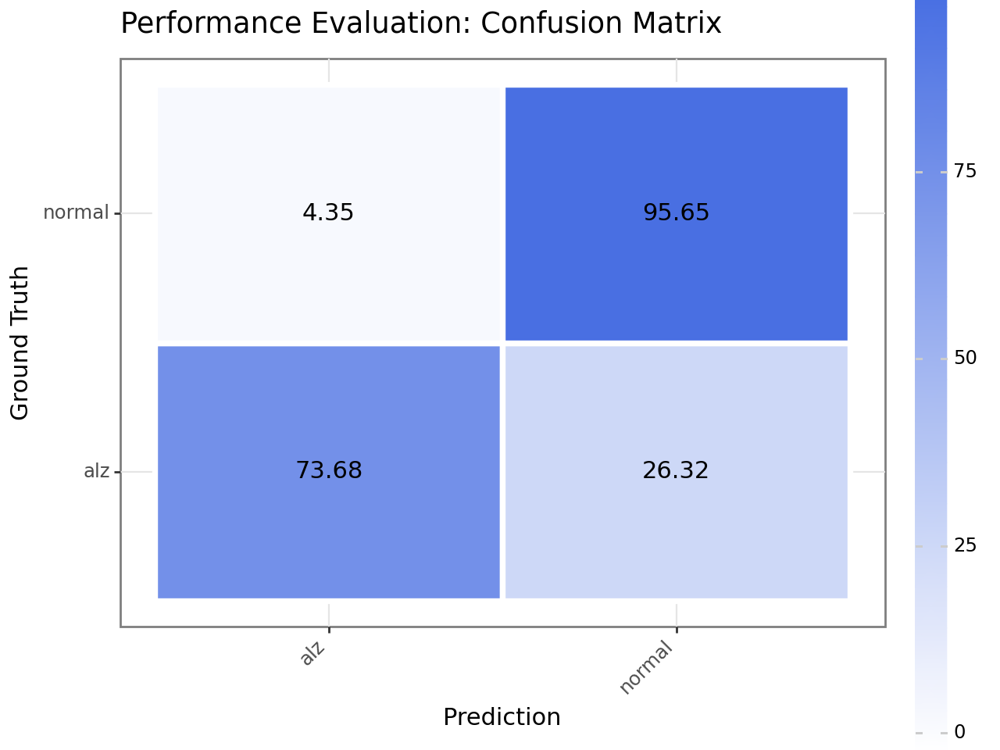

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv09/plot.performance.roc.png


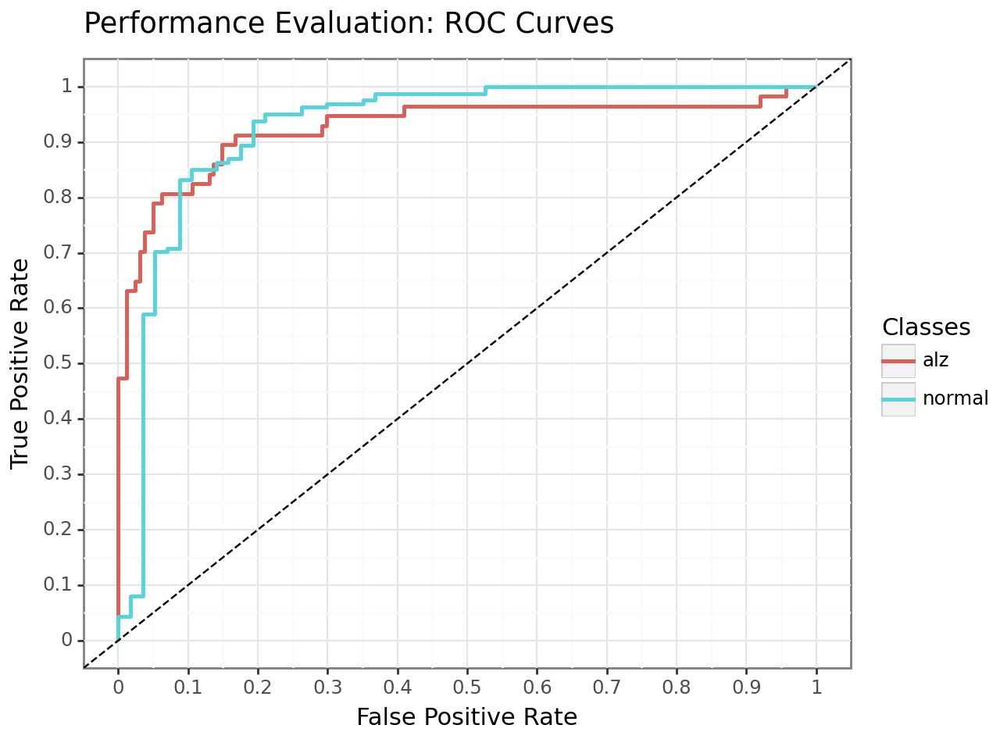


AUC for MCI vs. CN = 0.801
Acc for MCI vs. CN = 80.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

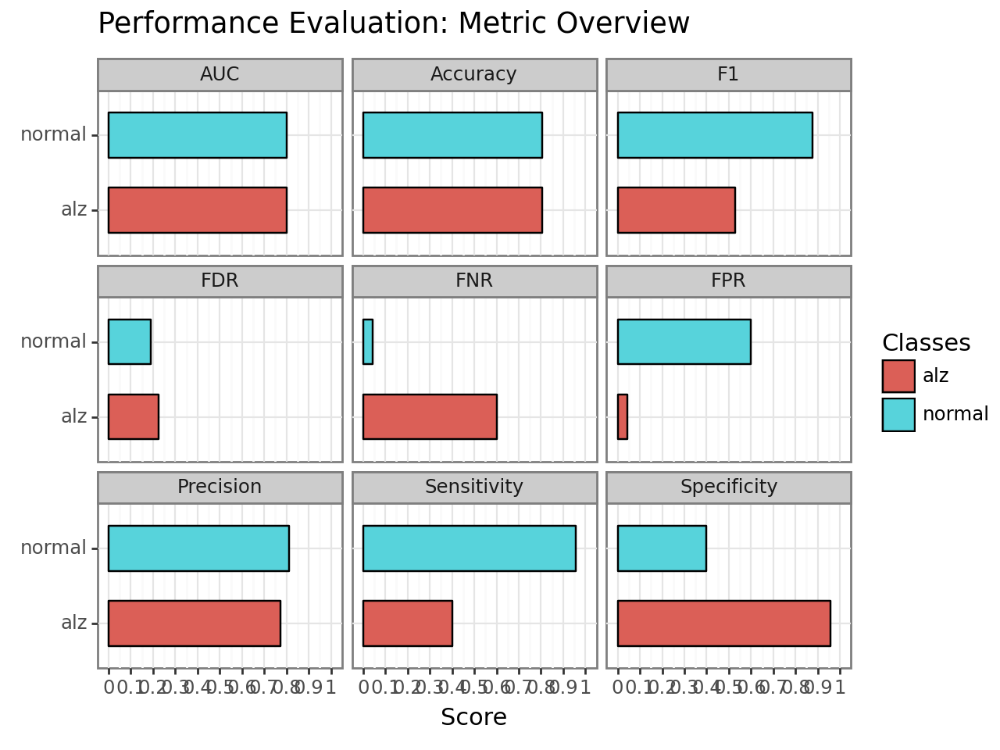

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv09/plot.performance.confusion_matrix.png


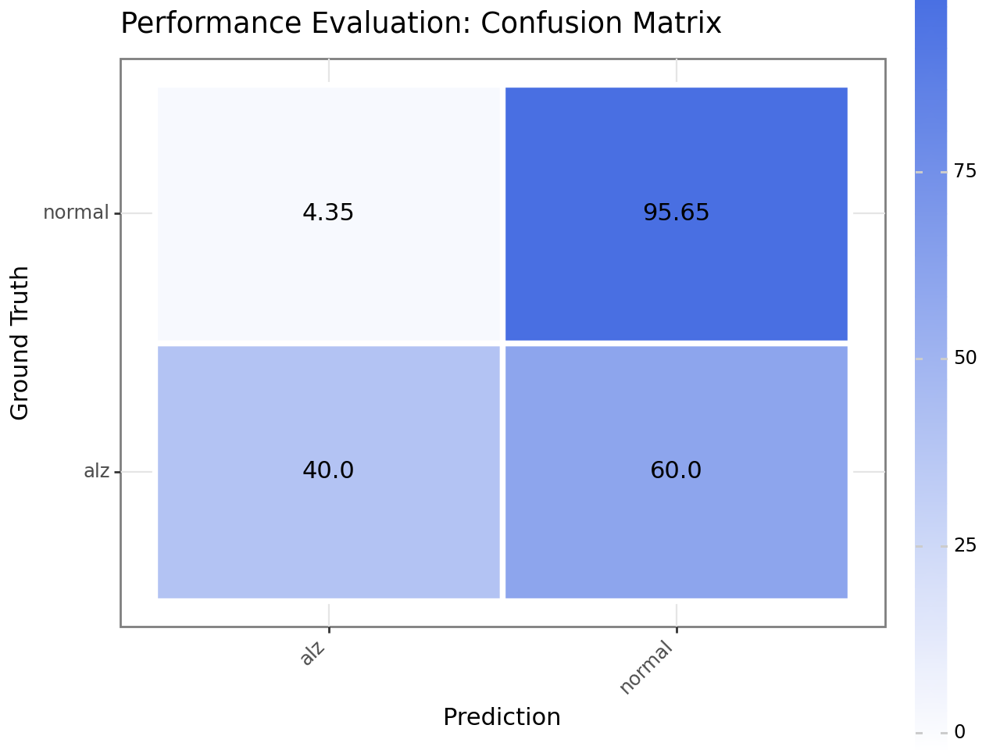

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv09/plot.performance.roc.png


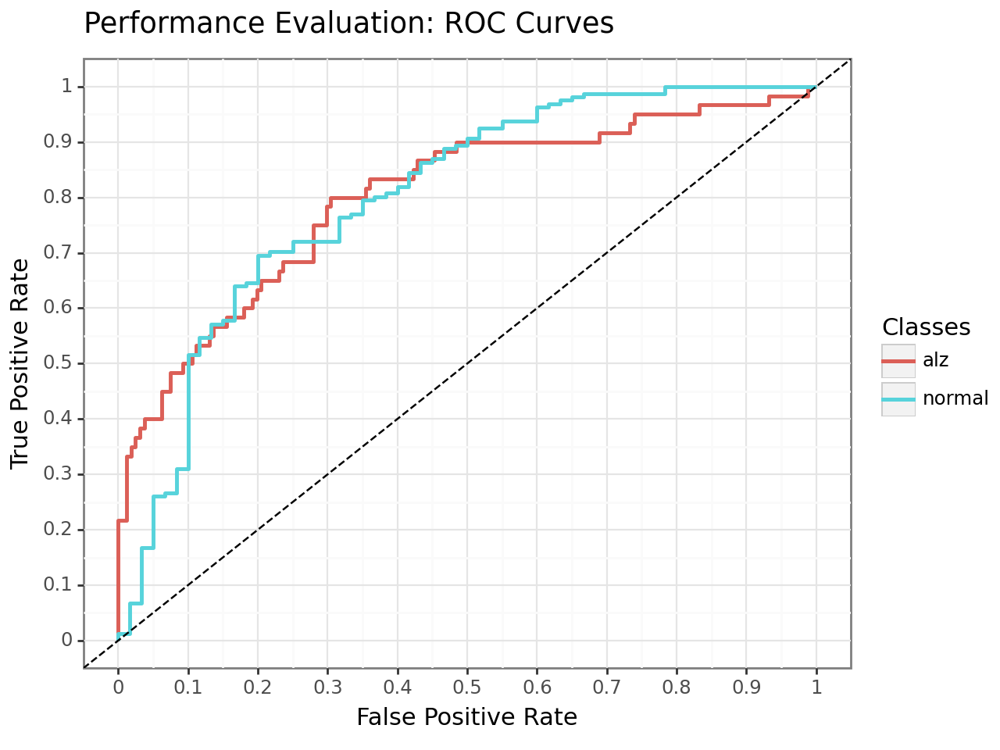

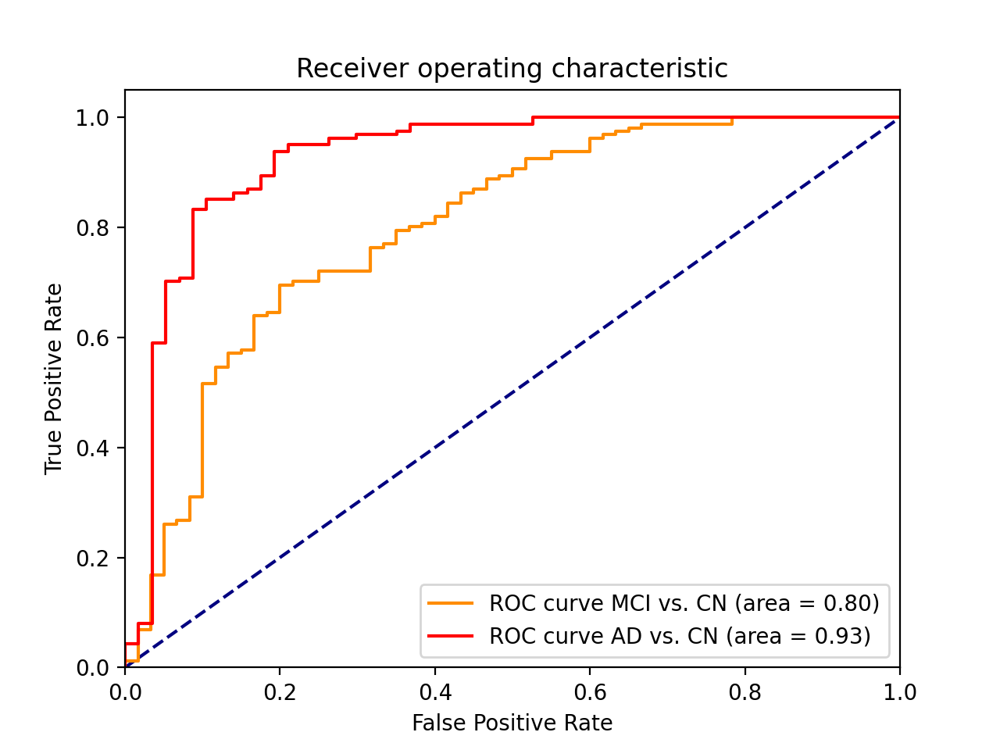

2024-06-13 13:01:34.169886: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:01:34.170302: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:01:34.170461: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

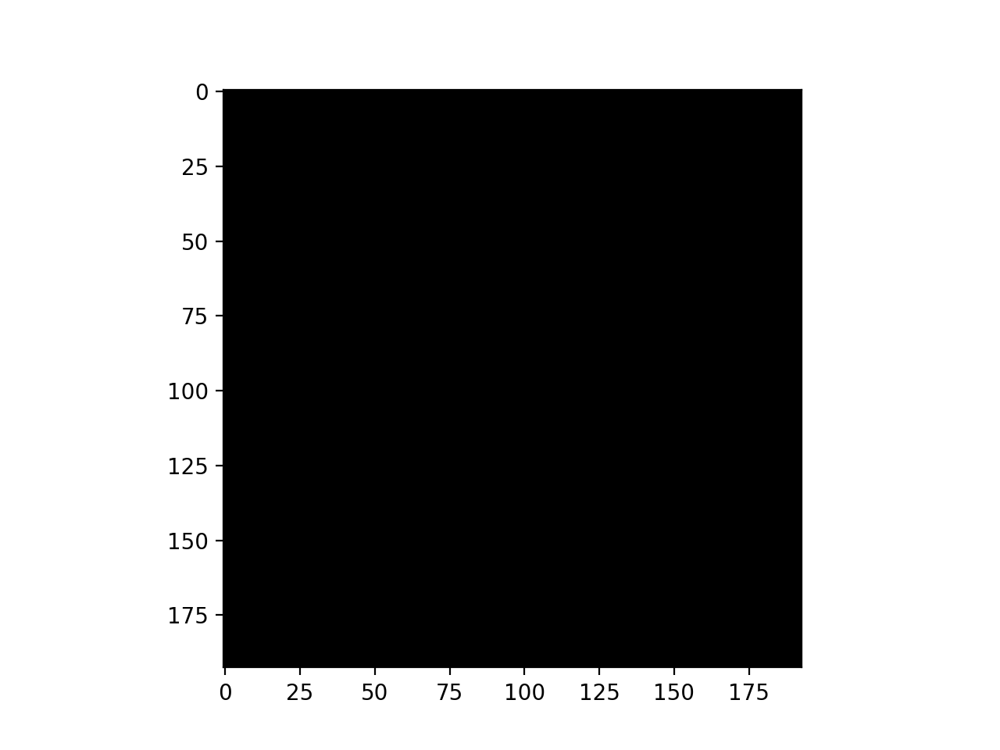

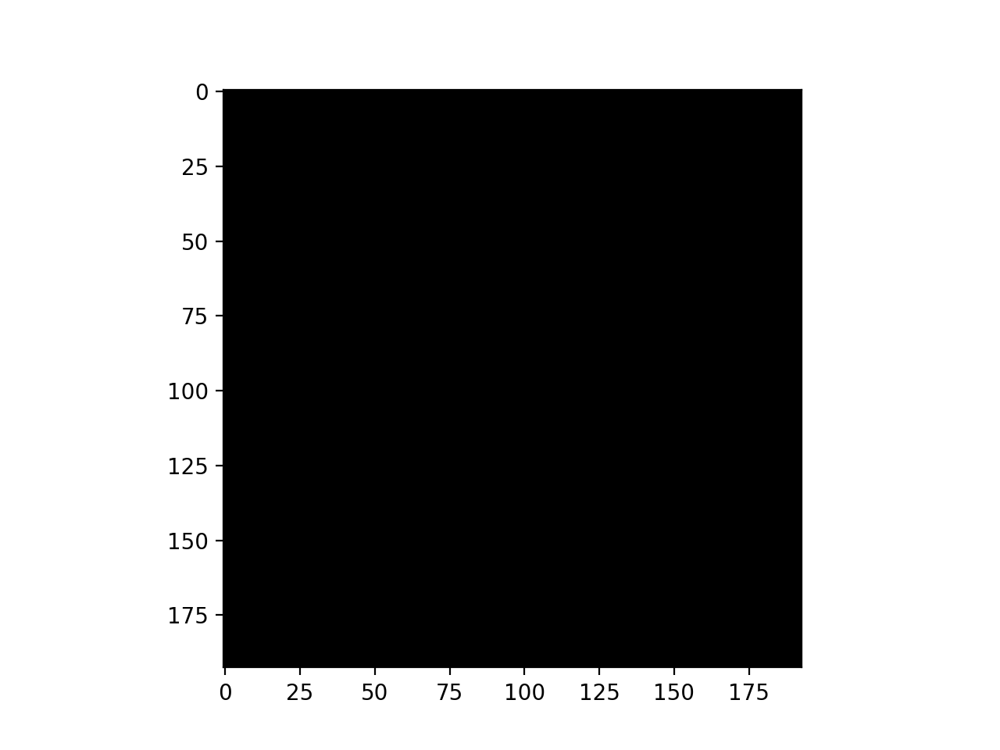

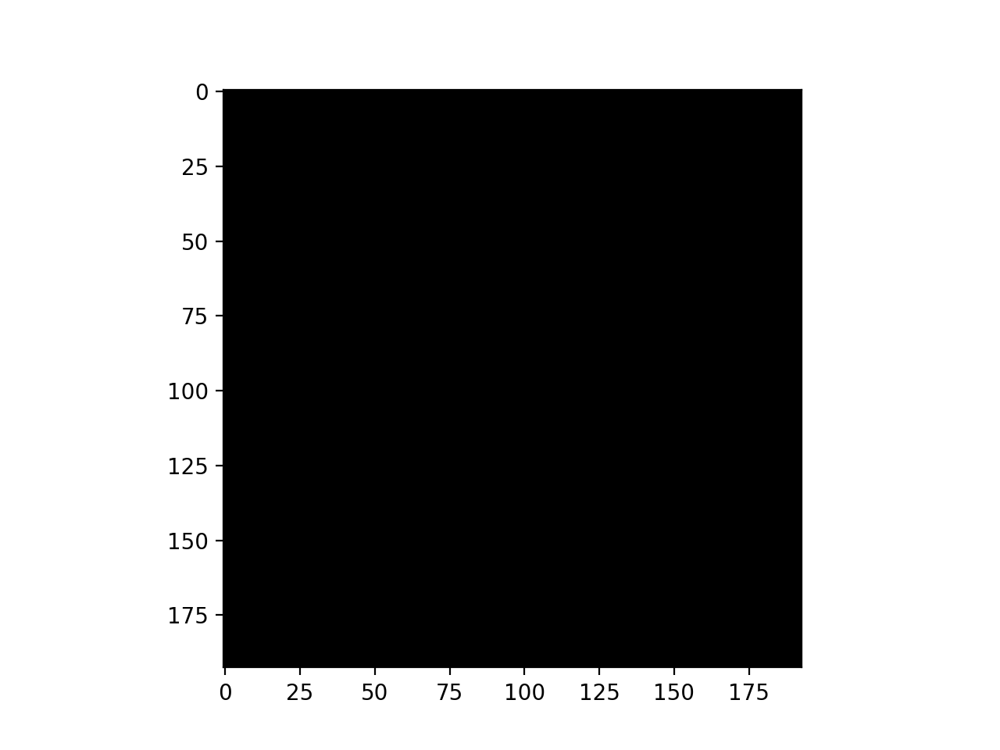

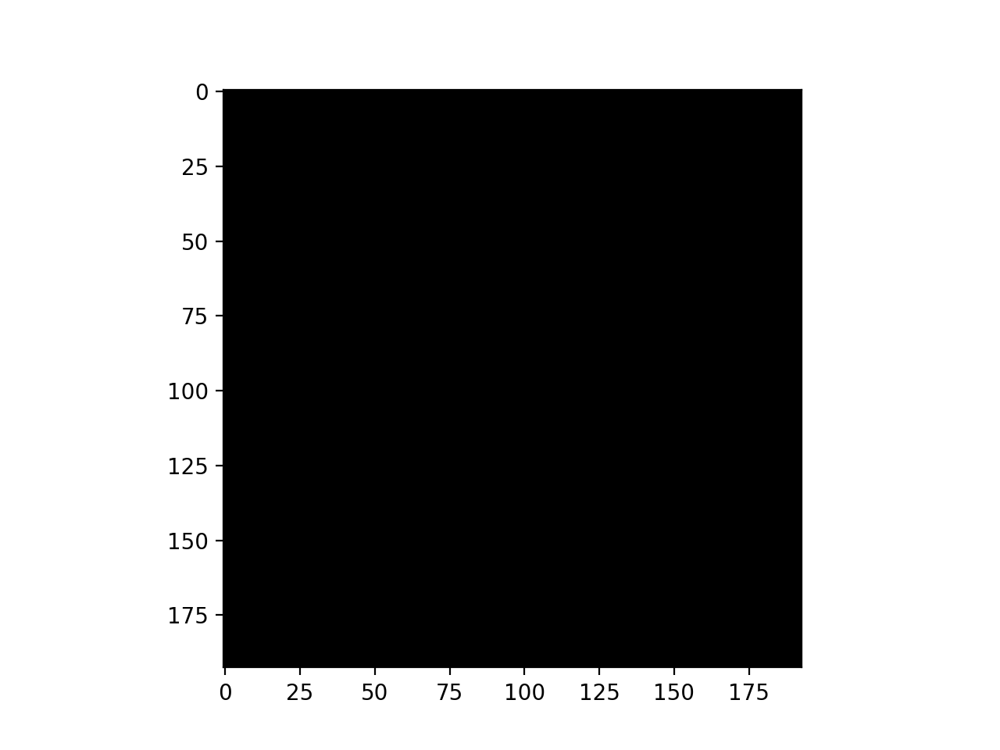

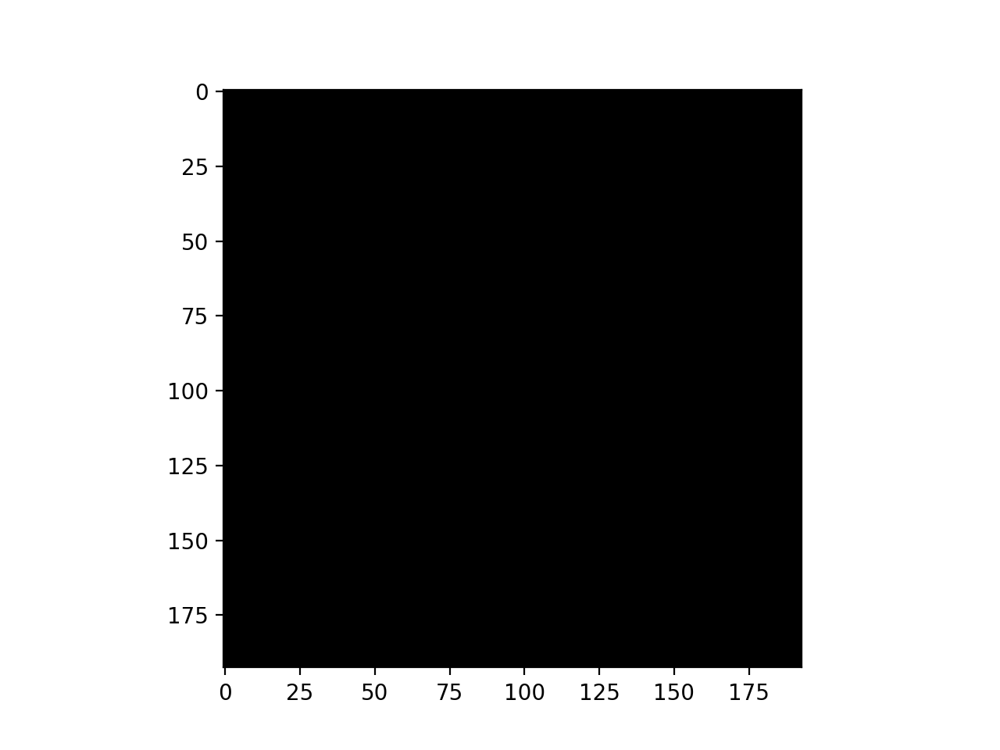

...

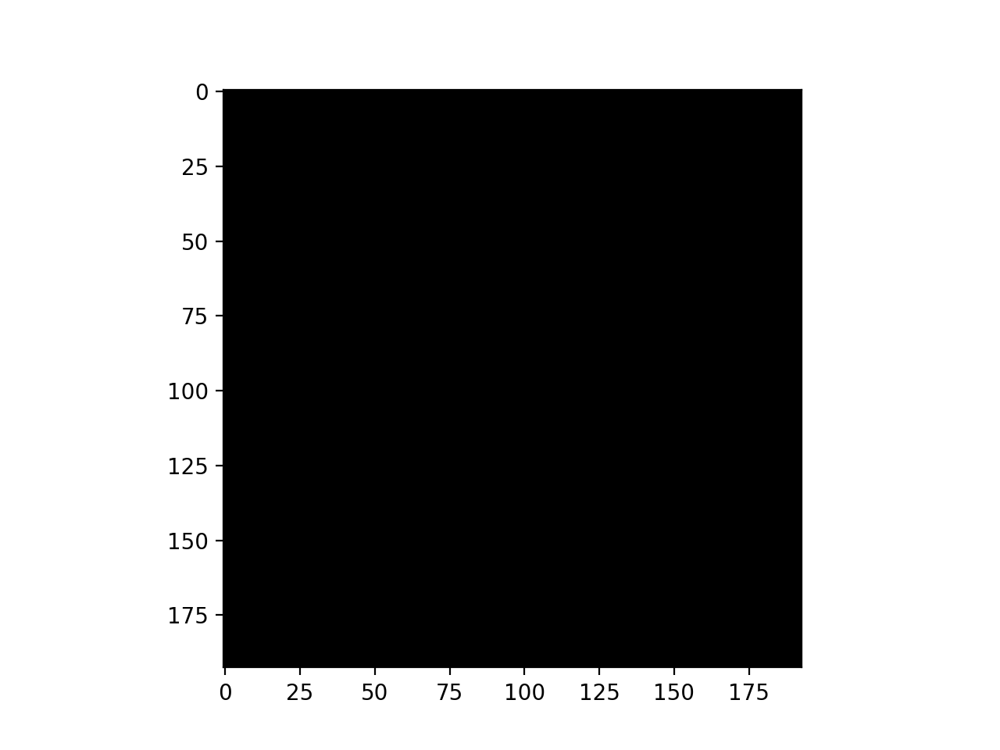

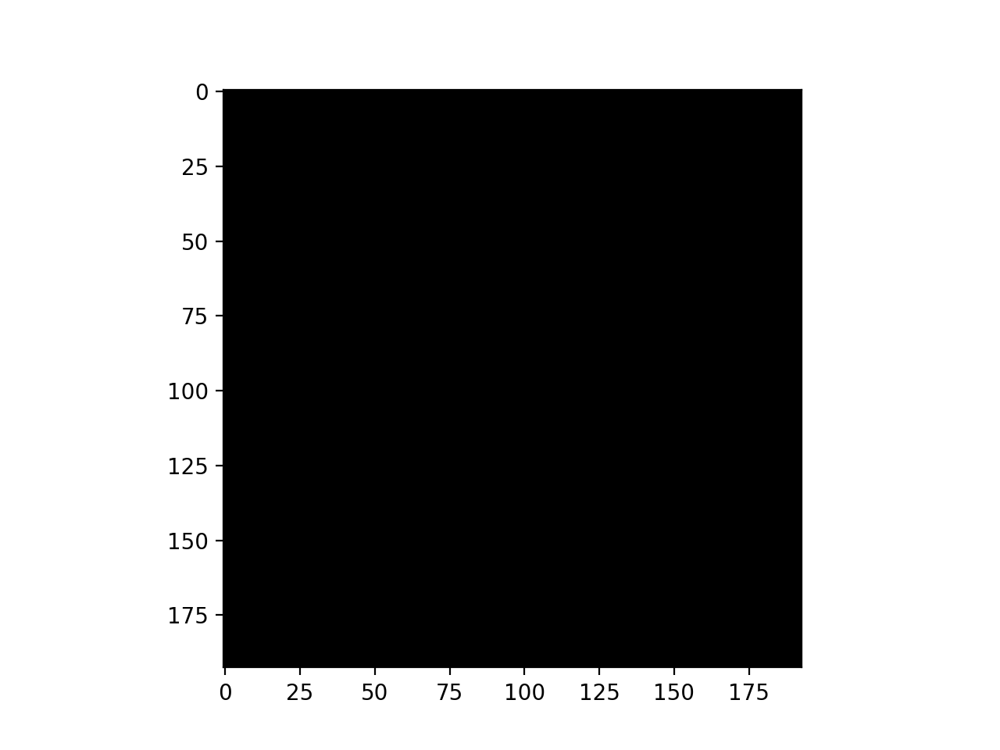

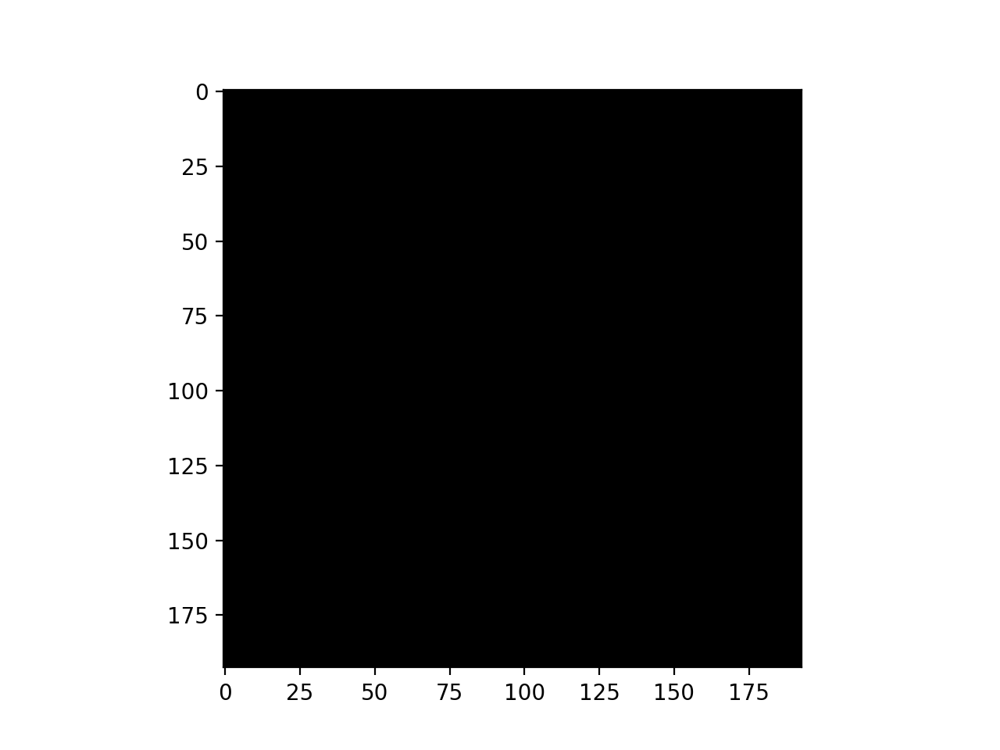

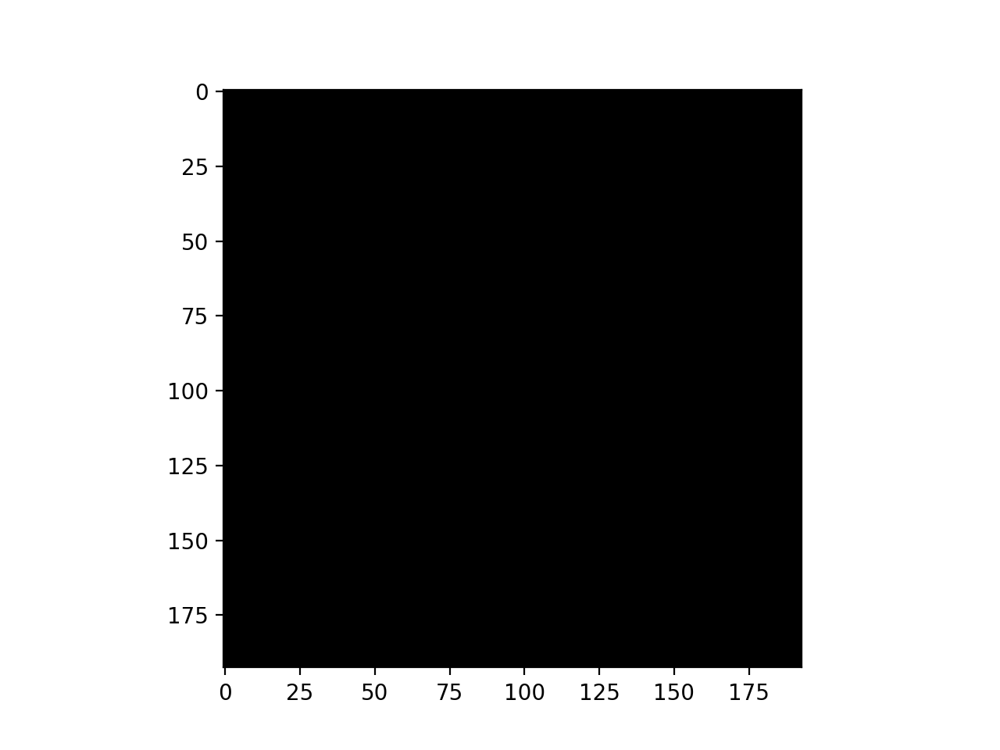

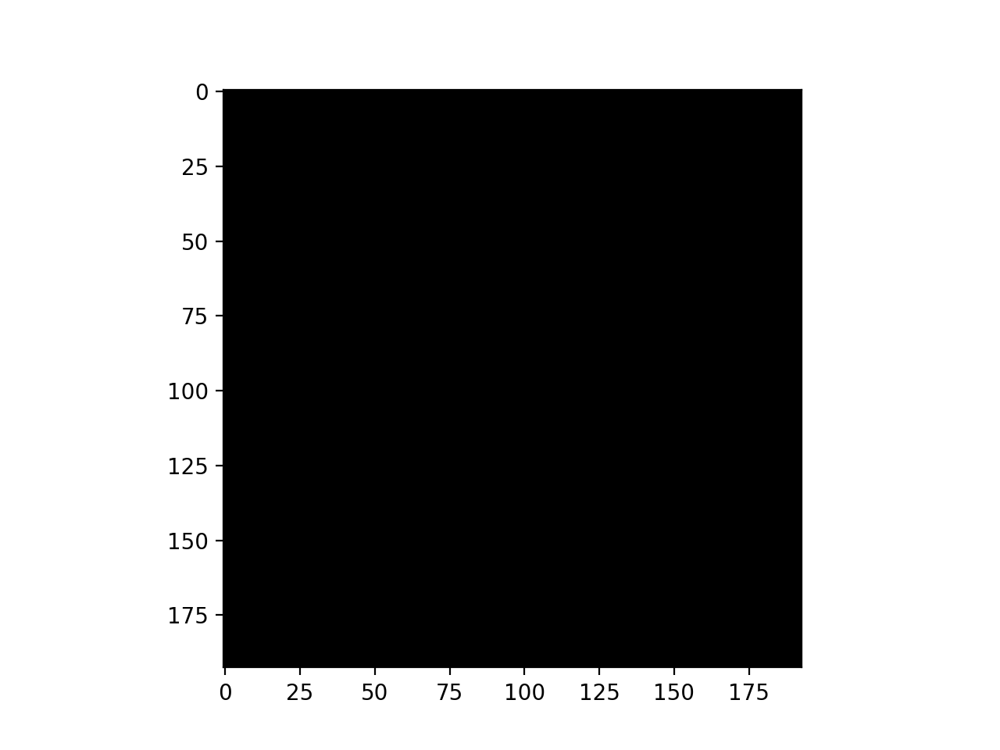

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-13 13:04:19.454713: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:04:19.454976: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-13 13:04:19.455091: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

Epoch 1/50


2024-06-13 13:04:33.461534: W tensorflow/c/c_api.cc:305] Operation '{name:'batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp' id:937 op device:{requested: '', assigned: ''} def:{{{node batch_normalization_12/AssignMovingAvg_1/AssignSubVariableOp}} = AssignSubVariableOp[_class=["loc:@batch_normalization_12/moving_variance"], _has_manual_control_dependencies=true, dtype=DT_FLOAT](batch_normalization_12/moving_variance, batch_normalization_12/AssignMovingAvg_1/mul)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
2024-06-13 13:04:33.770985: W tensorflow/c/c_api.cc:305] Operation '{name:'training/Adam/conv3d_4/kernel/v/Assign' id:2068 op device:{requested: '', assigned: ''} def:{{{node training/Adam/conv3d_4/kernel/v/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=fals

70/70 [==============================] - ETA: 0s - batch: 34.5000 - size: 31.9429 - loss: 0.8652 - accuracy: 0.5926 

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training_v1.py:2335: UserWarning: `Model.state_updates` will be removed in a future version. This property should not be used in TensorFlow 2.0, as `updates` are applied automatically.
2024-06-13 13:18:45.545235: W tensorflow/c/c_api.cc:305] Operation '{name:'loss/AddN' id:1176 op device:{requested: '', assigned: ''} def:{{{node loss/AddN}} = AddN[N=2, T=DT_FLOAT, _has_manual_control_dependencies=true](loss/mul, loss/dense/kernel/Regularizer/add_1)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Kera

70/70 [==============================] - 954s 14s/step - batch: 34.5000 - size: 31.9429 - loss: 0.8652 - accuracy: 0.5926 - val_loss: 0.7325 - val_accuracy: 0.4214
Epoch 2/50
70/70 [==============================] - 868s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6814 - accuracy: 0.6713 - val_loss: 0.9802 - val_accuracy: 0.4214
Epoch 3/50
70/70 [==============================] - 858s 12s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6329 - accuracy: 0.7097 - val_loss: 0.8264 - val_accuracy: 0.4250
Epoch 4/50
70/70 [==============================] - 859s 12s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6746 - accuracy: 0.6910 - val_loss: 0.4985 - val_accuracy: 0.7786
Epoch 5/50
70/70 [==============================] - 853s 12s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6503 - accuracy: 0.7021 - val_loss: 0.7168 - val_accuracy: 0.5607
Epoch 6/50
70/70 [==============================] - 868s 13s/step - batch: 34.5000 - size: 31.9429 - loss: 0.6048 - accuracy: 0.7169 - v

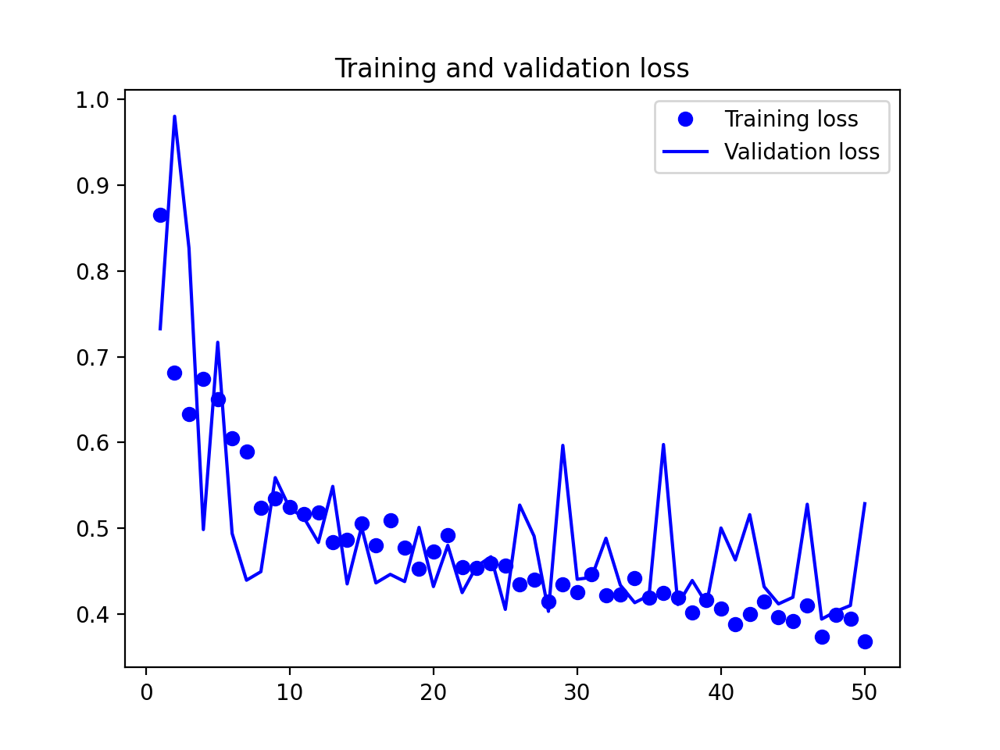

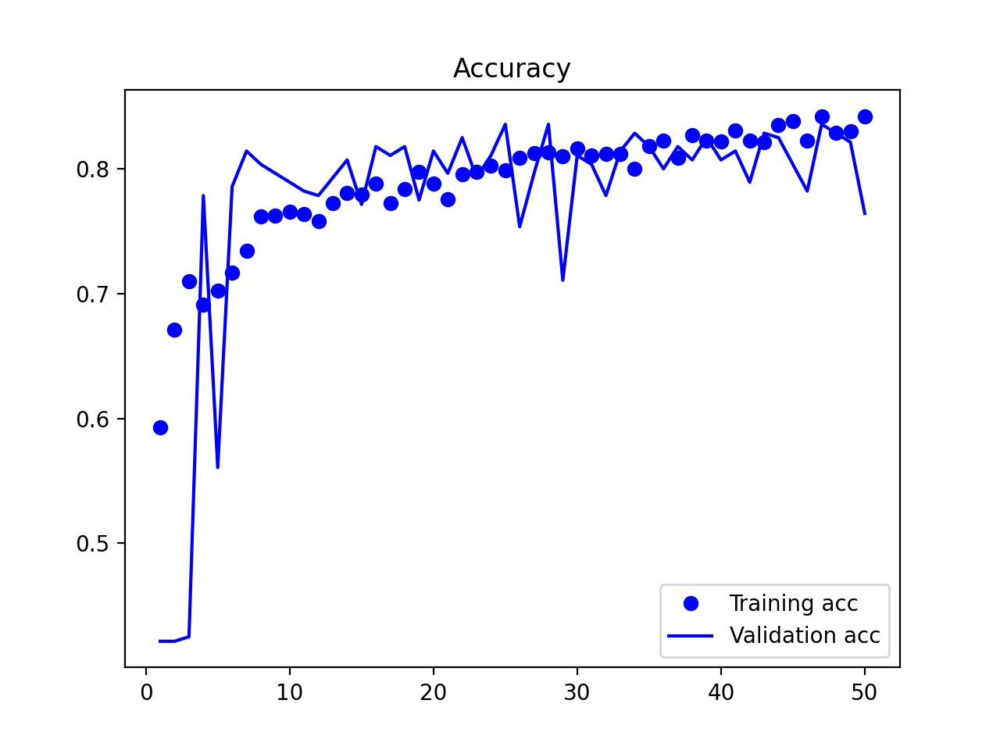

2024-06-14 01:12:23.485864: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 01:12:23.521953: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 01:12:23.522178: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

AUC for AD vs. CN = 0.940
Acc for AD vs. CN = 88.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

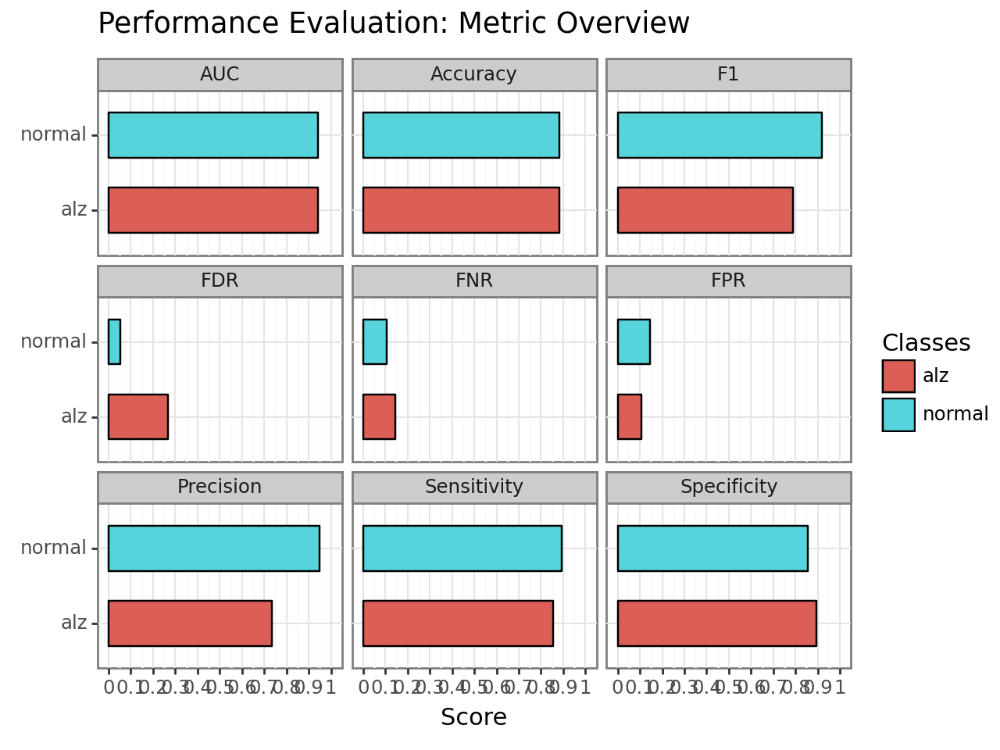

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv10/plot.performance.confusion_matrix.png


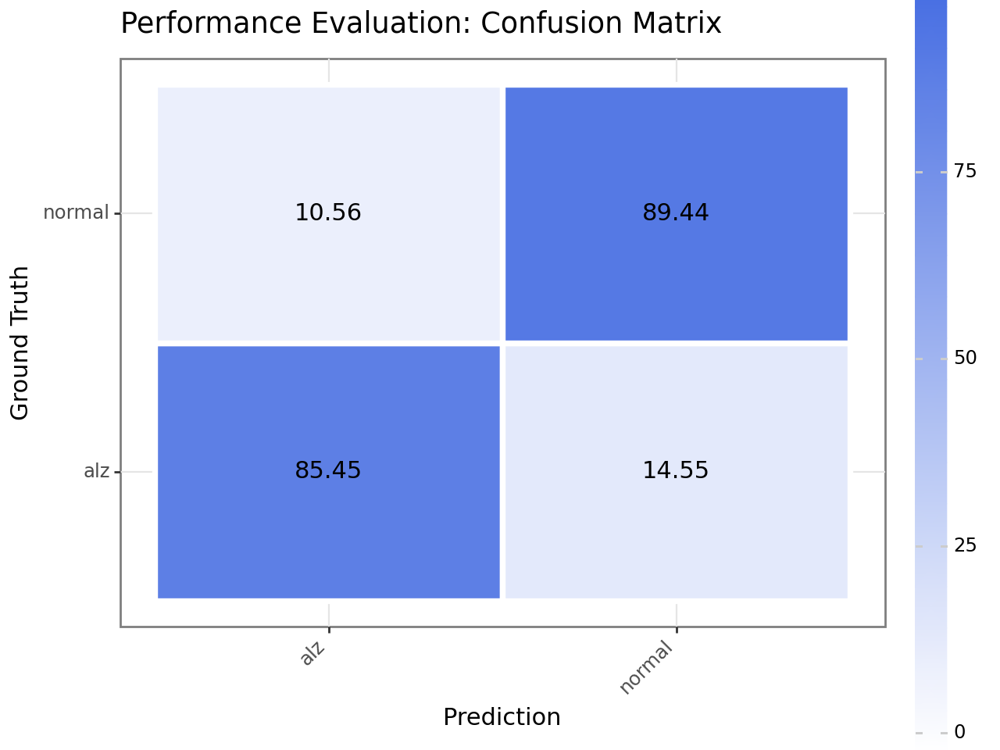

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv10/plot.performance.roc.png


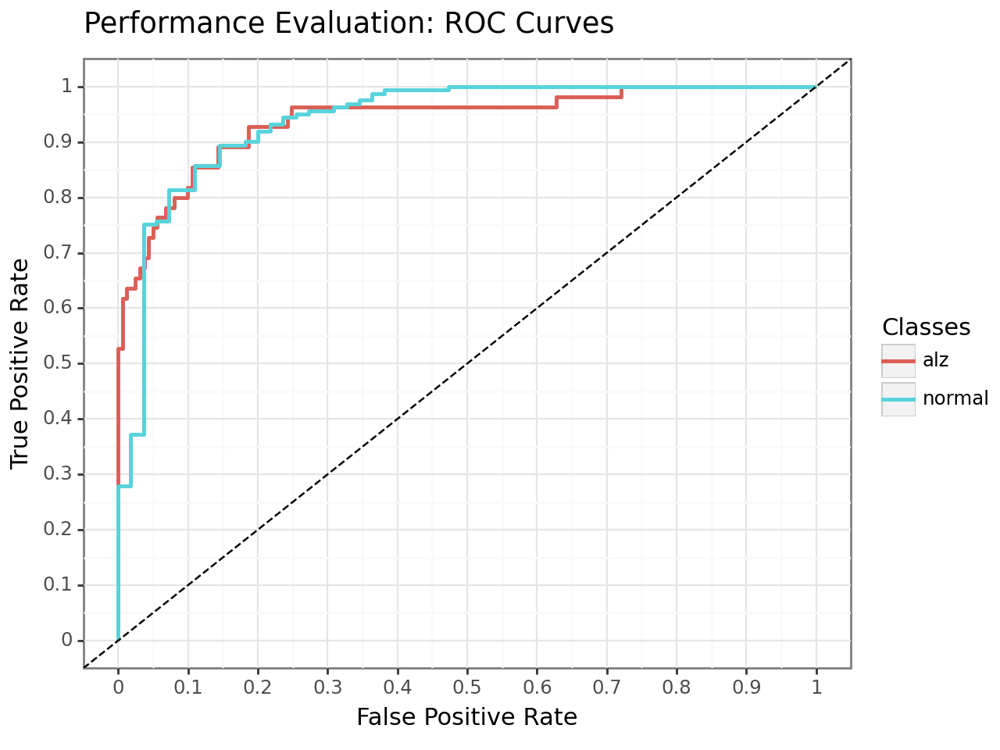


AUC for MCI vs. CN = 0.825
Acc for MCI vs. CN = 79.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

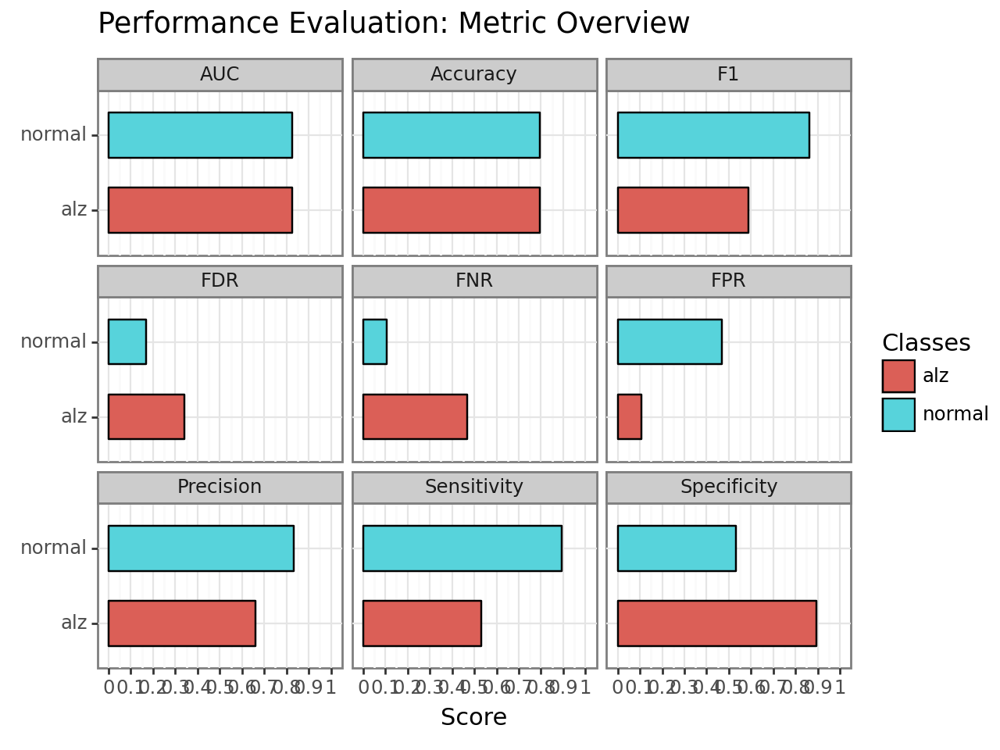

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv10/plot.performance.confusion_matrix.png


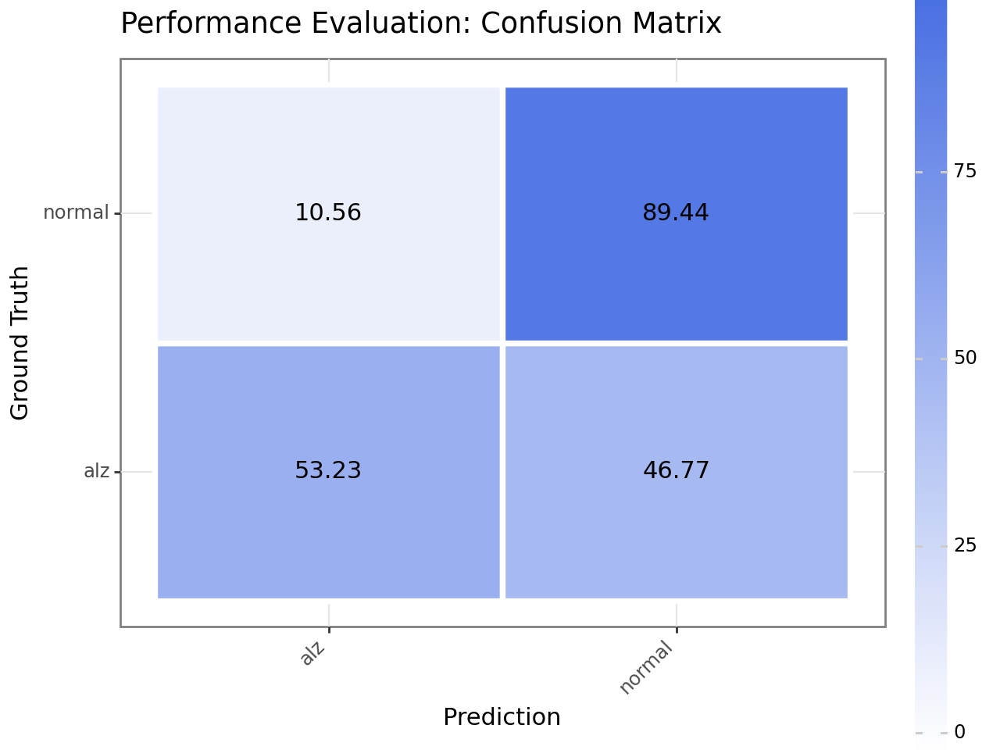

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv10/plot.performance.roc.png


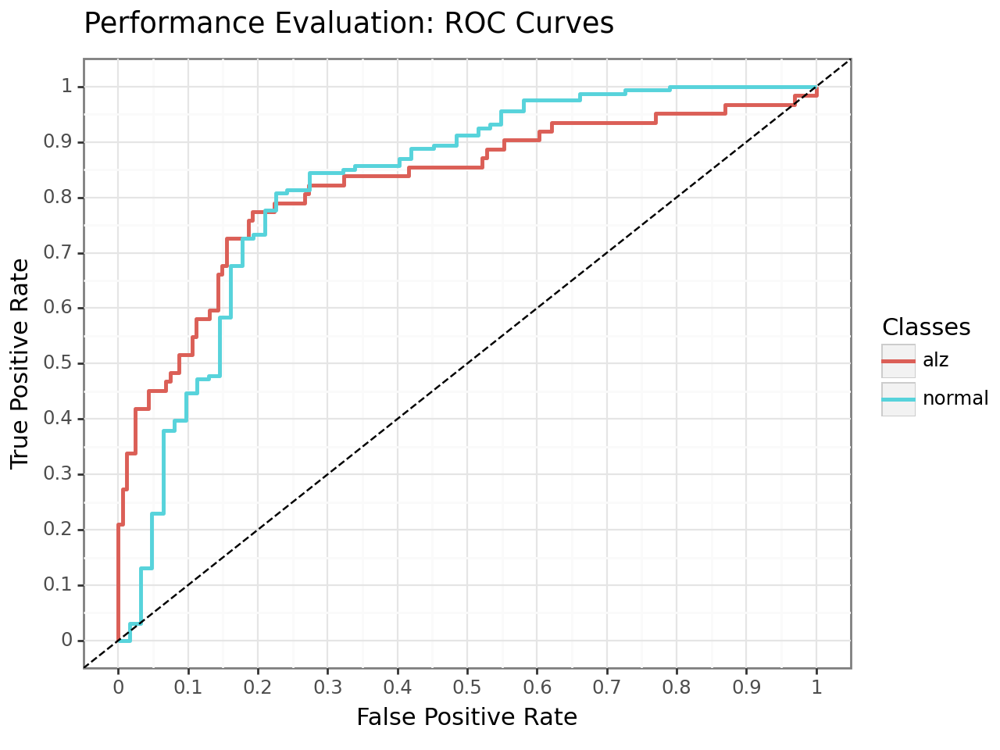

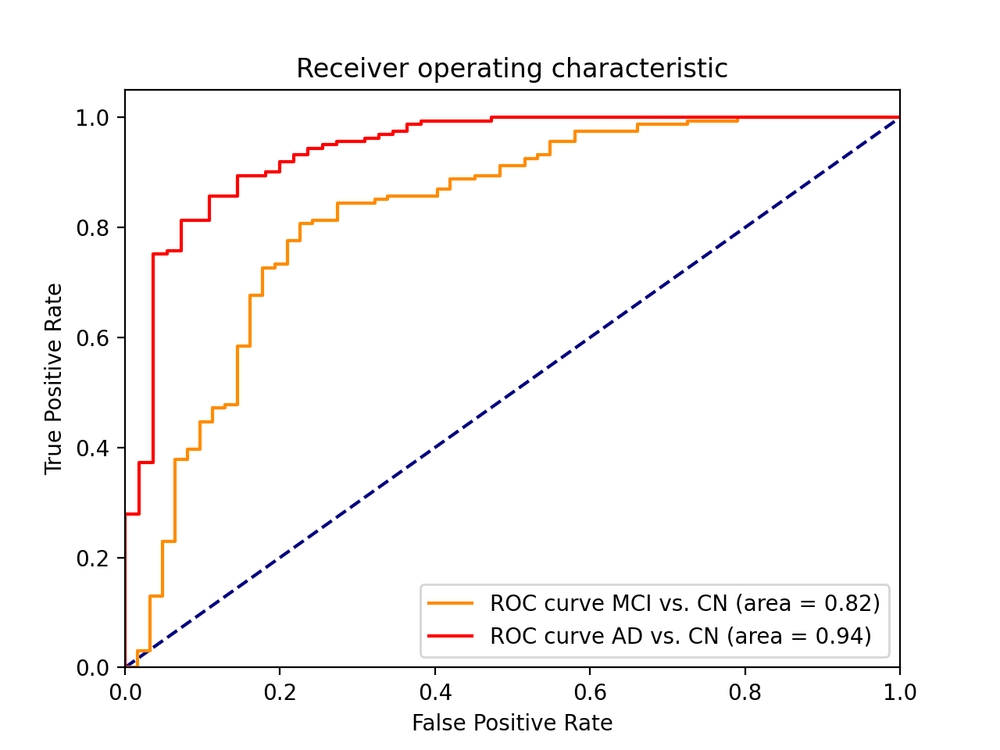

2024-06-14 01:13:53.361045: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 01:13:53.361431: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 01:13:53.361598: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

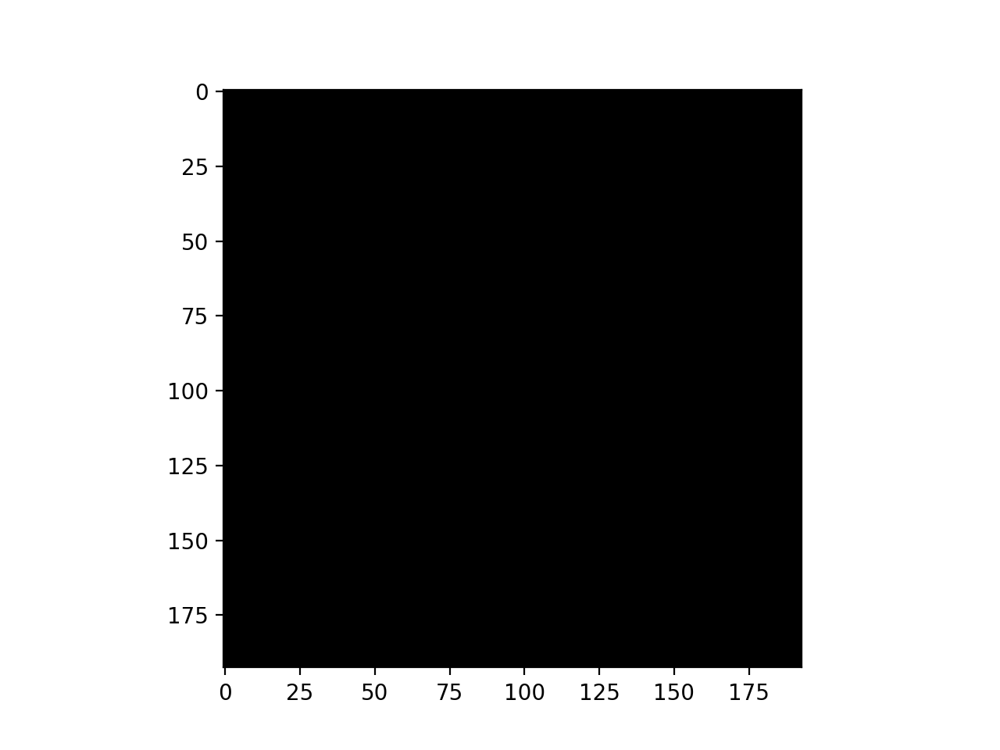

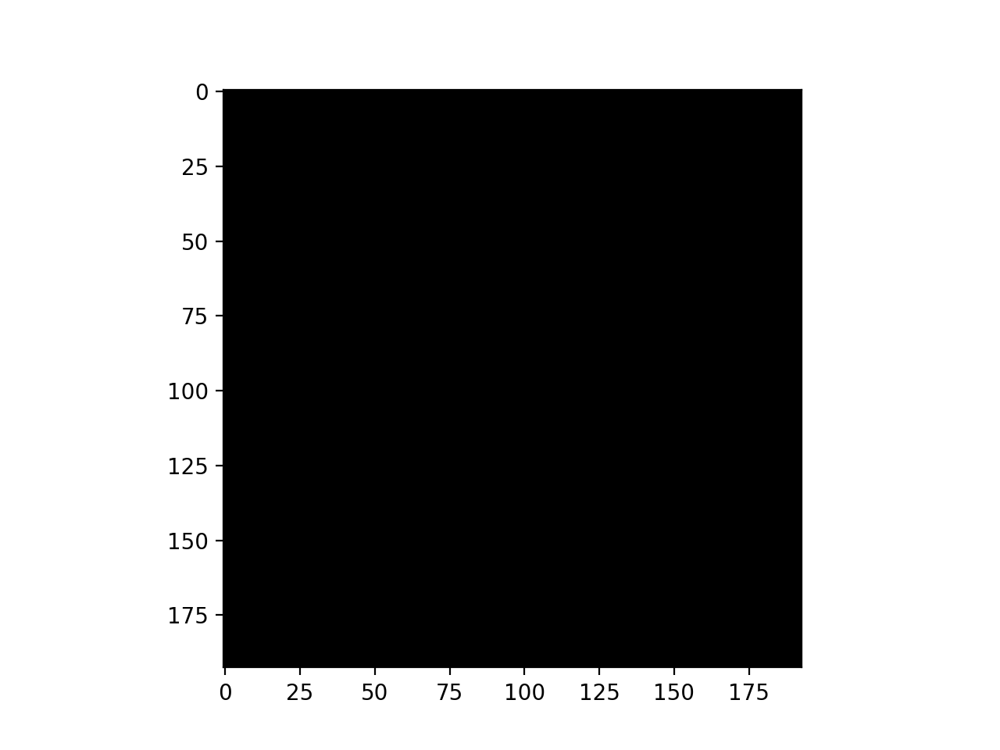

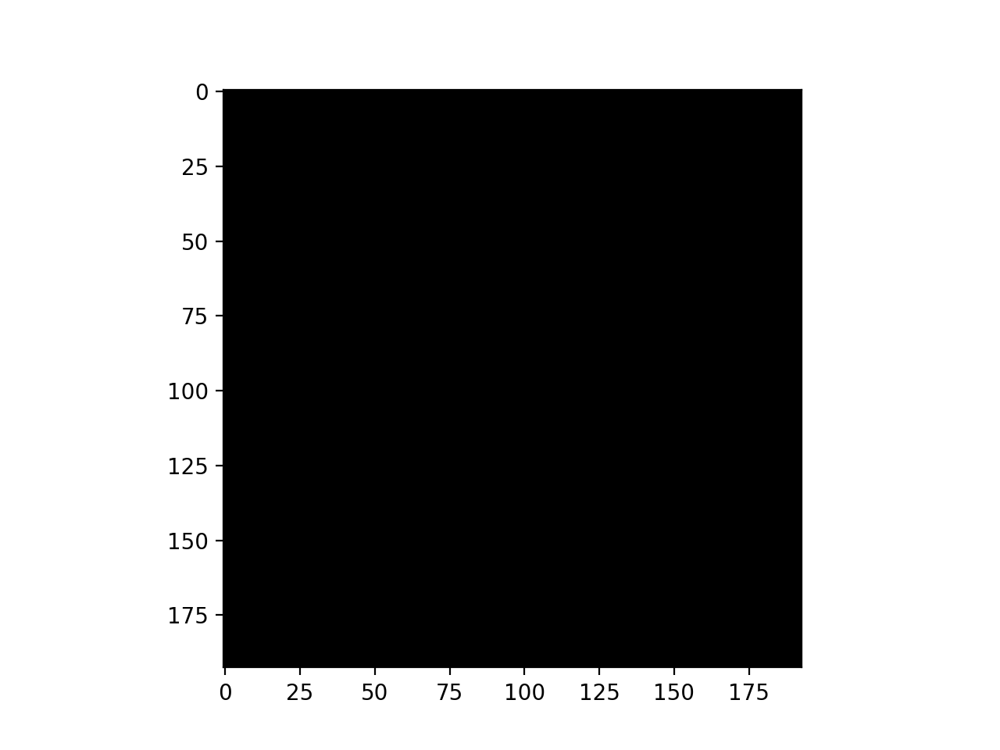

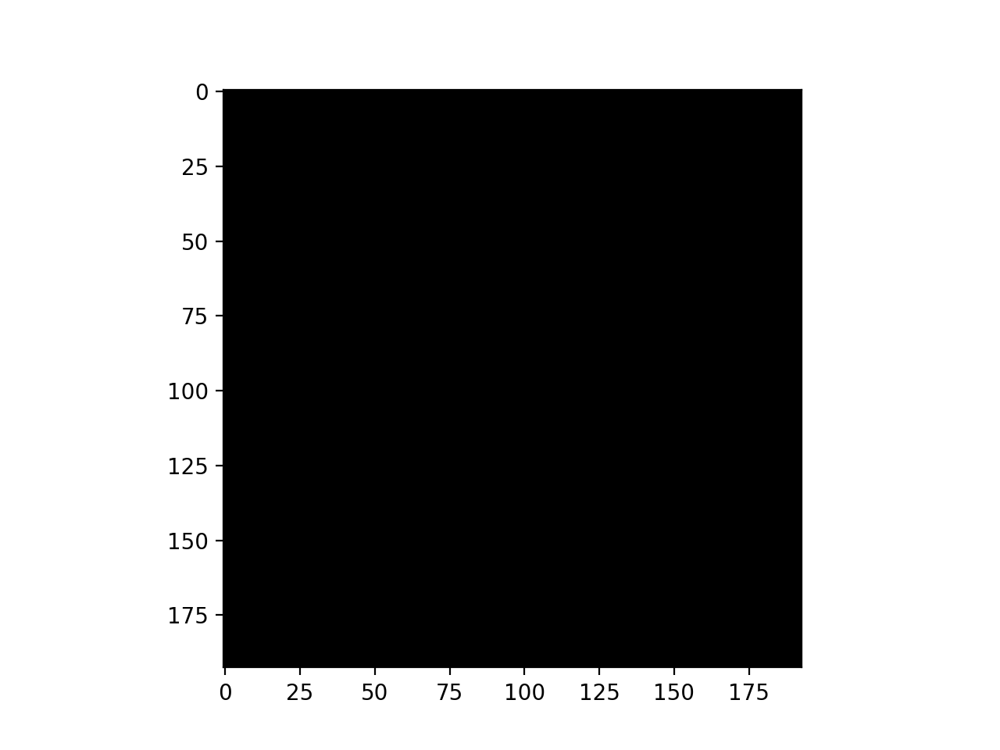

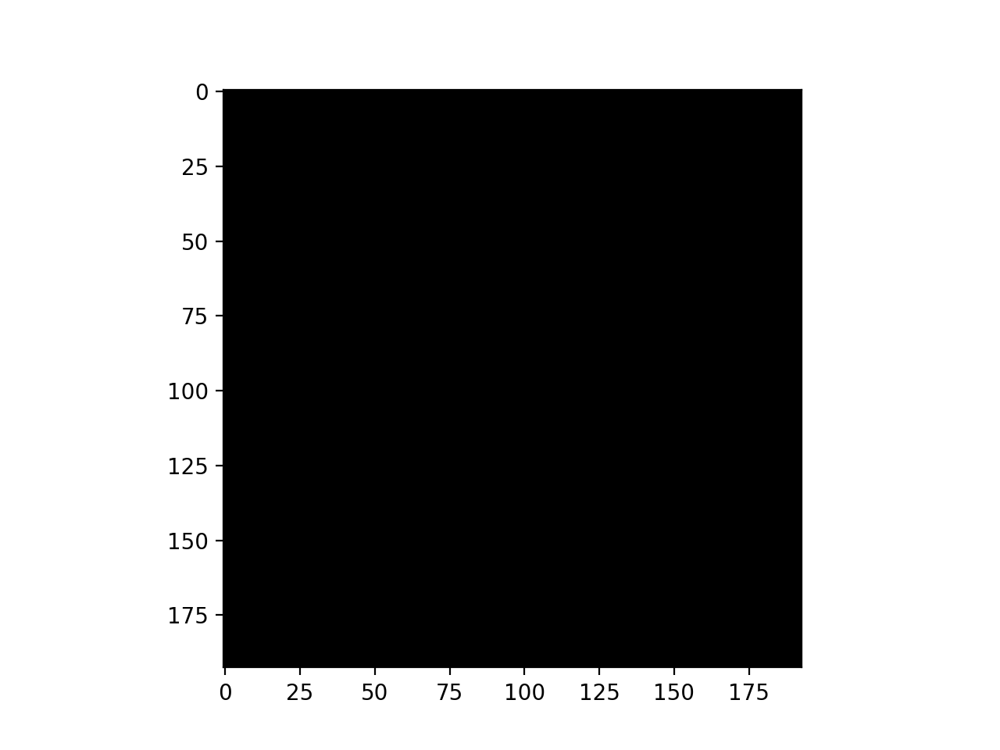

...

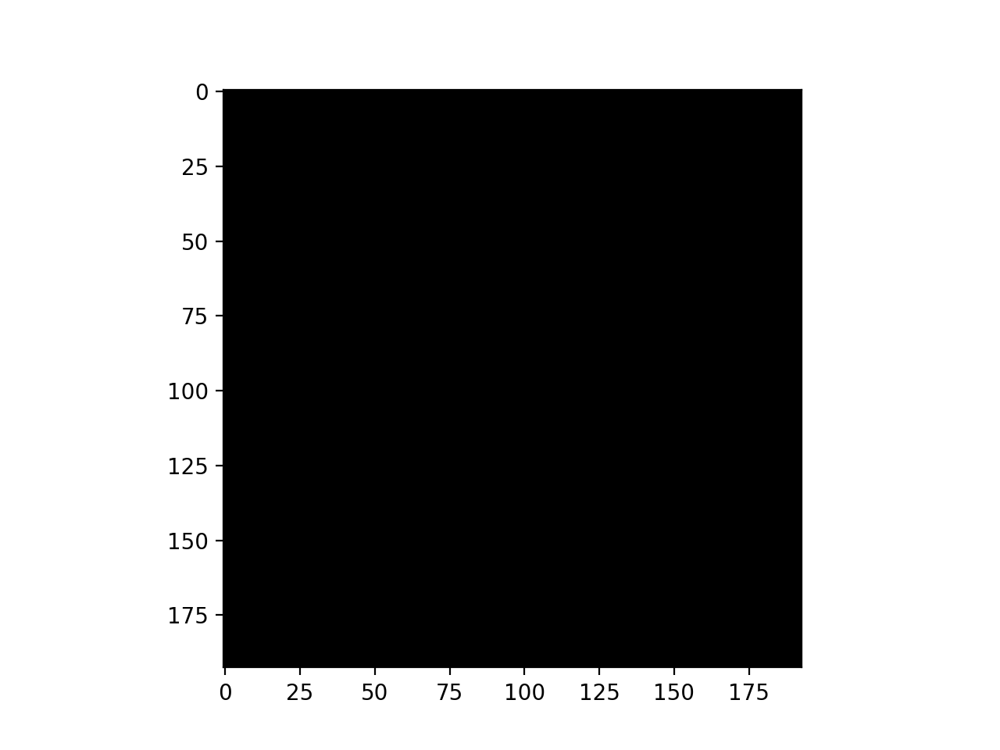

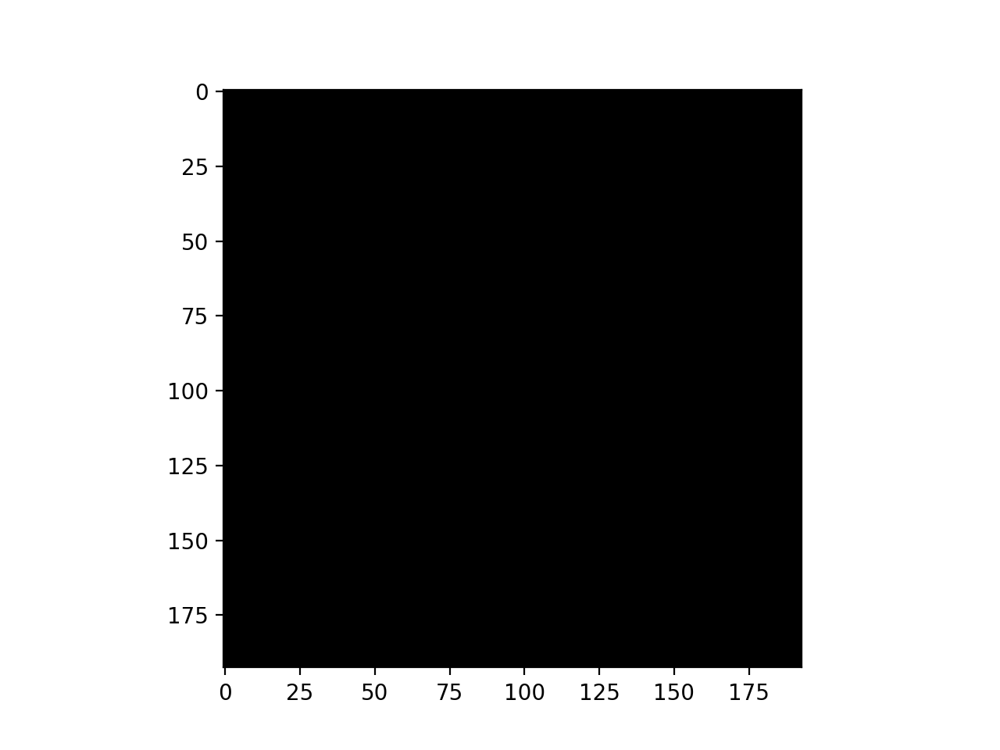

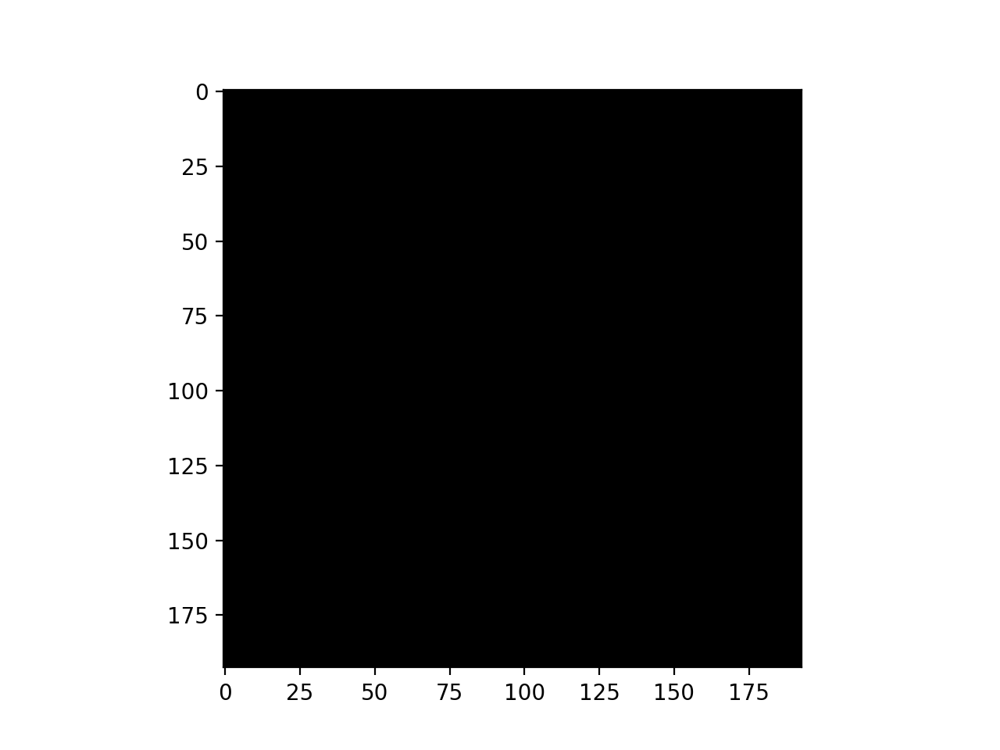

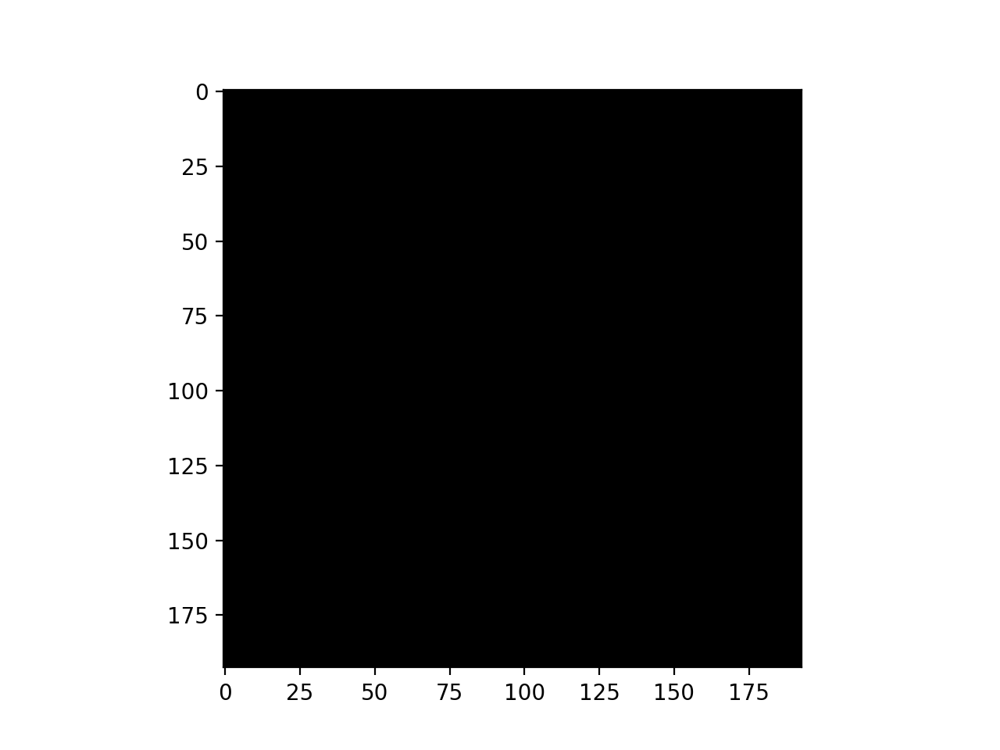

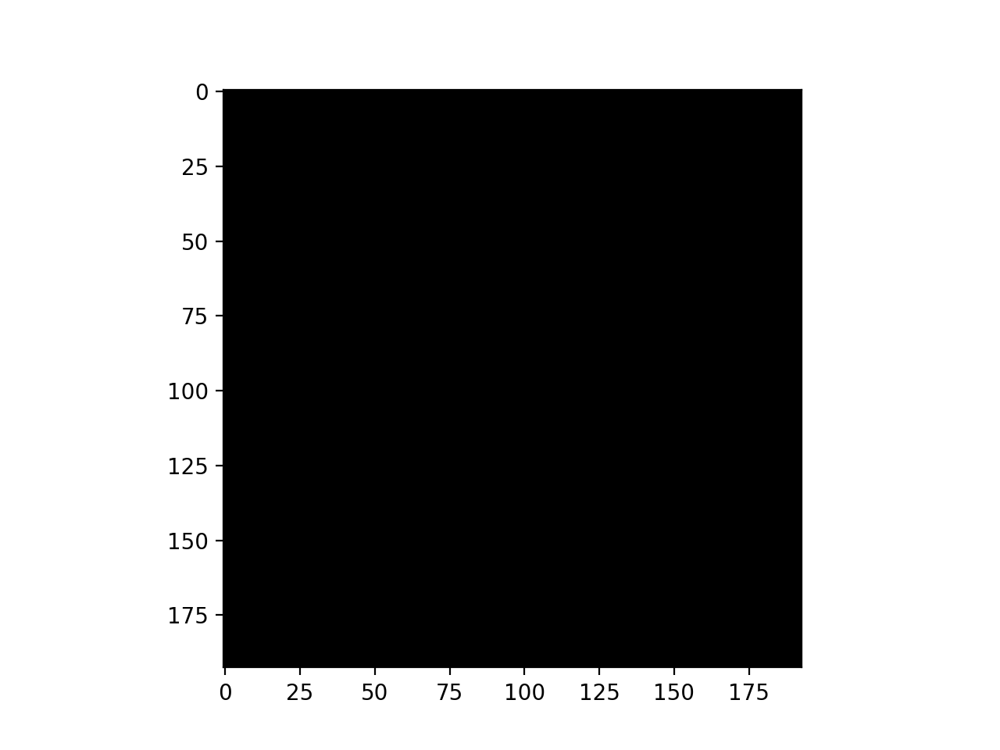

In [41]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from aucmedi import *
import csv
import random
import pandas as pd
import numpy as np
import re
from aucmedi.sampling.split import sampling_split
from sklearn.metrics import confusion_matrix


# Define the evaluation metrics to compute 
acc_AD, acc_MCI, auc_AD, auc_MCI = [], [], [], []



n_splits = 10
learning_rate = 0.0001
num_epochs = 50
splits = [0.8, 0.1, 0.1]
seed = 123

for k in range(3,n_splits): #range(n_splits):
    # clear any existing global keras state (=GPU memory) and start with blank initialization
    keras.backend.clear_session()

    from tensorflow.keras.callbacks import ModelCheckpoint

    #"/mnt/data_dzne_archiv2/Studien/Deep_Learning_Visualization/temporary_stuff/Jaya Chandra Terli/aucmedi_setup"
    # model_history = os.path.join('assets', 'model.h5')

    model_checkpoint = ModelCheckpoint(
        filepath=("model_checkpoint/ADMCIvsCN_ohneEMCIAD3_epoch_cv{:02d}.h5".format(k+1)),
        monitor='val_accuracy',
        mode='auto',
        save_best_only=True
    )
    
    set_train, set_val, set_test = sampling_split(
        samples=nifti_images, # list of sample names
        labels=labelsbin, # list of corresponding labels
        metadata=meta_grp, # metadata as numpy array        
        sampling=splits, # percentage splits
        stratified=True, # Allow overlaps between sets
        iterative=False, # Approximation of a solution is only useful for multi label problems
        seed= seed+k 
    )

    from aucmedi.utils.class_weights import compute_multilabel_weights, compute_class_weights
    is_multilabel = False
    if is_multilabel:
        class_weights = compute_multilabel_weights(set_train[1])
    else:
        class_weights = compute_class_weights(set_train[1])

    from aucmedi.data_processing import augmentation

    # activate flip and scale usgmentation
    data_aug = augmentation.VolumeAugmentation(flip=True, rotate=False, brightness=False, contrast=False,
                    saturation=False, hue=False, scale=True, crop=False,
                    grid_distortion=False, compression=False, gaussian_noise=False,
                    gaussian_blur=False, downscaling=False, gamma=False,
                    elastic_transform=False)
    
    from aucmedi.data_processing import data_generator
    from aucmedi.data_processing.io_loader.sitk_loader import sitk_loader

    gen_train = data_generator.DataGenerator(
        samples=set_train[0],
        labels=set_train[1],
        metadata=set_train[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=data_aug, # set 'None' to disable augmentations
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed=seed+k
    )
    from aucmedi.data_processing.io_loader.sitk_loader import sitk_loader
    from aucmedi.utils.visualizer import visualize_array
    sample_name = 'AIBL_0112_N4cor_WarpedSegmentationPosteriors2.nii.gz'
    sample_path = '/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone/'
    sample_img = sitk_loader(sample_name, sample_path)
    

    # validation generator without augmentation
    gen_val = data_generator.DataGenerator(
        samples=set_val[0],
        labels=set_val[1],
        metadata=set_val[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=None, # set 'None' to disable augmenations
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed= seed+k
    )
    
    x, y, z = 193, 229, 193
    numfiles = len(nifti_images)
    input_shape = (numfiles, x, y, z, 1)
    model = DenseNet(input_shape[1:], labelsbin.shape[1])
    opt = tf.keras.optimizers.legacy.Adam(lr=learning_rate)
    model.compile(loss='categorical_crossentropy', optimizer = opt, metrics=['accuracy'])
    model.summary()
    
    # Create a Test generator                   
    gen_test = data_generator.DataGenerator(
        samples=set_test[0],
        labels=set_test[1],
        metadata=set_test[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=None,
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed=seed+k
    )
    
    #fit model 
    with tf.compat.v1.Session() as sess:
        history = model.fit(
            x=gen_train,
            epochs=num_epochs,
            verbose=1,
            validation_data=gen_val,
            callbacks=[model_checkpoint],
            class_weight = class_weights
        )
    
    # Display models statistics
    from matplotlib import pyplot as plt
    from keras.models import load_model, Model
    from tensorflow.keras.models import load_model
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    #acc = history.history['accuracy']
    acc = history.history['accuracy']
    #val_acc = history.history['val_accuracy']
    val_acc = history.history['val_accuracy']
    epochsr = range(1, num_epochs+1, 1)
    plt.figure()
    plt.plot(epochsr, loss, 'bo', label='Training loss')
    plt.plot(epochsr, val_loss, 'b', label='Validation loss')
    plt.title('Training and validation loss')
    plt.legend()
    plt.show()
    plt.figure()
    plt.plot(epochsr, acc, 'bo', label='Training acc')
    plt.plot(epochsr, val_acc, 'b', label='Validation acc')
    plt.title('Accuracy')   
    plt.legend()
    plt.show()
    
    with tf.compat.v1.Session() as sess:
        mymodel = load_model("model_checkpoint/ADMCIvsCN_ohneEMCIAD3_epoch_cv{:02d}.h5".format(k+1))
        pred = mymodel.predict(gen_test) 
    
         
    from sklearn.metrics import roc_curve, auc
    from matplotlib import pyplot as plt
    
    # Performance evaluation for the combined study group MCI&AD vs CN
    from aucmedi.evaluation import performance

    # metric = performance.evaluate_performance(
    #     preds=pred,
    #     labels=set_test[1],
    #     out_path="/data_dzne_archiv2/Studien/Deep_Learning_Visualization/temporary_stuff/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/",
    #     class_names=class_names,
    #     show=True,
    #     #multi_label=is_multilabel
    # )
    # metric


    bool_AD_CN = set_test[2][:,0] | set_test[2][:,1]
    bool_MCI_CN = set_test[2][:,2] | set_test[2][:,1]

    set_test_MCI_CN = set_test[1][bool_MCI_CN]   
    pred_MCI_CN = pred[bool_MCI_CN]
    set_test_AD_CN = set_test[1][bool_AD_CN]
    pred_AD_CN = pred[bool_AD_CN]
    # Evaluation metrics for AD vs CN
    
    fpr_AD_CN, tpr_AD_CN, _ = roc_curve(set_test_AD_CN[:, 1], pred_AD_CN[:, 1])
    roc_auc_AD_CN = auc(fpr_AD_CN, tpr_AD_CN)
    acc_AD_CN = np.mean((set_test_AD_CN[:, 1] == np.round(pred_AD_CN[:, 1])).astype(int))*100
    
    print('AUC for AD vs. CN = %0.3f' % roc_auc_AD_CN)
    print('Acc for AD vs. CN = %0.1f' % acc_AD_CN)
    auc_AD.append(roc_auc_AD_CN)
    acc_AD.append(acc_AD_CN)

    performance.evaluate_performance(
        preds=pred_AD_CN,
        labels=set_test_AD_CN,
        out_path="/home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv{:02d}".format(k+1),
        class_names=class_names,
        show=True,
        #multi_label=is_multilabel
    )                     
    # Evaluation metrics for MCI vs CN
    
    fpr_MCI_CN, tpr_MCI_CN, _ = roc_curve(set_test_MCI_CN[:, 1], pred_MCI_CN[:, 1])
    roc_auc_MCI_CN = auc(fpr_MCI_CN, tpr_MCI_CN)
    acc_MCI_CN = np.mean((set_test_MCI_CN[:, 1] == np.round(pred_MCI_CN[:, 1])).astype(int))*100

        
    print('AUC for MCI vs. CN = %0.3f' % roc_auc_MCI_CN)
    print('Acc for MCI vs. CN = %0.1f' % acc_MCI_CN)
    auc_MCI.append(roc_auc_MCI_CN)
    acc_MCI.append(acc_MCI_CN)
    performance.evaluate_performance(
        preds=pred_MCI_CN,
        labels=set_test_MCI_CN,
        out_path="/home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv{:02d}".format(k+1),
        class_names=class_names,
        show=True,
    )

    plt.figure()
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--') # diagonal as reference
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.plot(fpr_MCI_CN, tpr_MCI_CN, color='darkorange', label='ROC curve MCI vs. CN (area = %0.2f)' % roc_auc_MCI_CN)
    plt.plot(fpr_AD_CN, tpr_AD_CN, color='red', label='ROC curve AD vs. CN (area = %0.2f)' % roc_auc_AD_CN)
    plt.legend(loc="lower right")
    plt.show()



    import innvestigate
    import scipy
    import os

    # see https://github.com/albermax/innvestigate/blob/master/examples/notebooks/imagenet_compare_methods.ipynb for a list of alternative methods
    methods = [ # tuple with method,     params,                  label
    #            ("deconvnet",            {},                      "Deconvnet"),
    #            ("guided_backprop",      {},                      "Guided Backprop"),
    #            ("deep_taylor.bounded",  {"low": -1, "high": 1},  "DeepTaylor"),
    #            ("input_t_gradient",     {},                      "Input * Gradient"),
    #            ("lrp.z",                {},                      "LRP-Z"),
    #            ("lrp.epsilon",          {"epsilon": 1},          "LRP-epsilon"),
    #            ("lrp.alpha_1_beta_0",   {"neuron_selection_mode":"index"},     "LRP-alpha1beta0"),
    #        ("integrated_gradients",   {"neuron_selection_mode":"index"},     "Integrated Gradients"),
            ("lrp.sequential_preset_a", {"disable_model_checks":True, "neuron_selection_mode": "index", "epsilon": 1e-10}, "LRP-CMPalpha1beta0"), # LRP CMP rule taken from https://github.com/berleon/when-explanations-lie/blob/master/when_explanations_lie.py
    ]

    with tf.compat.v1.Session() as sess:
        mymodel = load_model("model_checkpoint/ADMCIvsCN_ohneEMCIAD3_epoch_cv{:02d}.h5".format(k+1))
        # replace last layer's softmax activation function by linear
        model_wo_softmax = innvestigate.model_wo_softmax(mymodel)

        # create analyzer
        analyzers = []
        for method in methods:
            #analyzer = innvestigate.create_analyzer("deep_taylor.bounded", model_wo_softmax, **params )
            analyzer = innvestigate.create_analyzer(method[0], model_wo_softmax, **method[1])
            # Some analyzers require training.
            #   analyzer.fit(test_img, batch_size=30, verbose=1)
            analyzers.append(analyzer)
            
        #%%
        # 51	AIBL	CN	1	82		30	3	1491838	AIBL_0051_N4cor_WarpedSegmentationPosteriors2.nii.gz	normal
        # 6849	ADNI3	AD	0	78	16	21	3	1578271	ADNI3_6849_N4cor_WarpedSegmentationPosteriors2.nii.gz	alz

        testimg_path = "/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone/ADNI3_6849_N4cor_WarpedSegmentationPosteriors2.nii.gz"
        test_img = read_nifti_data(testimg_path, 0, 193, 0, 229, 0, 193, minmaxscaling=True)
        #print(grps.iloc[0, :]) # print subject information
        test_img = test_img.transpose((0,2,1))
        test_img = np.reshape(test_img, (1,)+ test_img.shape +(1,)) # add first subj index again to mimic original array structure

        for method,analyzer in zip(methods, analyzers):
            #a = np.reshape(analyzer.analyze(test_img, neuron_selection=1), test_img.shape[1:4])
            #a = scipy.ndimage.filters.gaussian_filter(a, sigma=0.8) # smooth activity image
            #scale = 1/500 # multiply by 500
            #a = (a/scale)
            #np.clip(a, a_min=-1, a_max=1, out=a) # constrain values to range between -1 and 1

            for neuron in [1]: #[0,1]:
                anal = analyzer.analyze(test_img, neuron_selection=neuron)
                for ch in [0]:
                    a = anal[0,:,:,:,ch] # first axis is subject
                    a = np.squeeze(a)
                    a = scipy.ndimage.filters.gaussian_filter(a, sigma=0.8) # smooth activity image

                    amax = np.quantile(np.abs(a), 0.9999) # np.amax(a)
                    amin = -amax # np.amin(a)
                    a = a/amax # range: [-1,1]
                    bg = np.squeeze(test_img[0,:,:,:,ch]) # first axis is subject

                    alpha_mask = np.int8(np.abs(a)>0.1)
                    for i in range(test_img.shape[2]):
                        if (i % 5 == 0): # only display each xx slice
                            plt.figure()
                            plt.imshow(bg[:,i,:], cmap='gray')
                            plt.imshow(a[:,i,:], cmap='jet', alpha=alpha_mask[:,i,:], vmin=-1, vmax=1) # cmap='hot'
                            plt.show() 
                            
        

    k = k+1

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:43:59.547545: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:43:59.547926: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:43:59.548064: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.932
Acc for AD vs. CN = 88.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

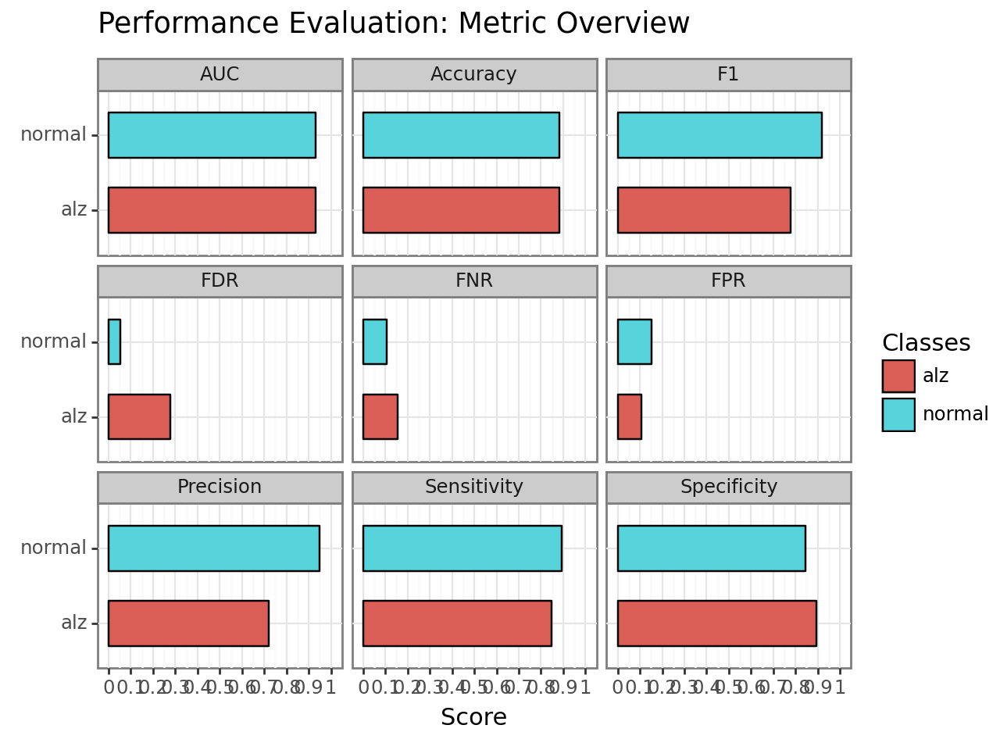

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv01/plot.performance.confusion_matrix.png


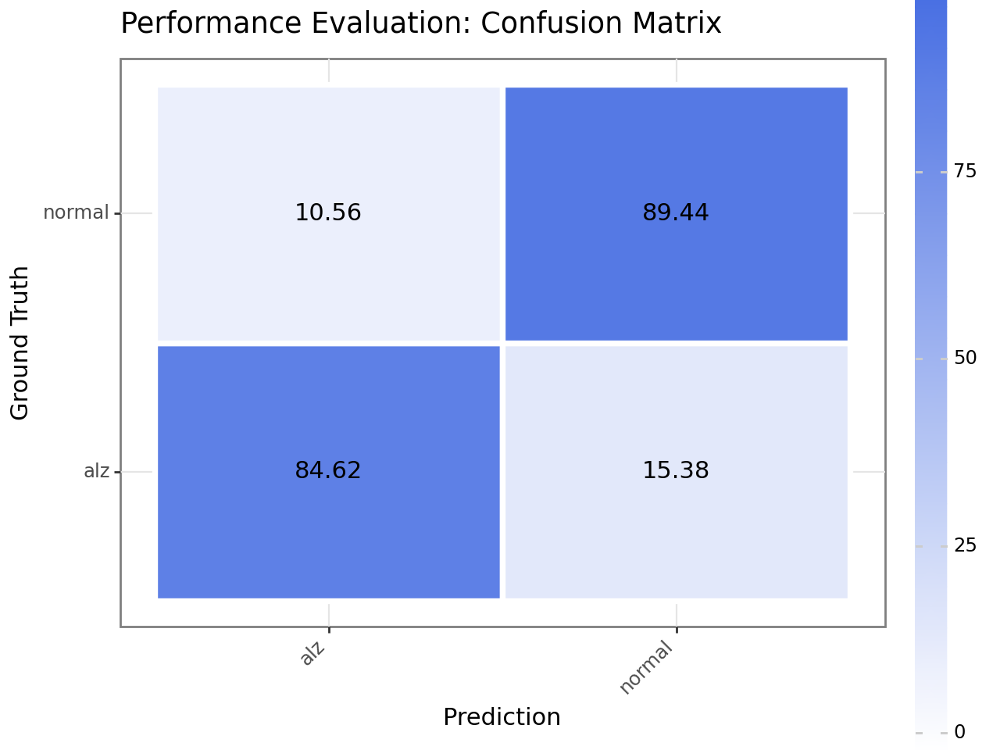

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv01/plot.performance.roc.png


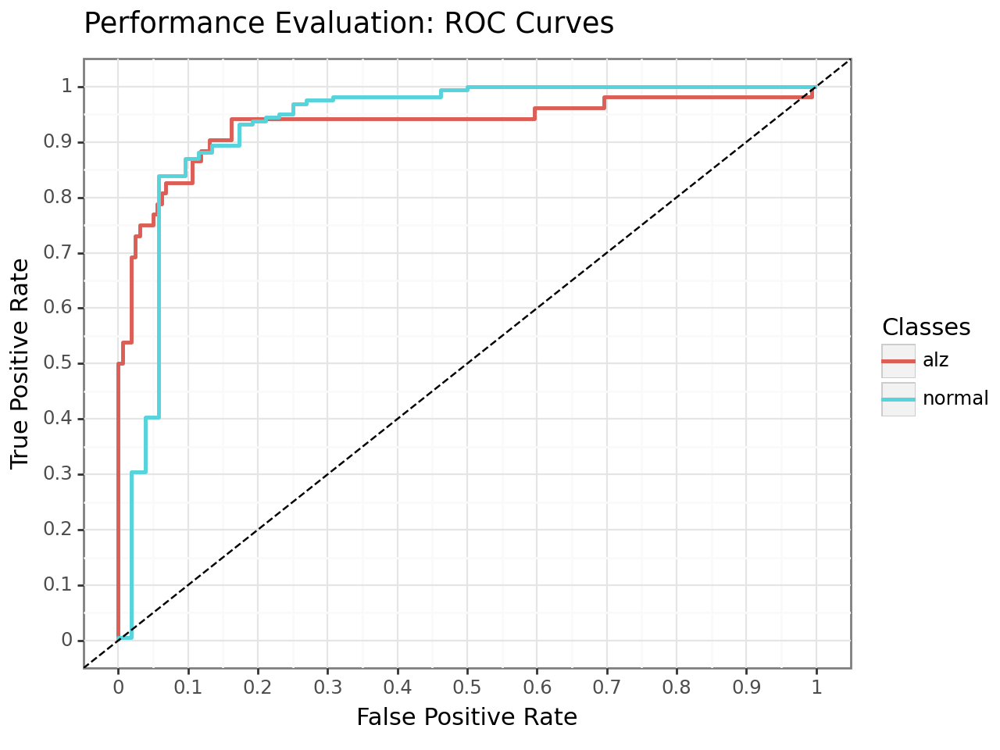


AUC for MCI vs. CN = 0.788
Acc for MCI vs. CN = 76.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

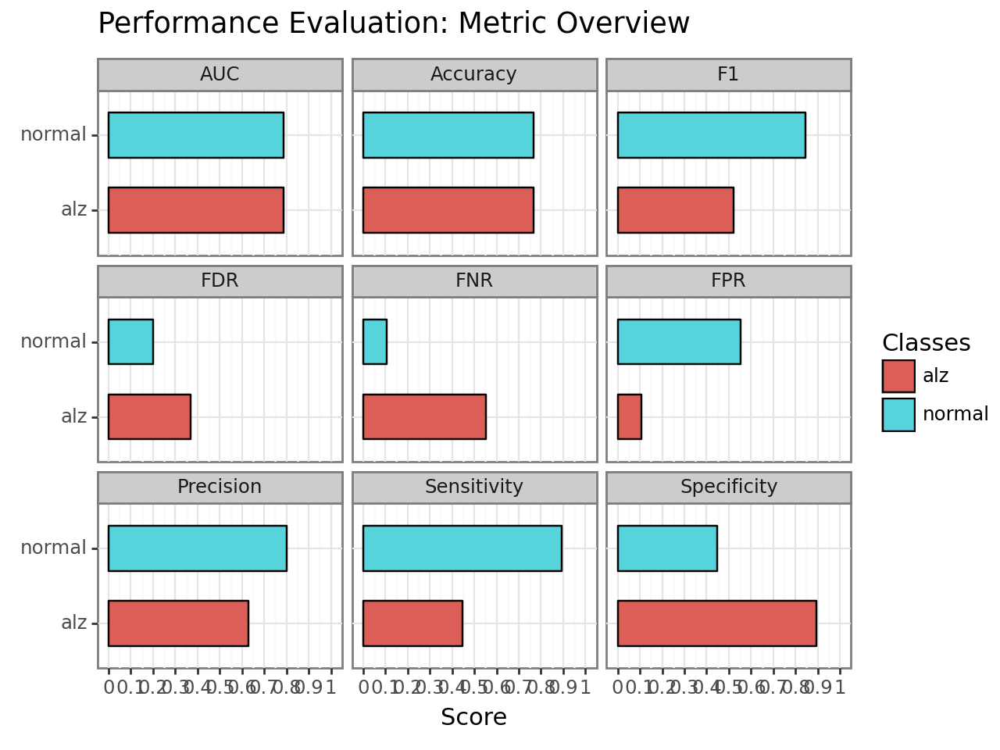

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv01/plot.performance.confusion_matrix.png


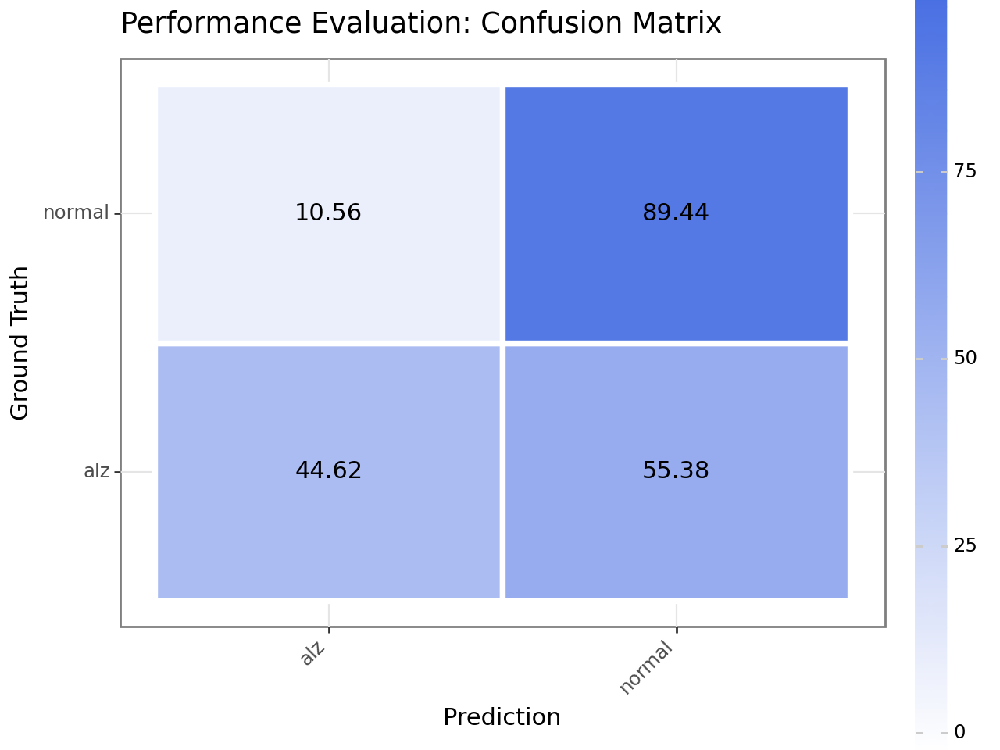

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv01/plot.performance.roc.png


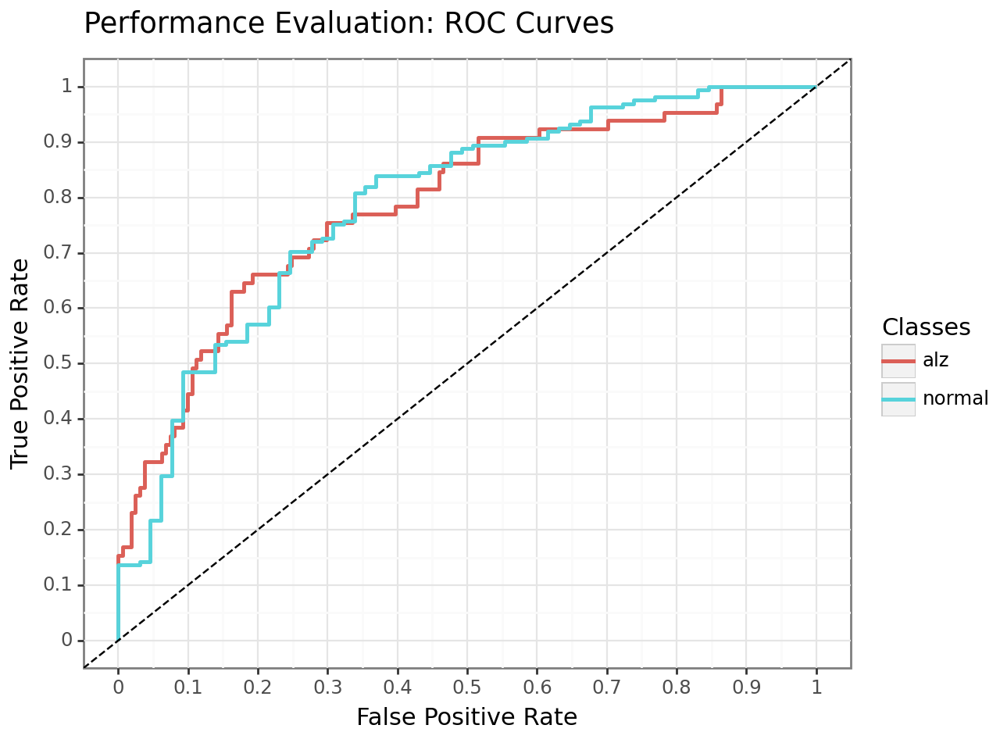

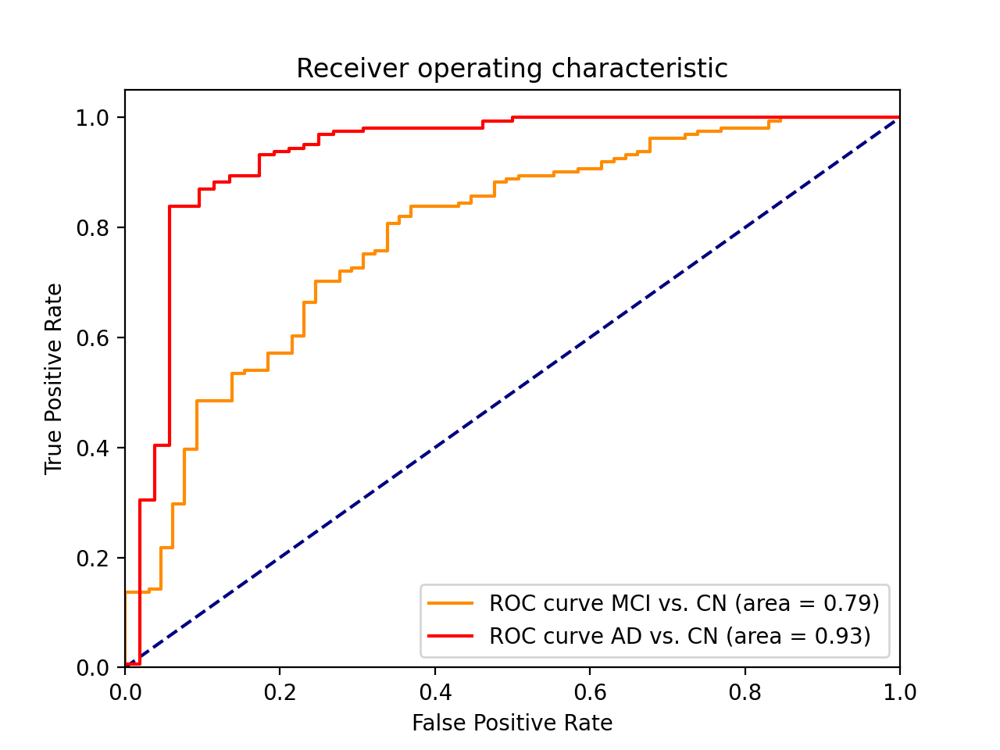

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:45:24.402477: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:45:24.402754: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:45:24.402876: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.958
Acc for AD vs. CN = 90.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

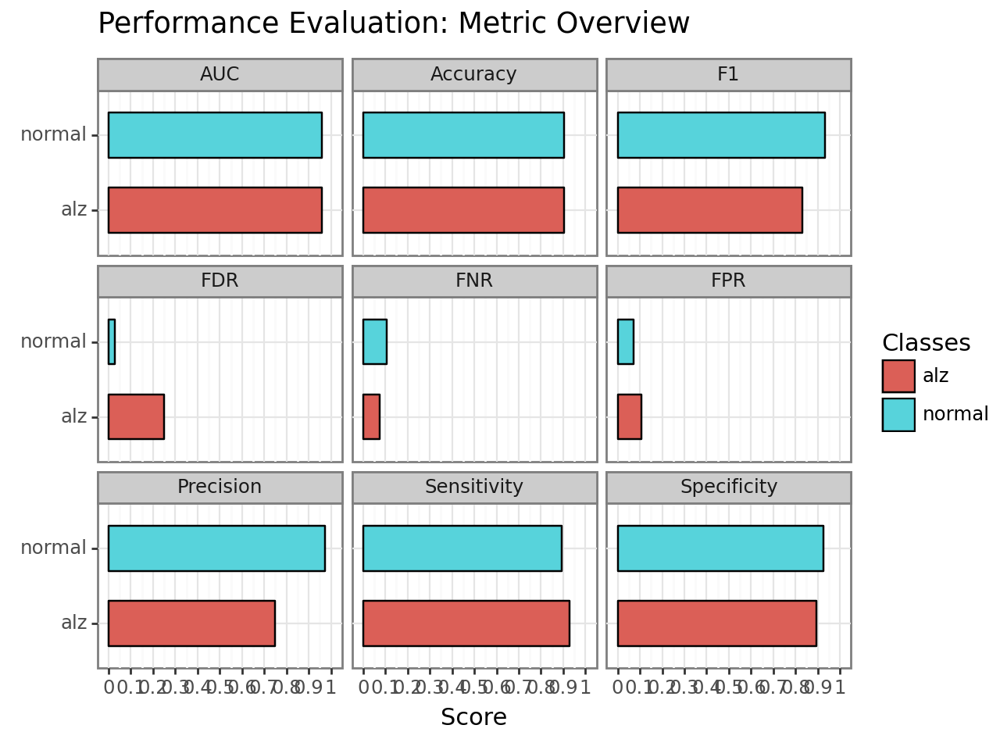

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv02/plot.performance.confusion_matrix.png


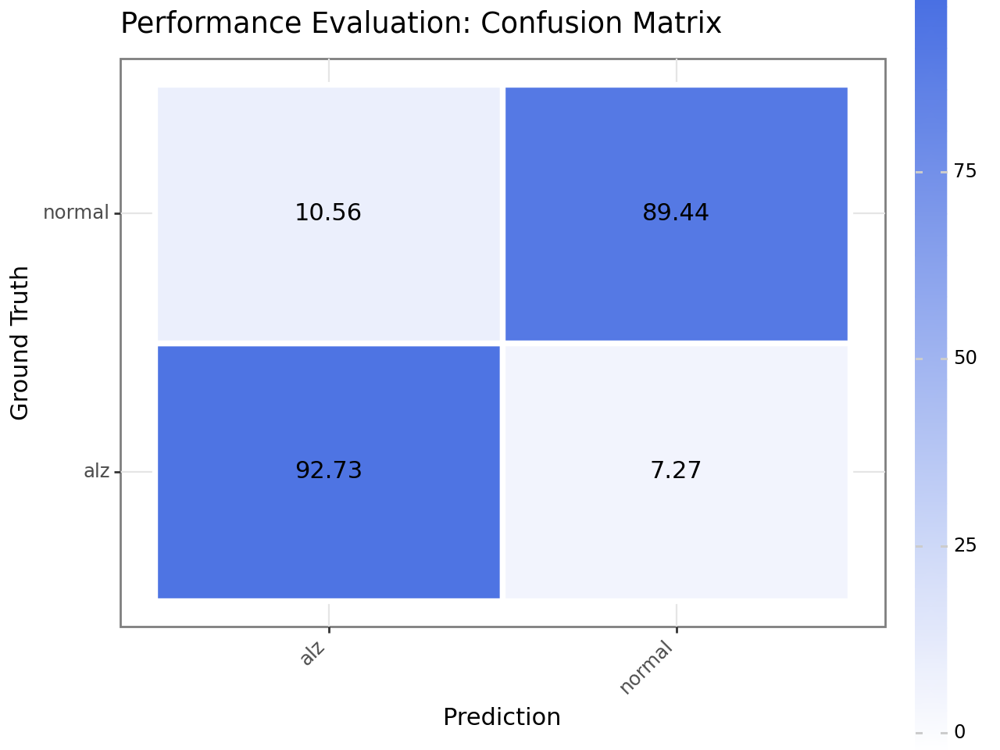

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv02/plot.performance.roc.png


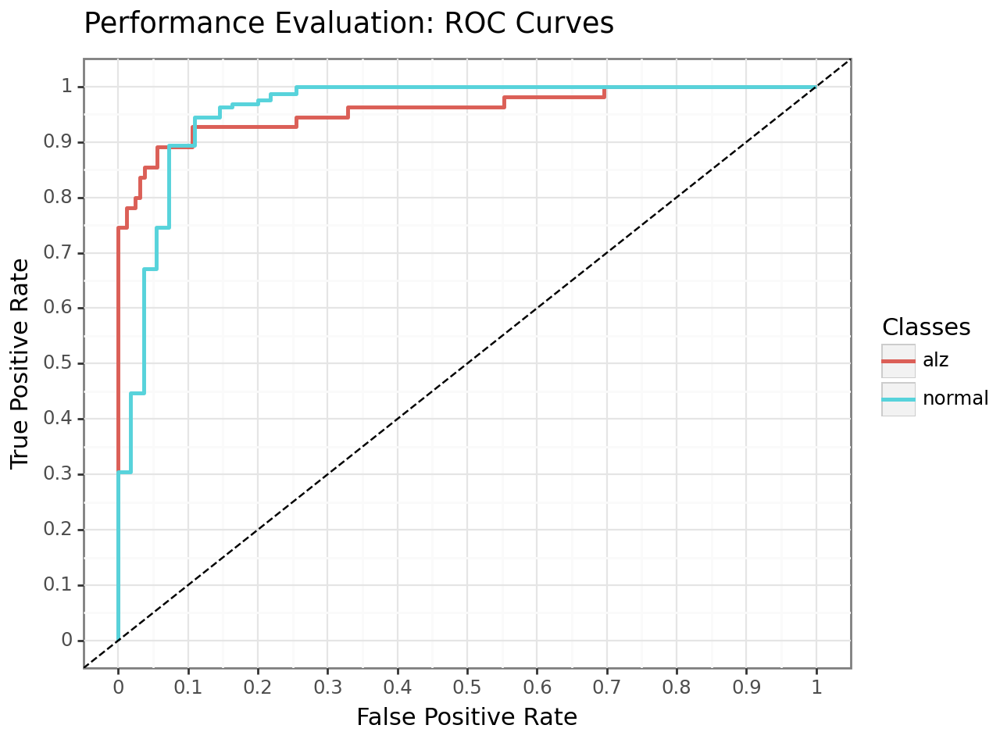


AUC for MCI vs. CN = 0.814
Acc for MCI vs. CN = 82.1


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

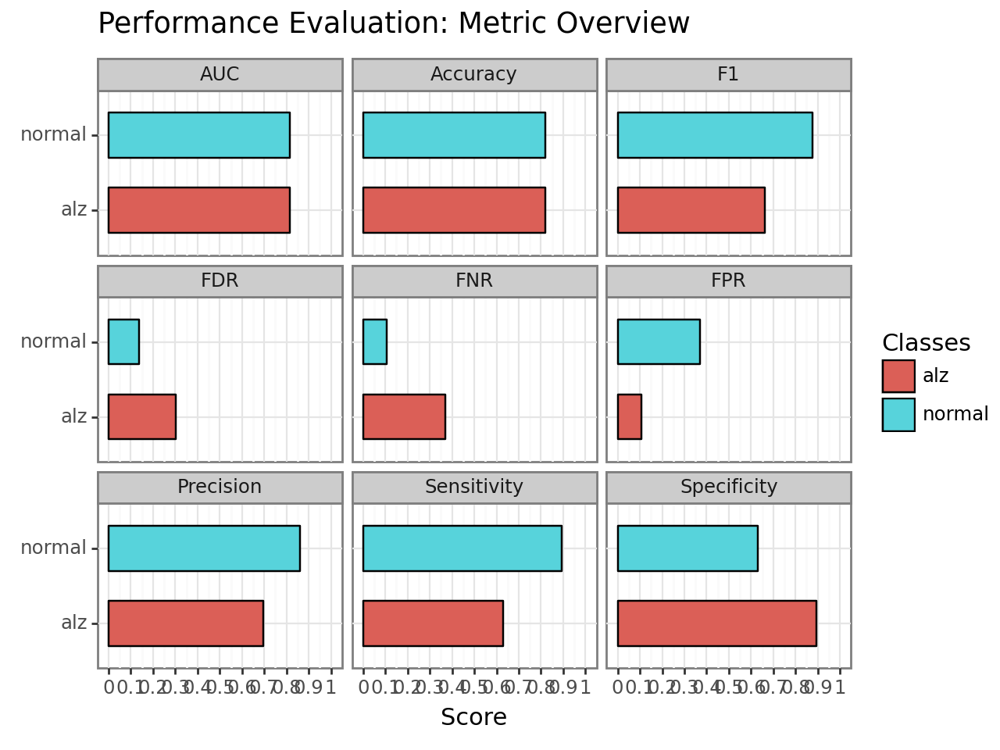

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv02/plot.performance.confusion_matrix.png


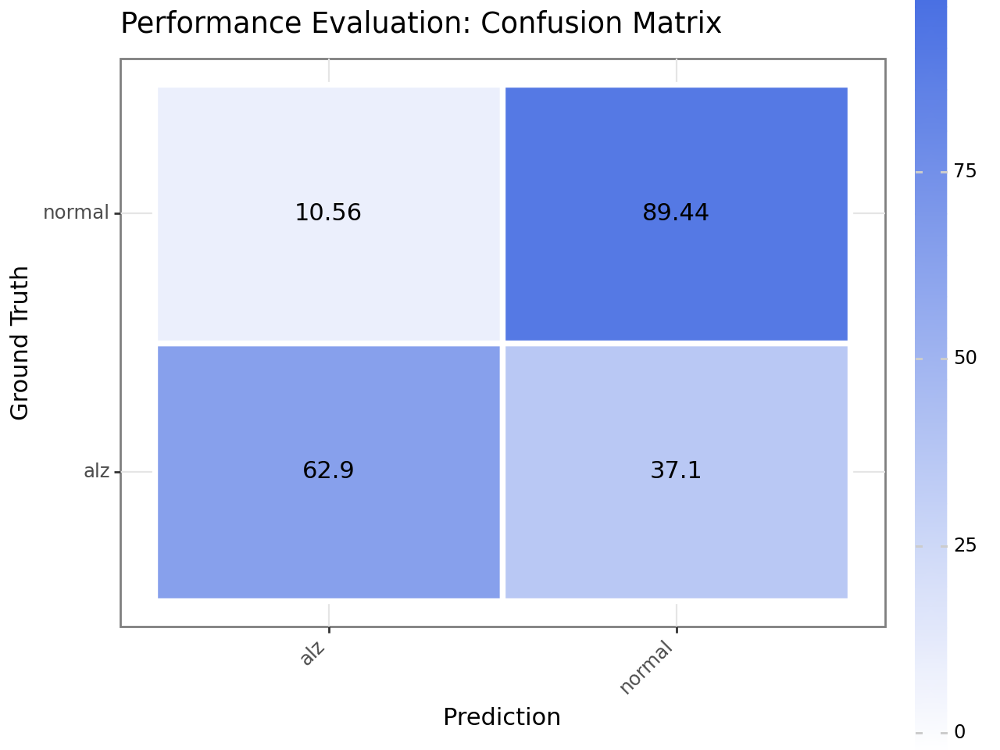

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv02/plot.performance.roc.png


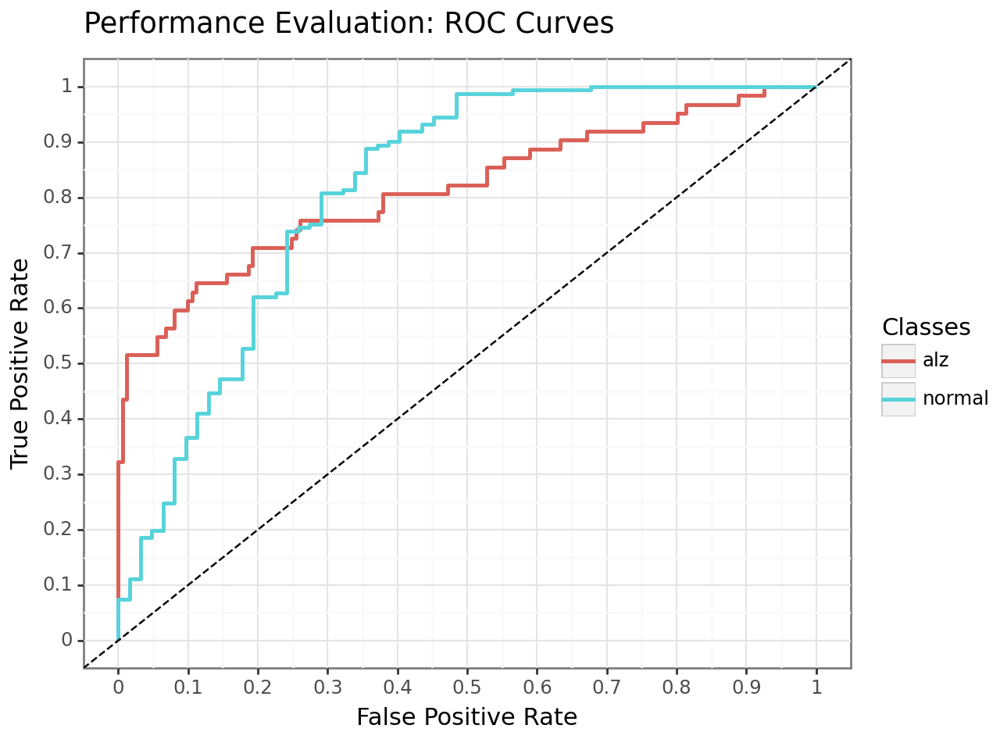

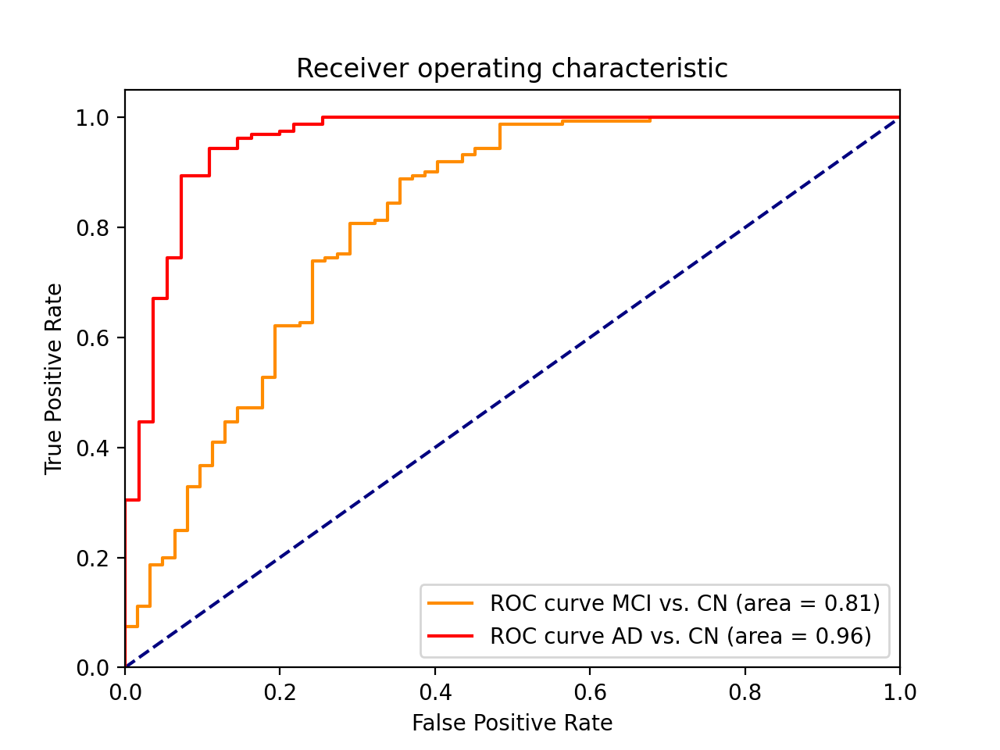

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:46:47.137545: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:46:47.137897: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:46:47.138069: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.919
Acc for AD vs. CN = 83.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

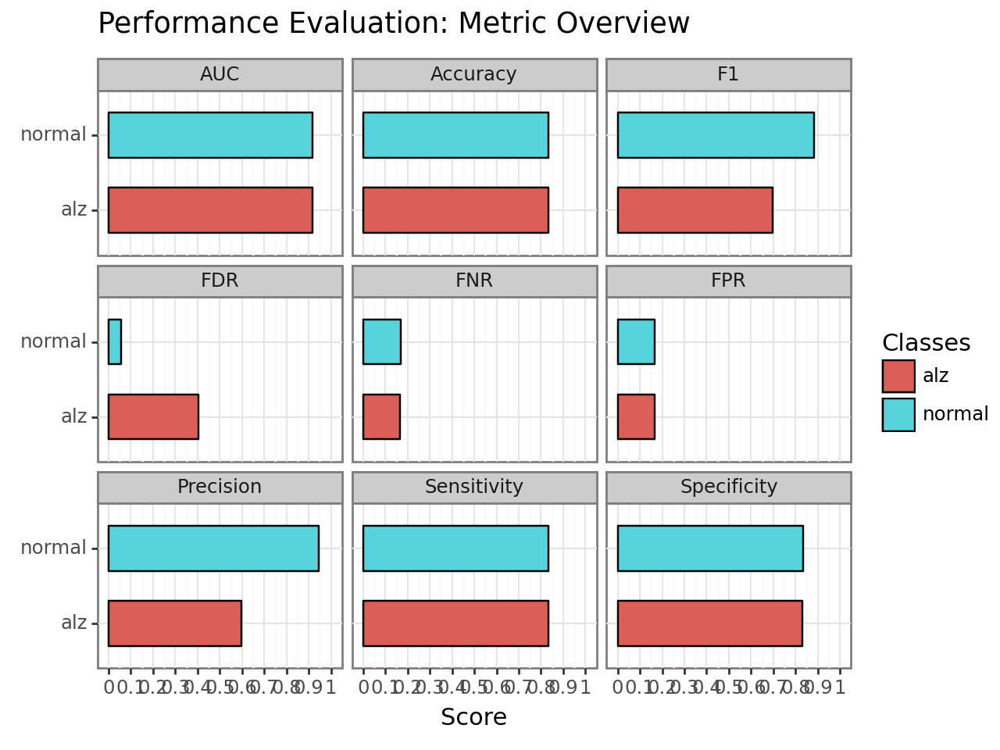

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv03/plot.performance.confusion_matrix.png


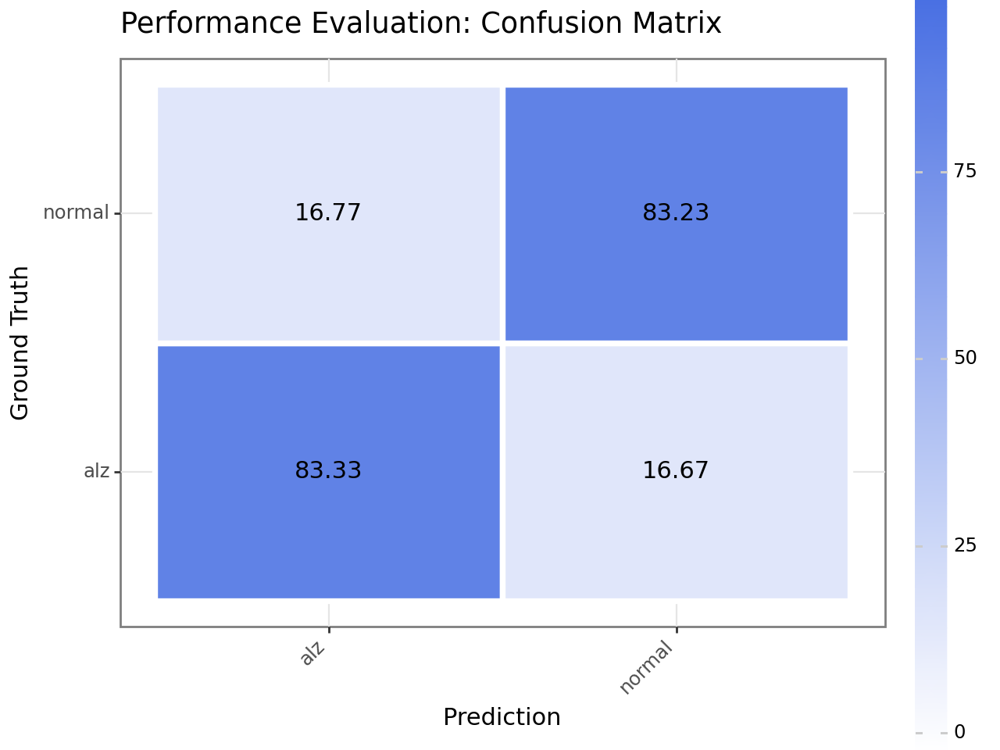

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv03/plot.performance.roc.png


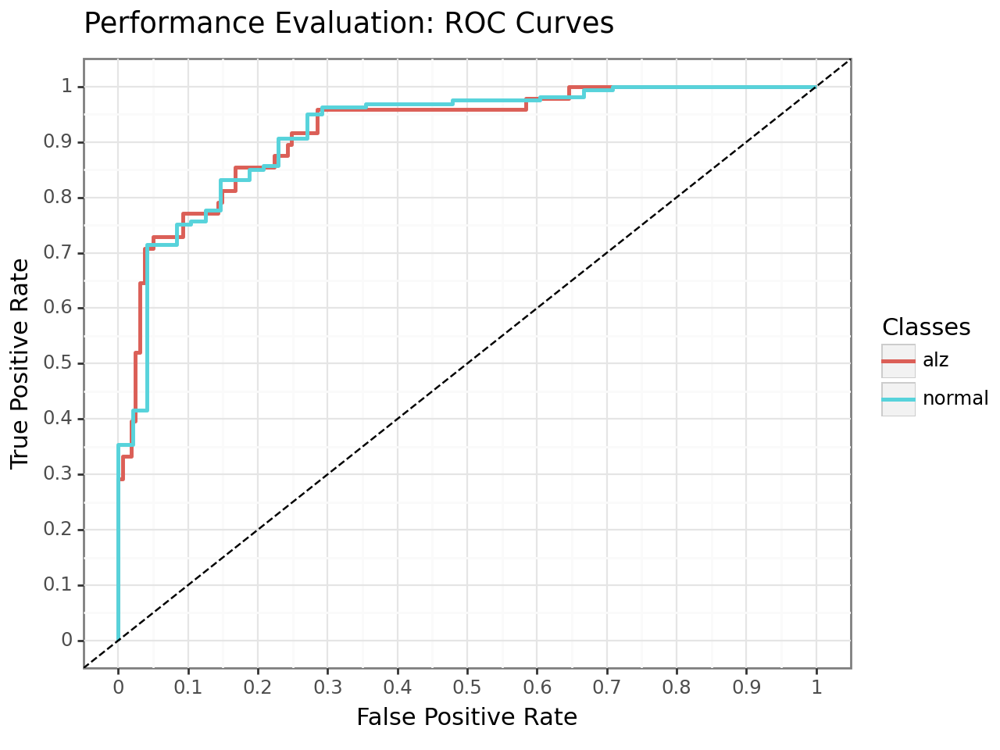


AUC for MCI vs. CN = 0.751
Acc for MCI vs. CN = 74.8


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

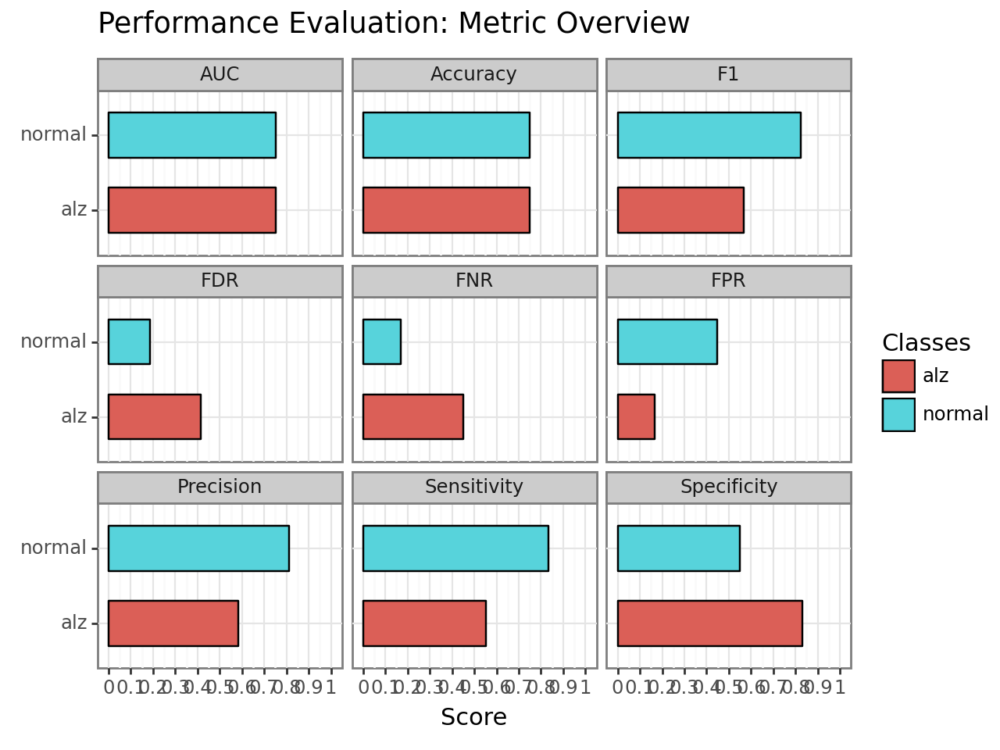

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv03/plot.performance.confusion_matrix.png


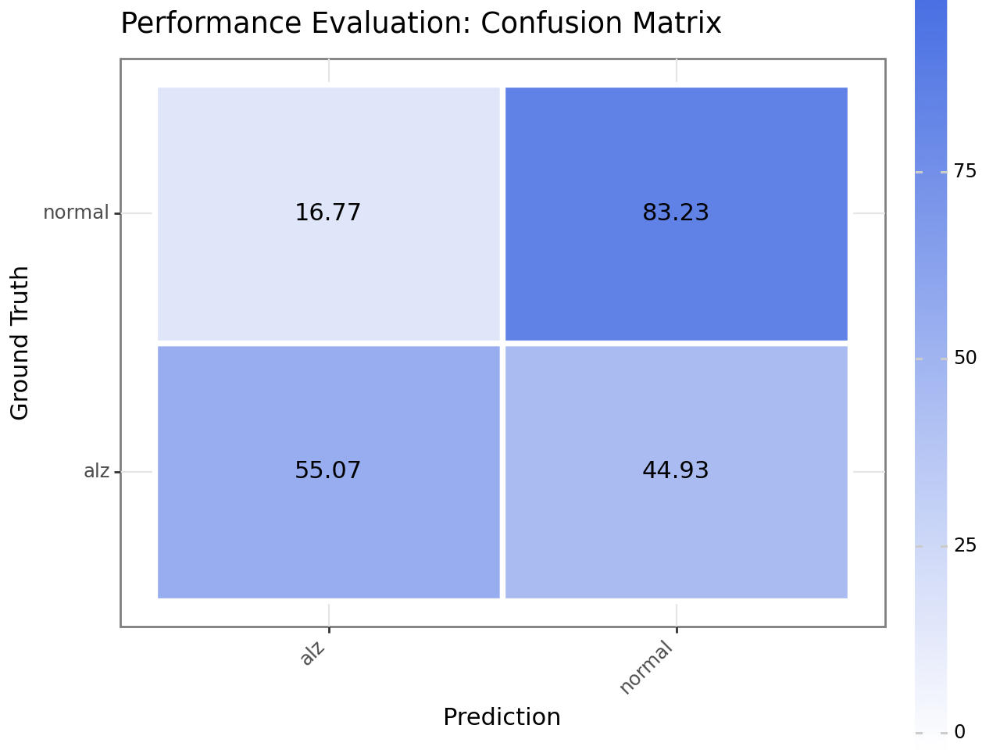

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv03/plot.performance.roc.png


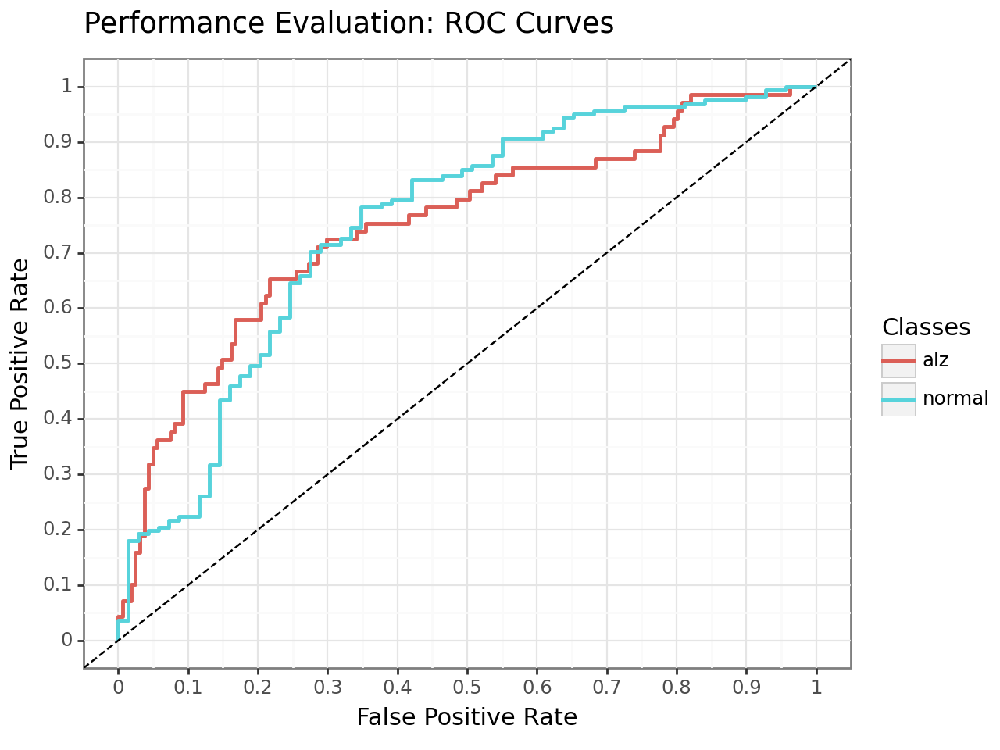

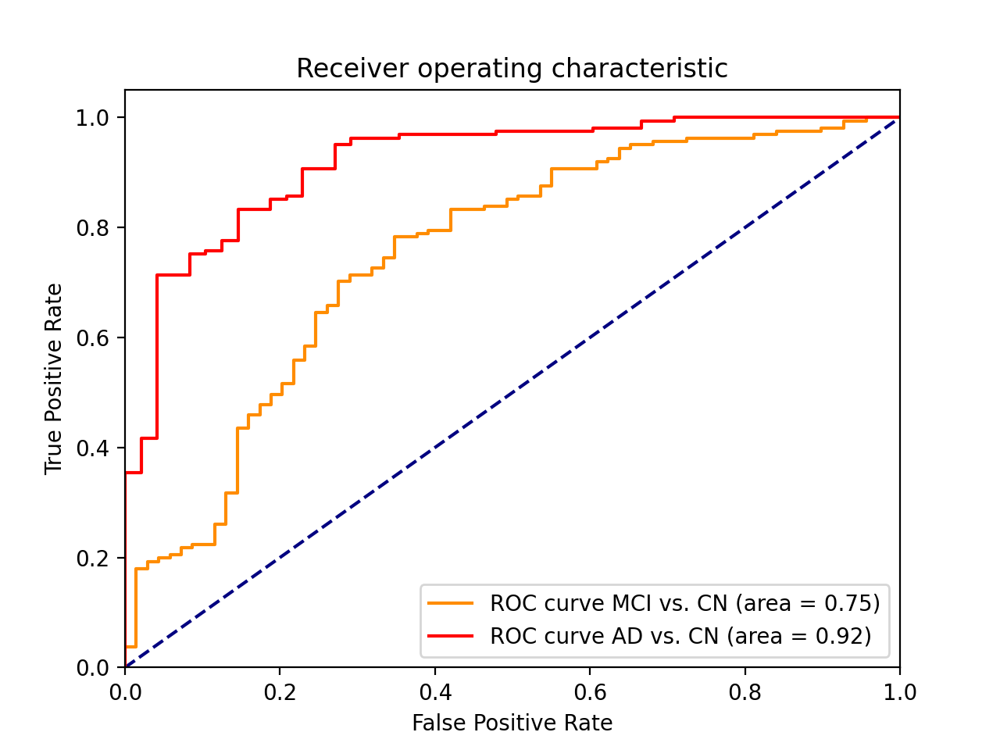

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:48:07.802139: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:48:07.802424: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:48:07.802542: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.929
Acc for AD vs. CN = 85.0


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

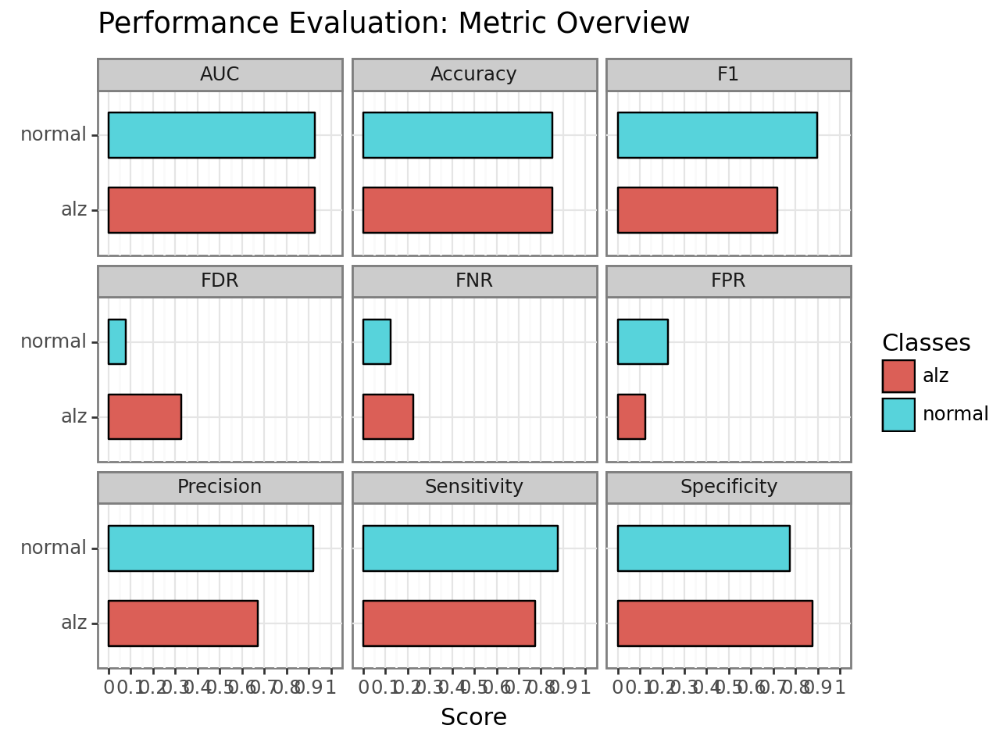

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv04/plot.performance.confusion_matrix.png


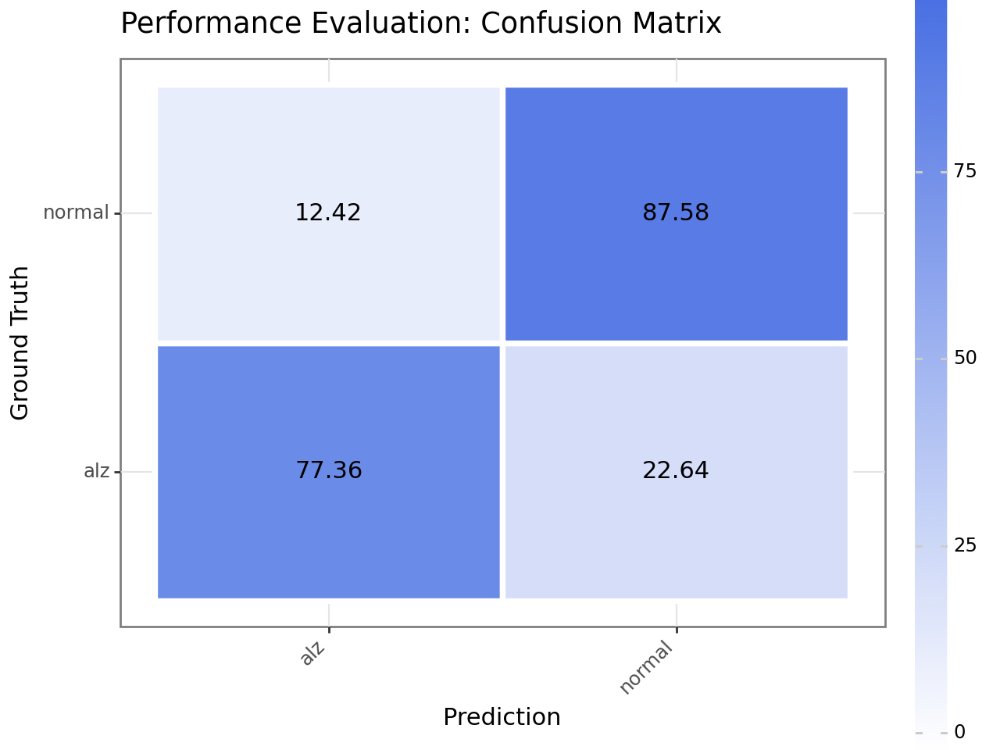

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv04/plot.performance.roc.png


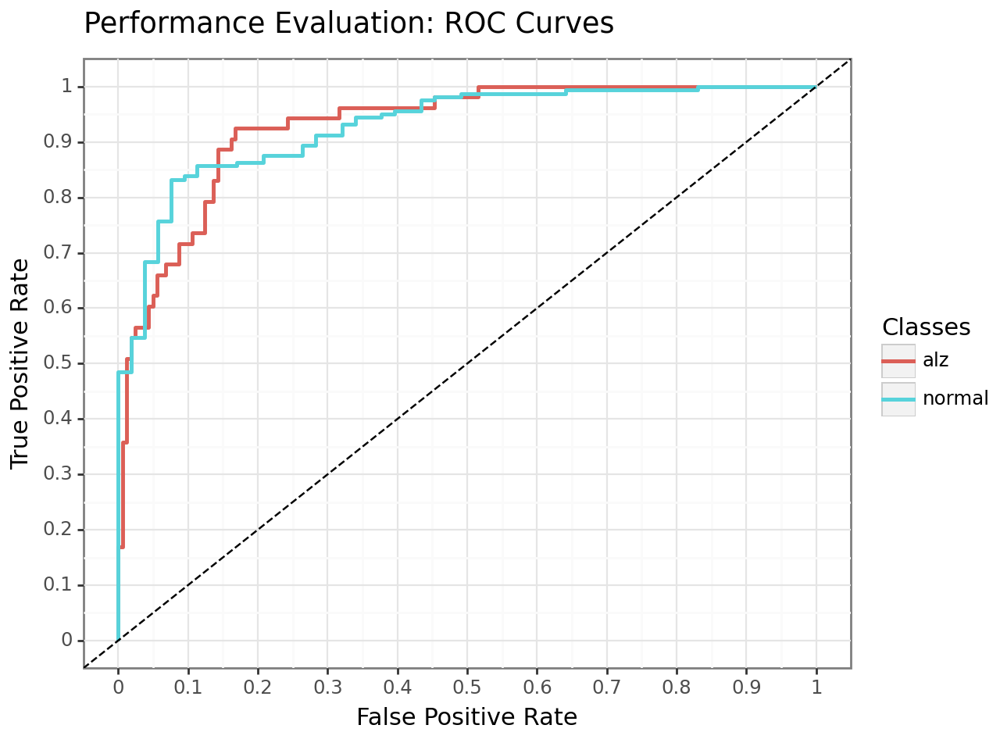


AUC for MCI vs. CN = 0.755
Acc for MCI vs. CN = 76.9


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

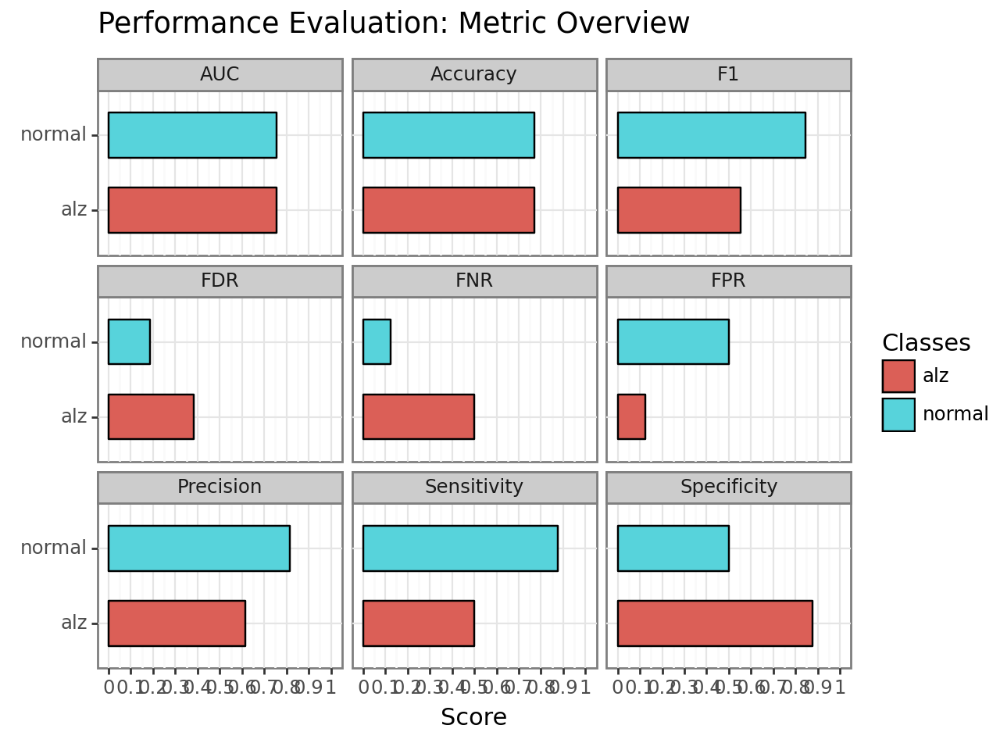

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv04/plot.performance.confusion_matrix.png


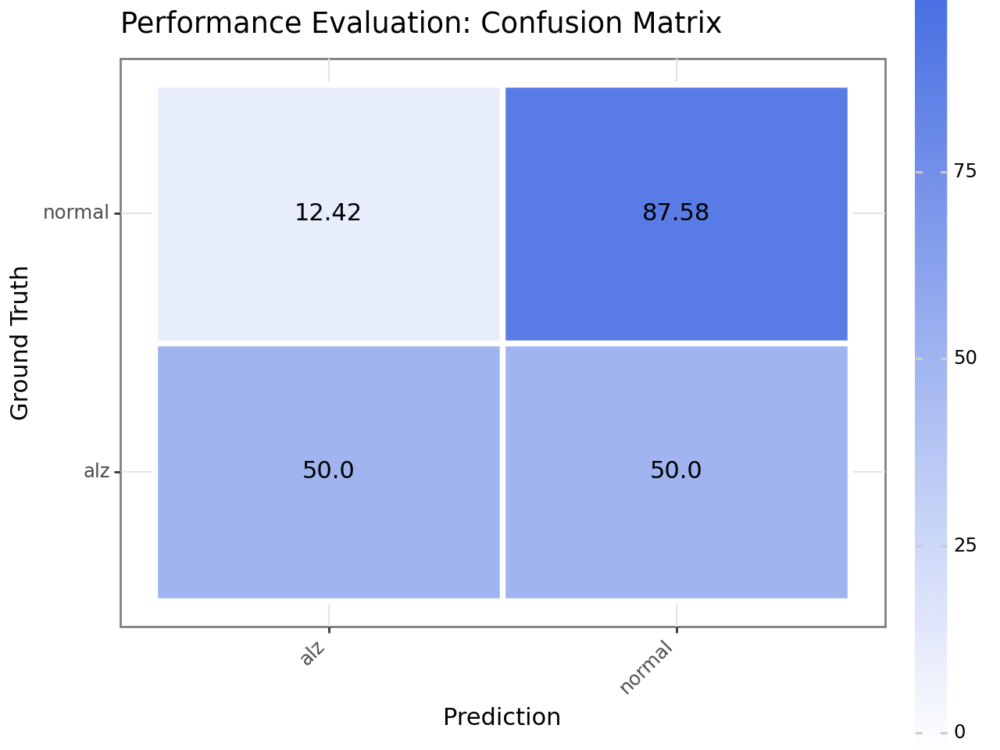

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv04/plot.performance.roc.png


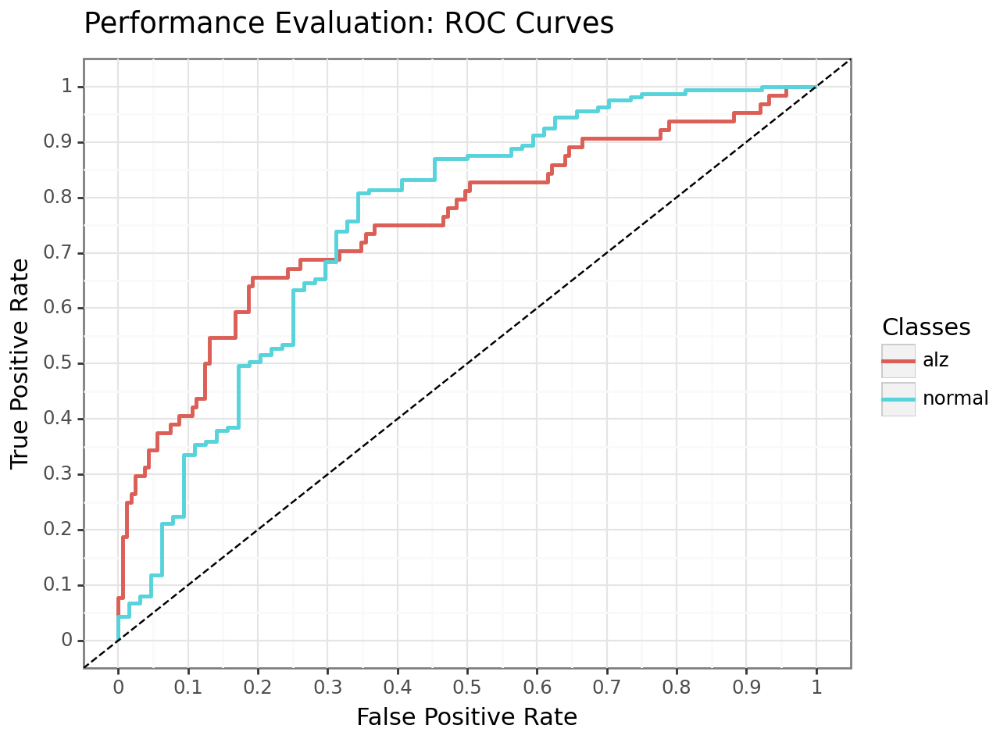

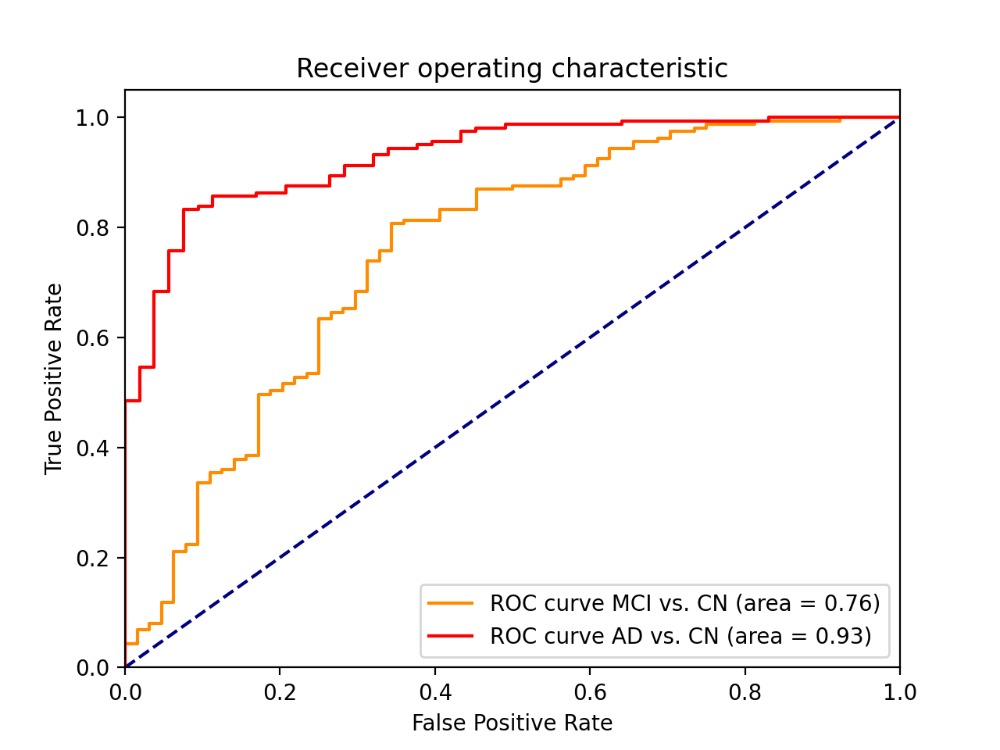

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:49:31.290370: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:49:31.290625: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:49:31.290738: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.919
Acc for AD vs. CN = 87.6


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

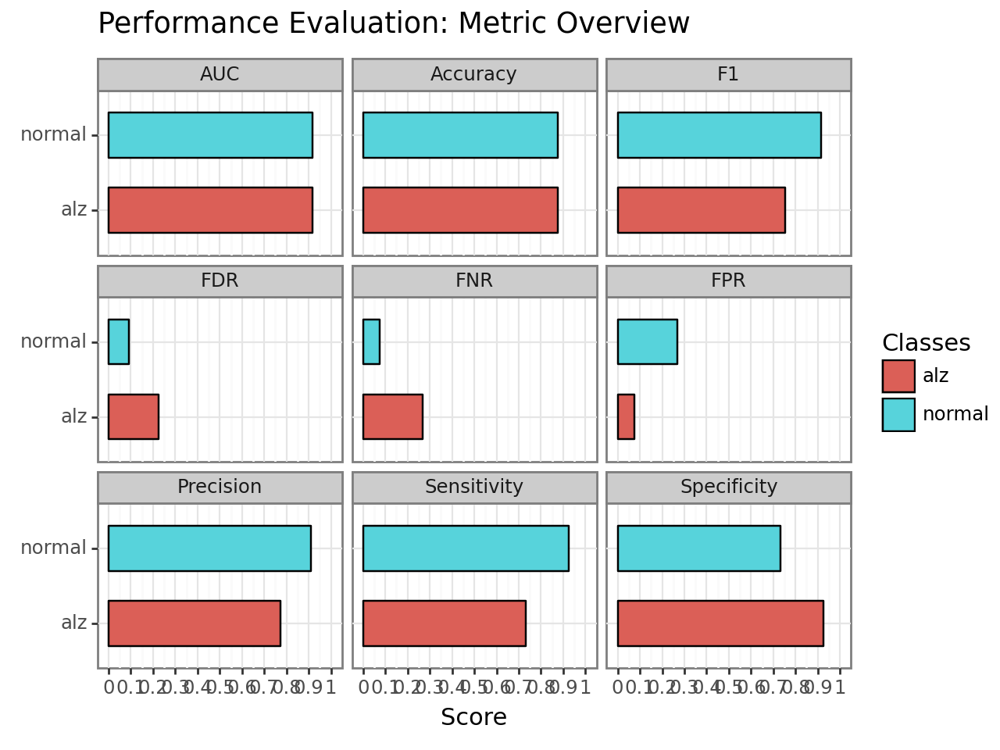

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv05/plot.performance.confusion_matrix.png


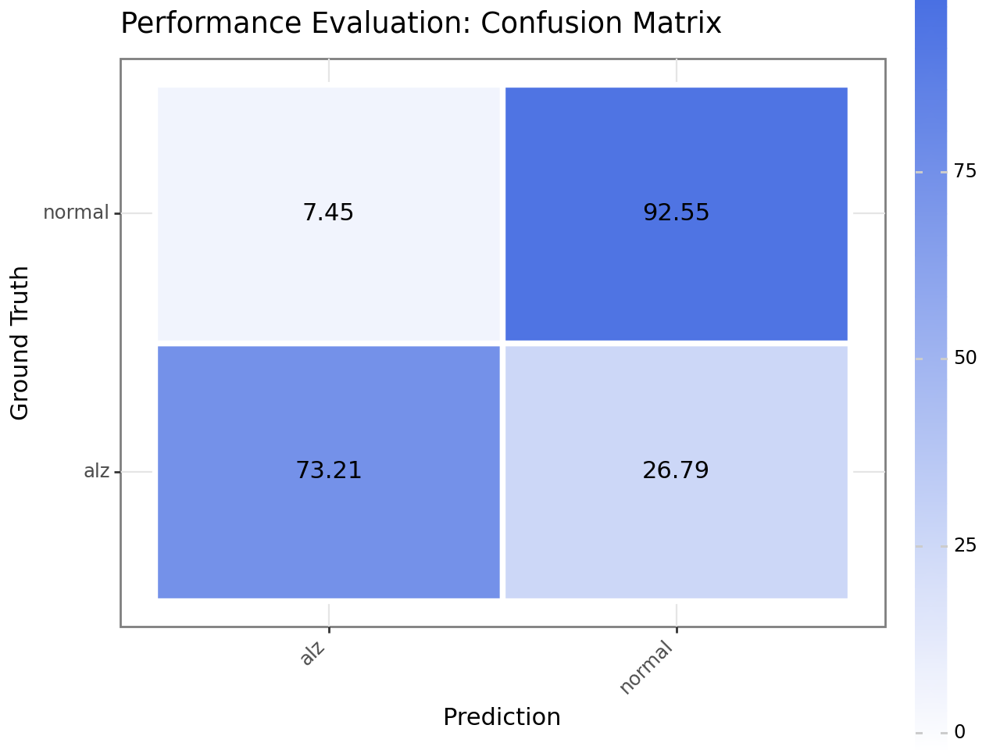

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv05/plot.performance.roc.png


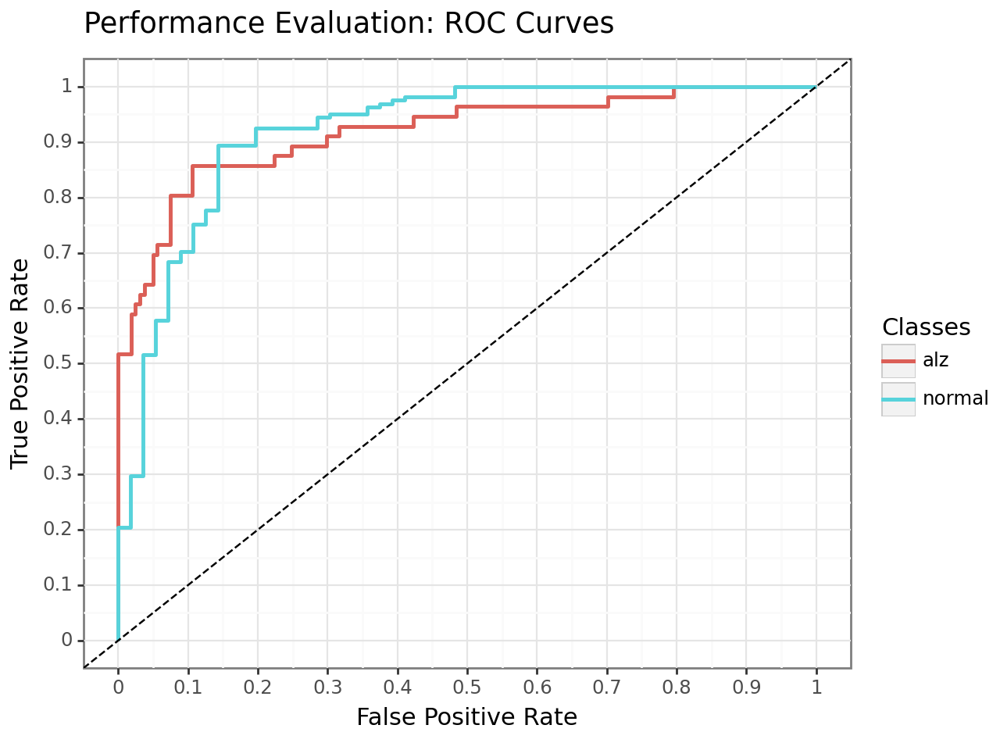


AUC for MCI vs. CN = 0.789
Acc for MCI vs. CN = 79.3


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

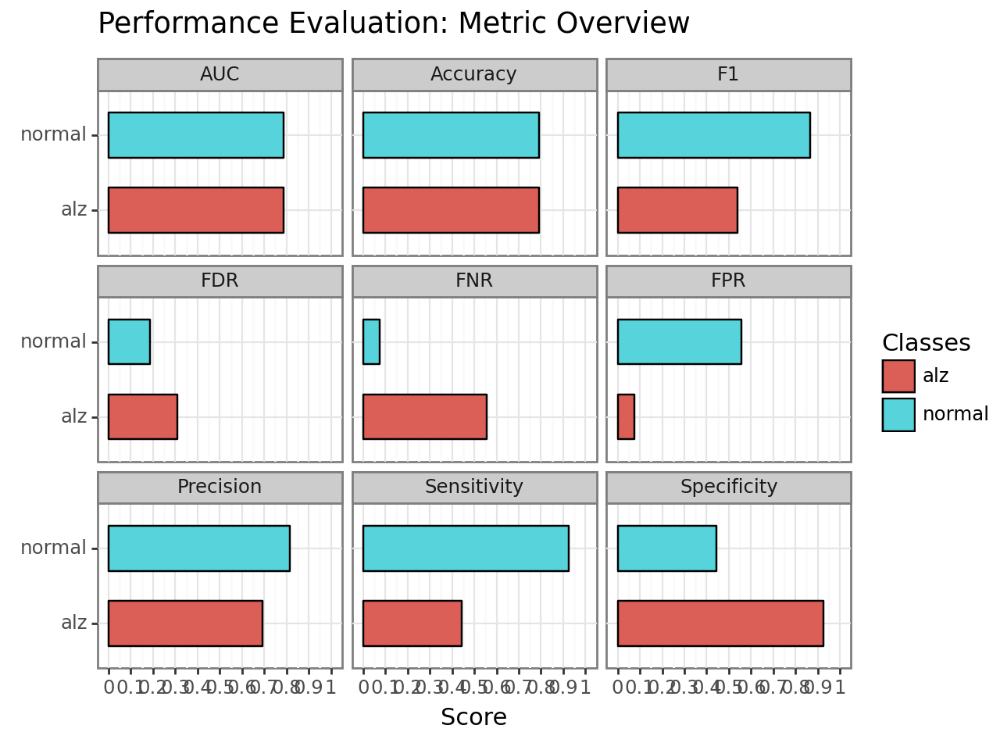

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv05/plot.performance.confusion_matrix.png


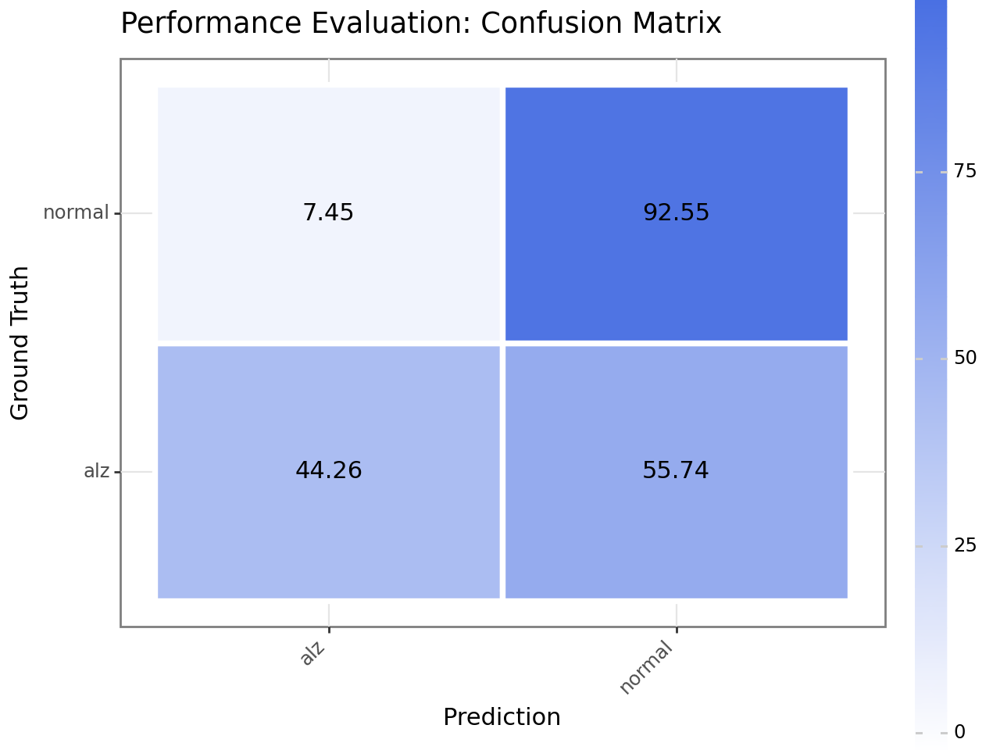

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv05/plot.performance.roc.png


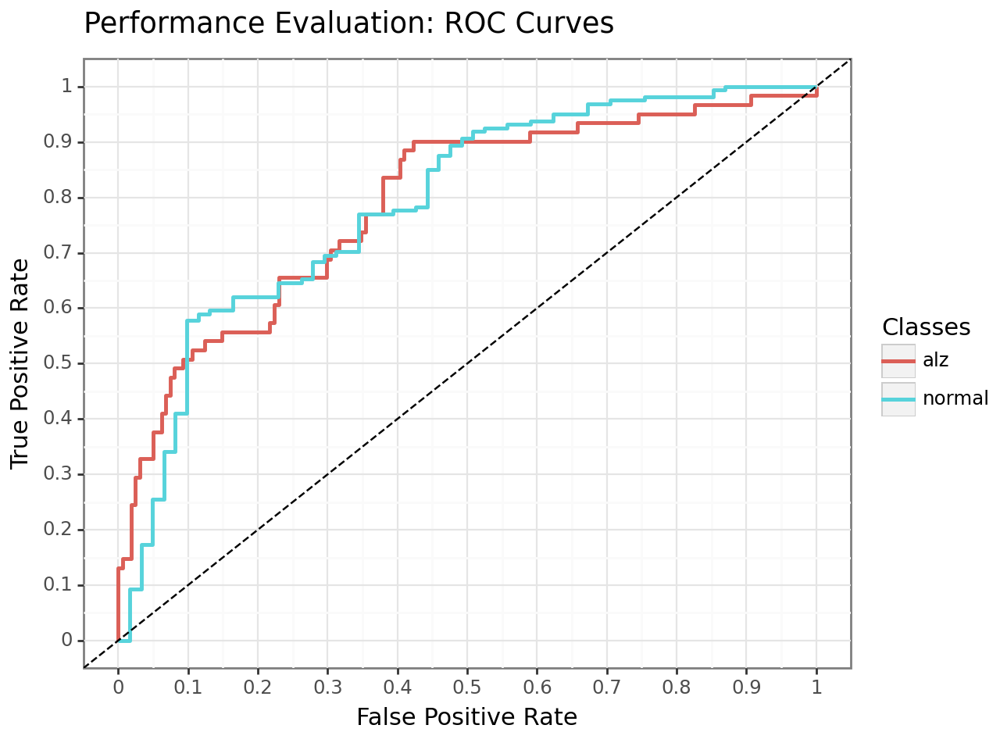

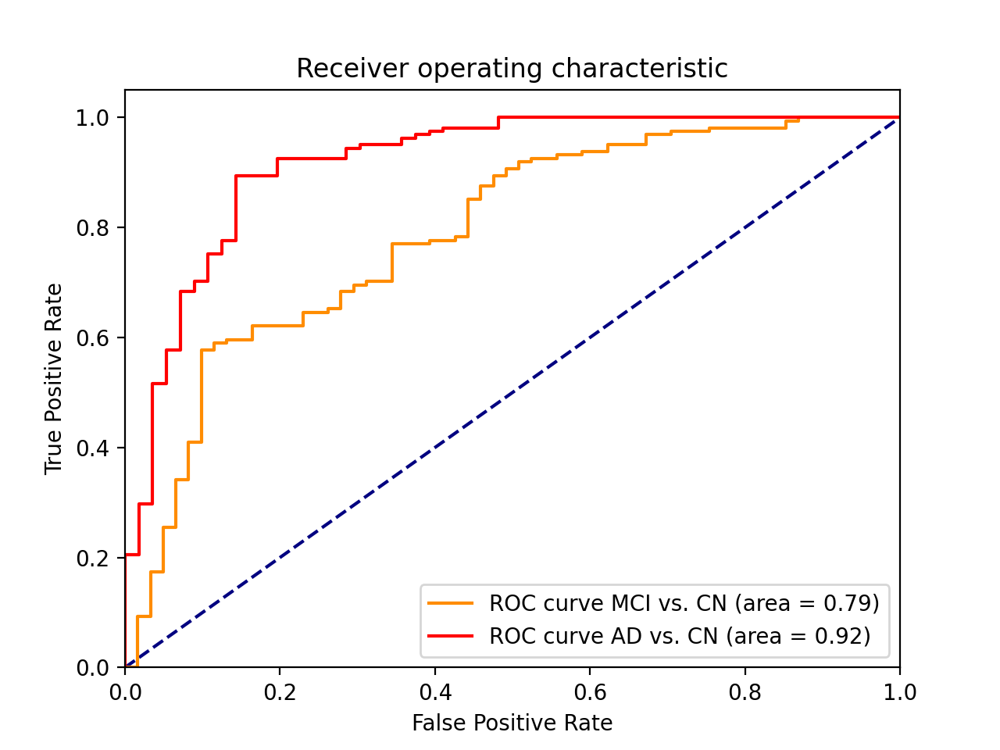

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:50:55.782777: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:50:55.783062: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:50:55.783180: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.931
Acc for AD vs. CN = 90.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

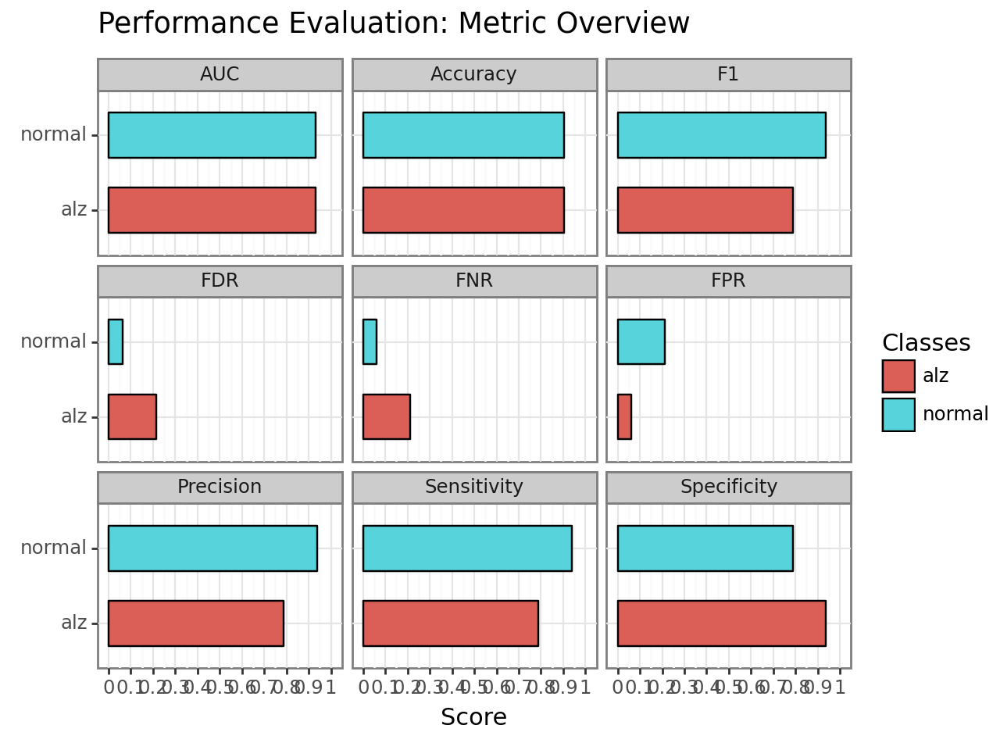

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv06/plot.performance.confusion_matrix.png


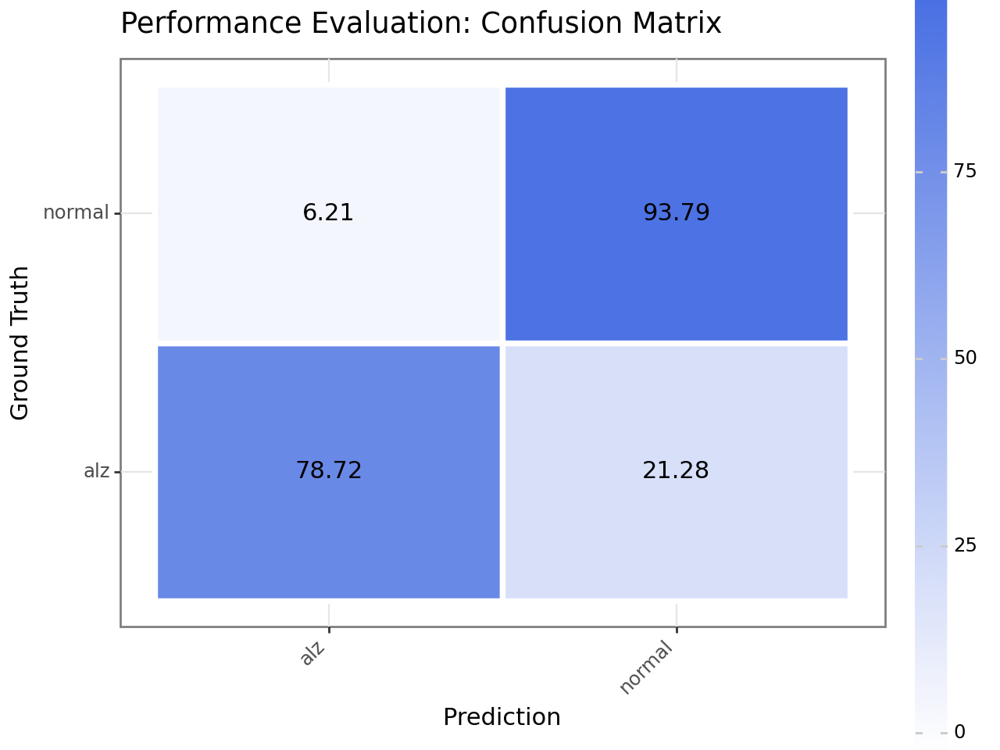

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv06/plot.performance.roc.png


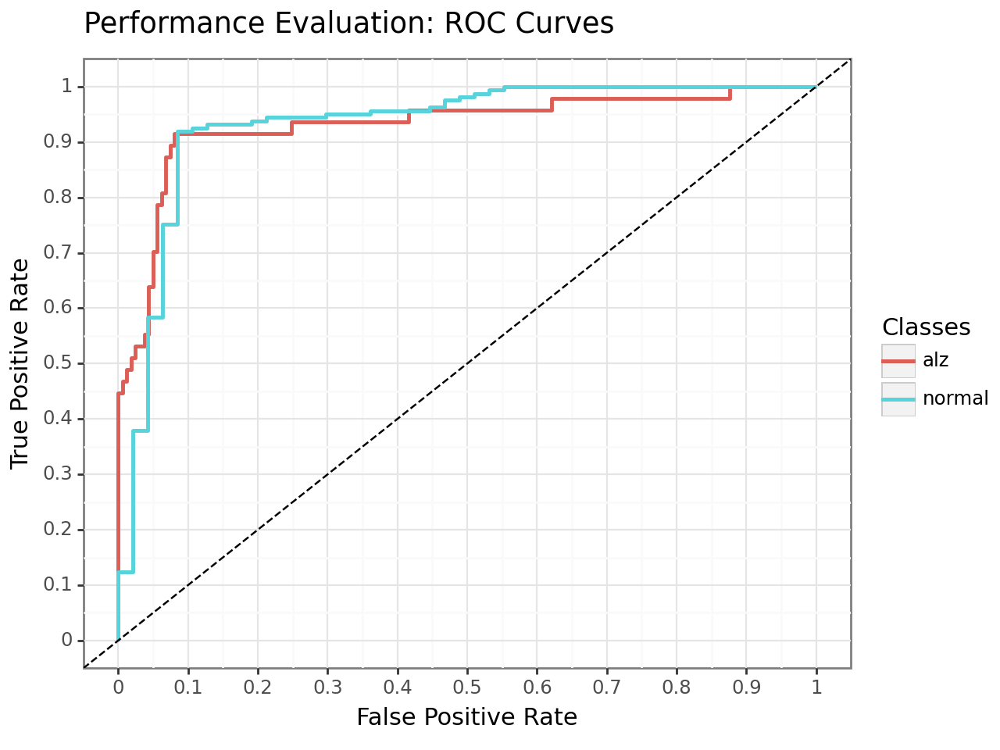


AUC for MCI vs. CN = 0.845
Acc for MCI vs. CN = 80.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

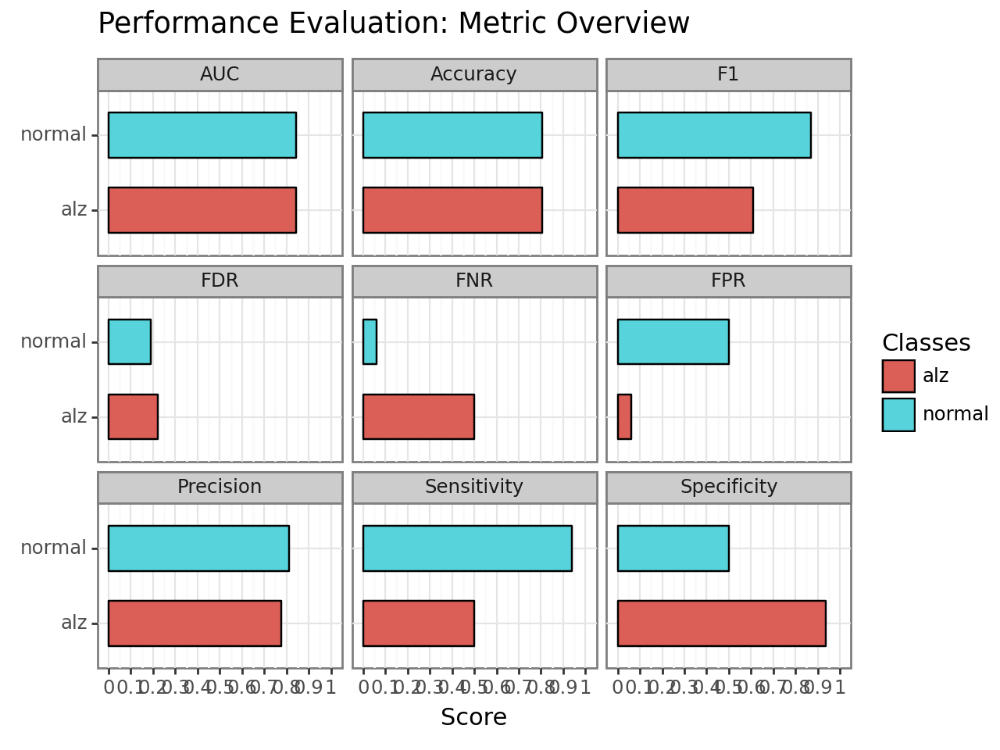

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv06/plot.performance.confusion_matrix.png


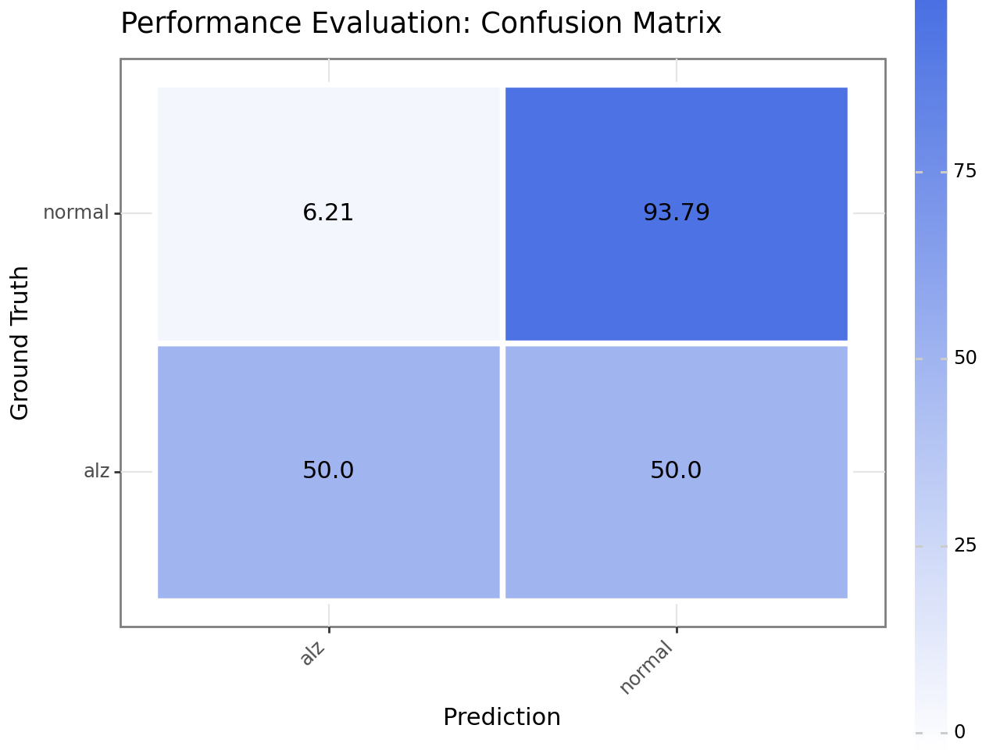

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv06/plot.performance.roc.png


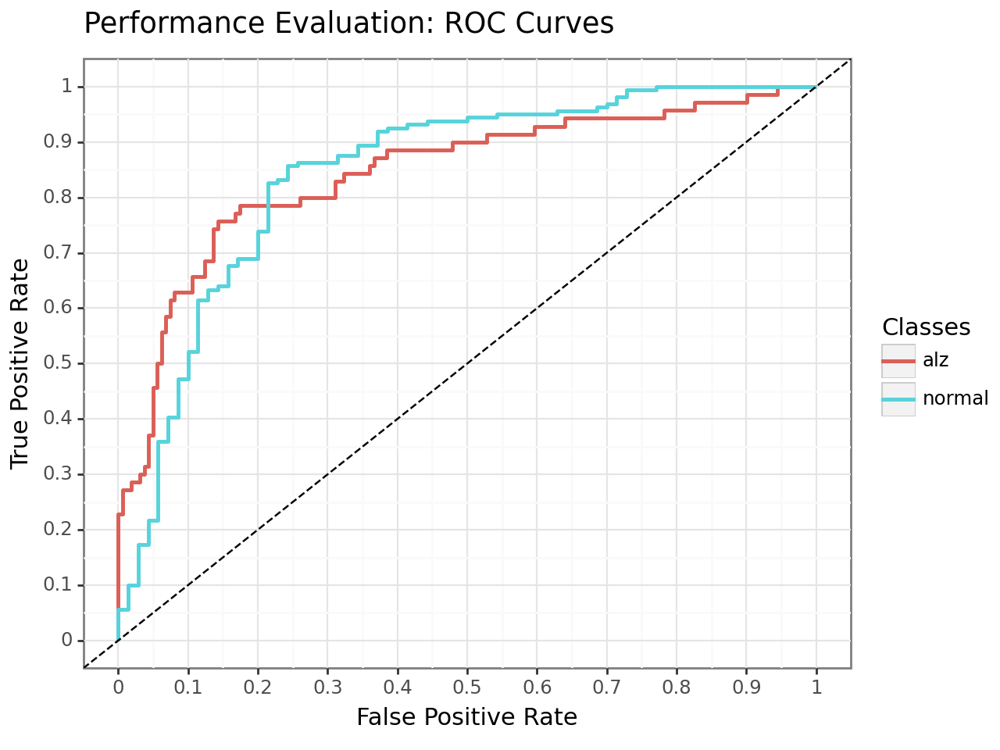

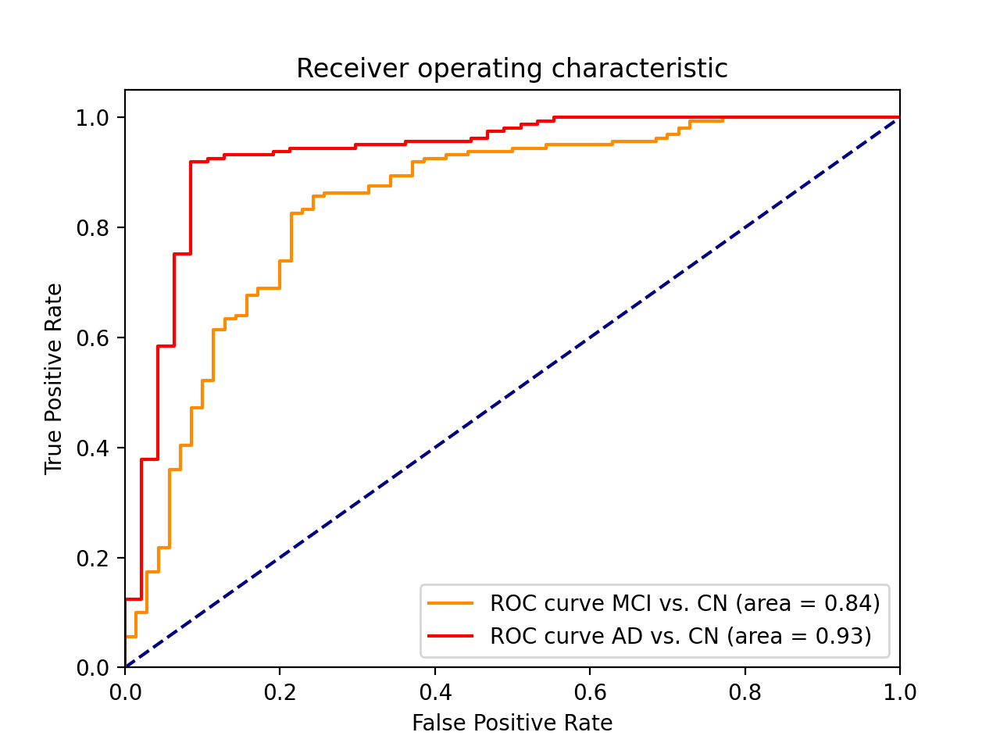

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:52:17.975024: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:52:17.975296: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:52:17.975410: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.963
Acc for AD vs. CN = 86.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

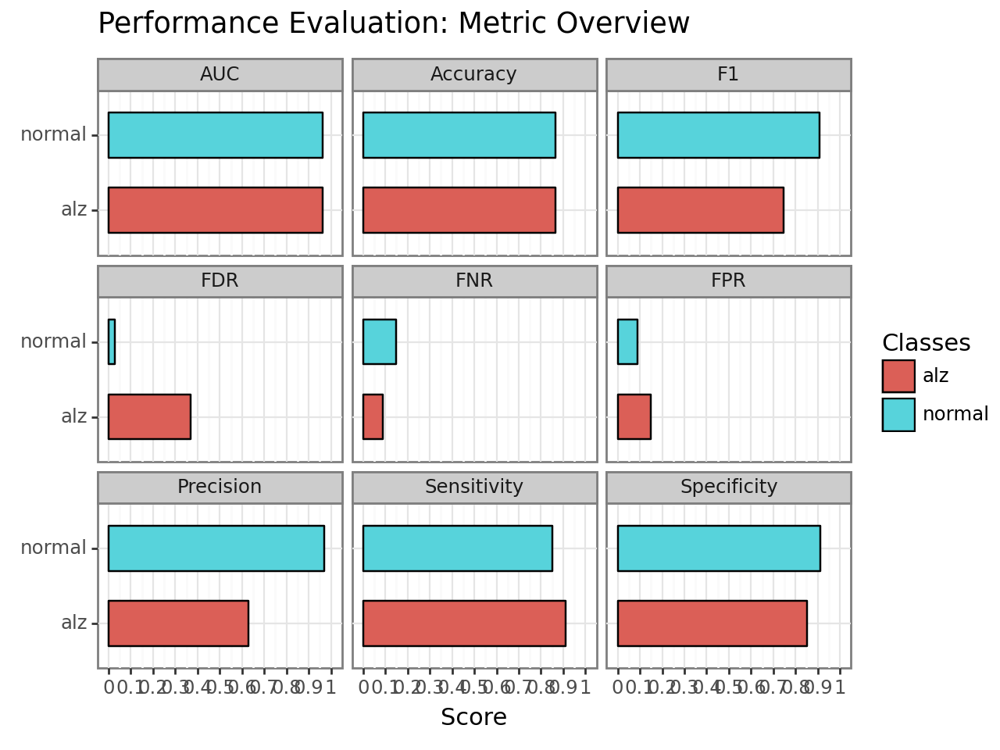

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv07/plot.performance.confusion_matrix.png


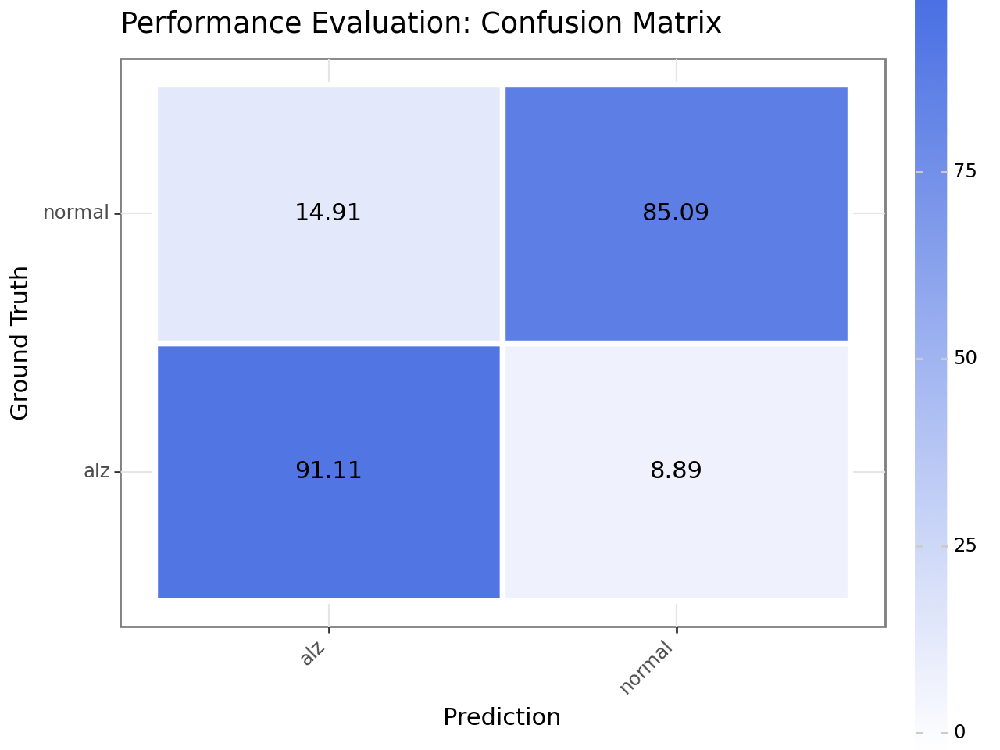

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv07/plot.performance.roc.png


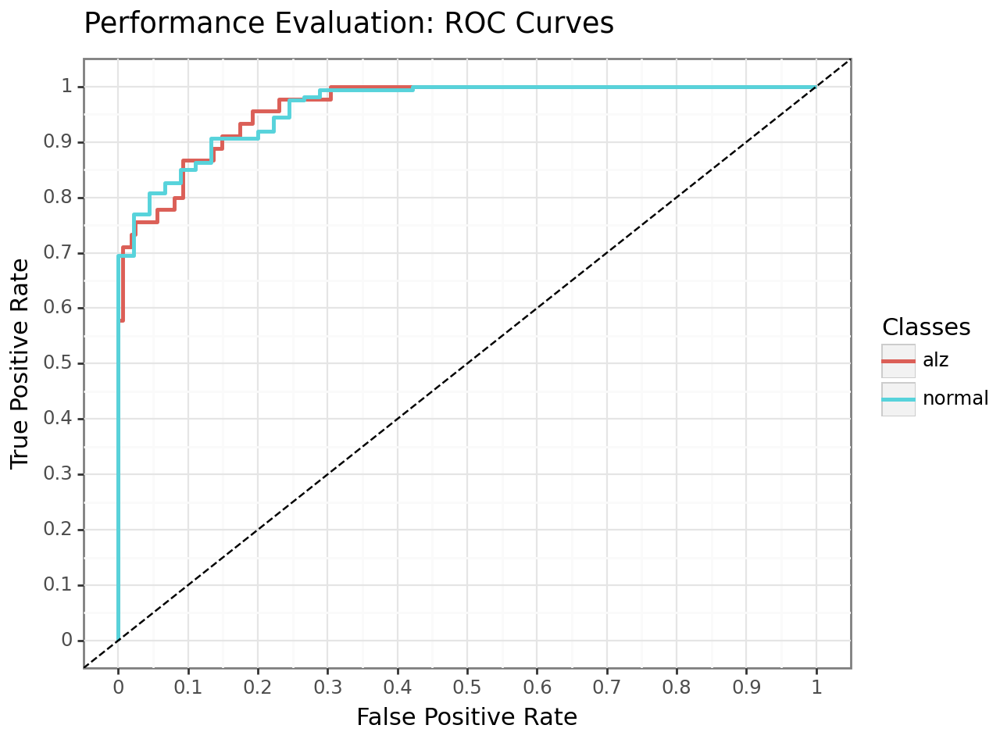


AUC for MCI vs. CN = 0.770
Acc for MCI vs. CN = 78.1


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

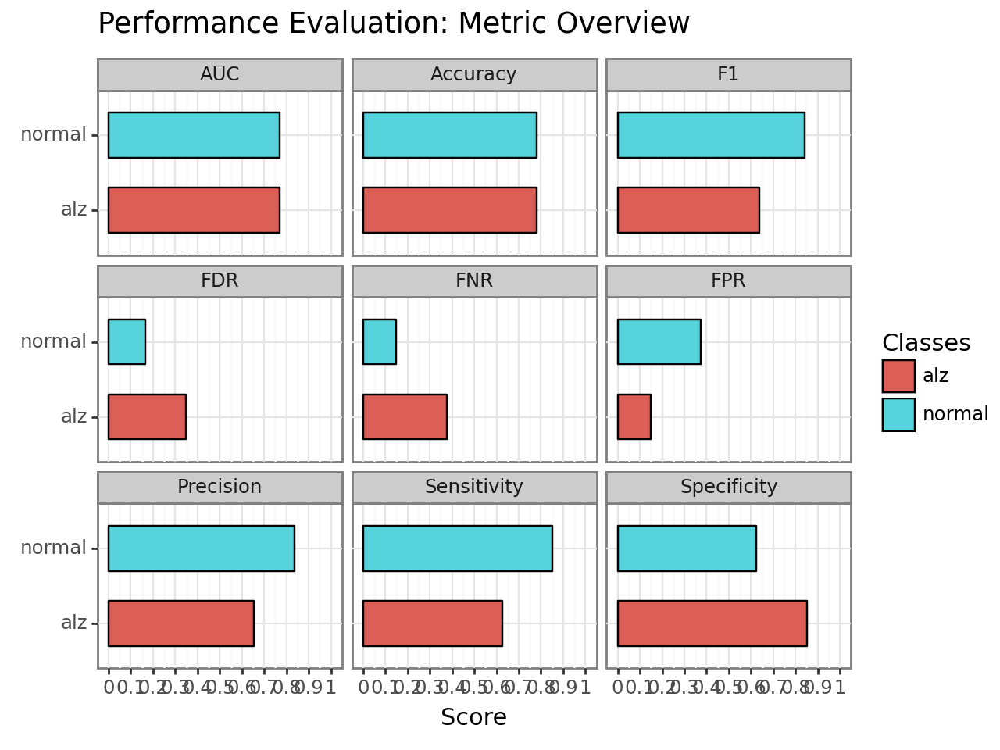

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv07/plot.performance.confusion_matrix.png


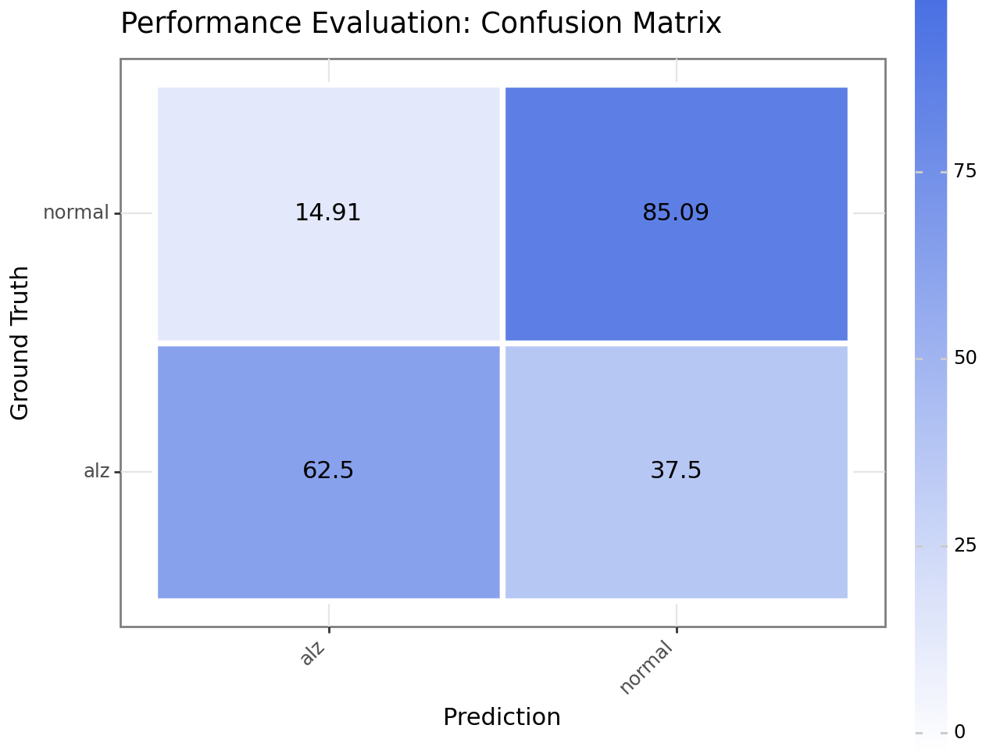

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv07/plot.performance.roc.png


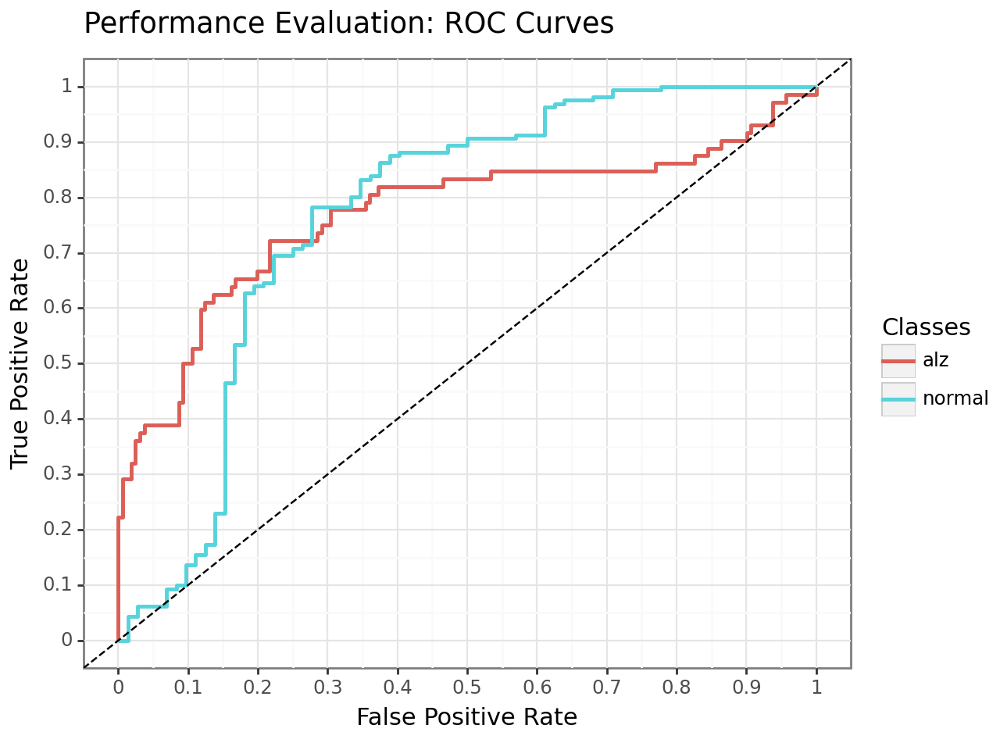

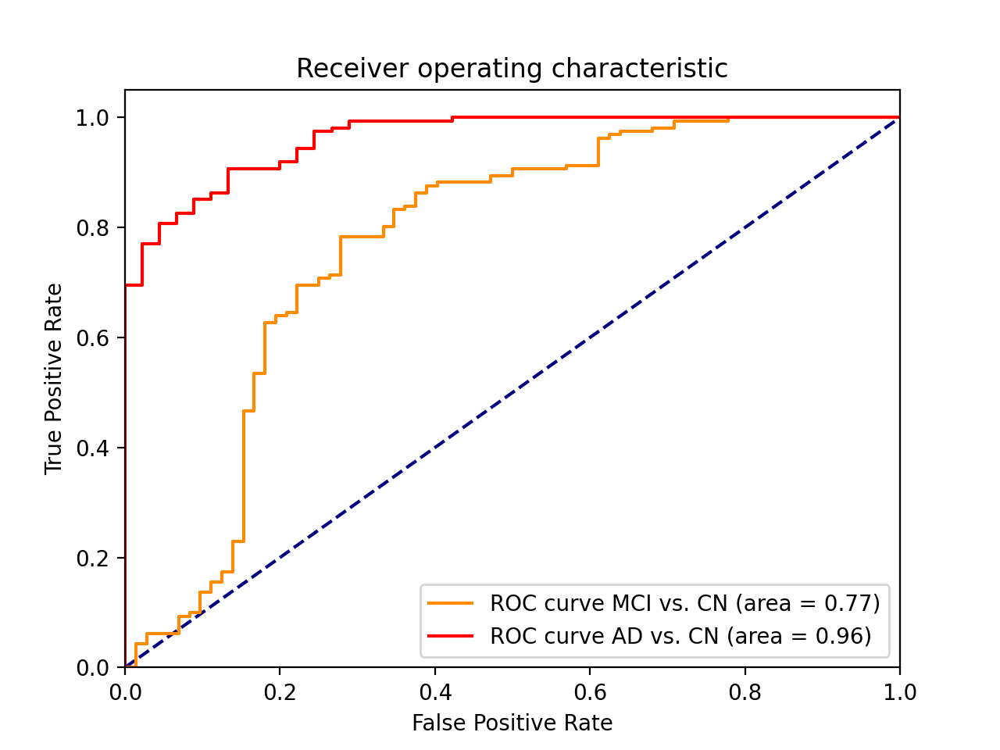

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:53:41.024700: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:53:41.024960: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:53:41.025081: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.975
Acc for AD vs. CN = 88.0


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

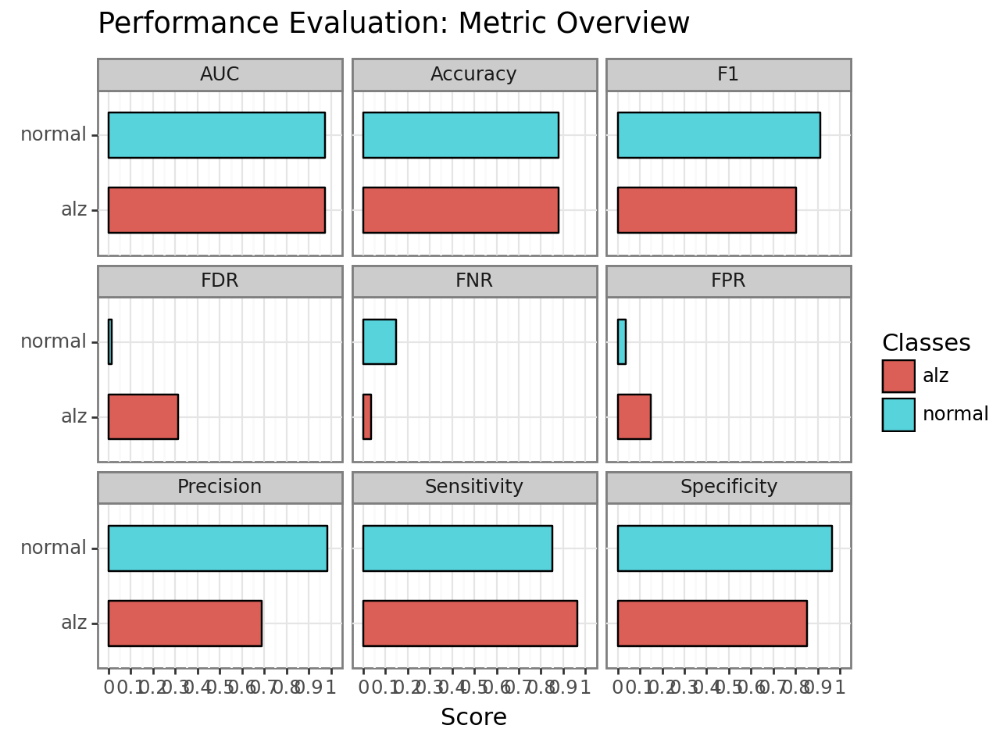

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv08/plot.performance.confusion_matrix.png


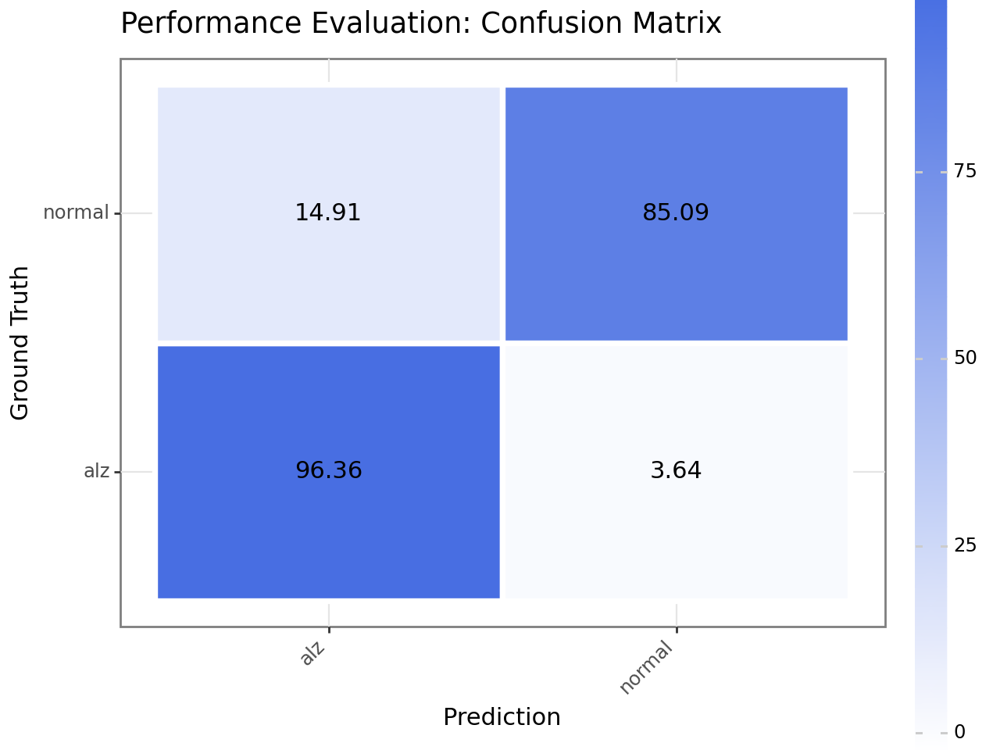

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv08/plot.performance.roc.png


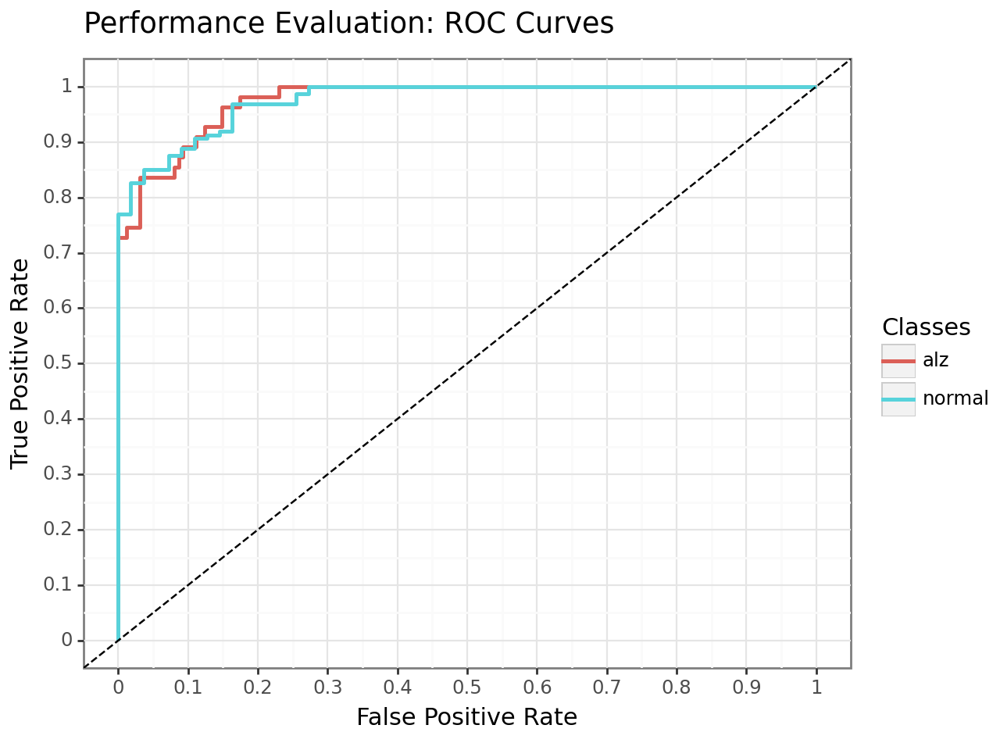


AUC for MCI vs. CN = 0.798
Acc for MCI vs. CN = 79.8


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

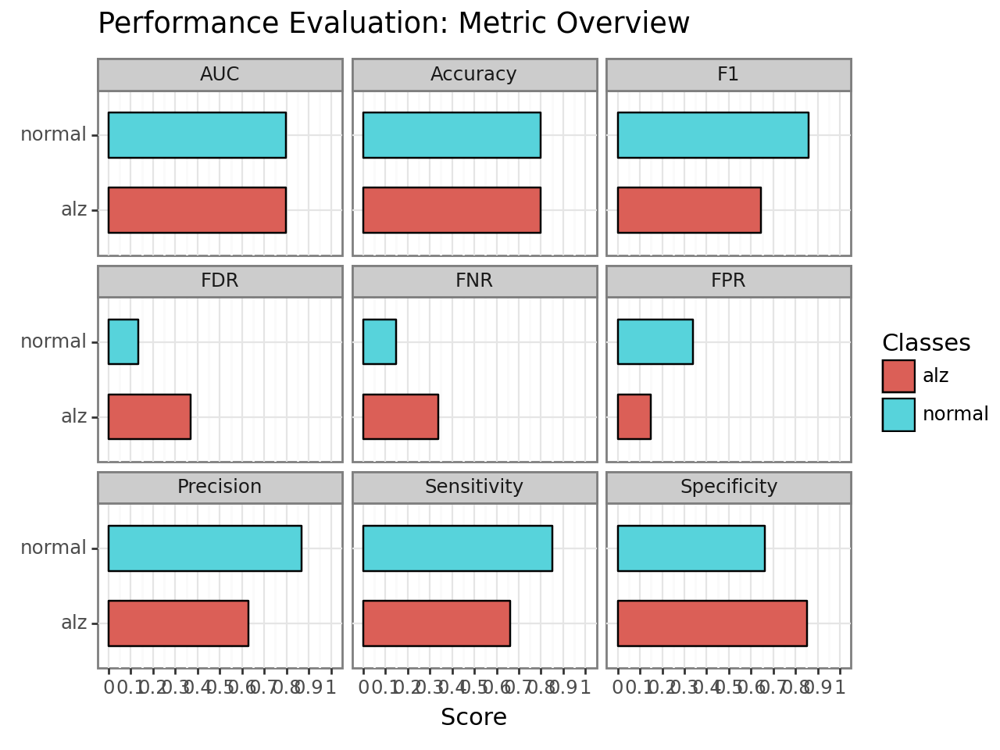

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv08/plot.performance.confusion_matrix.png


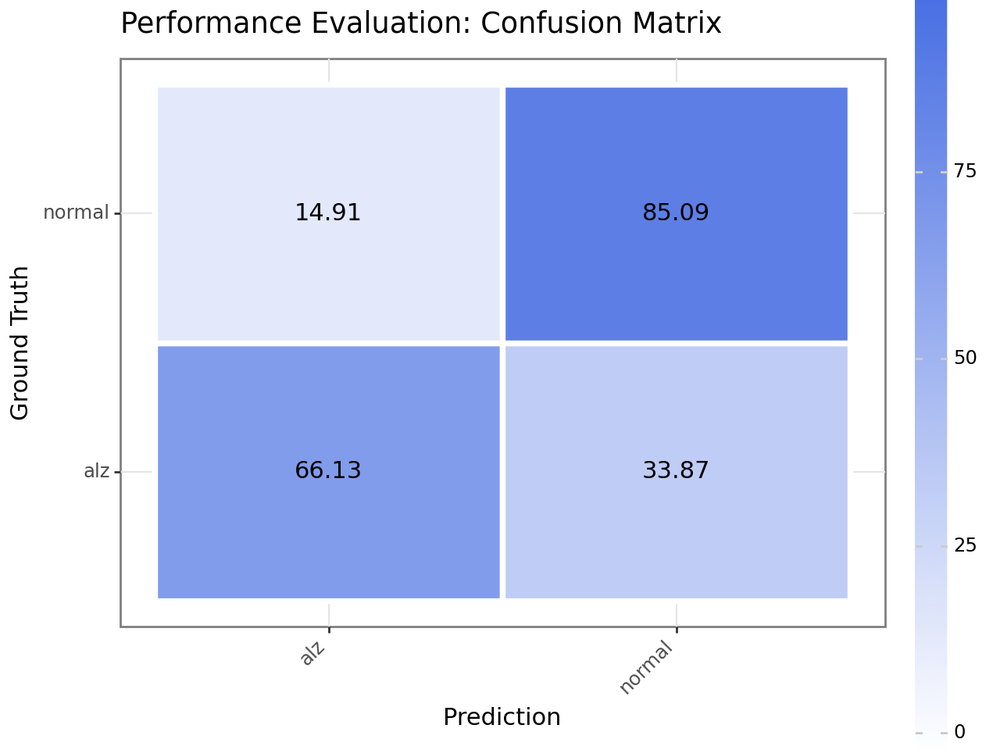

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv08/plot.performance.roc.png


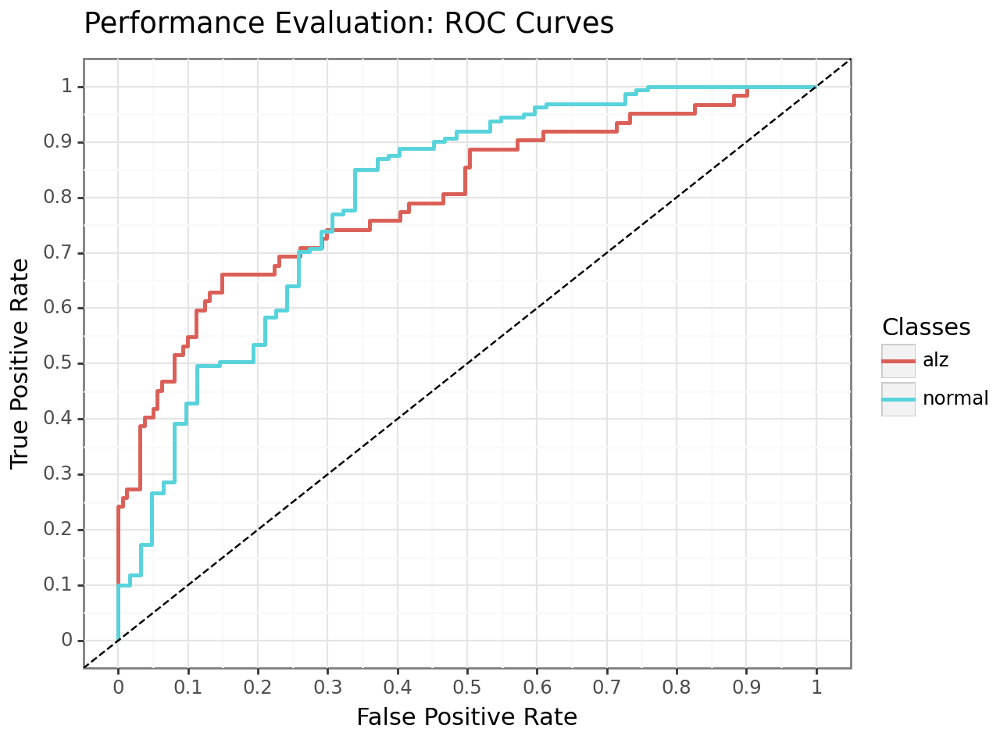

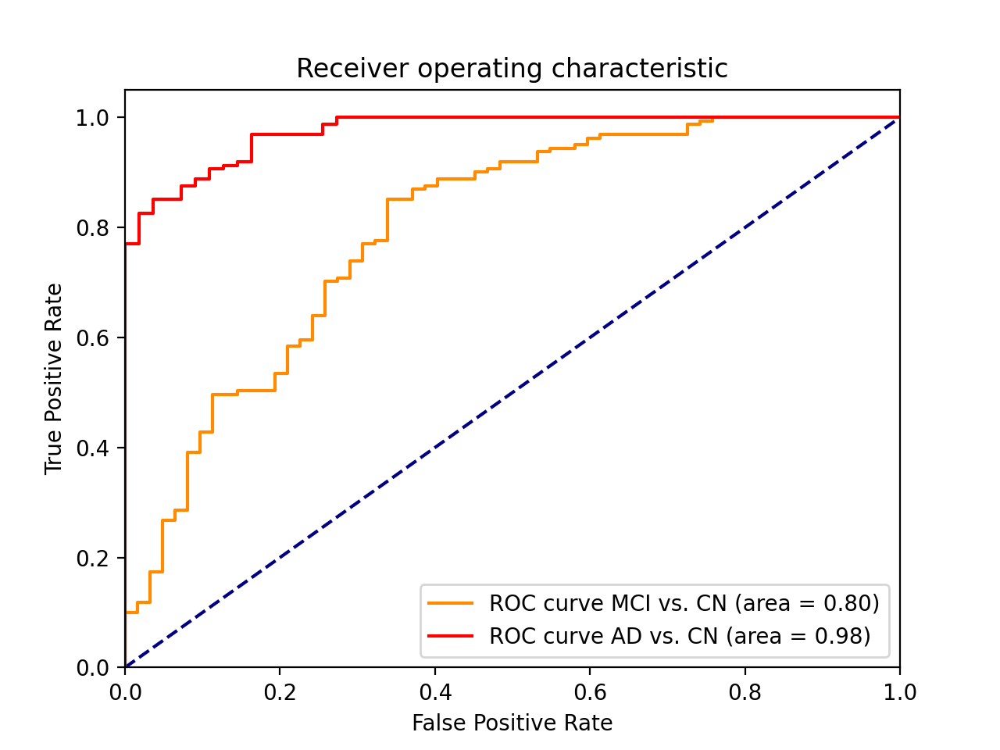

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:55:03.667691: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:55:03.667928: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:55:03.668041: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.926
Acc for AD vs. CN = 89.9


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

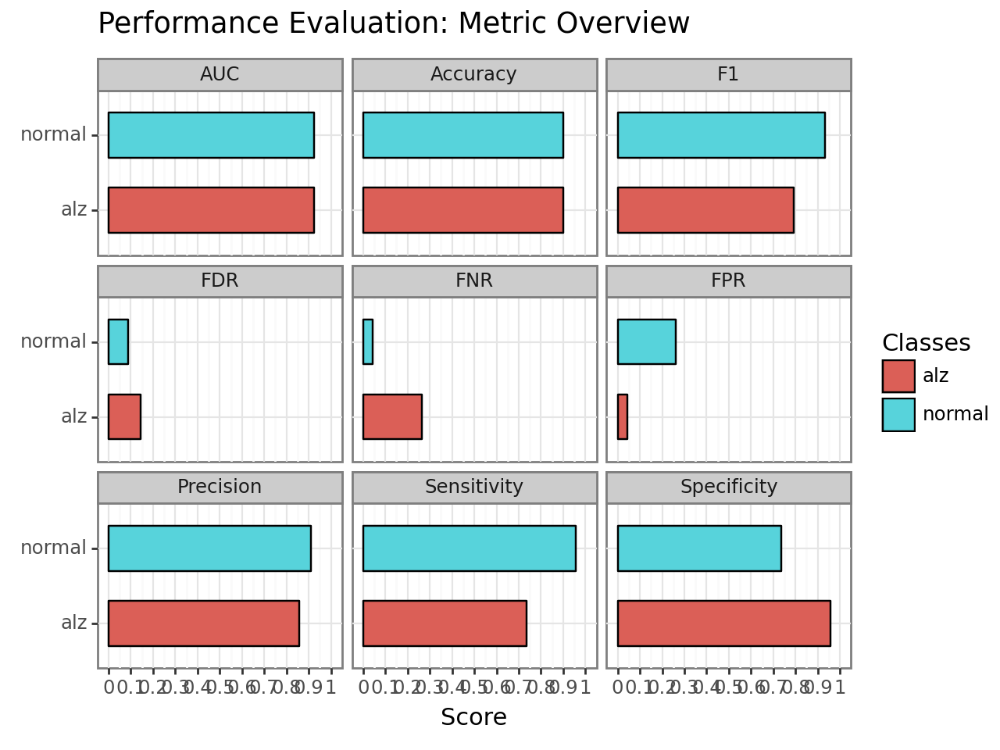

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv09/plot.performance.confusion_matrix.png


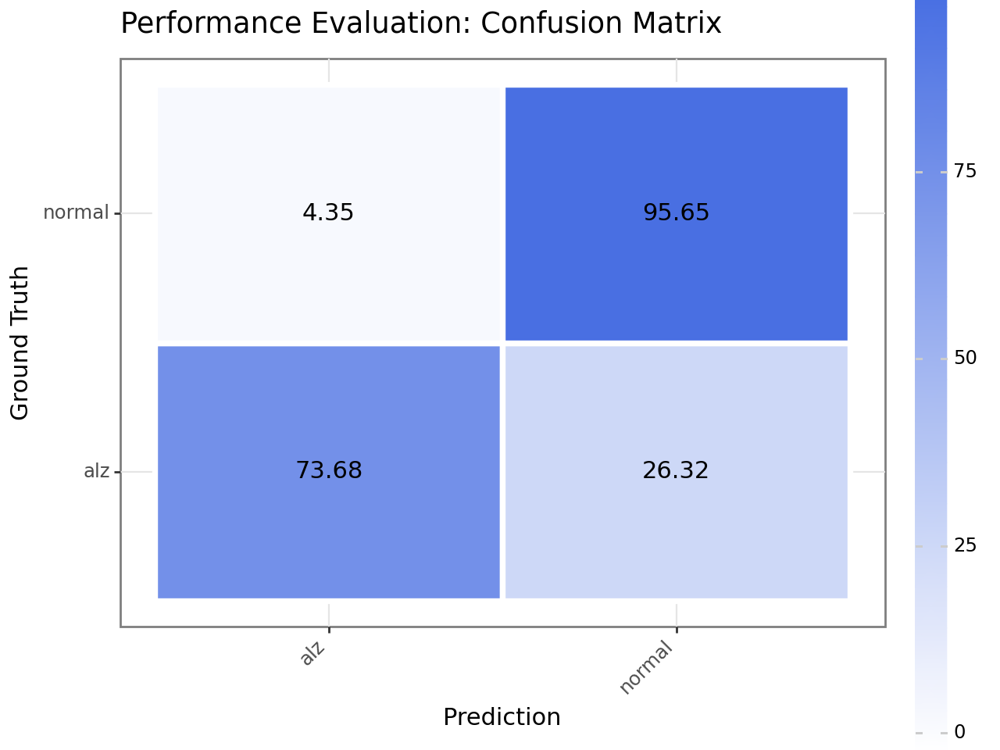

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv09/plot.performance.roc.png


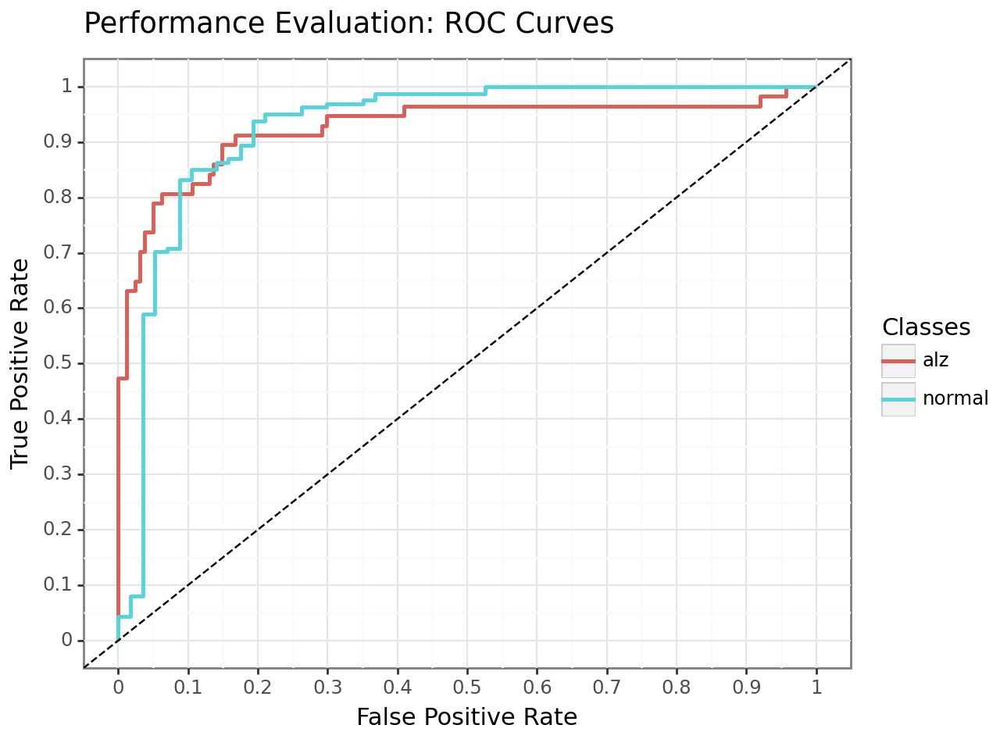


AUC for MCI vs. CN = 0.801
Acc for MCI vs. CN = 80.5


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

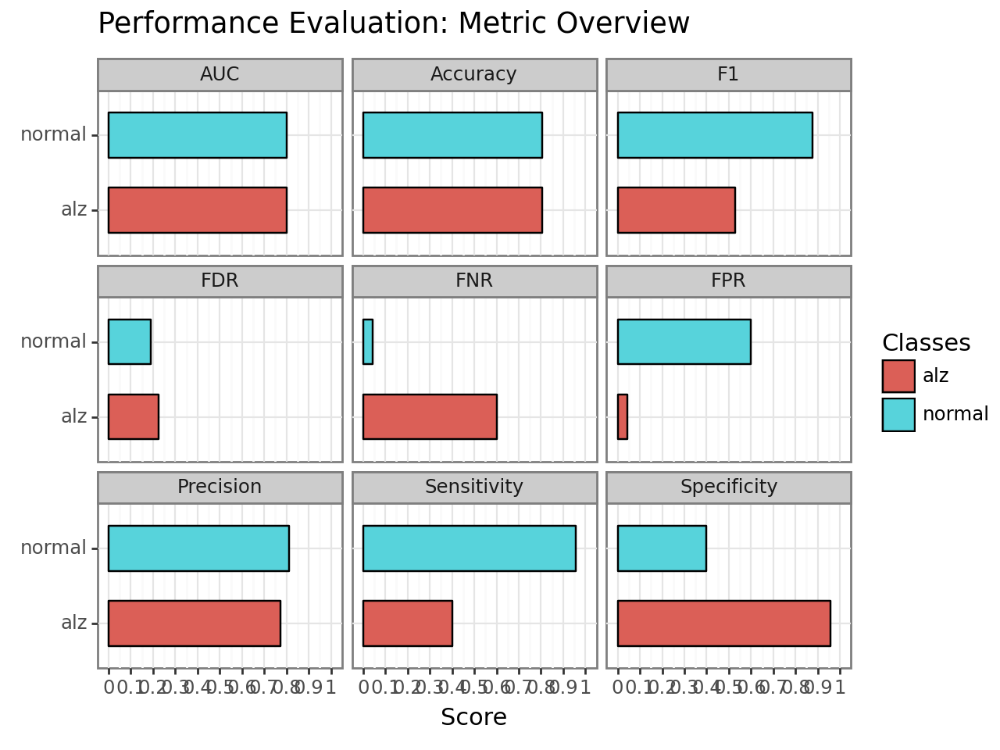

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv09/plot.performance.confusion_matrix.png


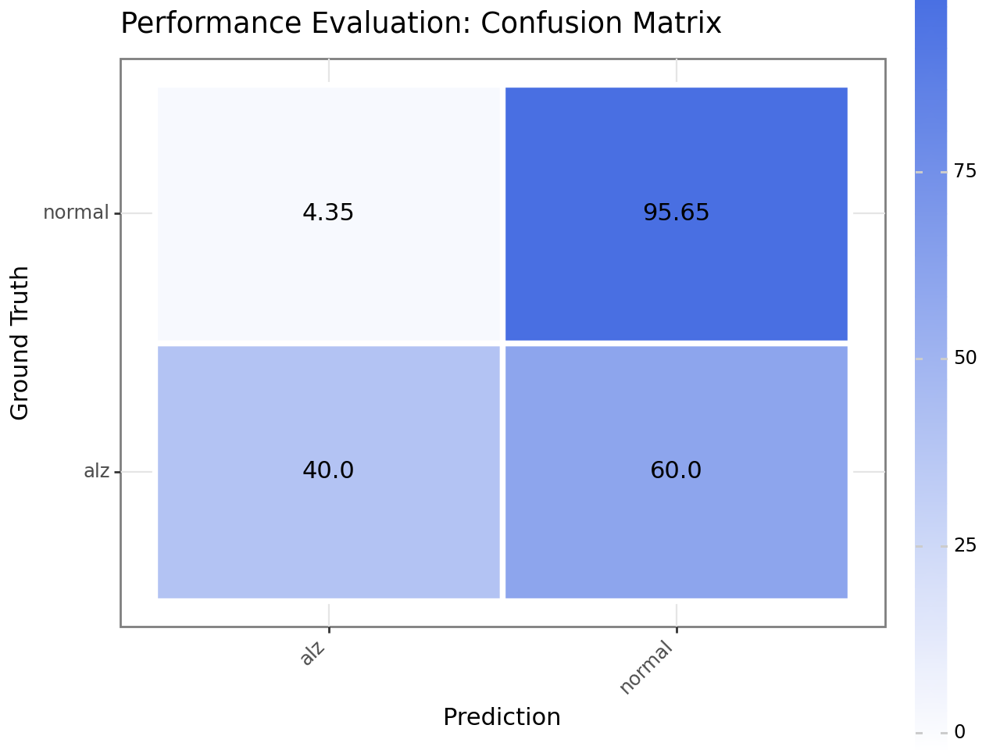

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv09/plot.performance.roc.png


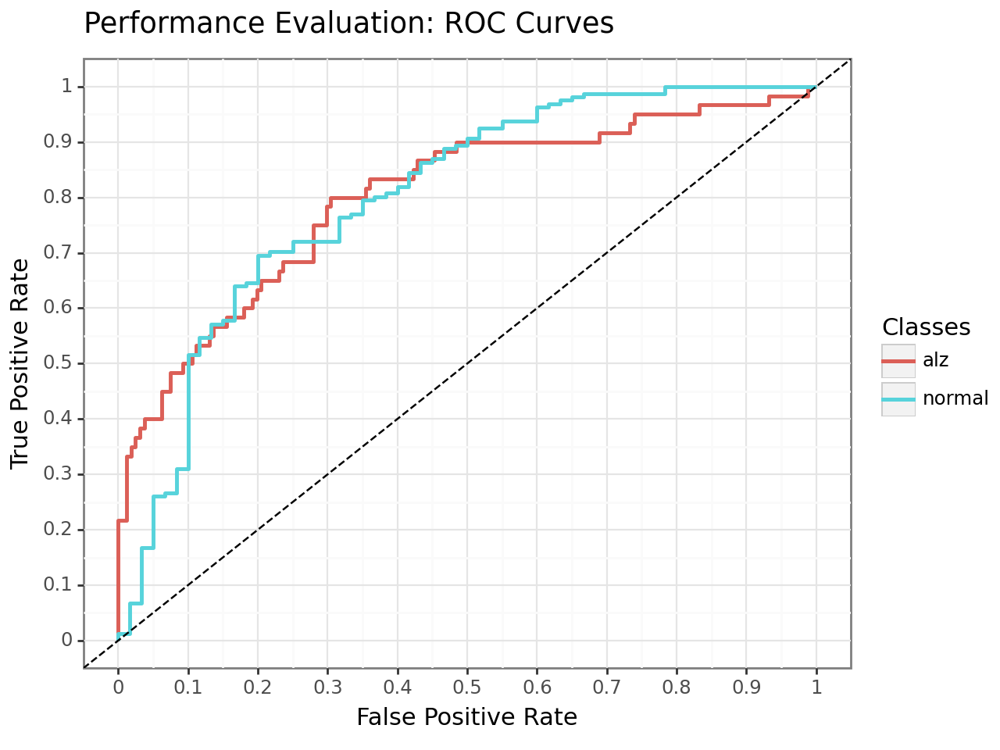

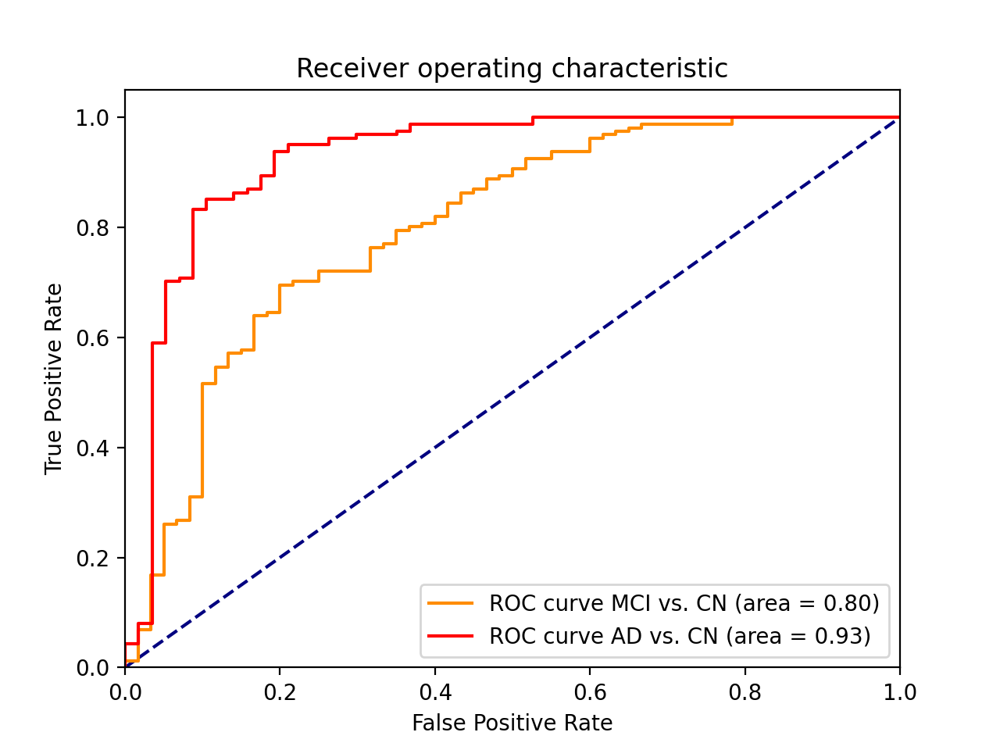

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 193, 229, 193, 1)]   0         []                            
                                                                                                  
 conv3d (Conv3D)             (None, 97, 115, 97, 10)      3440      ['input_1[0][0]']             
                                                                                                  
 max_pooling3d (MaxPooling3  (None, 49, 58, 49, 10)       0         ['conv3d[0][0]']              
 D)                                                                                               
                                                                                                  
 batch_normalization (Batch  (None, 49, 58, 49, 10)       40        ['max_pooling3d[0][0]']   

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/keras/src/optimizers/legacy/adam.py:118: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
2024-06-14 15:56:24.186310: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:56:24.186582: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-06-14 15:56:24.186691: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value

AUC for AD vs. CN = 0.940
Acc for AD vs. CN = 88.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

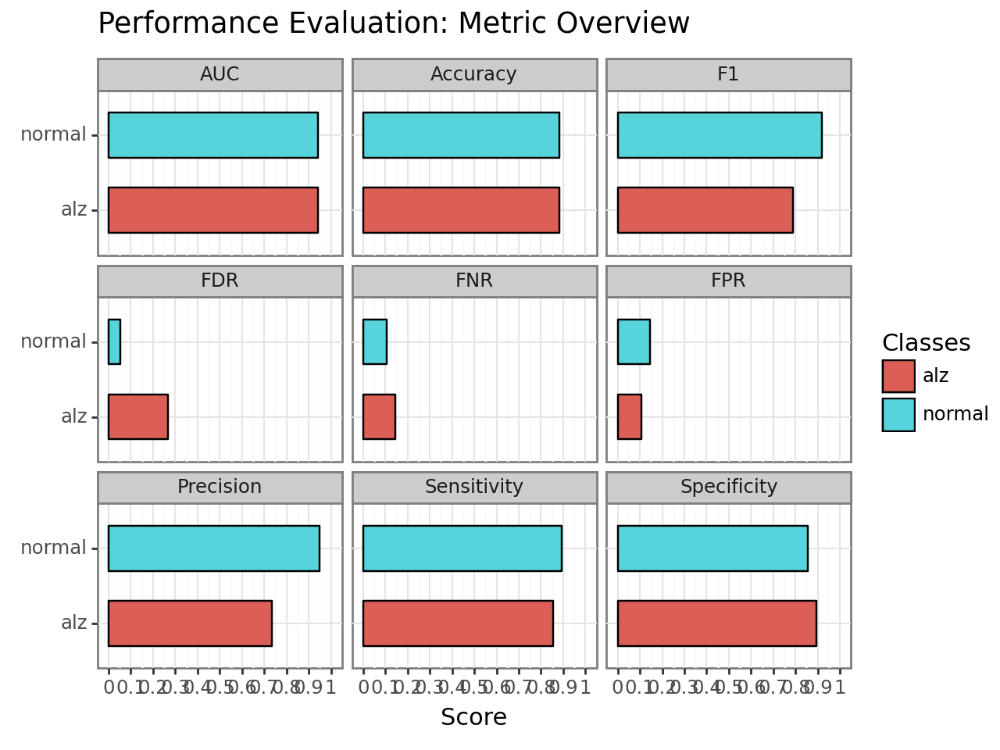

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv10/plot.performance.confusion_matrix.png


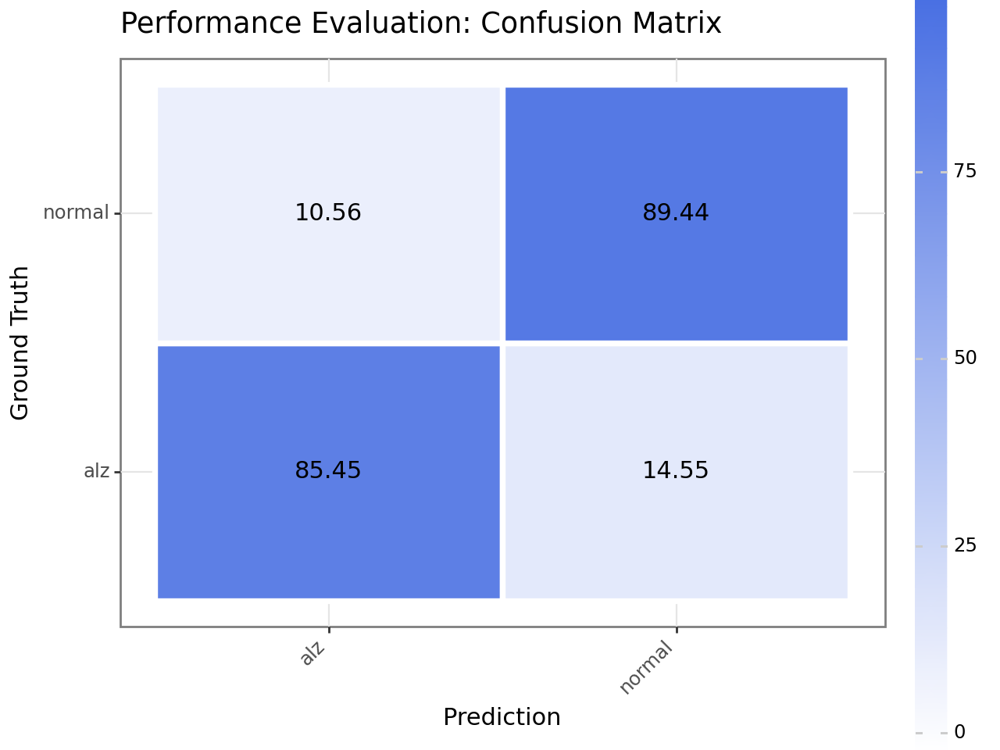

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv10/plot.performance.roc.png


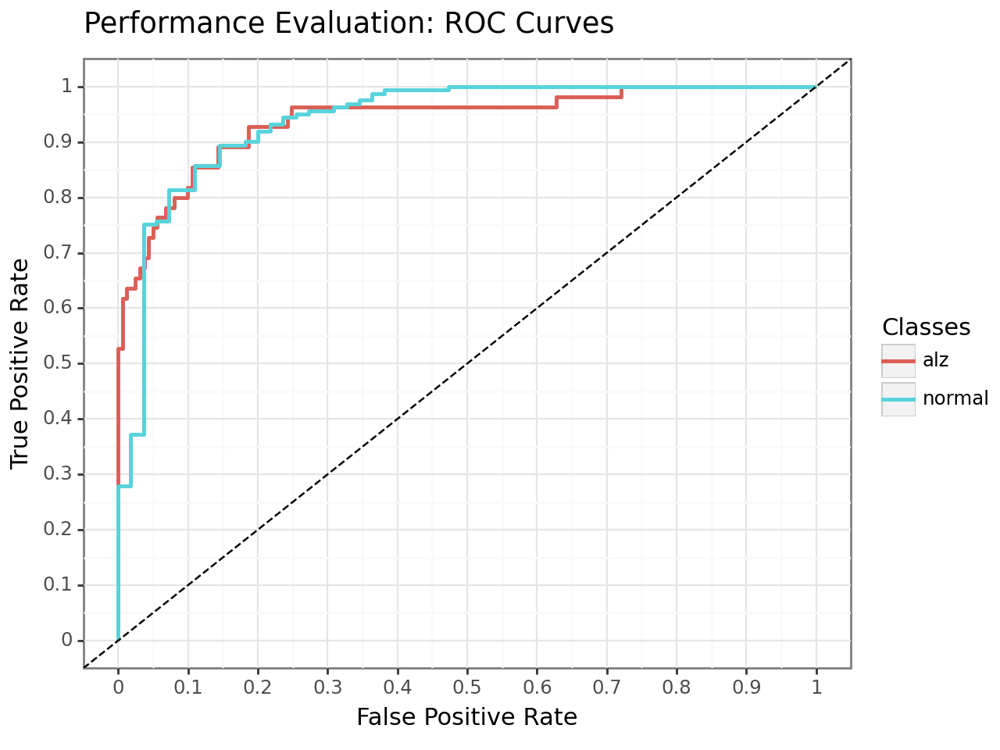


AUC for MCI vs. CN = 0.825
Acc for MCI vs. CN = 79.4


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:135: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/aucmedi/evaluation/performance.py:210: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-c

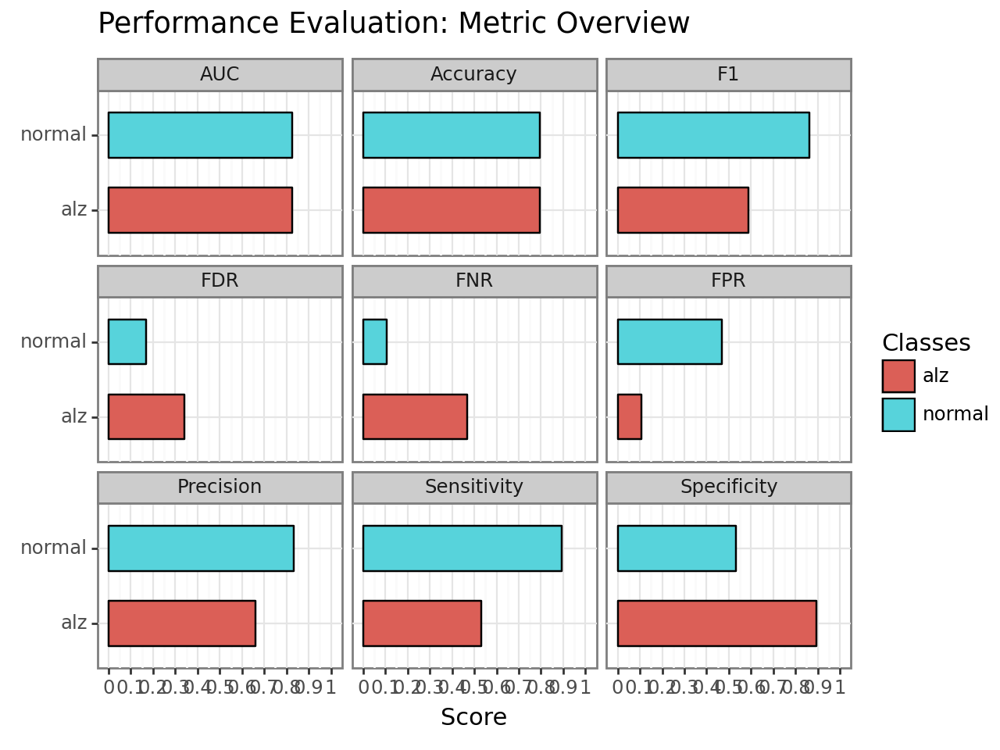

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv10/plot.performance.confusion_matrix.png


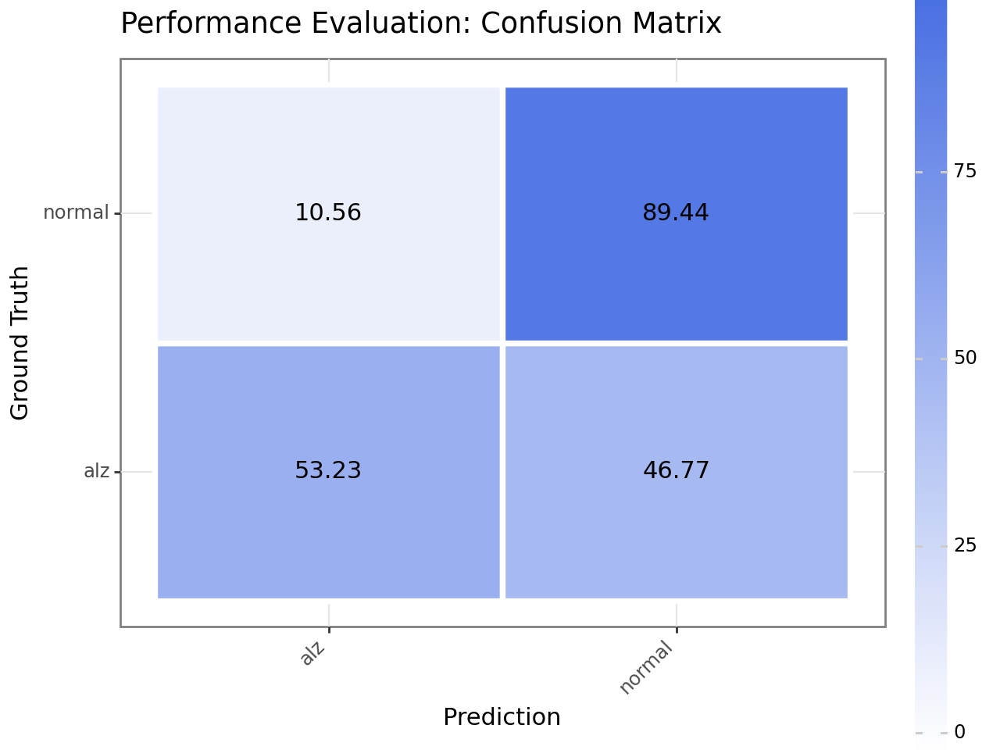

/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:587: PlotnineWarning: Saving 10 x 9 in image.
/home/dyrba/anaconda3/envs/tf2.15/lib/python3.11/site-packages/plotnine/ggplot.py:588: PlotnineWarning: Filename: /home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv10/plot.performance.roc.png


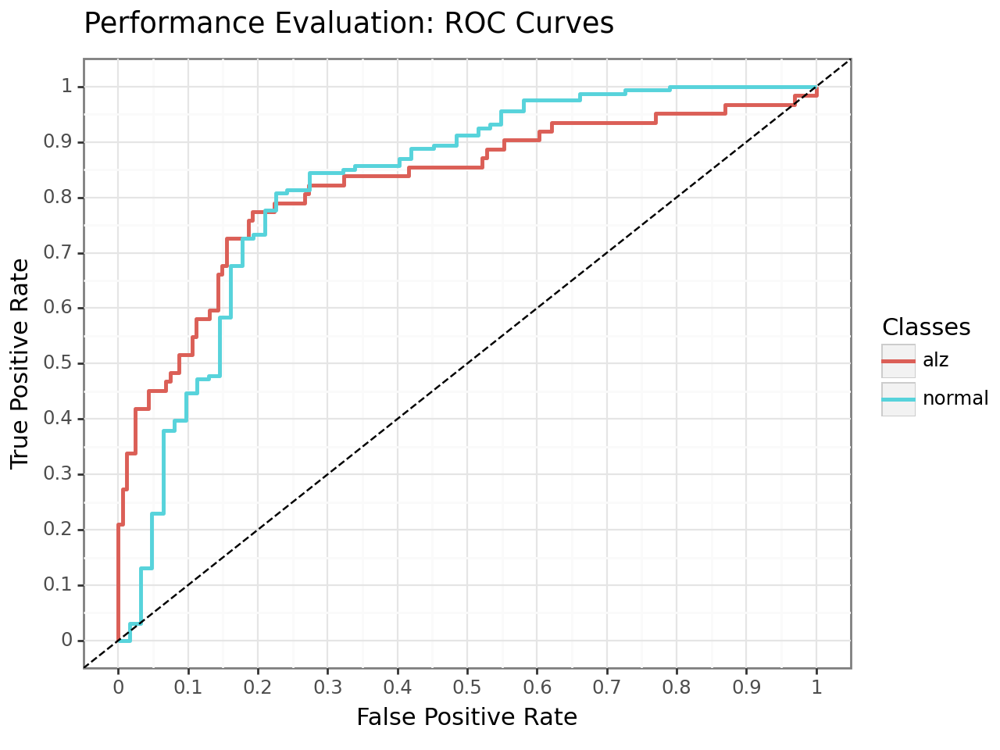

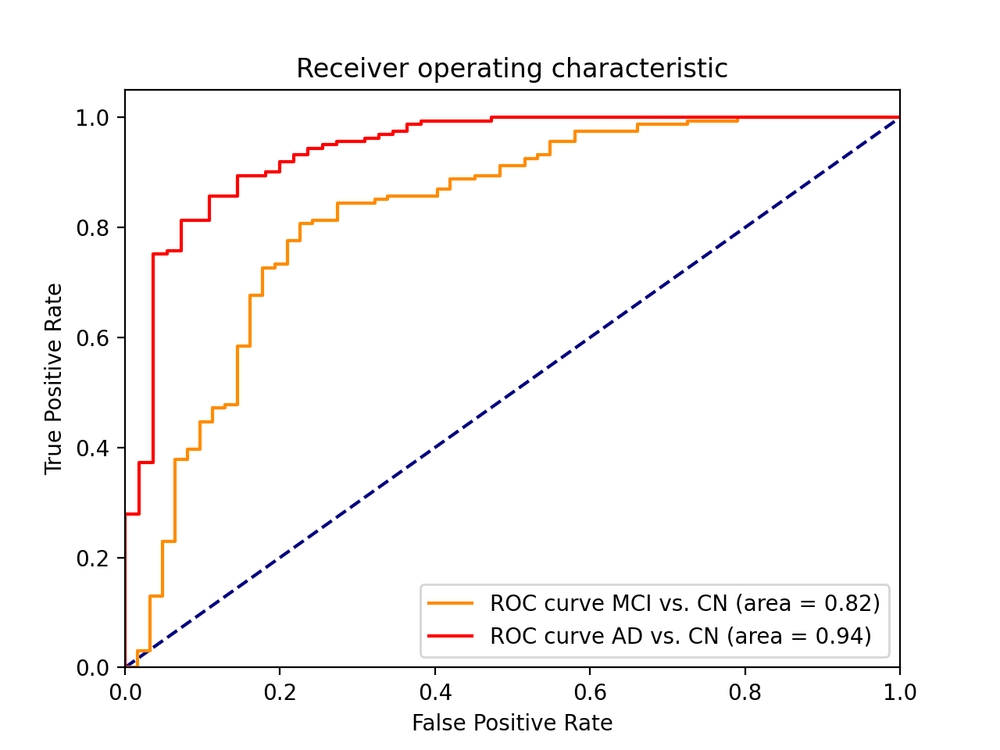

In [14]:
from sklearn.model_selection import cross_validate
from sklearn.model_selection import train_test_split
from aucmedi import *
import csv
import random
import pandas as pd
import numpy as np
import re
from aucmedi.sampling.split import sampling_split
from sklearn.metrics import confusion_matrix


# Define the evaluation metrics to compute 
acc_AD, acc_MCI, auc_AD, auc_MCI = [], [], [], []



n_splits = 10
learning_rate = 0.0001
num_epochs = 50
splits = [0.8, 0.1, 0.1]
seed = 123

for k in range(n_splits):
    # clear any existing global keras state (=GPU memory) and start with blank initialization
    keras.backend.clear_session()

    from tensorflow.keras.callbacks import ModelCheckpoint

    #"/mnt/data_dzne_archiv2/Studien/Deep_Learning_Visualization/temporary_stuff/Jaya Chandra Terli/aucmedi_setup"
    # model_history = os.path.join('assets', 'model.h5')

    model_checkpoint = ModelCheckpoint(
        filepath=("model_checkpoint/ADMCIvsCN_ohneEMCIAD3_epoch_cv{:02d}.h5".format(k+1)),
        monitor='val_accuracy',
        mode='auto',
        save_best_only=True
    )
    
    set_train, set_val, set_test = sampling_split(
        samples=nifti_images, # list of sample names
        labels=labelsbin, # list of corresponding labels
        metadata=meta_grp, # metadata as numpy array        
        sampling=splits, # percentage splits
        stratified=True, # Allow overlaps between sets
        iterative=False, # Approximation of a solution is only useful for multi label problems
        seed= seed+k 
    )

    from aucmedi.utils.class_weights import compute_multilabel_weights, compute_class_weights
    is_multilabel = False
    if is_multilabel:
        class_weights = compute_multilabel_weights(set_train[1])
    else:
        class_weights = compute_class_weights(set_train[1])

    from aucmedi.data_processing import augmentation

    # activate flip and scale usgmentation
    data_aug = augmentation.VolumeAugmentation(flip=True, rotate=False, brightness=False, contrast=False,
                    saturation=False, hue=False, scale=True, crop=False,
                    grid_distortion=False, compression=False, gaussian_noise=False,
                    gaussian_blur=False, downscaling=False, gamma=False,
                    elastic_transform=False)
    
    from aucmedi.data_processing import data_generator
    from aucmedi.data_processing.io_loader.sitk_loader import sitk_loader

    gen_train = data_generator.DataGenerator(
        samples=set_train[0],
        labels=set_train[1],
        metadata=set_train[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=data_aug, # set 'None' to disable augmentations
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed=seed+k
    )
    from aucmedi.data_processing.io_loader.sitk_loader import sitk_loader
    from aucmedi.utils.visualizer import visualize_array
    sample_name = 'AIBL_0112_N4cor_WarpedSegmentationPosteriors2.nii.gz'
    sample_path = '/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone/'
    sample_img = sitk_loader(sample_name, sample_path)
    

    # validation generator without augmentation
    gen_val = data_generator.DataGenerator(
        samples=set_val[0],
        labels=set_val[1],
        metadata=set_val[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=None, # set 'None' to disable augmenations
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed= seed+k
    )
    
    x, y, z = 193, 229, 193
    numfiles = len(nifti_images)
    input_shape = (numfiles, x, y, z, 1)
    model = DenseNet(input_shape[1:], labelsbin.shape[1])
    opt = tf.keras.optimizers.legacy.Adam(lr=learning_rate)
    model.compile(loss='categorical_crossentropy', optimizer = opt, metrics=['accuracy'])
    model.summary()
    
    # Create a Test generator                   
    gen_test = data_generator.DataGenerator(
        samples=set_test[0],
        labels=set_test[1],
        metadata=set_test[2],
        path_imagedir='/ssd1/dyrba/xxx_t1linear_N4cor_WarpedSegmentationPosteriors2_allinone', # Path to images
        image_format=None, #subfunctions=[], #image format is read automatically
        loader=sitk_loader, # Loader function for .nii image format files
        batch_size=32,
        workers=8,
        grayscale=True,
        data_aug=None,
        resize=(193,229,193), #full size of nifti image (x,y,z)
        standardize_mode="minmax", #normalization method
        seed=seed+k
    )
    
    #skipped: fit model 
    
    
    with tf.compat.v1.Session() as sess:
        mymodel = load_model("model_checkpoint/ADMCIvsCN_ohneEMCIAD3_epoch_cv{:02d}.h5".format(k+1))
        pred = mymodel.predict(gen_test) 
    
         
    from sklearn.metrics import roc_curve, auc
    from matplotlib import pyplot as plt
    
    # Performance evaluation for the combined study group MCI&AD vs CN
    from aucmedi.evaluation import performance

    # metric = performance.evaluate_performance(
    #     preds=pred,
    #     labels=set_test[1],
    #     out_path="/data_dzne_archiv2/Studien/Deep_Learning_Visualization/temporary_stuff/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/",
    #     class_names=class_names,
    #     show=True,
    #     #multi_label=is_multilabel
    # )
    # metric


    bool_AD_CN = set_test[2][:,0] | set_test[2][:,1]
    bool_MCI_CN = set_test[2][:,2] | set_test[2][:,1]

    set_test_MCI_CN = set_test[1][bool_MCI_CN]   
    pred_MCI_CN = pred[bool_MCI_CN]
    set_test_AD_CN = set_test[1][bool_AD_CN]
    pred_AD_CN = pred[bool_AD_CN]
    # Evaluation metrics for AD vs CN
    
    fpr_AD_CN, tpr_AD_CN, _ = roc_curve(set_test_AD_CN[:, 1], pred_AD_CN[:, 1])
    roc_auc_AD_CN = auc(fpr_AD_CN, tpr_AD_CN)
    acc_AD_CN = np.mean((set_test_AD_CN[:, 1] == np.round(pred_AD_CN[:, 1])).astype(int))*100
    
    print('AUC for AD vs. CN = %0.3f' % roc_auc_AD_CN)
    print('Acc for AD vs. CN = %0.1f' % acc_AD_CN)
    auc_AD.append(roc_auc_AD_CN)
    acc_AD.append(acc_AD_CN)

    performance.evaluate_performance(
        preds=pred_AD_CN,
        labels=set_test_AD_CN,
        out_path="/home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/AD_VS_CN_cv{:02d}".format(k+1),
        class_names=class_names,
        show=True,
        #multi_label=is_multilabel
    )                     
    # Evaluation metrics for MCI vs CN
    
    fpr_MCI_CN, tpr_MCI_CN, _ = roc_curve(set_test_MCI_CN[:, 1], pred_MCI_CN[:, 1])
    roc_auc_MCI_CN = auc(fpr_MCI_CN, tpr_MCI_CN)
    acc_MCI_CN = np.mean((set_test_MCI_CN[:, 1] == np.round(pred_MCI_CN[:, 1])).astype(int))*100

        
    print('AUC for MCI vs. CN = %0.3f' % roc_auc_MCI_CN)
    print('Acc for MCI vs. CN = %0.1f' % acc_MCI_CN)
    auc_MCI.append(roc_auc_MCI_CN)
    acc_MCI.append(acc_MCI_CN)
    performance.evaluate_performance(
        preds=pred_MCI_CN,
        labels=set_test_MCI_CN,
        out_path="/home/mkhaneko/Obaida_Sheikh_Mkhanek/evaluation_ADMCIvsCN_ohneEMCIAD3/MCI_VS_CN_cv{:02d}".format(k+1),
        class_names=class_names,
        show=True,
    )

    plt.figure()
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--') # diagonal as reference
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver operating characteristic')
    plt.plot(fpr_MCI_CN, tpr_MCI_CN, color='darkorange', label='ROC curve MCI vs. CN (area = %0.2f)' % roc_auc_MCI_CN)
    plt.plot(fpr_AD_CN, tpr_AD_CN, color='red', label='ROC curve AD vs. CN (area = %0.2f)' % roc_auc_AD_CN)
    plt.legend(loc="lower right")
    plt.show()



In [42]:
results = pd.DataFrame({'AUC_MCI':auc_MCI, 'Acc_MCI':acc_MCI,
                        'AUC_AD':auc_AD, 'Acc_AD':acc_AD})
print(results)
results.to_csv('results_ADMCI_vs_CN_xval_checkpoints.csv')

    AUC_MCI    Acc_MCI    AUC_AD     Acc_AD
0  0.787960  76.548673  0.931796  88.262911
1  0.813865  82.062780  0.958103  90.277778
2  0.750743  74.782609  0.918866  83.253589
3  0.755144  76.888889  0.929216  85.046729
4  0.788922  79.279279  0.918700  87.557604
5  0.844809  80.519481  0.931281  90.384615
6  0.770100  78.111588  0.962595  86.407767
7  0.798337  79.820628  0.975155  87.962963
8  0.800932  80.542986  0.925793  89.908257
9  0.824885  79.372197  0.940260  88.425926
